## paper summary

[Real-time personalized health status prediction of lithium-ion batteries using deep transfer learning†](https://pubs.rsc.org/en/content/articlehtml/2022/ee/d2ee01676a)

Huazhong - central china

## Broader context
With the rapid development of lithium-ion batteries, battery health status management has attracted more and more attention in recent years. For safety and sustainability considerations, each end-user would like to know the current battery health status (e.g., the state of health and remaining useful life) of electronic devices (e.g., electrified vehicles). However, due to personalized battery usage preferences, building a unified and reliable health status prediction model is hindered by cell-to-cell and cycle-to-cycle discharge variabilities. To solve this realistic issue, we develop a transfer learning framework to customize personalized battery health status prediction for each end-user. Using this framework, each end-user could accurately obtain the current battery health status by inputting the cycling data in the recent 30 cycles and then tailor battery consumption plans accordingly. Our approach has been demonstrated by LFP/graphite cells and NMC/graphite cells, and experimental results showcase the effectiveness and generalizability of the proposed approach.

# PAPER CODE

In [1]:
#/kaggle/input/hairlab-health-status-prediction-code/HAIRLAB-Health_status_prediction-8e9073e

In [2]:
import os
import matplotlib.pyplot as plt
base_path = '/kaggle/input/huazhong-ust-li-battery-dataset/nsc7hnsg4s-2/our_data/our_data'
len(os.listdir(base_path))

77

In [3]:
print(os.listdir(base_path))

['4-1.pkl', '4-3.pkl', '3-2.pkl', '10-4.pkl', '1-3.pkl', '7-5.pkl', '7-8.pkl', '8-8.pkl', '4-4.pkl', '4-6.pkl', '3-1.pkl', '5-2.pkl', '8-6.pkl', '2-8.pkl', '9-7.pkl', '6-6.pkl', '9-3.pkl', '9-1.pkl', '7-4.pkl', '10-5.pkl', '1-6.pkl', '3-6.pkl', '4-7.pkl', '5-6.pkl', '6-2.pkl', '6-5.pkl', '7-3.pkl', '8-4.pkl', '10-2.pkl', '2-6.pkl', '3-7.pkl', '8-1.pkl', '9-5.pkl', '7-7.pkl', '4-5.pkl', '8-2.pkl', '1-1.pkl', '3-4.pkl', '7-6.pkl', '2-2.pkl', '10-8.pkl', '1-4.pkl', '10-7.pkl', '1-8.pkl', '8-5.pkl', '6-3.pkl', '9-4.pkl', '5-5.pkl', '7-2.pkl', '4-2.pkl', '8-3.pkl', '1-7.pkl', '10-3.pkl', '3-8.pkl', '5-3.pkl', '6-4.pkl', '6-8.pkl', '9-6.pkl', '3-5.pkl', '2-4.pkl', '1-5.pkl', '4-8.pkl', '7-1.pkl', '10-1.pkl', '5-7.pkl', '3-3.pkl', '9-8.pkl', '2-5.pkl', '5-1.pkl', '8-7.pkl', '2-3.pkl', '1-2.pkl', '10-6.pkl', '2-7.pkl', '9-2.pkl', '5-4.pkl', '6-1.pkl']


# Data Aggregation

In [4]:
filenames_without_pkl = [file.rstrip('.pkl') for file in os.listdir(base_path)]
print(filenames_without_pkl)

['4-1', '4-3', '3-2', '10-4', '1-3', '7-5', '7-8', '8-8', '4-4', '4-6', '3-1', '5-2', '8-6', '2-8', '9-7', '6-6', '9-3', '9-1', '7-4', '10-5', '1-6', '3-6', '4-7', '5-6', '6-2', '6-5', '7-3', '8-4', '10-2', '2-6', '3-7', '8-1', '9-5', '7-7', '4-5', '8-2', '1-1', '3-4', '7-6', '2-2', '10-8', '1-4', '10-7', '1-8', '8-5', '6-3', '9-4', '5-5', '7-2', '4-2', '8-3', '1-7', '10-3', '3-8', '5-3', '6-4', '6-8', '9-6', '3-5', '2-4', '1-5', '4-8', '7-1', '10-1', '5-7', '3-3', '9-8', '2-5', '5-1', '8-7', '2-3', '1-2', '10-6', '2-7', '9-2', '5-4', '6-1']


In [5]:
import pickle

In [6]:
with open(f'{base_path}/3-3.pkl', 'rb') as file:
    data = pickle.load(file)
#print(data)

In [7]:
type(data)

dict

In [8]:
#Current Integration Equation
import scipy.integrate as integrate
def current_integration(initial_SOC,C_rated,I_bat,t_start,t_end):
    change_in_charge,_ = integrate.quad(lambda t:float(I_bat),float(t_start),float(t_end)) 
    #print("Change in Charge : ",change_in_charge)
    return float(initial_SOC) + 100.0/float(C_rated) * change_in_charge

In [9]:
data['3-3'].keys()

dict_keys(['rul', 'dq', 'data'])

In [10]:
type(data['3-3']['dq'])

dict

In [11]:
# print(data['3-3']['dq'])

In [12]:
# data['3-3']['data'].keys()

rul :  1649
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


<Axes: >

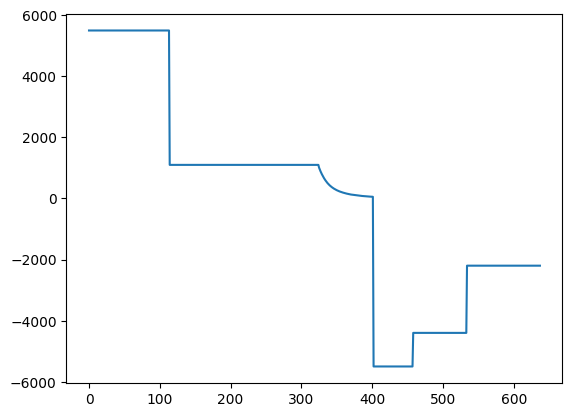

In [13]:
# data['3-3']['data'][1].head(20)
status_df = data['3-3']['data'][1]
# # Filter out rows where Status is not 'Constant current charge'
# filtered_df = status_df[status_df['Status'] != 'Constant current charge']

# # # If you just want the 'Status' column values:
# # status_values = filtered_df['Status']

# filtered_df.head()
print('rul : ',len(data['3-3']['rul']))
print(status_df['Status'].unique())

status_df['Current (mA)'].plot()

['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


<Axes: >

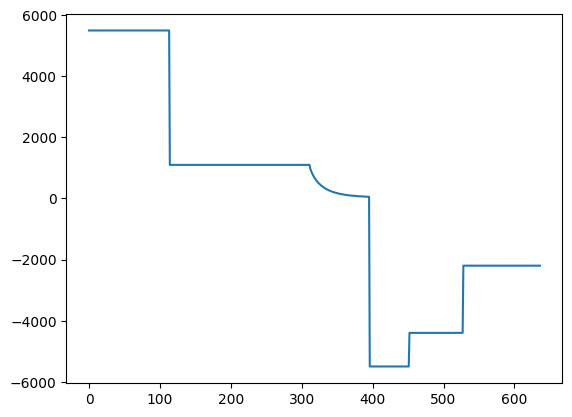

In [14]:
# data['3-3']['data'][1].head(20)
status_df = data['3-3']['data'][20]
# # Filter out rows where Status is not 'Constant current charge'
# filtered_df = status_df[status_df['Status'] != 'Constant current charge']

# # # If you just want the 'Status' column values:
# # status_values = filtered_df['Status']

# filtered_df.head()

print(status_df['Status'].unique())

status_df['Current (mA)'].plot()

In [15]:
raw_files = [f.split('.')[0] for f in os.listdir(base_path)]
print(raw_files)

['4-1', '4-3', '3-2', '10-4', '1-3', '7-5', '7-8', '8-8', '4-4', '4-6', '3-1', '5-2', '8-6', '2-8', '9-7', '6-6', '9-3', '9-1', '7-4', '10-5', '1-6', '3-6', '4-7', '5-6', '6-2', '6-5', '7-3', '8-4', '10-2', '2-6', '3-7', '8-1', '9-5', '7-7', '4-5', '8-2', '1-1', '3-4', '7-6', '2-2', '10-8', '1-4', '10-7', '1-8', '8-5', '6-3', '9-4', '5-5', '7-2', '4-2', '8-3', '1-7', '10-3', '3-8', '5-3', '6-4', '6-8', '9-6', '3-5', '2-4', '1-5', '4-8', '7-1', '10-1', '5-7', '3-3', '9-8', '2-5', '5-1', '8-7', '2-3', '1-2', '10-6', '2-7', '9-2', '5-4', '6-1']


--------------------------------------------------
4-1
rul :  2217
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


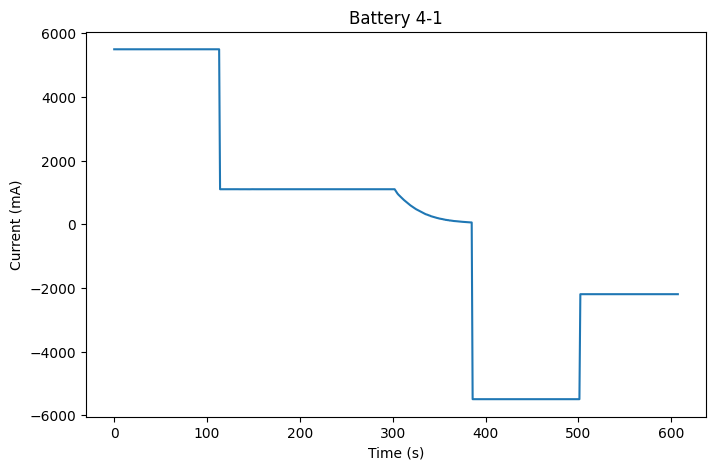

--------------------------------------------------
4-3
rul :  1142
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


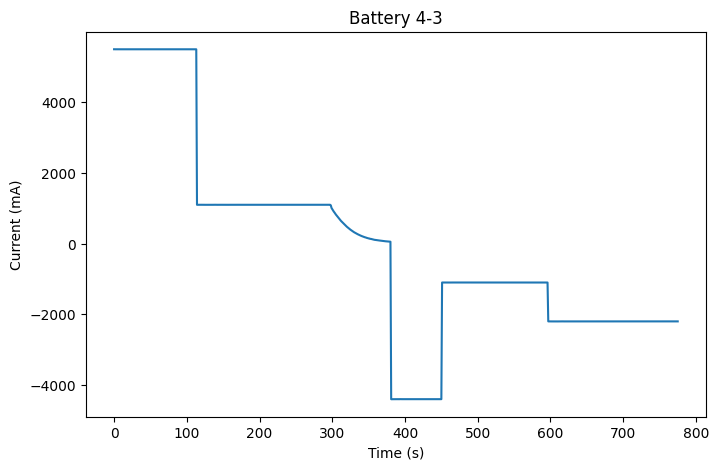

--------------------------------------------------
3-2
rul :  2283
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


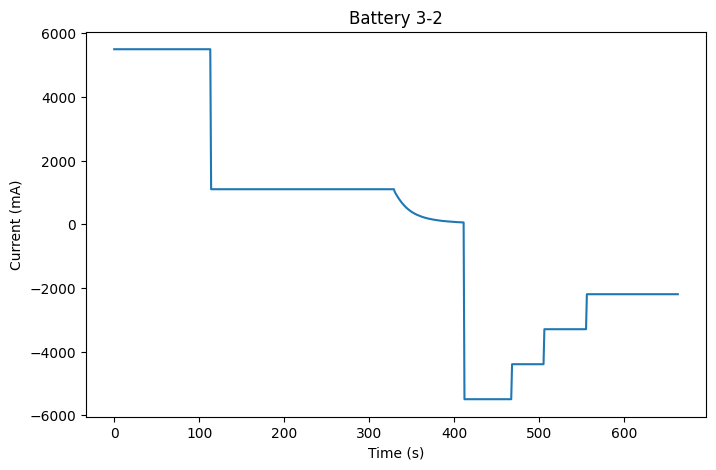

--------------------------------------------------
10-4
rul :  1811
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


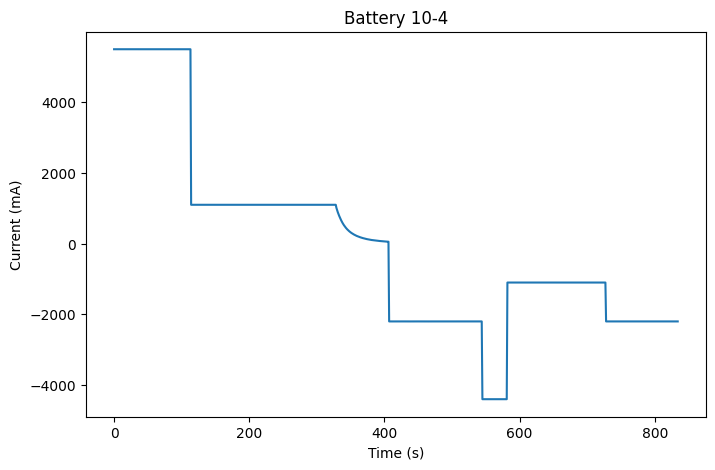

--------------------------------------------------
1-3
rul :  1858
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


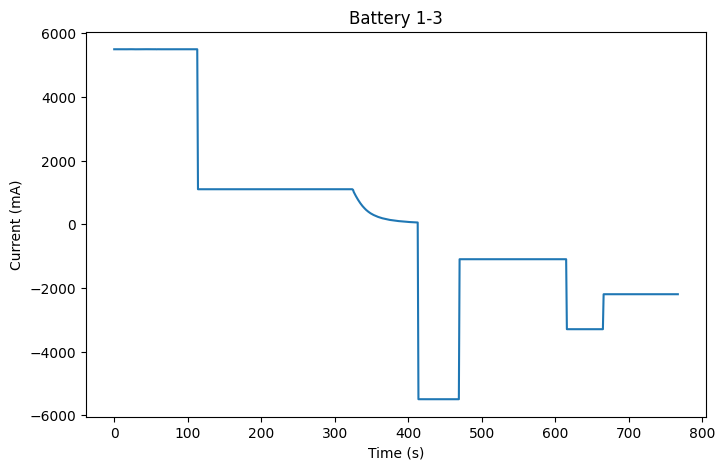

--------------------------------------------------
7-5
rul :  1875
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


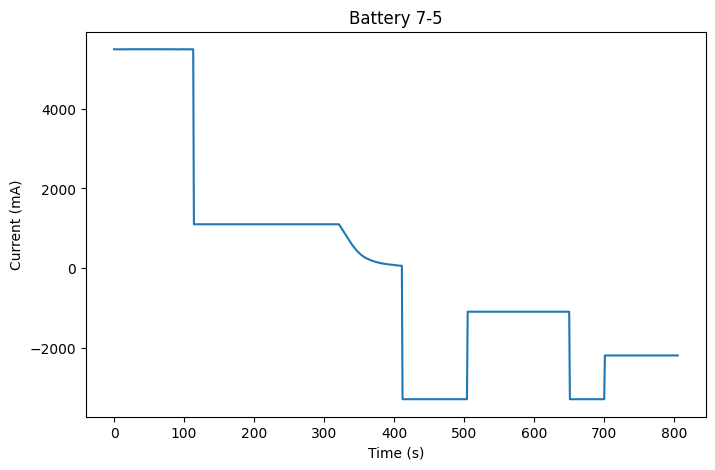

--------------------------------------------------
7-8
rul :  1938
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


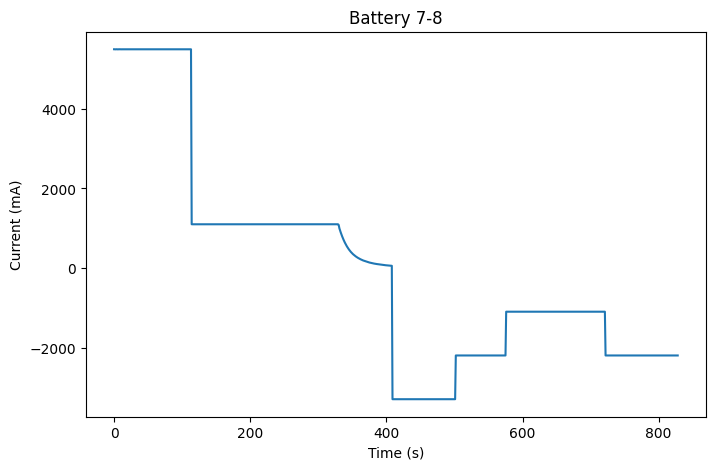

--------------------------------------------------
8-8
rul :  1679
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


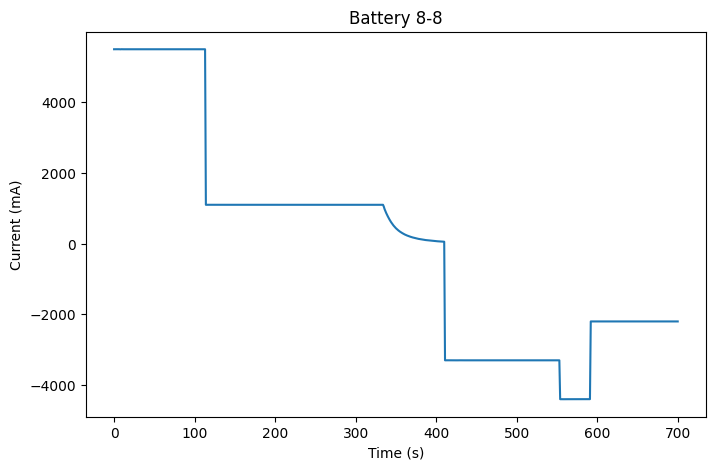

--------------------------------------------------
4-4
rul :  1491
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


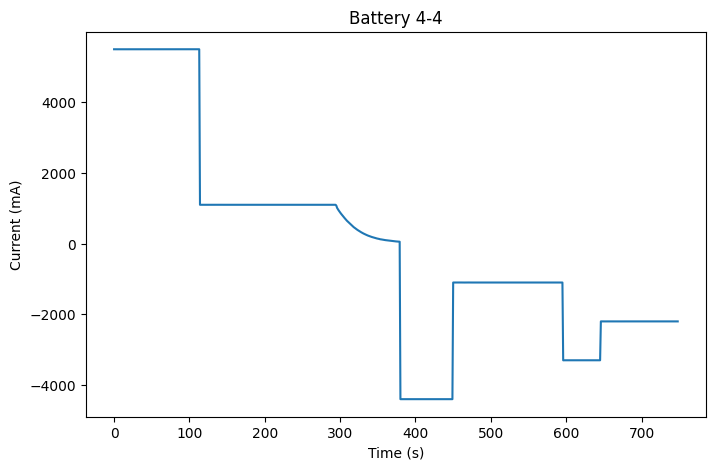

--------------------------------------------------
4-6
rul :  1380
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


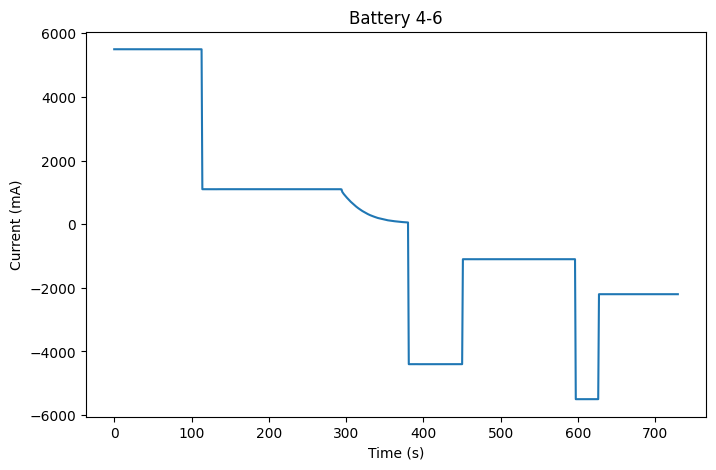

--------------------------------------------------
3-1
rul :  1938
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


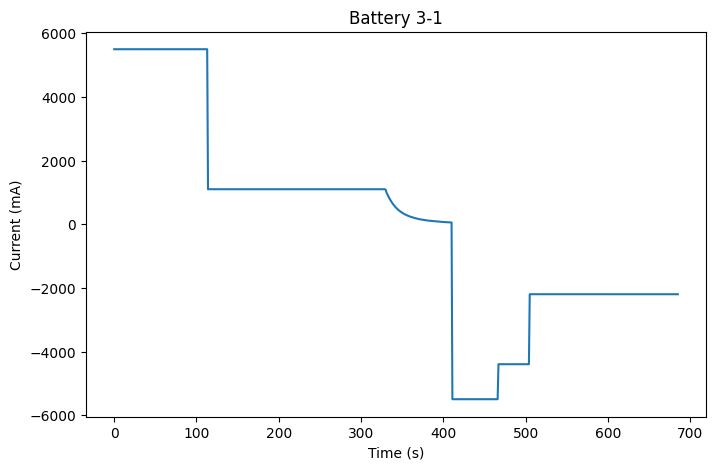

--------------------------------------------------
5-2
rul :  1926
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


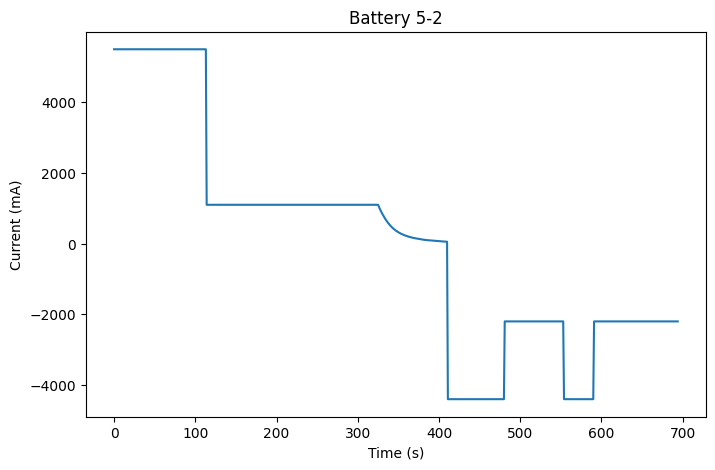

--------------------------------------------------
8-6
rul :  2365
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


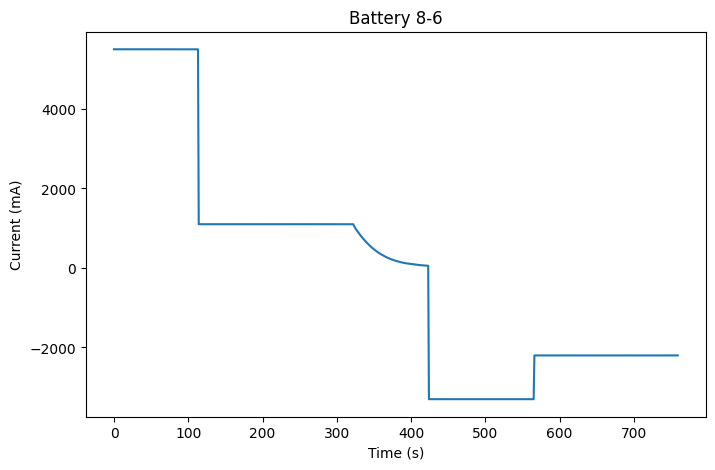

--------------------------------------------------
2-8
rul :  1481
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


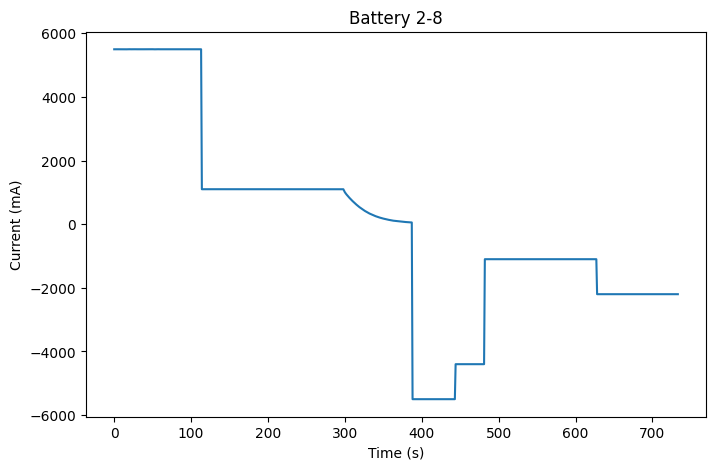

--------------------------------------------------
9-7
rul :  2012
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


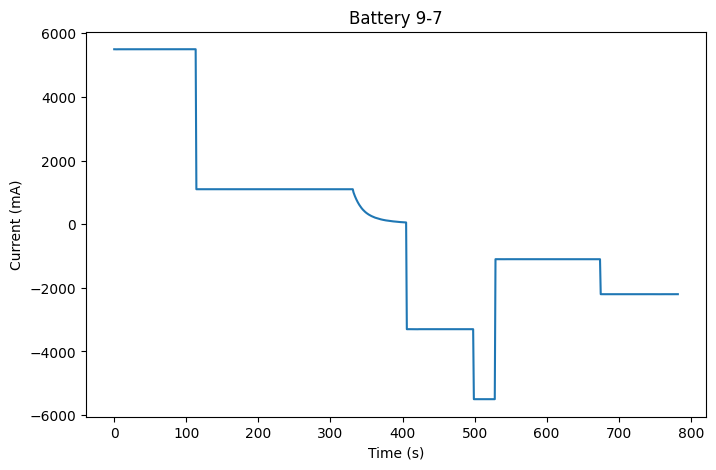

--------------------------------------------------
6-6
rul :  2468
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


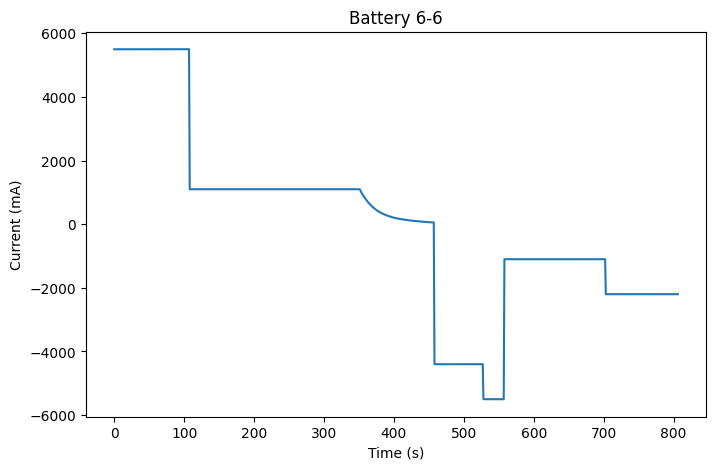

--------------------------------------------------
9-3
rul :  1905
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


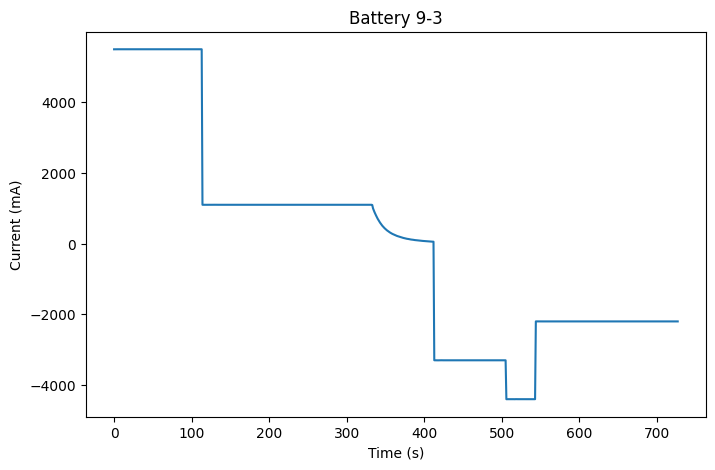

--------------------------------------------------
9-1
rul :  2057
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


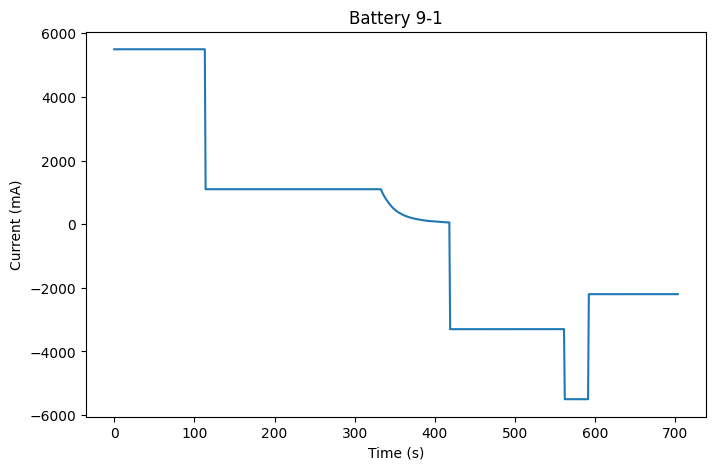

--------------------------------------------------
7-4
rul :  1393
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


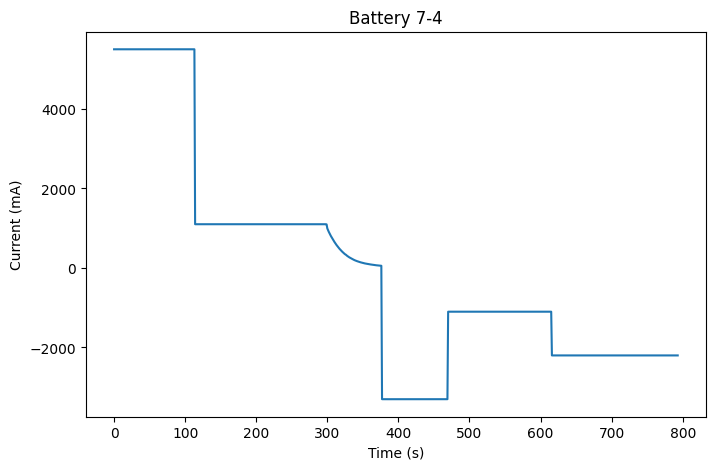

--------------------------------------------------
10-5
rul :  2030
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


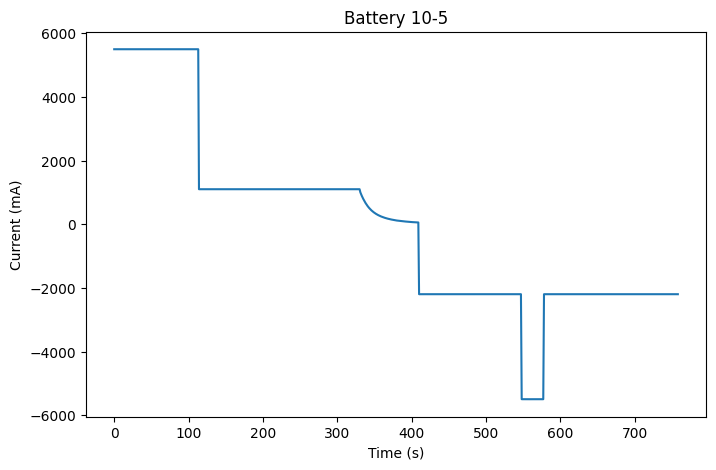

--------------------------------------------------
1-6
rul :  1143
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


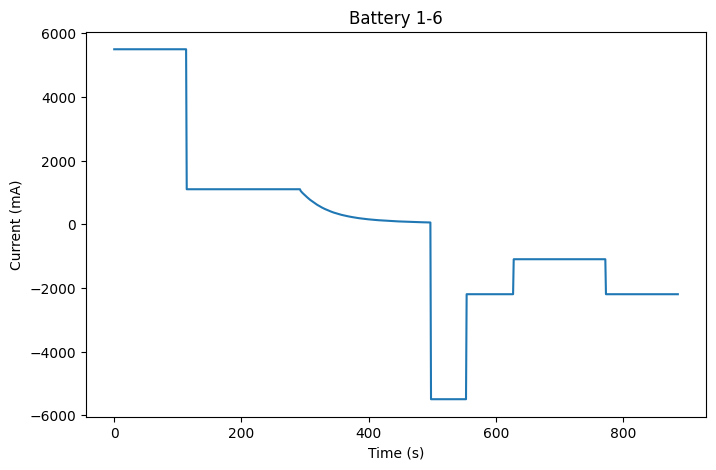

--------------------------------------------------
3-6
rul :  2491
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


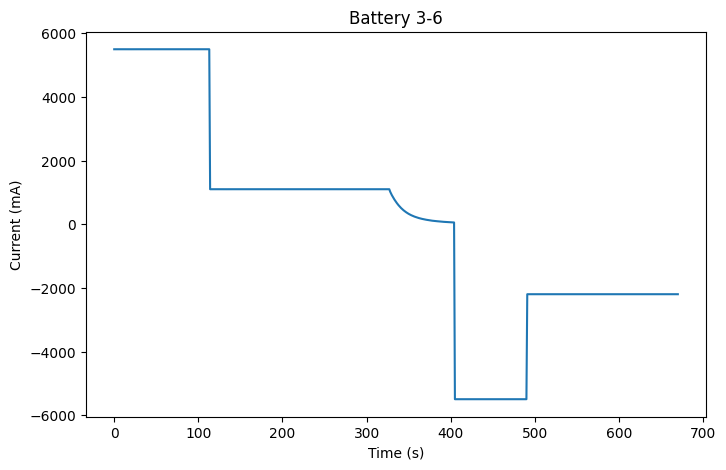

--------------------------------------------------
4-7
rul :  2216
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


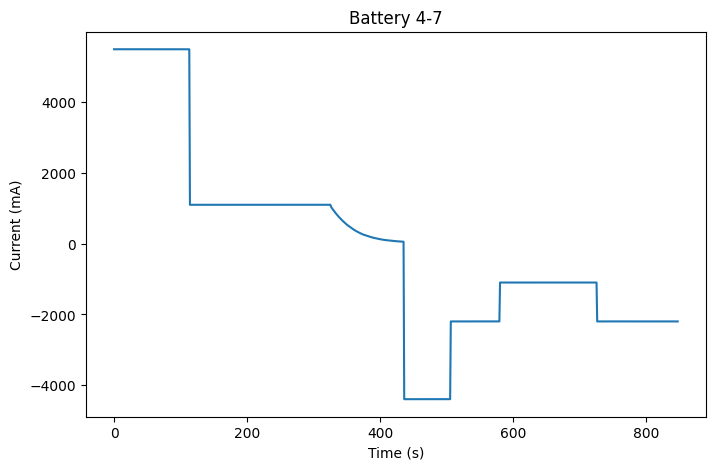

--------------------------------------------------
5-6
rul :  2460
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


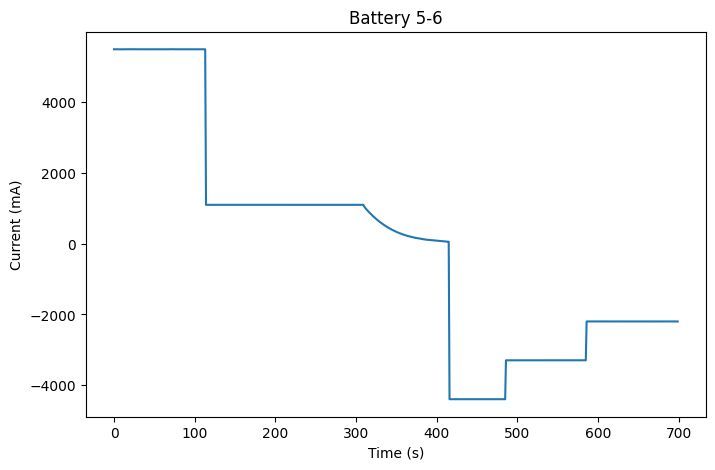

--------------------------------------------------
6-2
rul :  1908
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


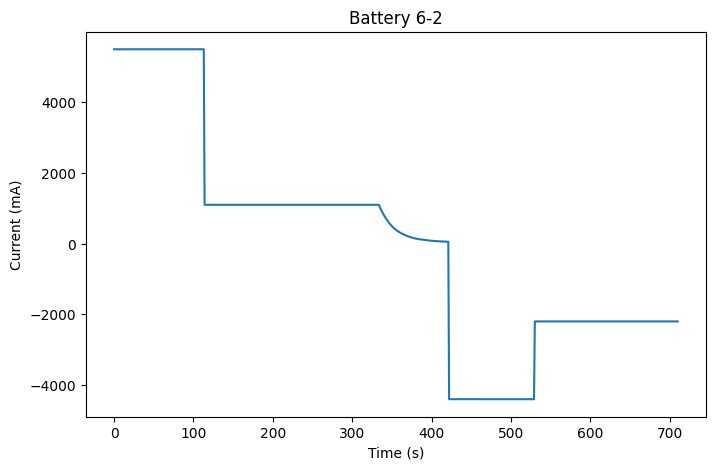

--------------------------------------------------
6-5
rul :  2178
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


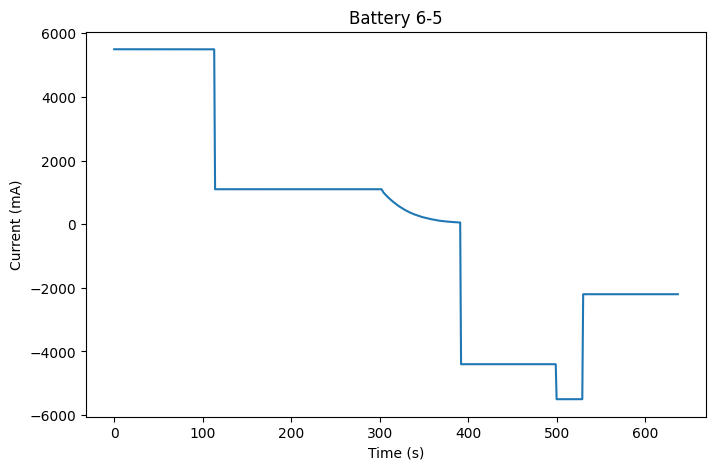

--------------------------------------------------
7-3
rul :  1295
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


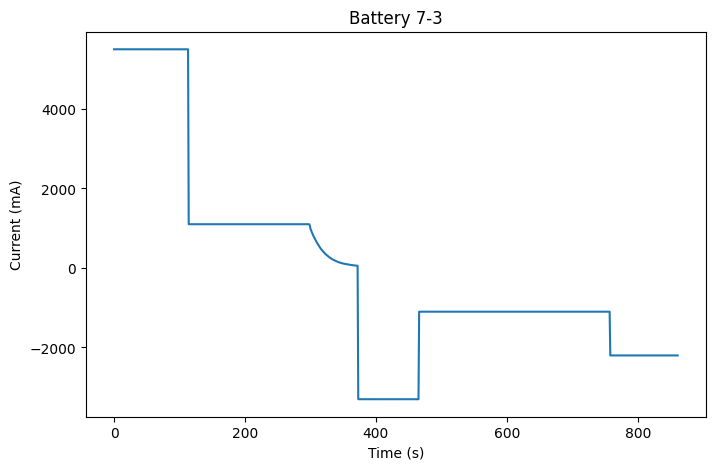

--------------------------------------------------
8-4
rul :  1885
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


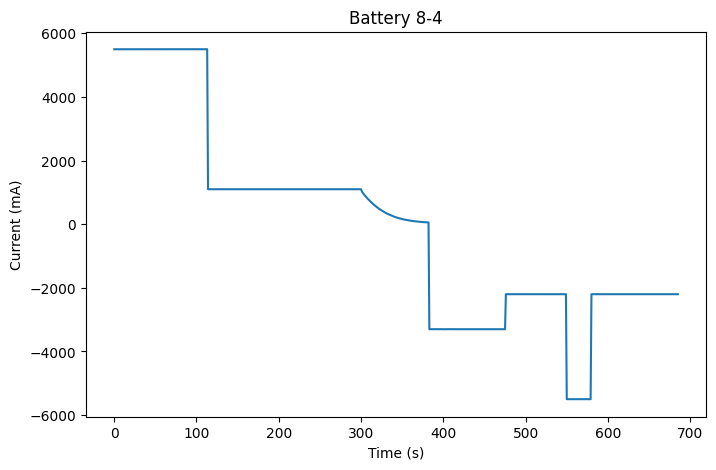

--------------------------------------------------
10-2
rul :  1697
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


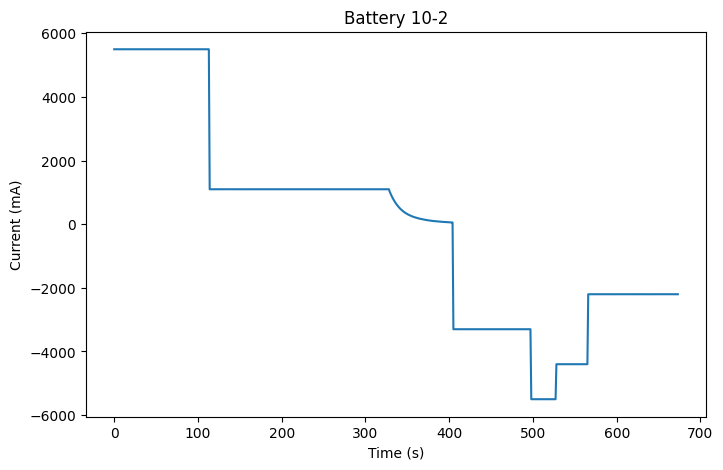

--------------------------------------------------
2-6
rul :  1572
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


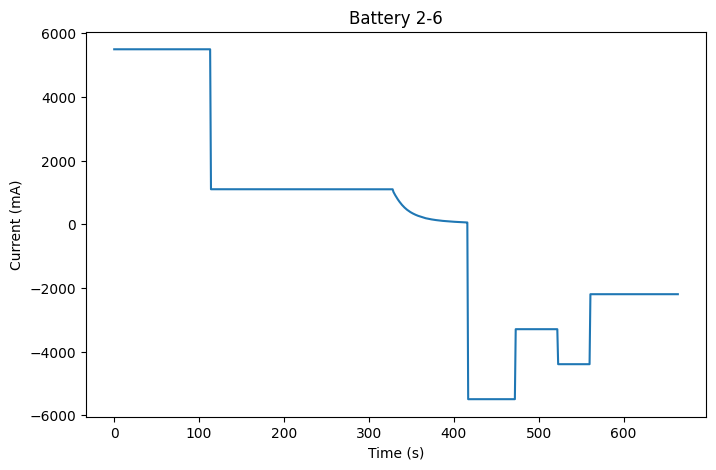

--------------------------------------------------
3-7
rul :  2479
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


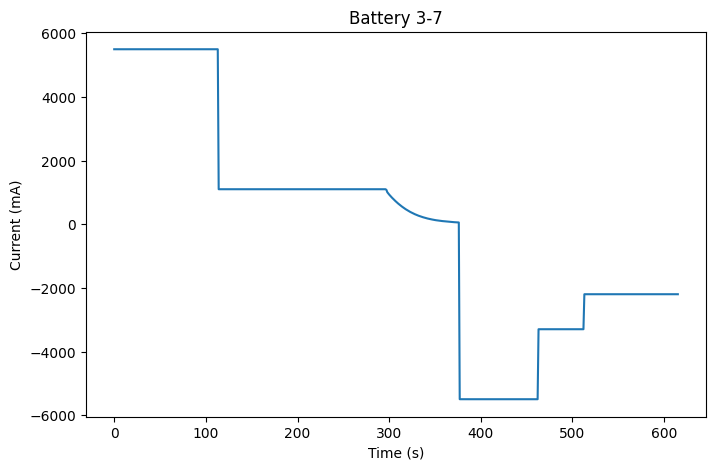

--------------------------------------------------
8-1
rul :  1308
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


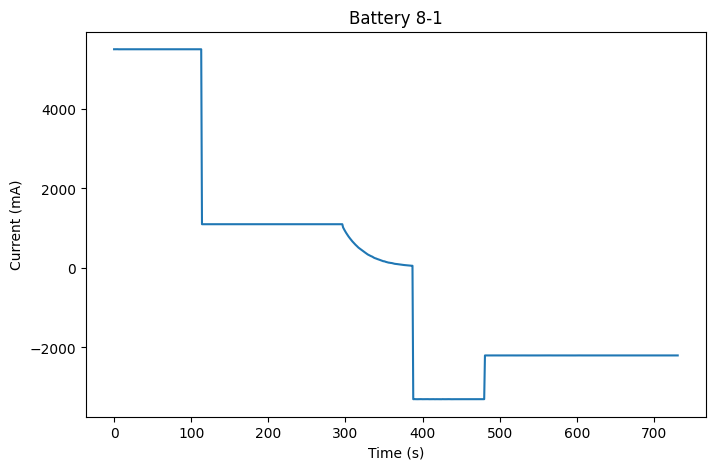

--------------------------------------------------
9-5
rul :  2168
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


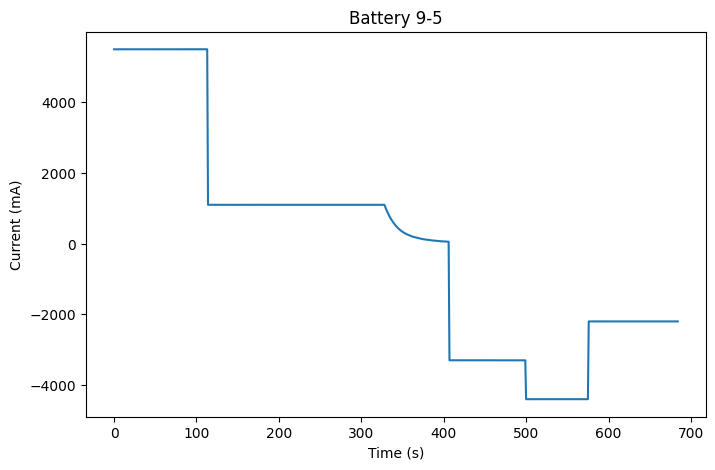

--------------------------------------------------
7-7
rul :  1685
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


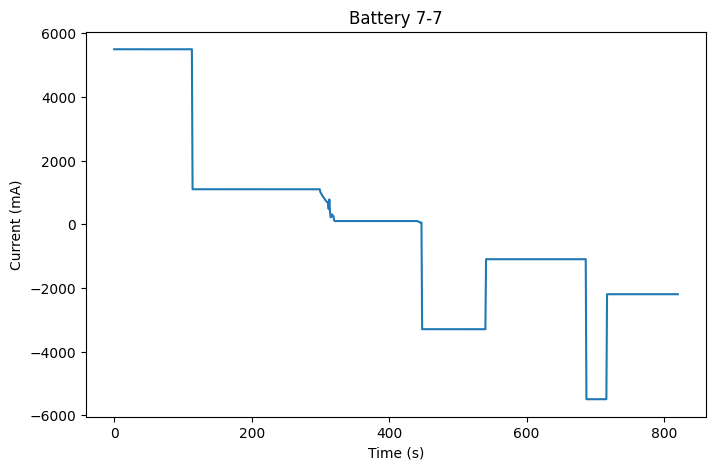

--------------------------------------------------
4-5
rul :  1561
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


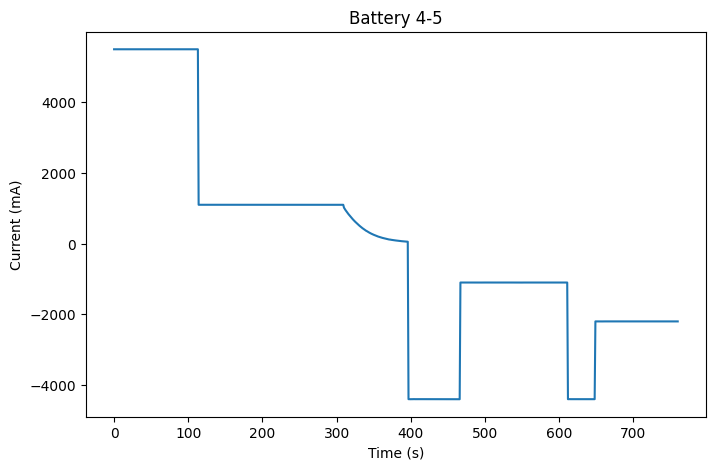

--------------------------------------------------
8-2
rul :  2041
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


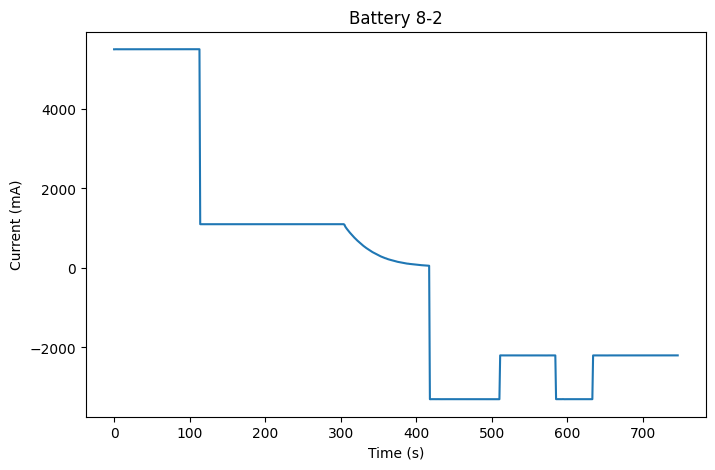

--------------------------------------------------
1-1
rul :  1504
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


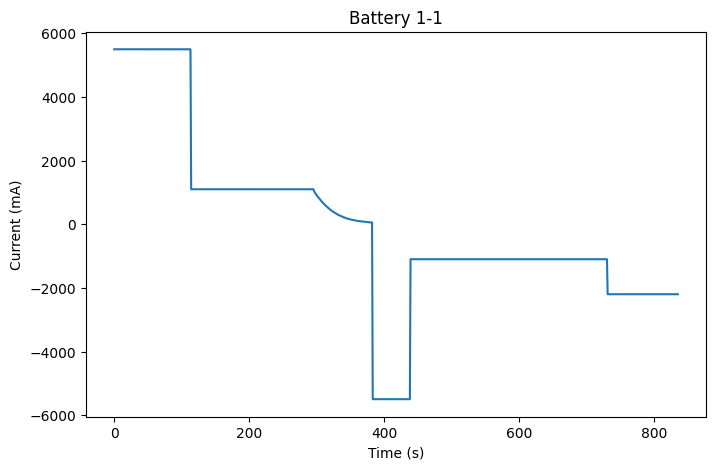

--------------------------------------------------
3-4
rul :  1766
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


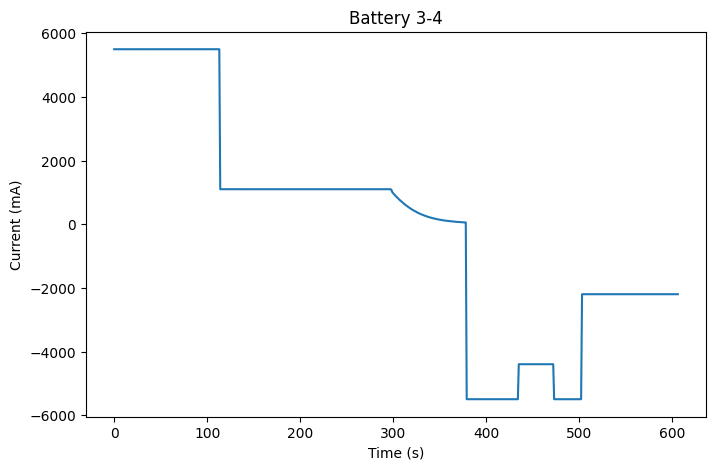

--------------------------------------------------
7-6
rul :  1419
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


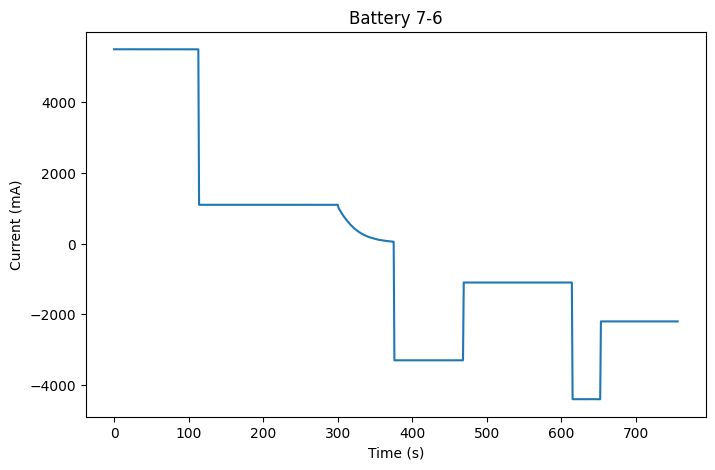

--------------------------------------------------
2-2
rul :  2651
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


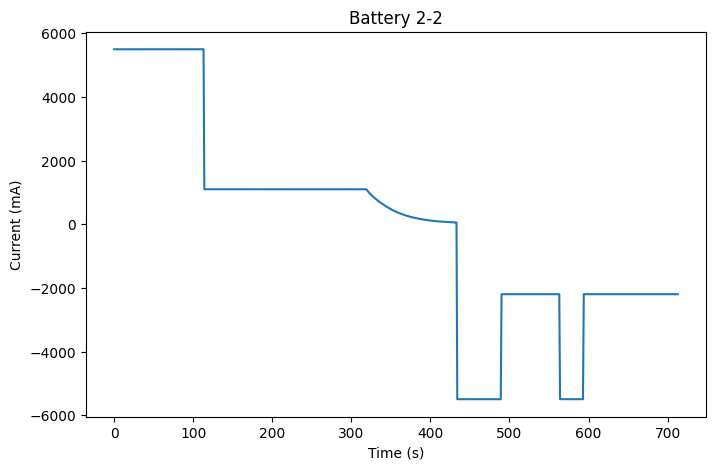

--------------------------------------------------
10-8
rul :  1400
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


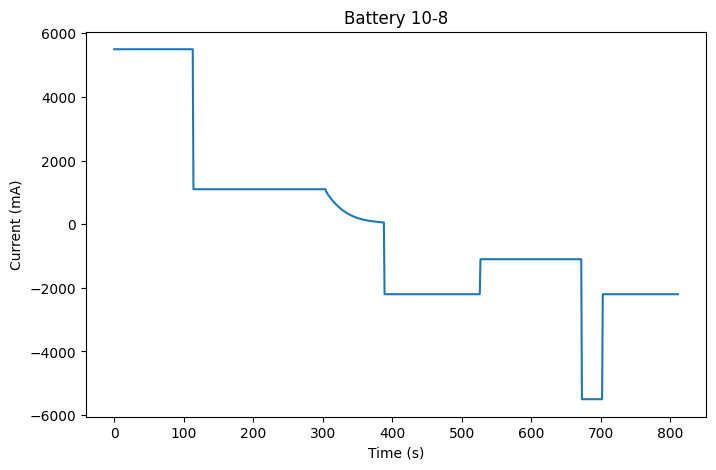

--------------------------------------------------
1-4
rul :  1500
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


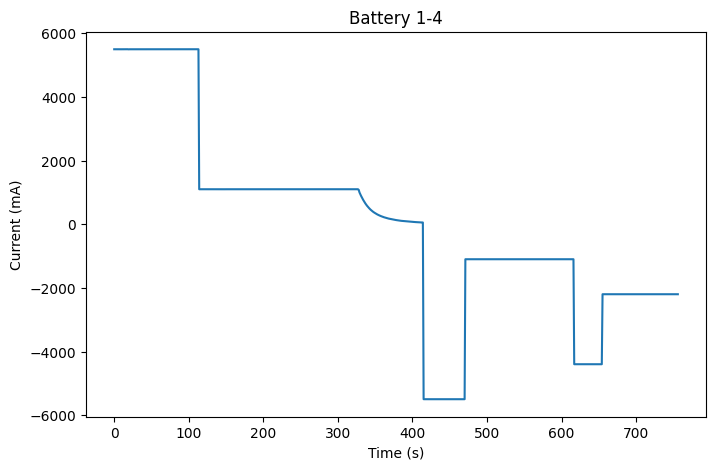

--------------------------------------------------
10-7
rul :  1783
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


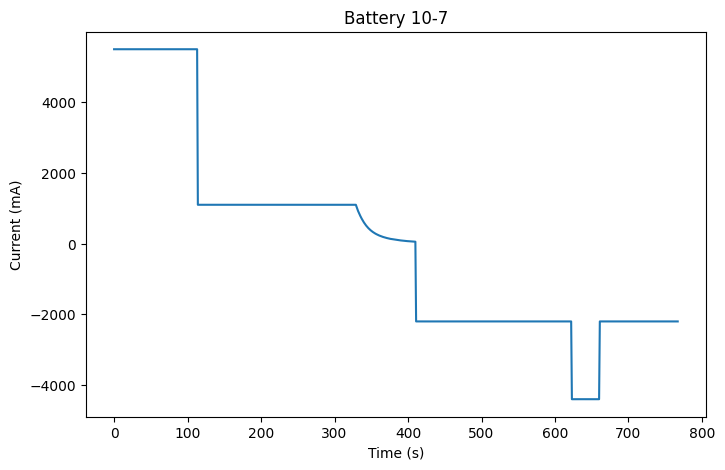

--------------------------------------------------
1-8
rul :  2285
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


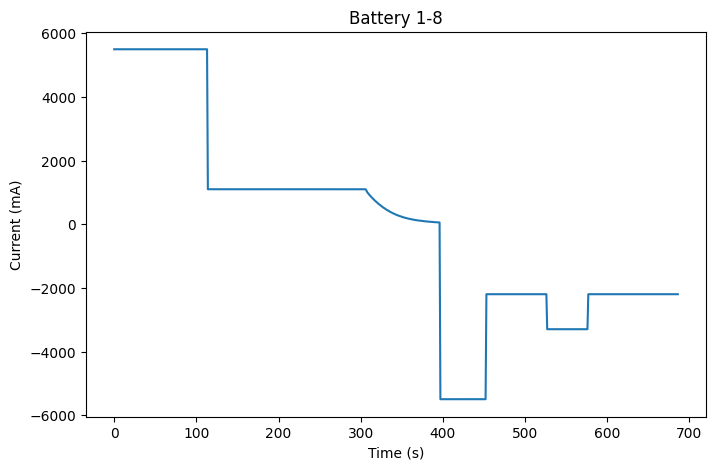

--------------------------------------------------
8-5
rul :  1348
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


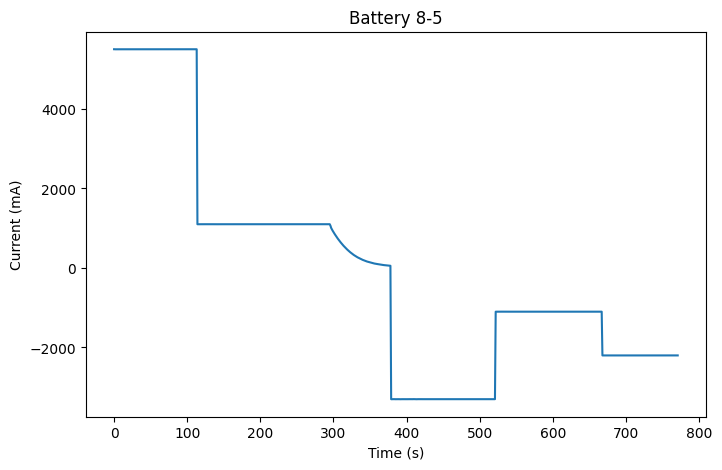

--------------------------------------------------
6-3
rul :  1804
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


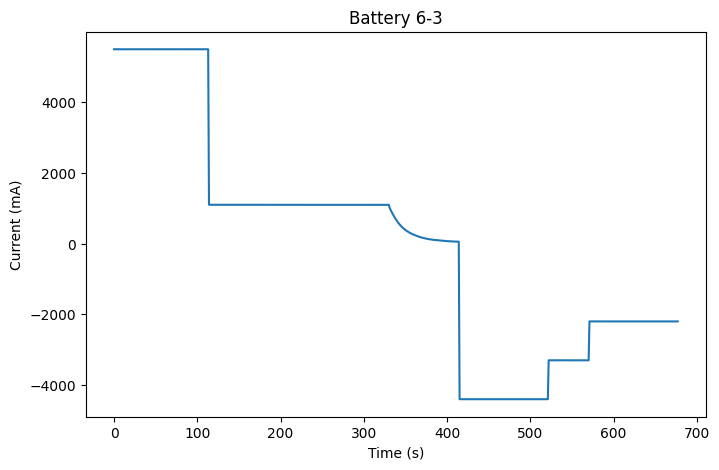

--------------------------------------------------
9-4
rul :  1975
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


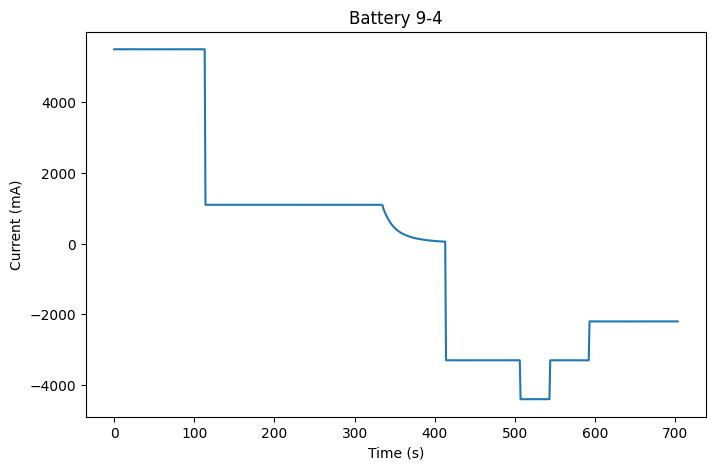

--------------------------------------------------
5-5
rul :  1583
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


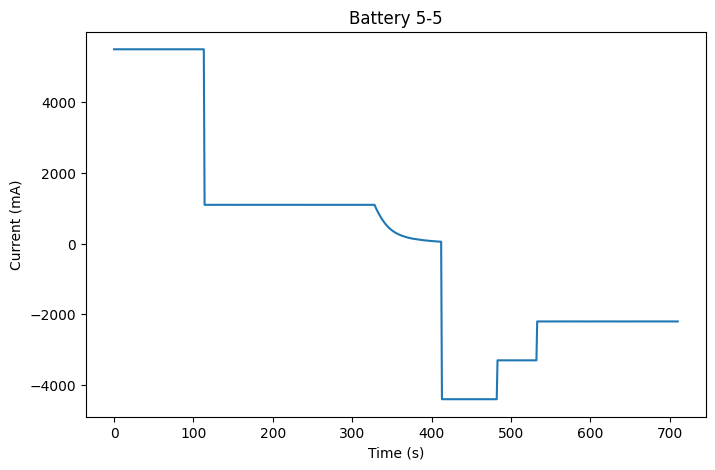

--------------------------------------------------
7-2
rul :  2030
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


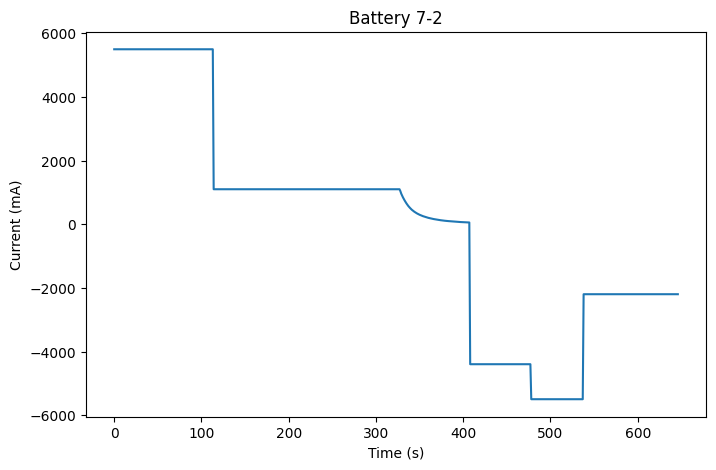

--------------------------------------------------
4-2
rul :  1782
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


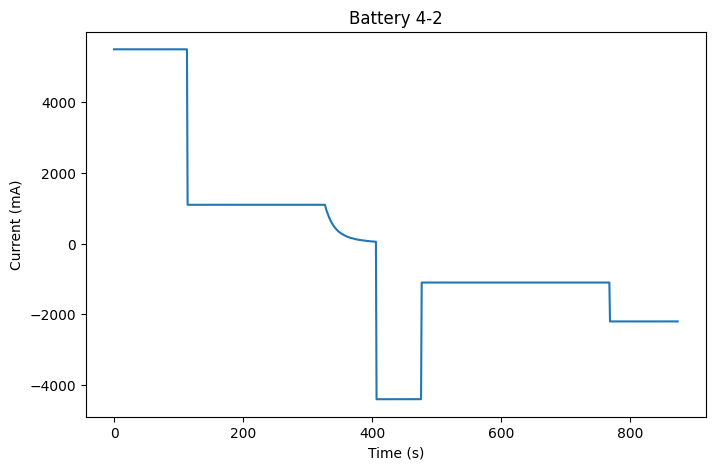

--------------------------------------------------
8-3
rul :  2290
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


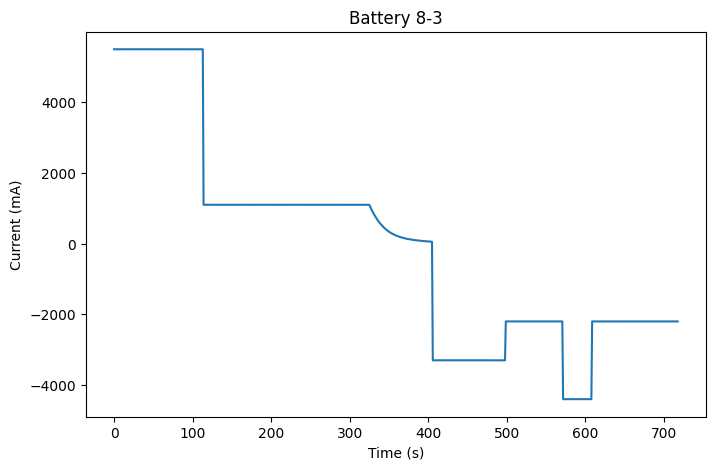

--------------------------------------------------
1-7
rul :  1678
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


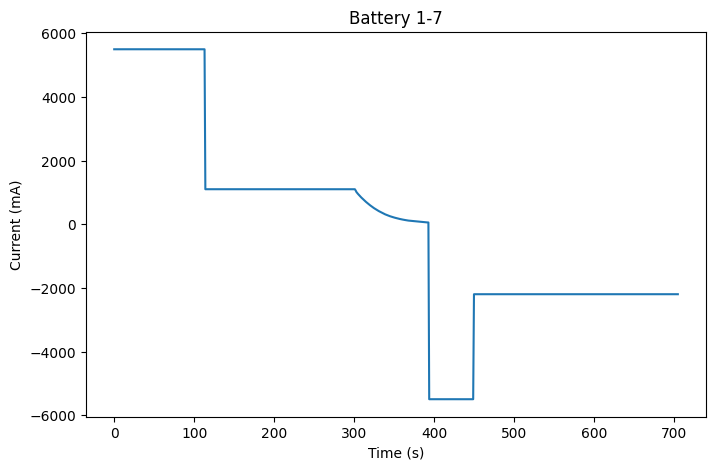

--------------------------------------------------
10-3
rul :  1848
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


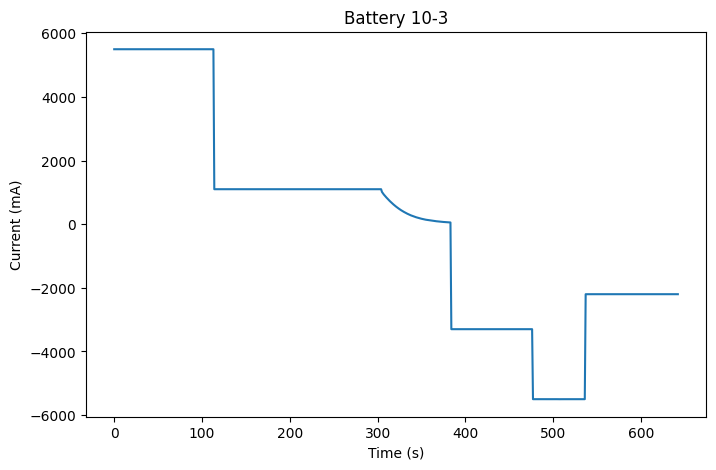

--------------------------------------------------
3-8
rul :  2342
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


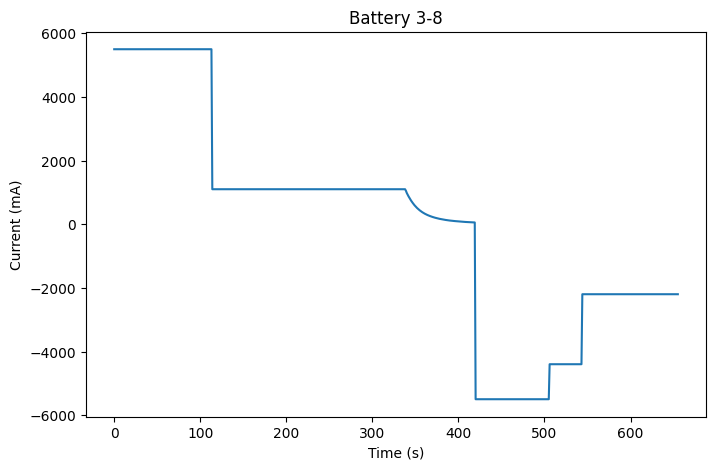

--------------------------------------------------
5-3
rul :  2689
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


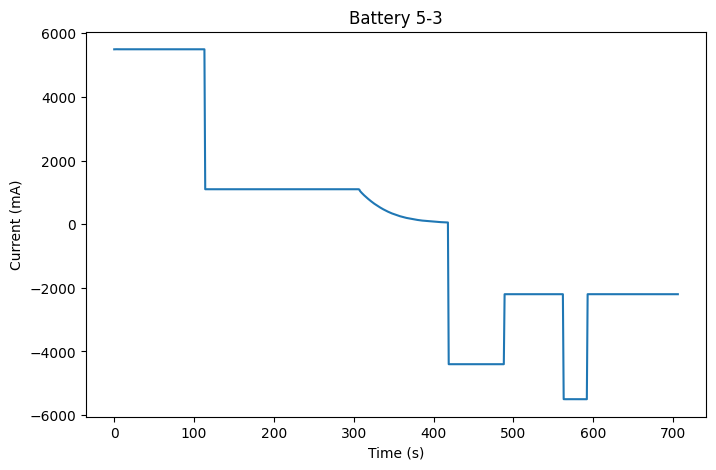

--------------------------------------------------
6-4
rul :  1717
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


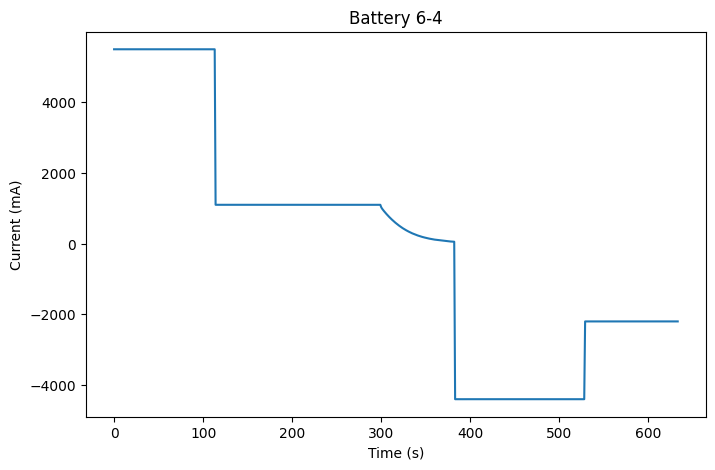

--------------------------------------------------
6-8
rul :  2450
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


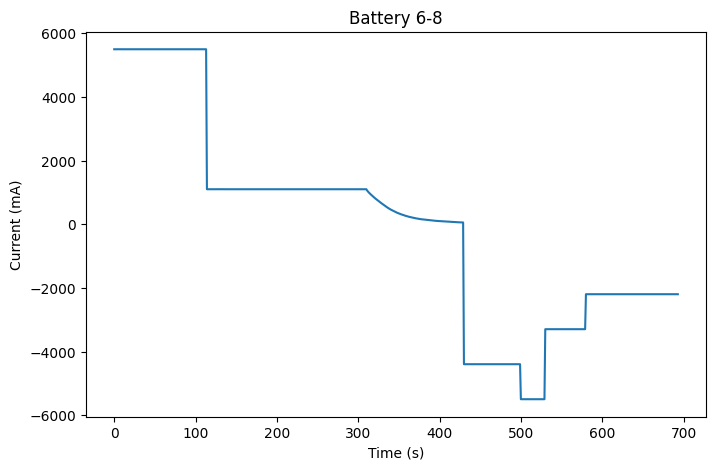

--------------------------------------------------
9-6
rul :  1742
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


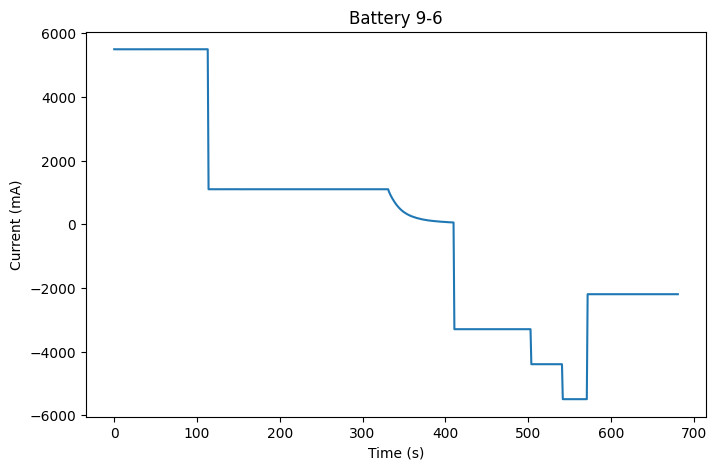

--------------------------------------------------
3-5
rul :  2657
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


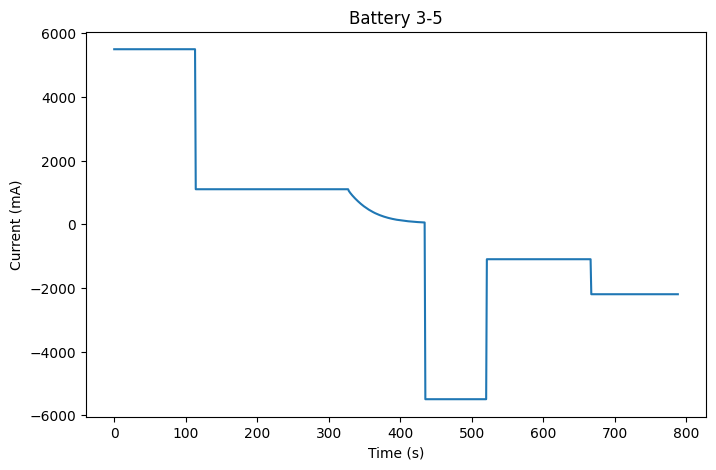

--------------------------------------------------
2-4
rul :  1499
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


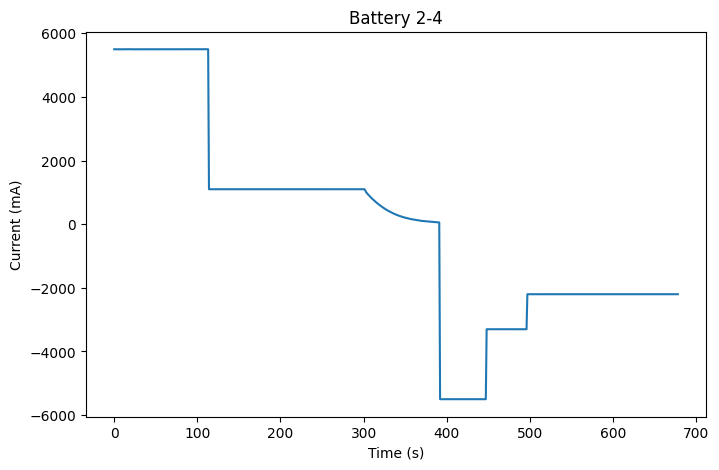

--------------------------------------------------
1-5
rul :  1971
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


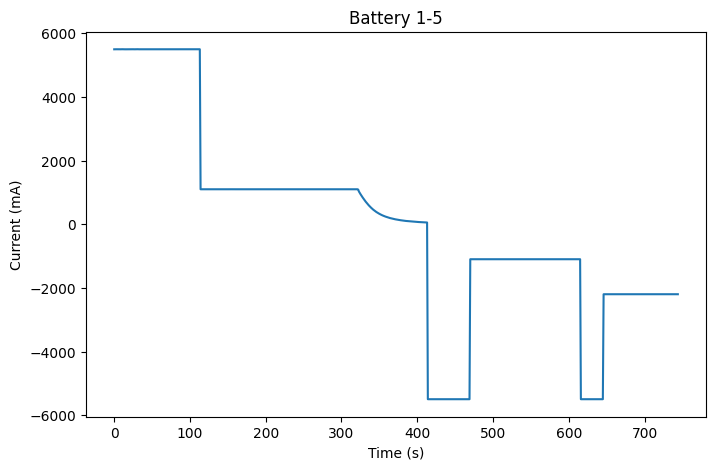

--------------------------------------------------
4-8
rul :  1706
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


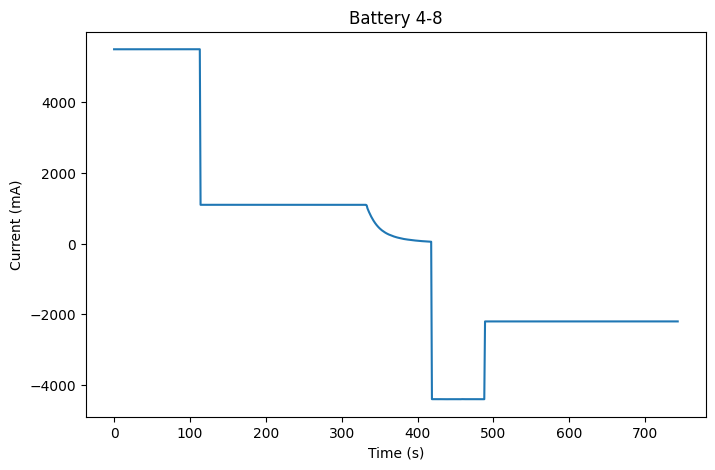

--------------------------------------------------
7-1
rul :  1690
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


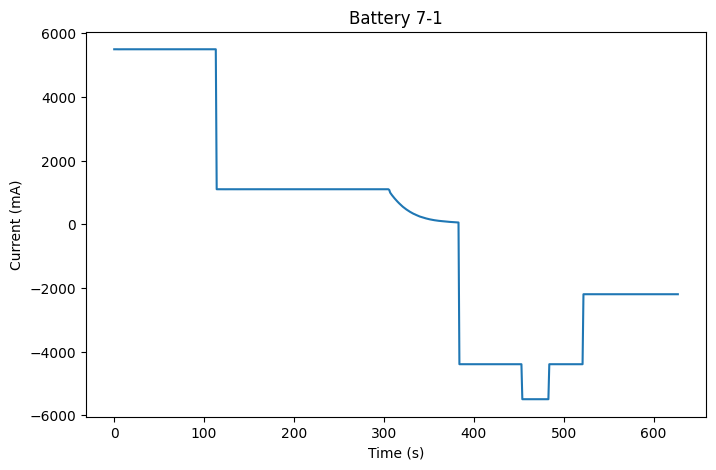

--------------------------------------------------
10-1
rul :  1702
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


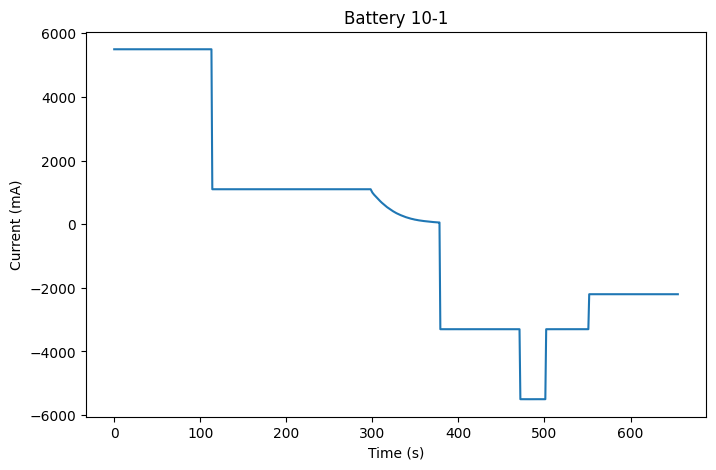

--------------------------------------------------
5-7
rul :  1448
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


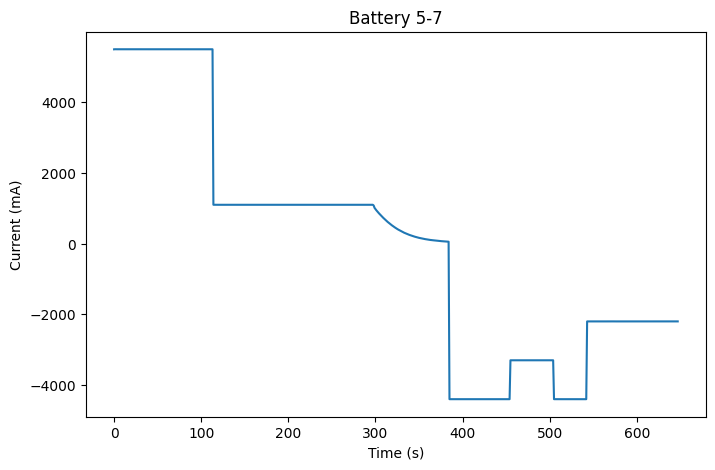

--------------------------------------------------
3-3
rul :  1649
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


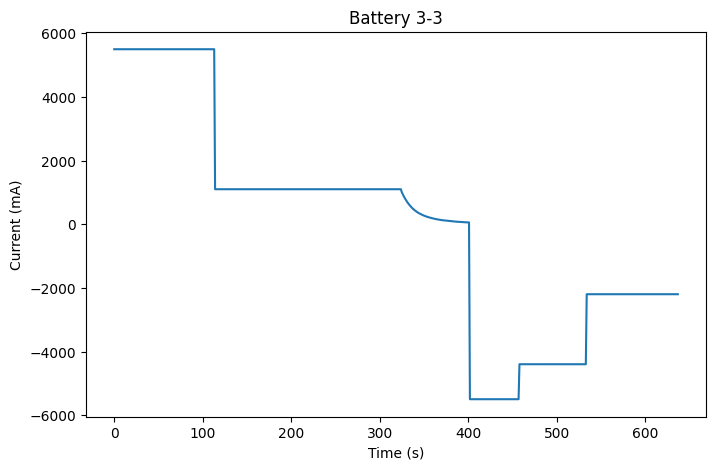

--------------------------------------------------
9-8
rul :  2308
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


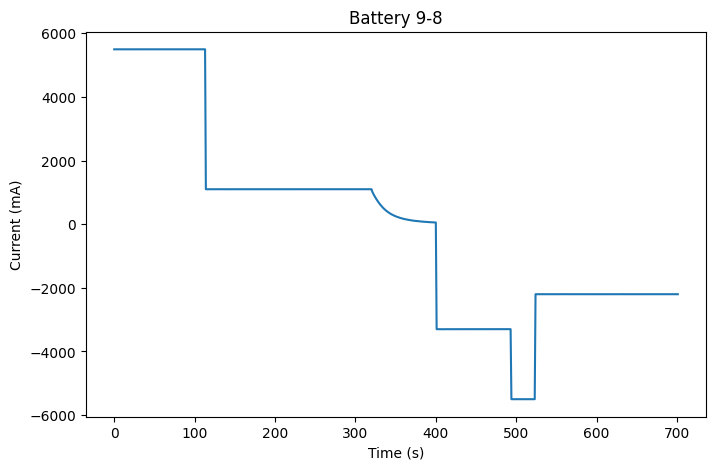

--------------------------------------------------
2-5
rul :  1386
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


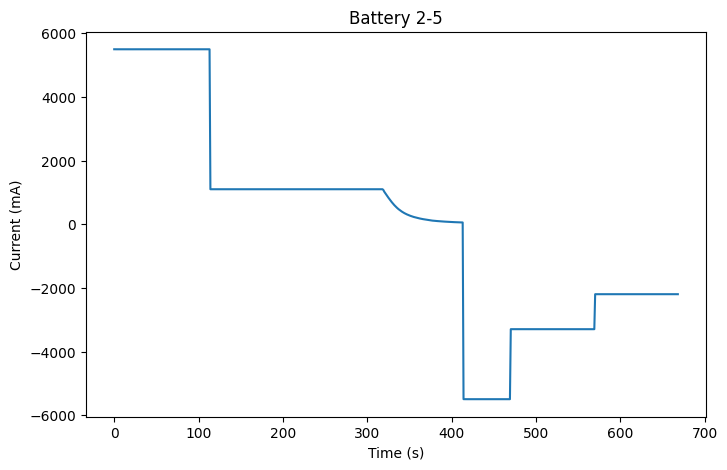

--------------------------------------------------
5-1
rul :  2507
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


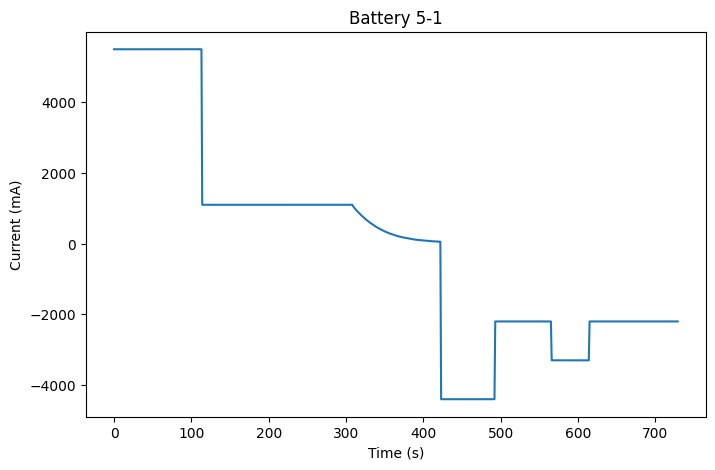

--------------------------------------------------
8-7
rul :  2047
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


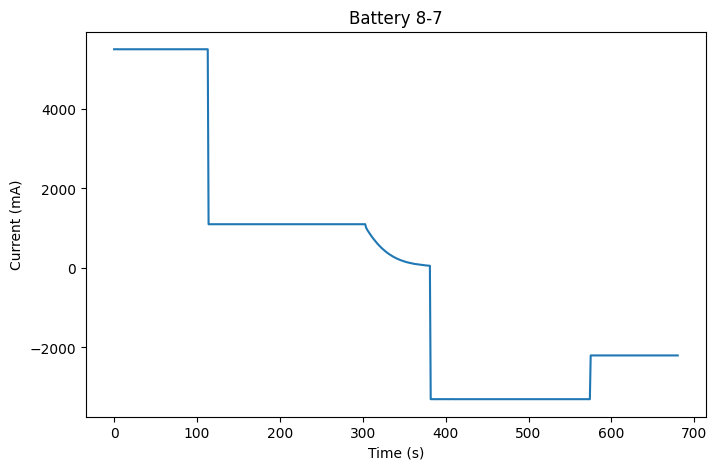

--------------------------------------------------
2-3
rul :  1751
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


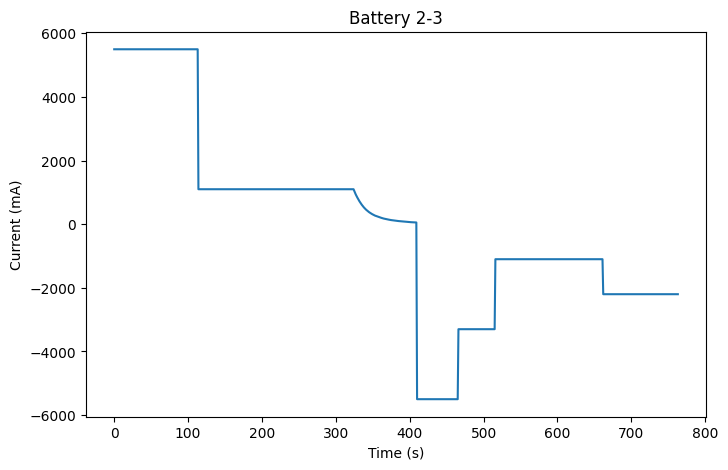

--------------------------------------------------
1-2
rul :  2678
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


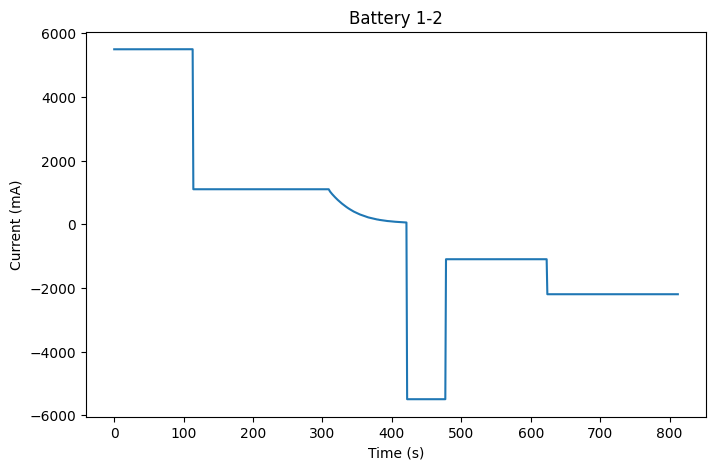

--------------------------------------------------
10-6
rul :  2285
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


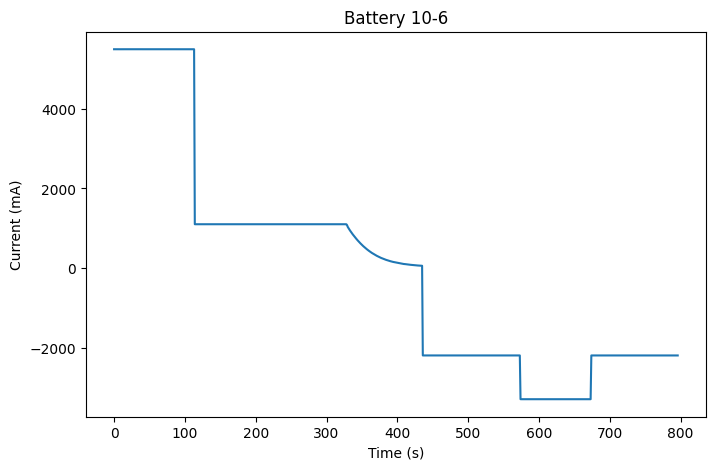

--------------------------------------------------
2-7
rul :  2202
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


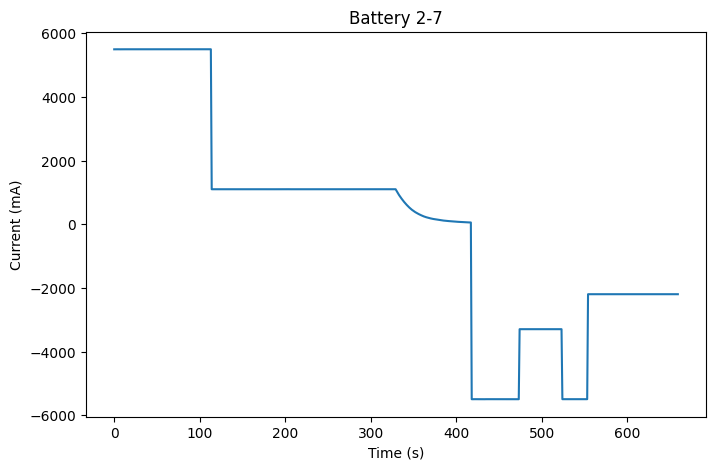

--------------------------------------------------
9-2
rul :  2143
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


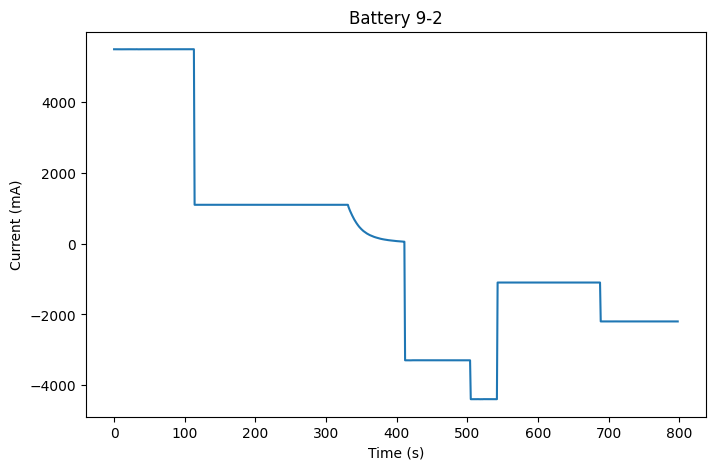

--------------------------------------------------
5-4
rul :  1962
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


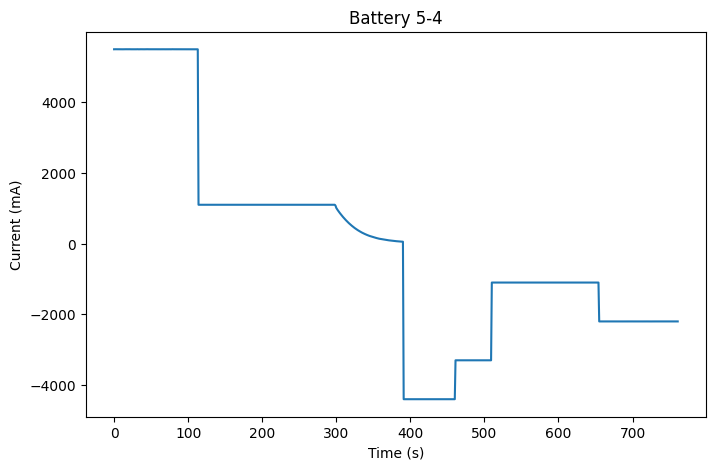

--------------------------------------------------
6-1
rul :  1609
['Constant current charge' 'Constant current-constant voltage charge'
 'Constant current discharge_0' 'Constant current discharge_1'
 'Constant current discharge_2' 'Constant current discharge_3']


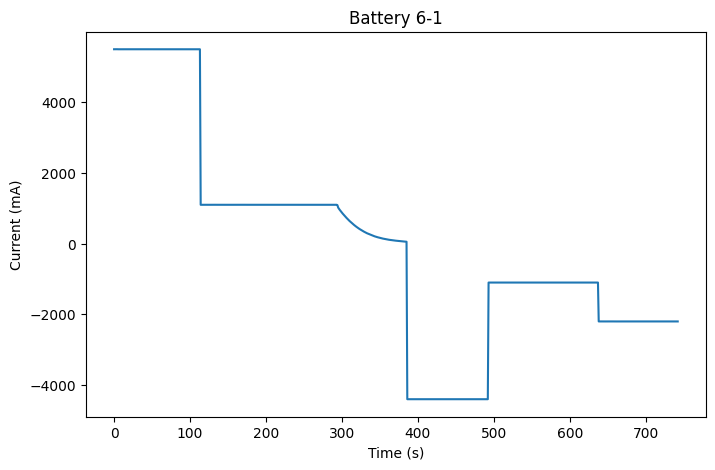

In [16]:
os.makedirs('current-plots/',exist_ok=True)
for raw_file in raw_files:
    print('-'*50)
    print(raw_file)
    with open(f'{base_path}/{raw_file}.pkl', 'rb') as file:
        data = pickle.load(file)
    
       
    # data['3-3']['data'][1].head(20)
    status_df = data[raw_file]['data'][1]
    # # Filter out rows where Status is not 'Constant current charge'
    # filtered_df = status_df[status_df['Status'] != 'Constant current charge']
    
    # # # If you just want the 'Status' column values:
    # # status_values = filtered_df['Status']
    
    # filtered_df.head()
    print('rul : ',len(data[raw_file]['rul']))
    plt.figure(figsize=(8,5)) 
    print(status_df['Status'].unique())
    #status_df['Current (mA)'].plot()
    status_df['Current (mA)'].plot(title=f"Battery {raw_file}")
    plt.xlabel("Time (s)")
    plt.ylabel("Current (mA)")
    plt.savefig('current-plots/'+raw_file+'-current-plot.png', dpi=300)
    plt.show()
    #break

In [17]:
# plt.figure(figsize=(10,6))
# for status in statuses:
#     mask = status_df['Status'] == status
#     plt.scatter(
#         status_df.index[mask], 
#         status_df['Current (mA)'][mask], 
#         label=status, alpha=0.7
#     )

# plt.xlabel("Index")
# plt.ylabel("Current (mA)")
# plt.title("Current vs Status Category")
# plt.legend(title="Status")
# plt.show()


In [18]:
# data['3-3']['data'][20].head()

In [19]:
# data['3-3']['data'][1].to_csv("data-3.3-cycle-1.csv", index=False)

In [20]:
# type(data['3-3'])

4-1


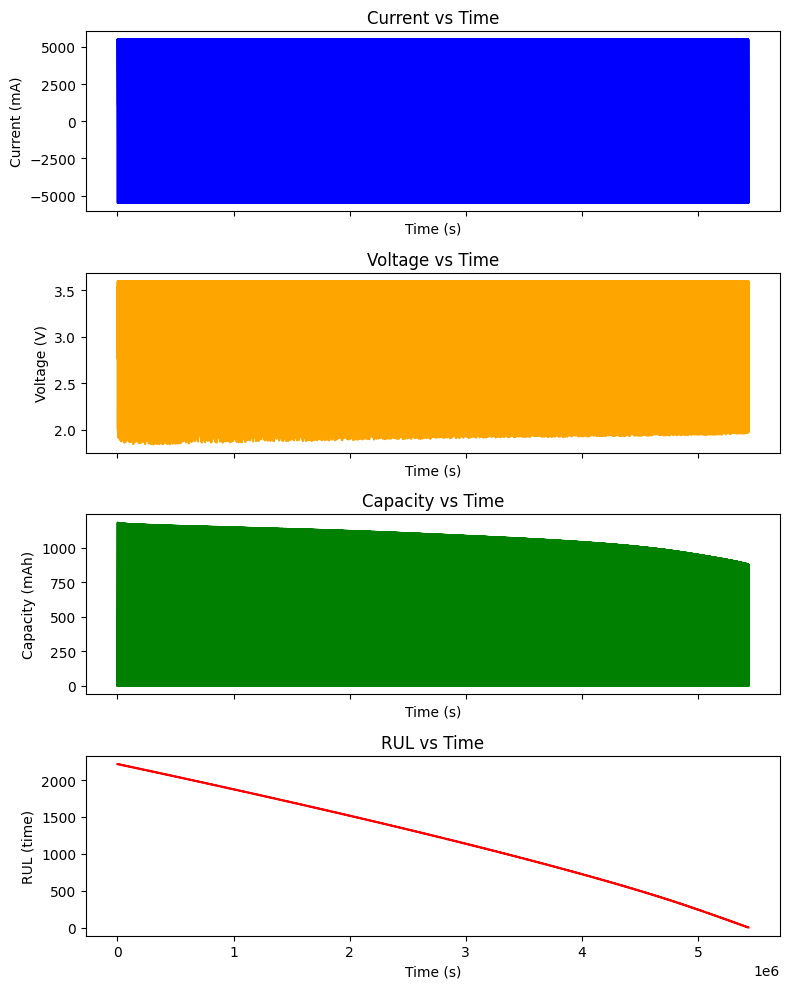

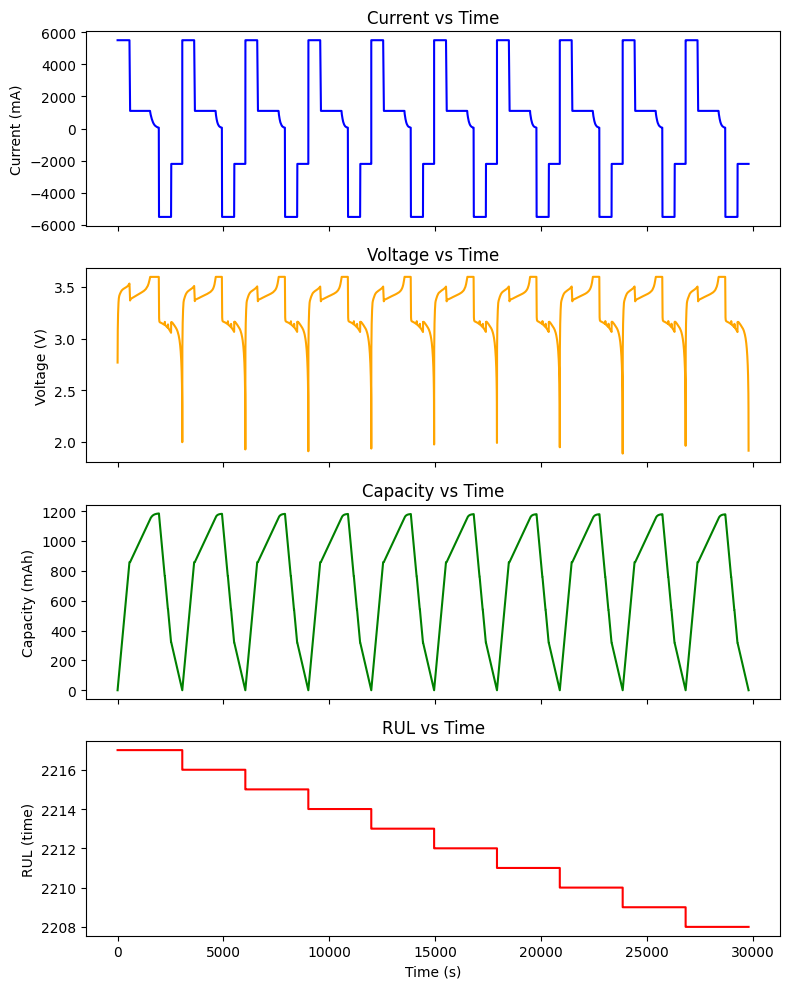

100%|██████████| 2217/2217 [01:32<00:00, 23.87it/s]


In [21]:
import pandas as pd
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# Precompute constant
C_rated = 1100.0 * 3600

    

os.makedirs('plots/',exist_ok=True)
os.makedirs('csvs/',exist_ok=True)

for cycle_regimen in filenames_without_pkl:
    #cycle_regimen = random.choice(filenames_without_pkl)#'10-1'
    unpickled_df = pd.read_pickle(f'{base_path}/{cycle_regimen}.pkl')#,engine='pyarrow',dtype_backend='pyarrow')
    print(cycle_regimen)
    df = pd.DataFrame(unpickled_df[cycle_regimen])#,engine='pyarrow',dtype_backend='pyarrow')
    rul = unpickled_df[cycle_regimen]['rul']
    dq = unpickled_df[cycle_regimen]['dq']
    data = unpickled_df[cycle_regimen]['data']
    ### Faster Code ########

    # Prepare a list to store all DataFrames, so we only concatenate at the end
    df_list = []

    # Initialize the previous_last_time for cumulative time calculation
    previous_last_time = 0

    # Iterate over the data dictionary
    for cycle_number, cycle_data in data.items():
        df_data = pd.DataFrame(cycle_data)

        # Calculate cumulative time
        df_data['Time (s) cumu'] = df_data['Time (s)'] + previous_last_time

        # Add 'rul' and 'dq' columns directly without creating lists
        df_data['rul'] = rul[cycle_number]
        df_data['dq'] = dq[cycle_number]

        # Update the previous_last_time for the next cycle
        previous_last_time = df_data['Time (s) cumu'].iloc[-1]

        # Store the DataFrame in the list
        df_list.append(df_data)

    # Concatenate all DataFrames at once
    merge_df = pd.concat(df_list, ignore_index=True)

    # Sort only once if needed
    merge_df = merge_df.sort_values(by='Time (s) cumu', ascending=True).reset_index(drop=True)


    df = merge_df#.copy()

    import matplotlib.pyplot as plt

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(4, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu'], df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')
    axs[0].set_xlabel('Time (s)')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu'], df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')
    axs[1].set_xlabel('Time (s)')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu'], df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    axs[2].set_xlabel('Time (s)')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu'], df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    axs[3].set_xlabel('Time (s)')

    # # Plot Capacity vs Time
    # axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
    # axs[4].set_ylabel('dq')
    # axs[4].set_title('dq vs Time')
    # axs[4].set_xlabel('Time (s)')

    # Add some spacing between plots
    plt.tight_layout()

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-full-plot.png', dpi=300)
    # Display the plots
    plt.show()


    df = merge_df#.copy()
    df = df[df['Cycle number']<11]

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(4, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu'], df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')
    #axs[0].set_xlabel('Time (s)')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu'], df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')
    #axs[1].set_xlabel('Time (s)')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu'], df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    #axs[2].set_xlabel('Time (s)')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu'], df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    axs[3].set_xlabel('Time (s)')

    # # Plot Capacity vs Time
    # axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
    # axs[4].set_ylabel('dq')
    # axs[4].set_title('dq vs Time')
    # axs[4].set_xlabel('Time (s)')

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-first-10-plot.png', dpi=300)
    # Add some spacing between plots
    plt.tight_layout()

    # Display the plots
    plt.show()

    merge_df.loc[merge_df['Capacity (mAh)'] == 0, 'previous_SOC'] = 0
    
    # Temporary storage for the computed SOC values
    cc_soc_values = np.zeros(len(merge_df))
    
    # Process each group
    for _, group in tqdm(merge_df.groupby('Cycle number')):
        # Initialize variables
        soc_values = []
        initial_SOC = 0  # Assuming this starts at 0 for each group
    
        # Iterate over each row in the group
        t_end = group.iloc[0]['Time (s)']  # Set initial t_end to the first time value
    
        for i, row in group.iterrows():
            if row["previous_SOC"] == 0:
                # Reset SOC calculation at the start of a new cycle
                initial_SOC = row["previous_SOC"]
                I_bat = row['Current (mA)']
                t_start = row['Time (s)']
                t_end = t_start  # Initialize t_end for the first row
            else:
                # Use previous SOC and time values for the next row
                t_start = t_end
                t_end = row['Time (s)']
                I_bat = row['Current (mA)']
    
            # Calculate SOC
            SOC = current_integration(initial_SOC=initial_SOC, C_rated=C_rated, I_bat=I_bat, t_start=t_start, t_end=t_end)
    
            # Update the initial_SOC for the next iteration
            initial_SOC = SOC
    
            # Store the result
            soc_values.append(SOC)
    
        # Assign computed SOC values back to the original DataFrame using loc with index slicing
        cc_soc_values[group.index] = soc_values
    
    # Finally, assign all computed SOC values to the DataFrame column in a single operation
    merge_df["CC_SOC"] = cc_soc_values
    merge_df.to_csv('csvs/'+cycle_regimen+'.csv',index=False)
    break

4-1


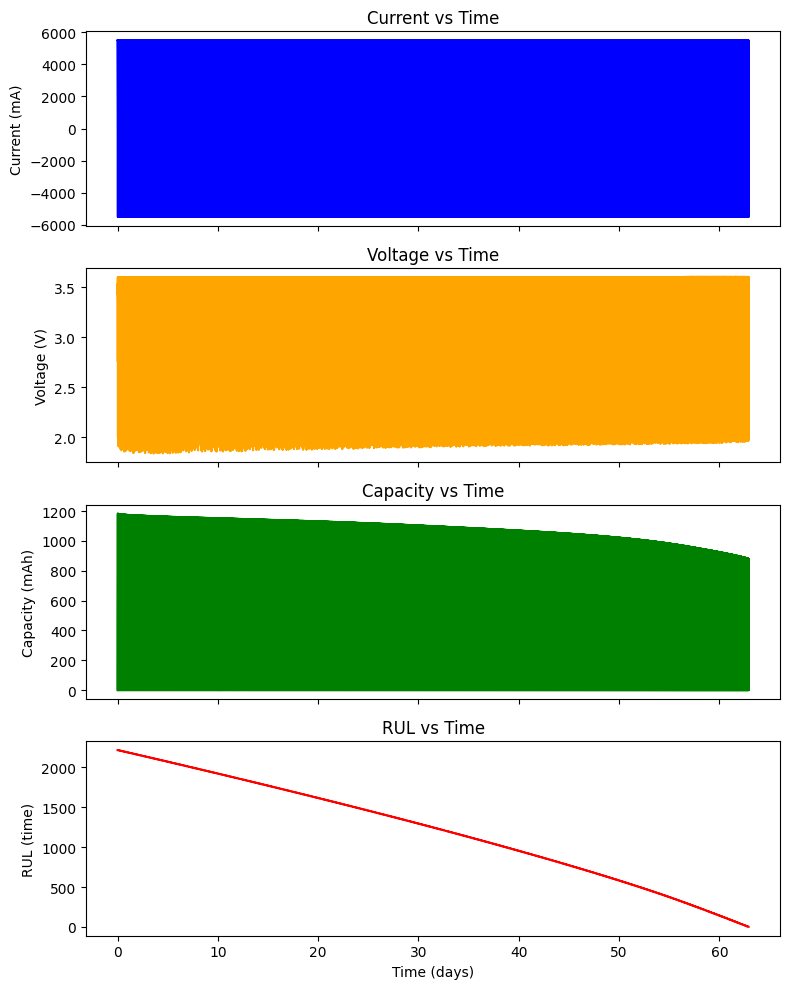

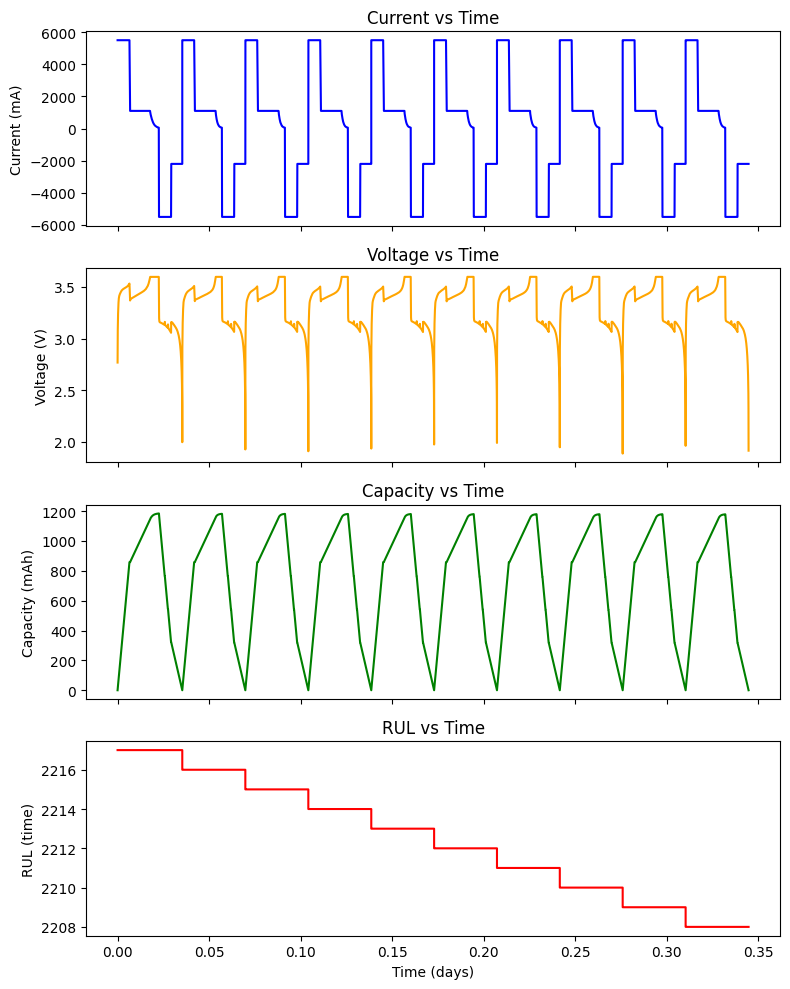

100%|██████████| 2217/2217 [01:35<00:00, 23.28it/s]


In [22]:
import pandas as pd
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# Precompute constant
C_rated = 1100.0 * 3600

    

os.makedirs('plots/',exist_ok=True)
os.makedirs('csvs/',exist_ok=True)

for cycle_regimen in filenames_without_pkl:
    #cycle_regimen = random.choice(filenames_without_pkl)#'10-1'
    unpickled_df = pd.read_pickle(f'{base_path}/{cycle_regimen}.pkl')#,engine='pyarrow',dtype_backend='pyarrow')
    print(cycle_regimen)
    df = pd.DataFrame(unpickled_df[cycle_regimen])#,engine='pyarrow',dtype_backend='pyarrow')
    rul = unpickled_df[cycle_regimen]['rul']
    dq = unpickled_df[cycle_regimen]['dq']
    data = unpickled_df[cycle_regimen]['data']
    ### Faster Code ########

    # Prepare a list to store all DataFrames, so we only concatenate at the end
    df_list = []

    # Initialize the previous_last_time for cumulative time calculation
    previous_last_time = 0

    # Iterate over the data dictionary
    for cycle_number, cycle_data in data.items():
        df_data = pd.DataFrame(cycle_data)

        # Calculate cumulative time
        df_data['Time (s) cumu'] = df_data['Time (s)'] + previous_last_time

        # Add 'rul' and 'dq' columns directly without creating lists
        df_data['rul'] = rul[cycle_number]
        df_data['dq'] = dq[cycle_number]

        # Update the previous_last_time for the next cycle
        previous_last_time = df_data['Time (s) cumu'].iloc[-1]

        # Store the DataFrame in the list
        df_list.append(df_data)

    # Concatenate all DataFrames at once
    merge_df = pd.concat(df_list, ignore_index=True)

    # Sort only once if needed
    merge_df = merge_df.sort_values(by='Time (s) cumu', ascending=True).reset_index(drop=True)


    df = merge_df#.copy()

    import matplotlib.pyplot as plt

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(4, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu']/86400, df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')
    #axs[0].set_xlabel('days')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu']/86400, df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')
    #axs[1].set_xlabel('days')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu']/86400, df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    #axs[2].set_xlabel('days')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu']/86400, df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    axs[3].set_xlabel('Time (days)')

    # # Plot Capacity vs Time
    # axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
    # axs[4].set_ylabel('dq')
    # axs[4].set_title('dq vs Time')
    # axs[4].set_xlabel('Time (s)')

    # Add some spacing between plots
    plt.tight_layout()

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-full-plot.png', dpi=300)
    # Display the plots
    plt.show()


    df = merge_df#.copy()
    df = df[df['Cycle number']<11]

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(4, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu']/86400, df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')
    #axs[0].set_xlabel('Time (s)')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu']/86400, df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')
    #axs[1].set_xlabel('Time (s)')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu']/86400, df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    #axs[2].set_xlabel('Time (s)')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu']/86400, df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    axs[3].set_xlabel('Time (days)')

    # # Plot Capacity vs Time
    # axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
    # axs[4].set_ylabel('dq')
    # axs[4].set_title('dq vs Time')
    # axs[4].set_xlabel('Time (s)')

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-first-10-plot.png', dpi=300)
    # Add some spacing between plots
    plt.tight_layout()

    # Display the plots
    plt.show()

    merge_df.loc[merge_df['Capacity (mAh)'] == 0, 'previous_SOC'] = 0
    
    # Temporary storage for the computed SOC values
    cc_soc_values = np.zeros(len(merge_df))
    
    # Process each group
    for _, group in tqdm(merge_df.groupby('Cycle number')):
        # Initialize variables
        soc_values = []
        initial_SOC = 0  # Assuming this starts at 0 for each group
    
        # Iterate over each row in the group
        t_end = group.iloc[0]['Time (s)']  # Set initial t_end to the first time value
    
        for i, row in group.iterrows():
            if row["previous_SOC"] == 0:
                # Reset SOC calculation at the start of a new cycle
                initial_SOC = row["previous_SOC"]
                I_bat = row['Current (mA)']
                t_start = row['Time (s)']
                t_end = t_start  # Initialize t_end for the first row
            else:
                # Use previous SOC and time values for the next row
                t_start = t_end
                t_end = row['Time (s)']
                I_bat = row['Current (mA)']
    
            # Calculate SOC
            SOC = current_integration(initial_SOC=initial_SOC, C_rated=C_rated, I_bat=I_bat, t_start=t_start, t_end=t_end)
    
            # Update the initial_SOC for the next iteration
            initial_SOC = SOC
    
            # Store the result
            soc_values.append(SOC)
    
        # Assign computed SOC values back to the original DataFrame using loc with index slicing
        cc_soc_values[group.index] = soc_values
    
    # Finally, assign all computed SOC values to the DataFrame column in a single operation
    merge_df["CC_SOC"] = cc_soc_values
    merge_df.to_csv('csvs/'+cycle_regimen+'.csv',index=False)
    break

4-1


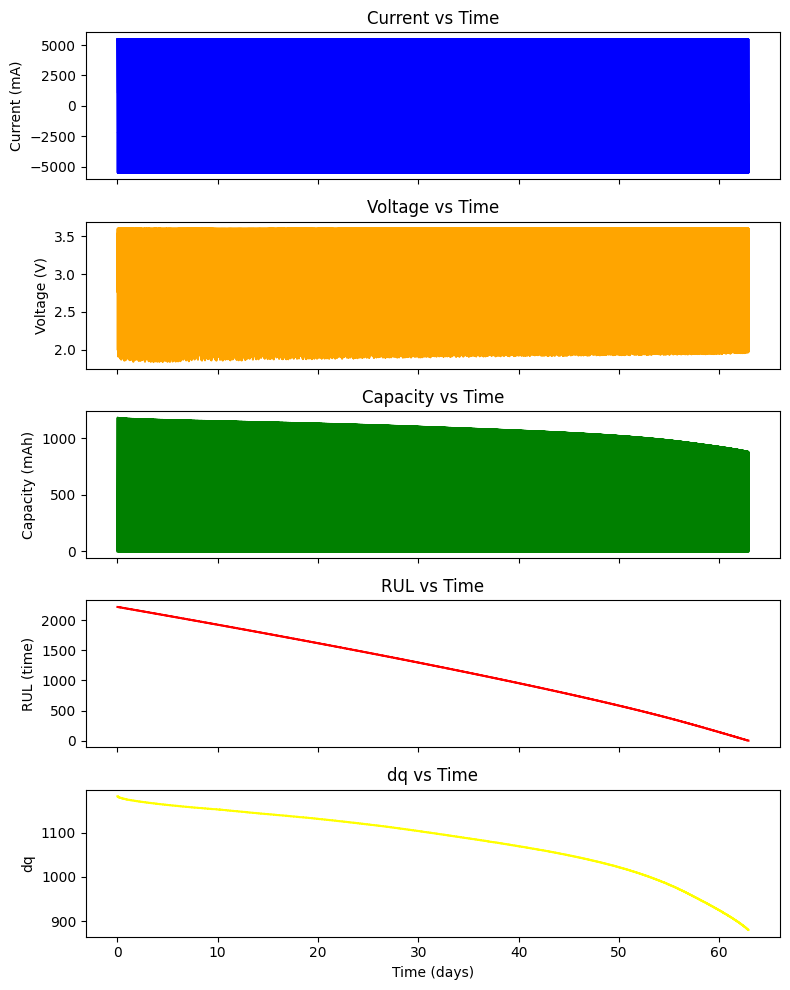

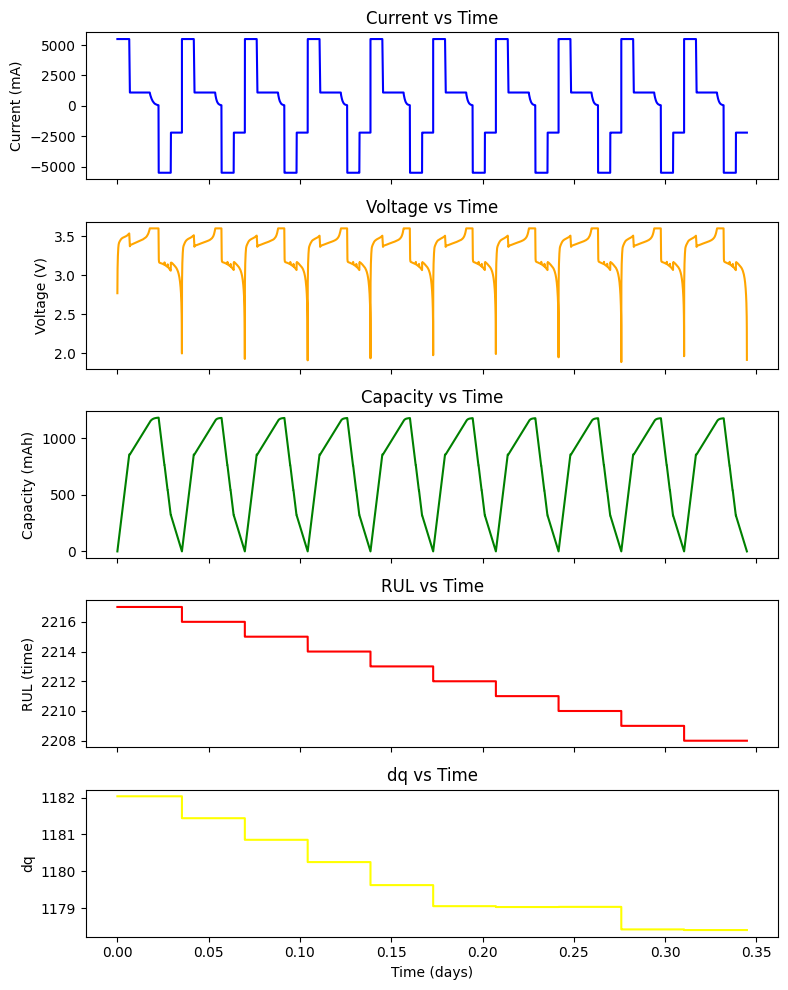

100%|██████████| 2217/2217 [01:33<00:00, 23.62it/s]


4-3


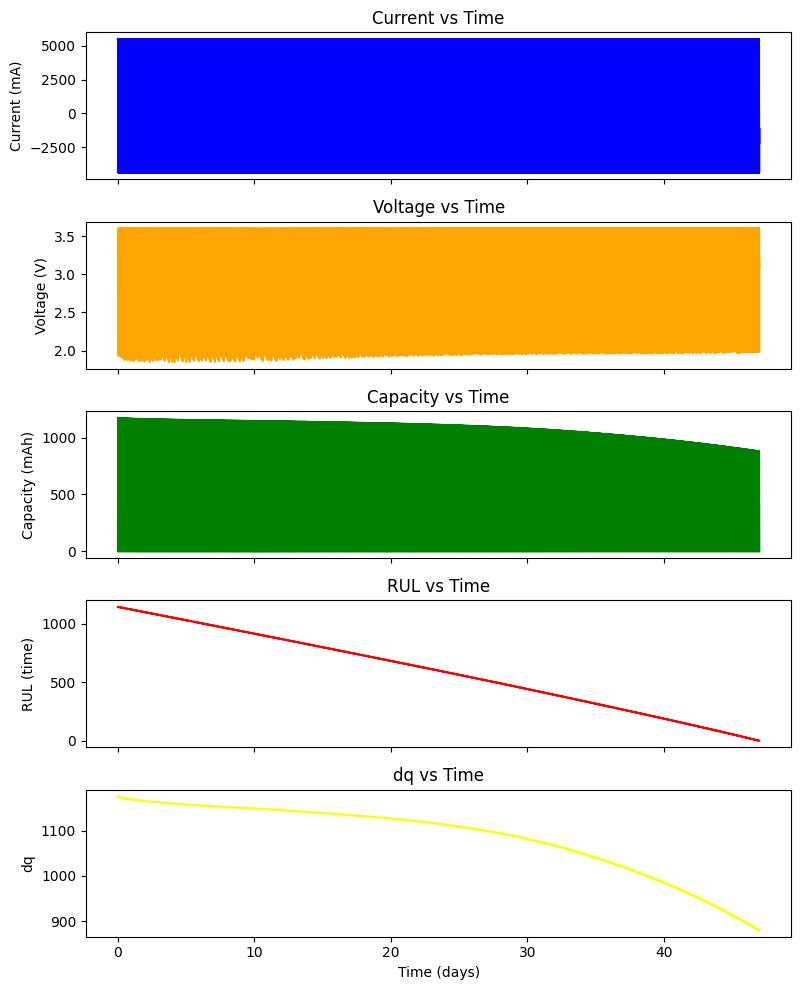

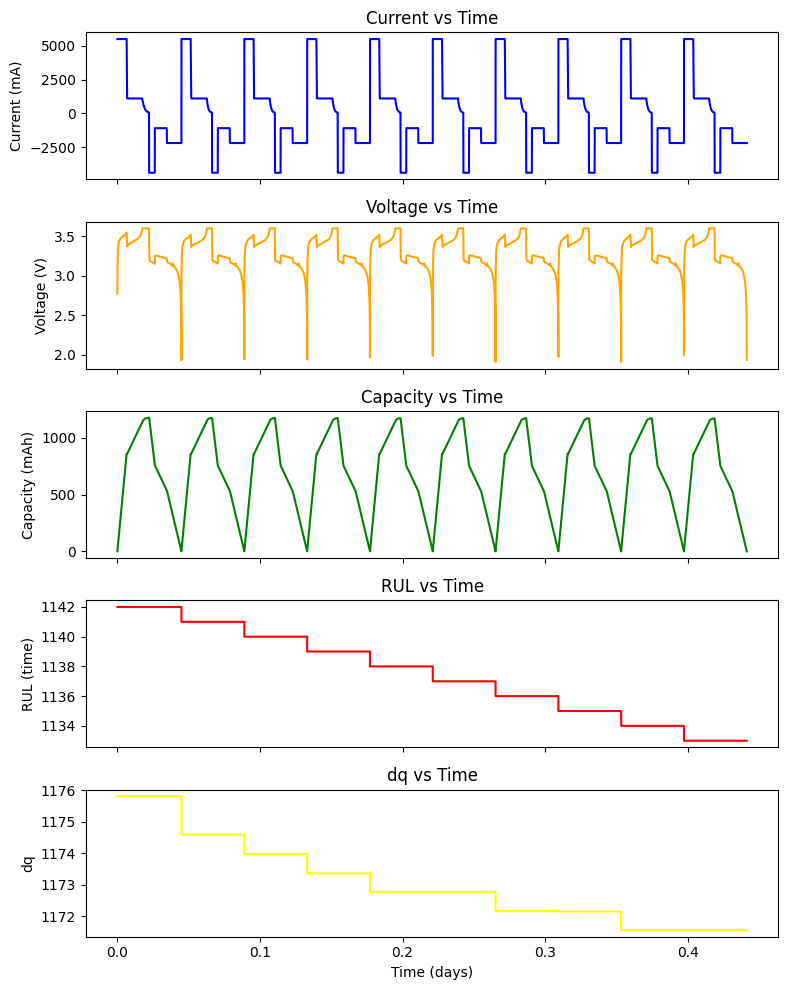

100%|██████████| 1142/1142 [01:08<00:00, 16.65it/s]


3-2


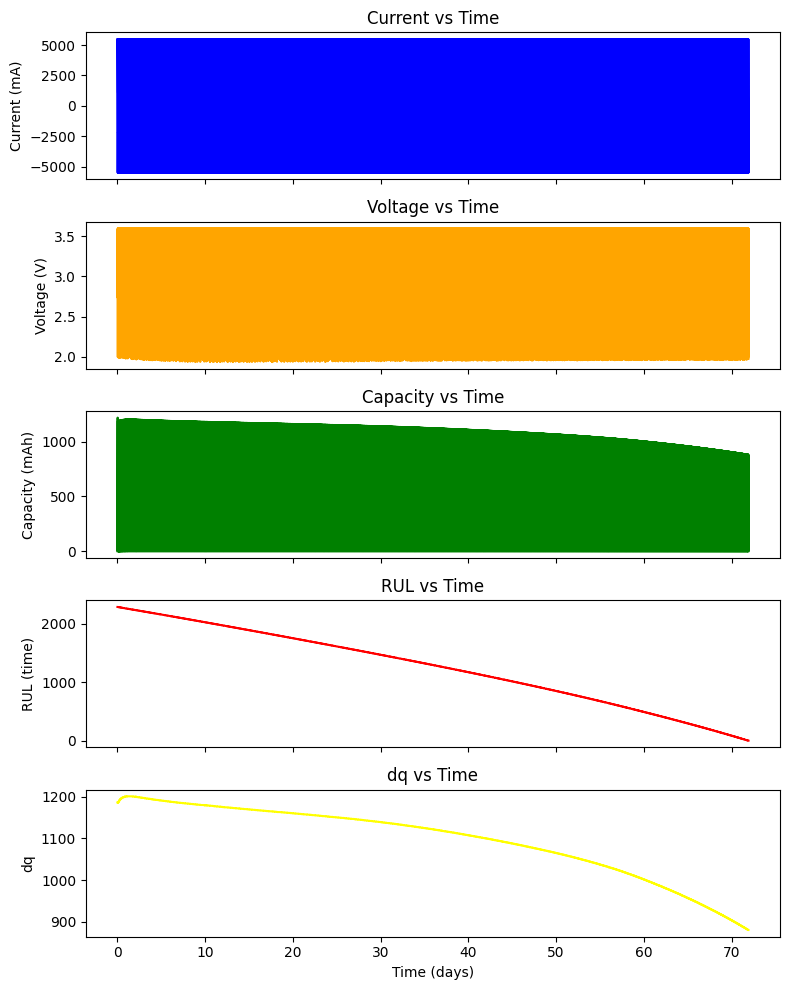

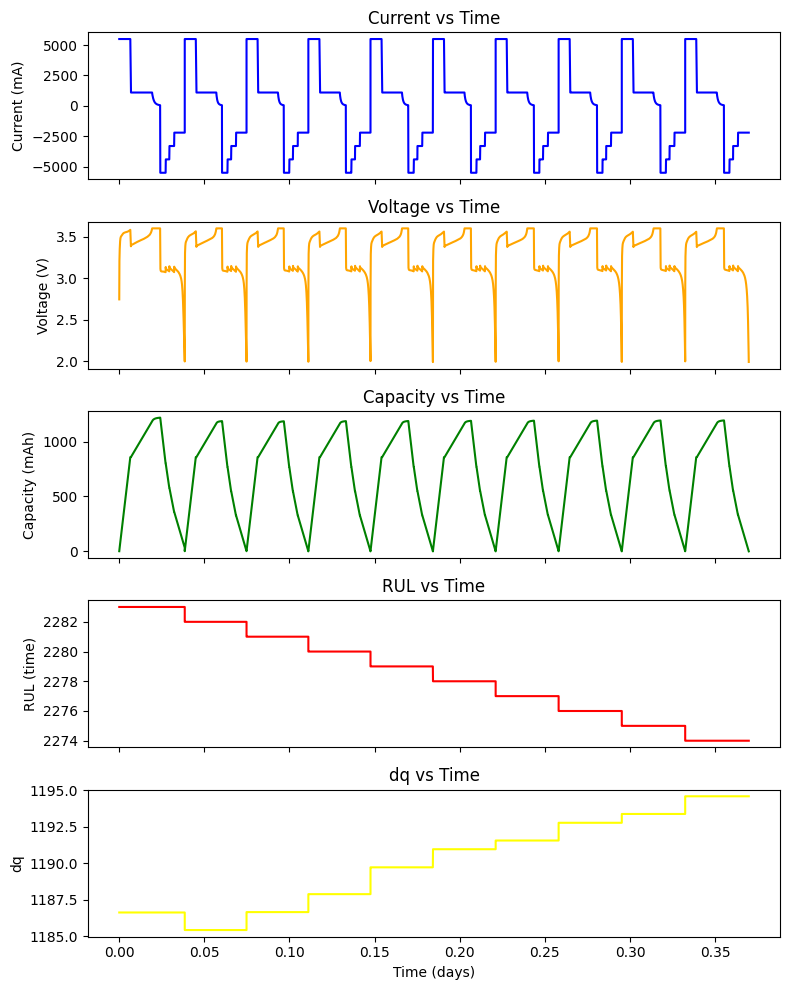

100%|██████████| 2283/2283 [01:45<00:00, 21.58it/s]


10-4


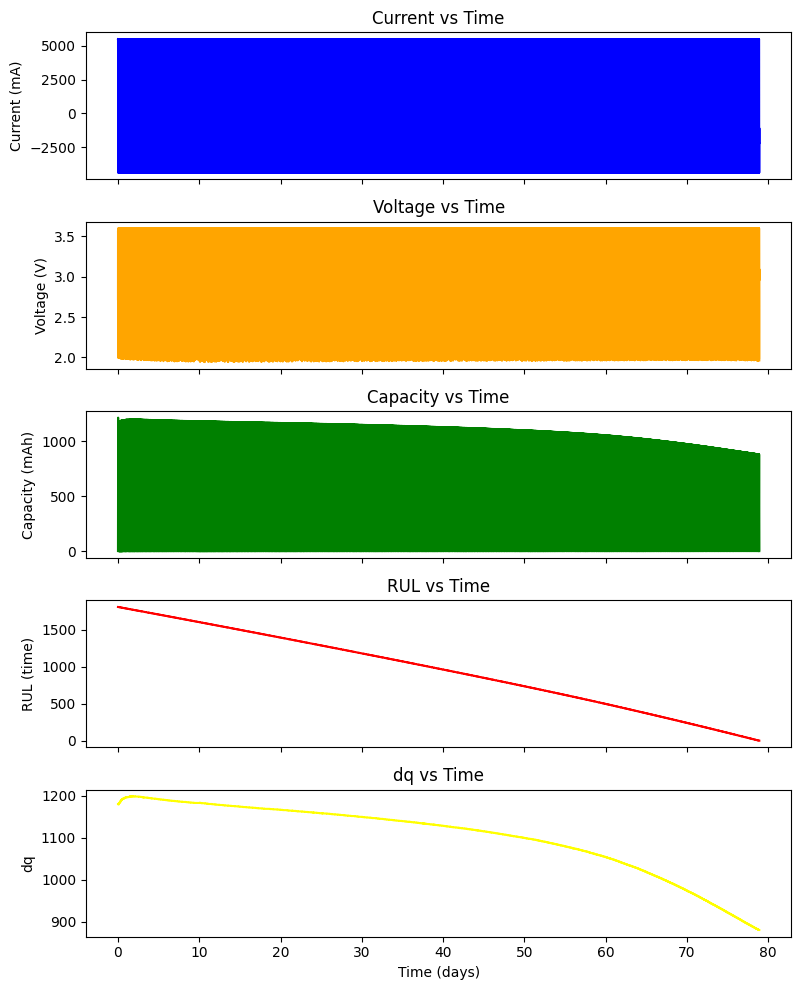

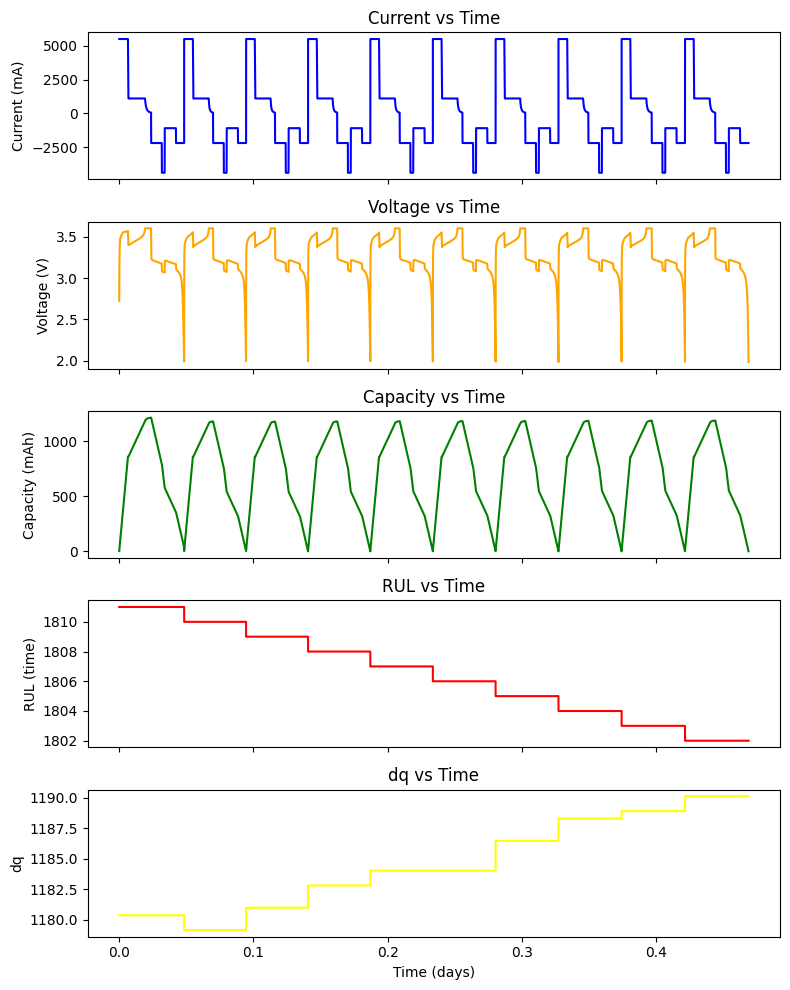

100%|██████████| 1811/1811 [01:52<00:00, 16.05it/s]


1-3


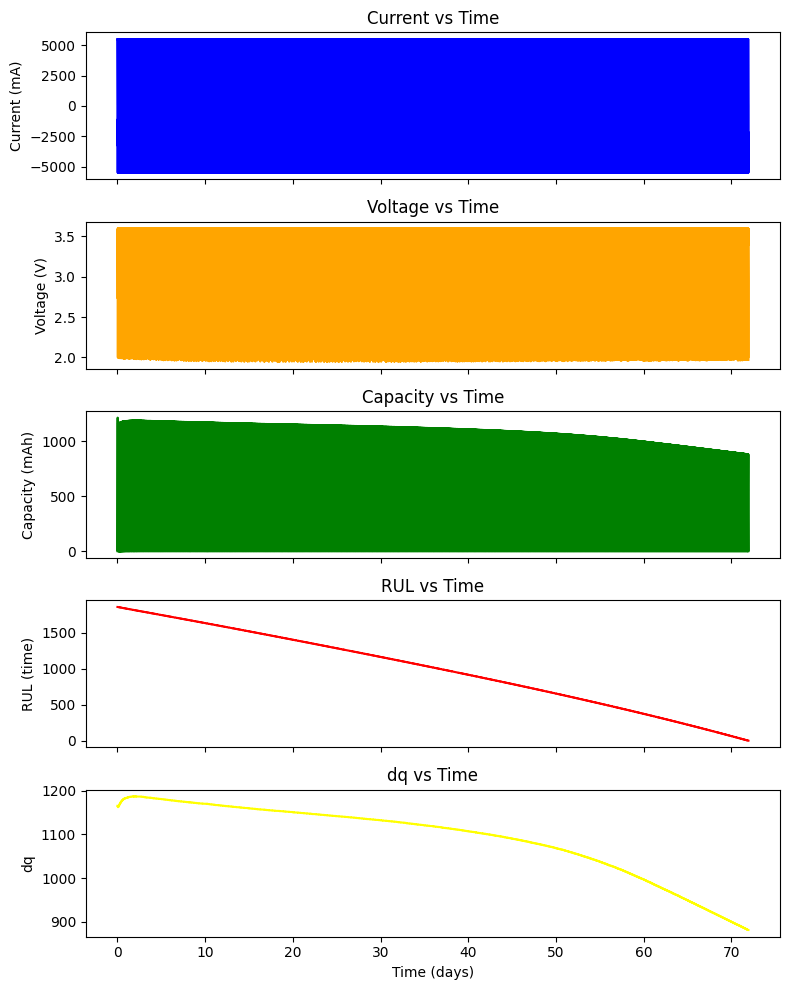

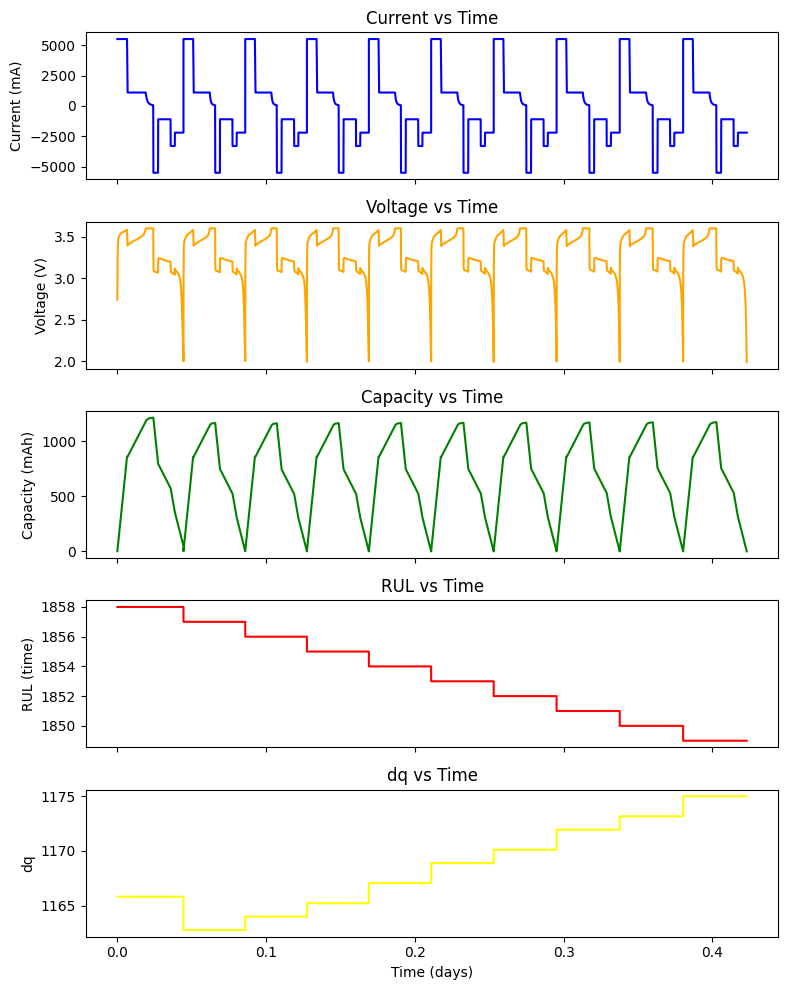

100%|██████████| 1858/1858 [01:43<00:00, 17.95it/s]


7-5


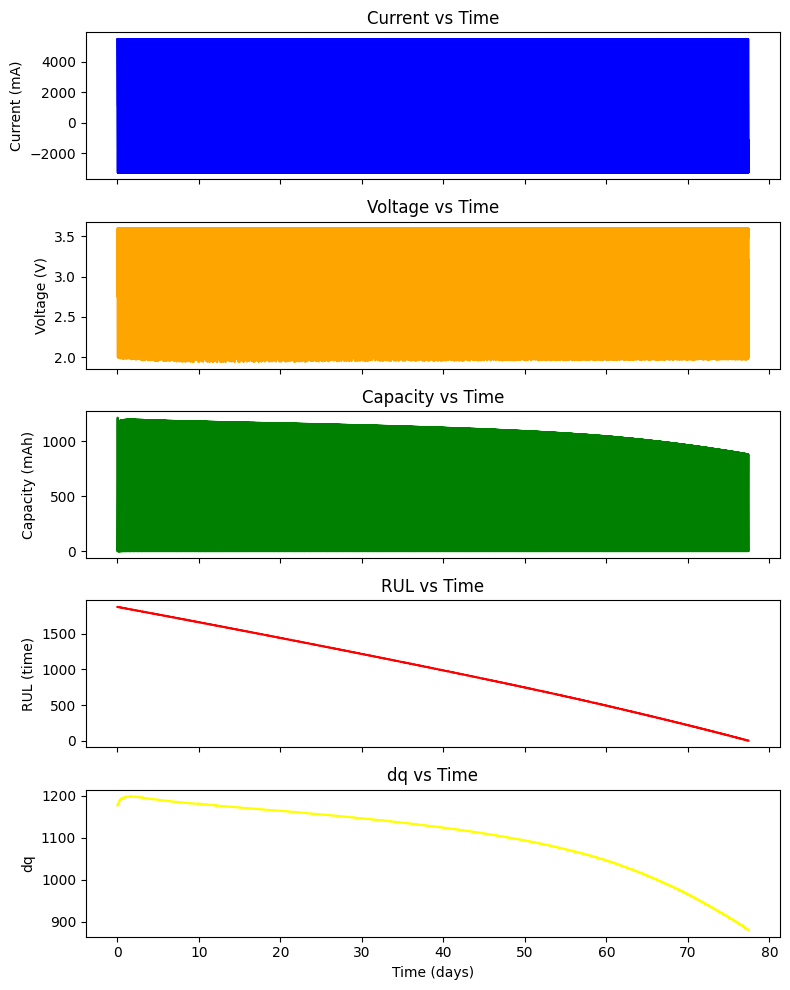

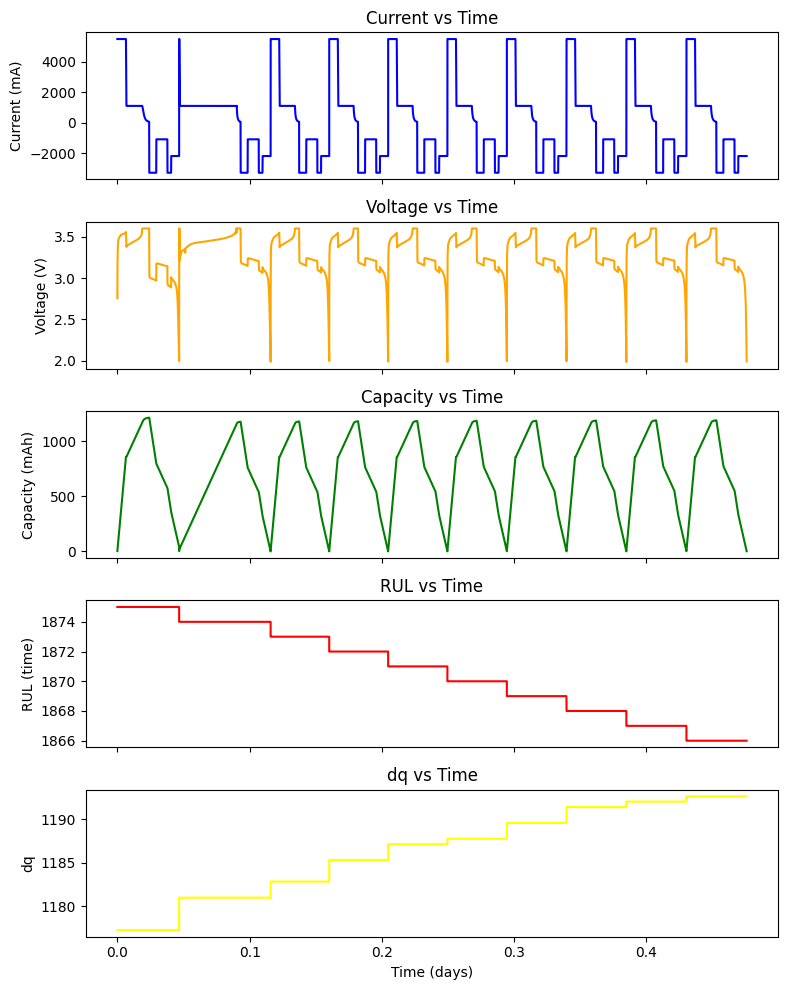

100%|██████████| 1875/1875 [01:51<00:00, 16.75it/s]


7-8


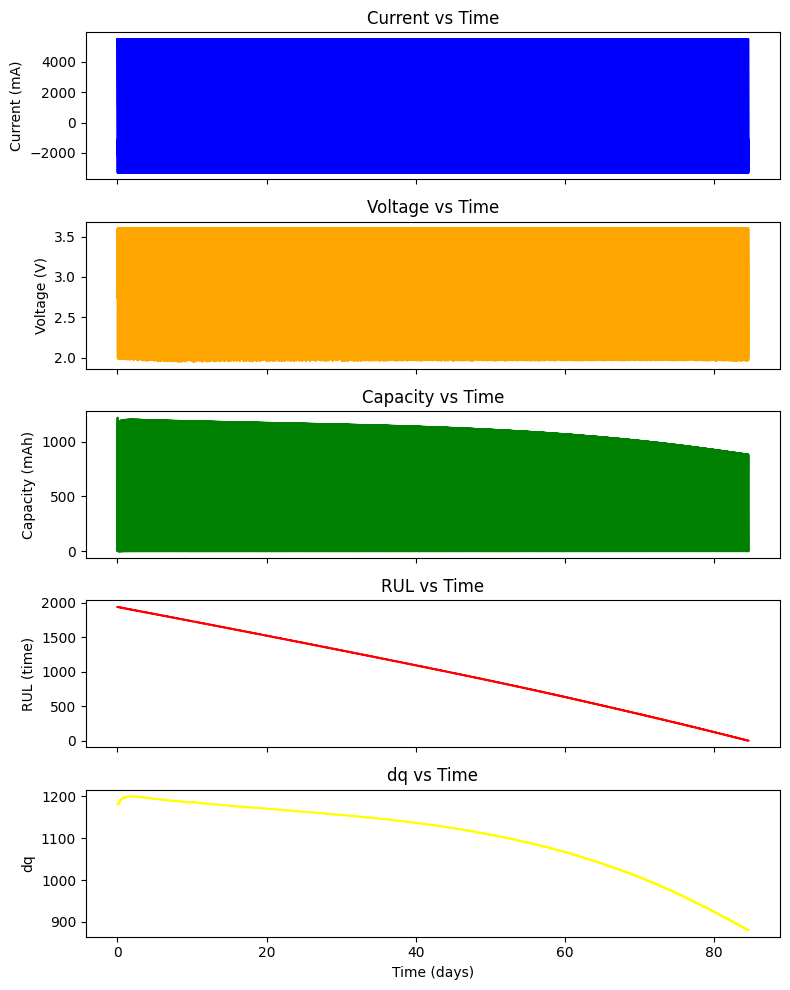

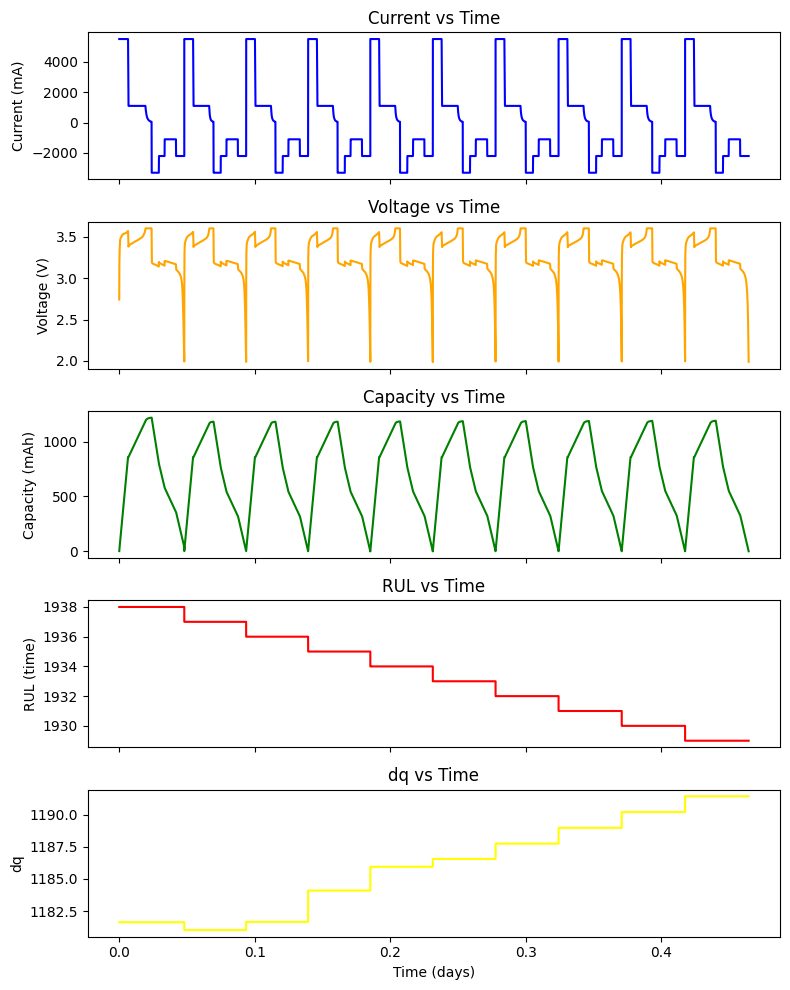

100%|██████████| 1938/1938 [02:03<00:00, 15.65it/s]


8-8


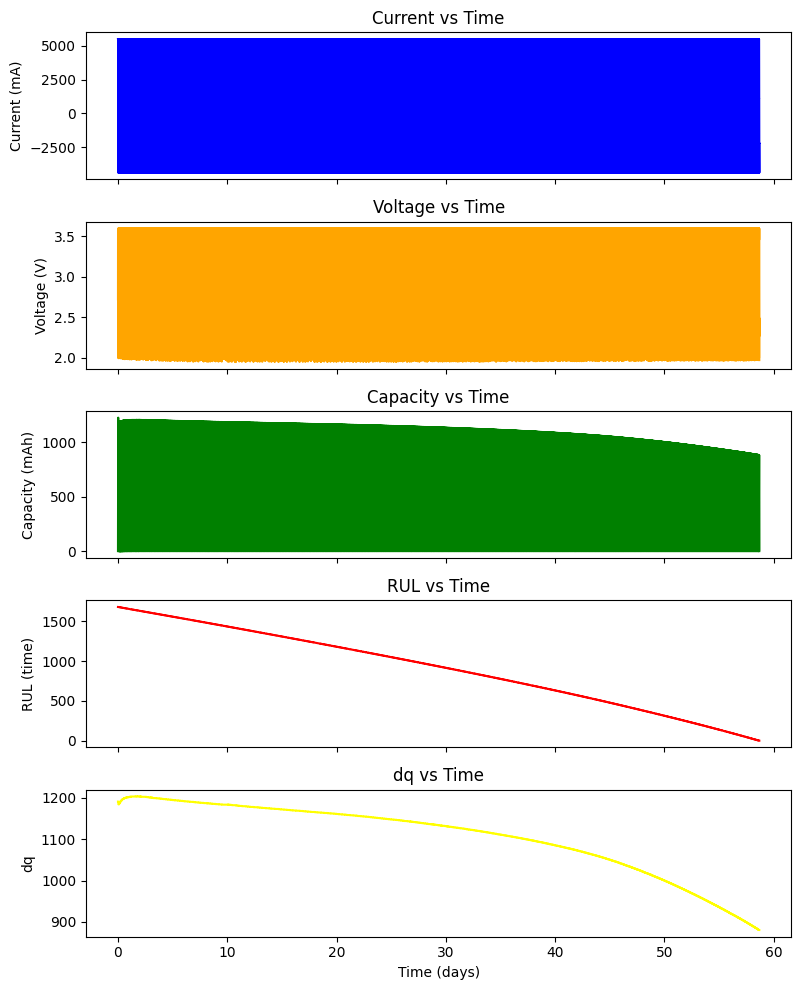

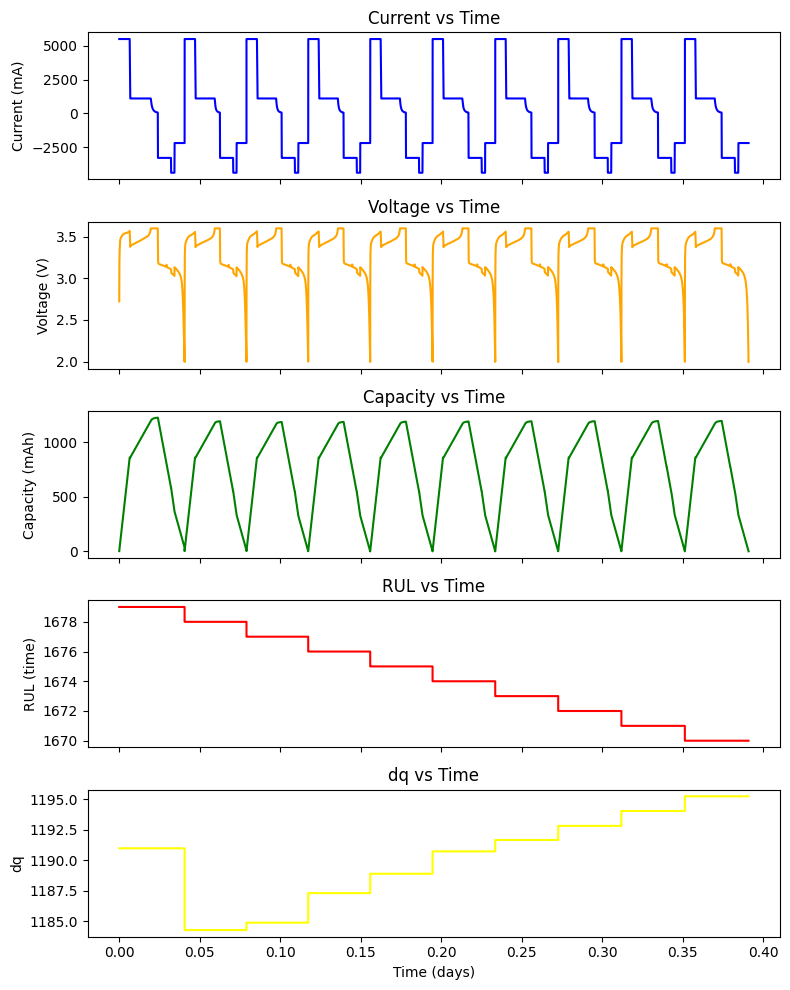

100%|██████████| 1679/1679 [01:31<00:00, 18.32it/s]


4-4


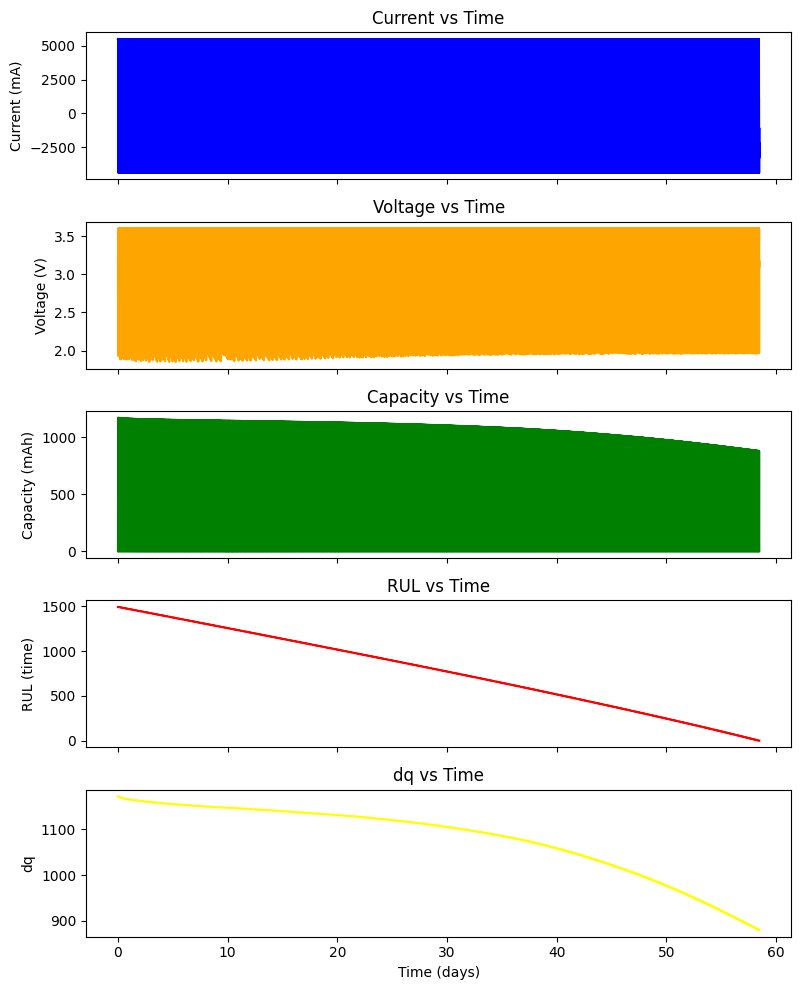

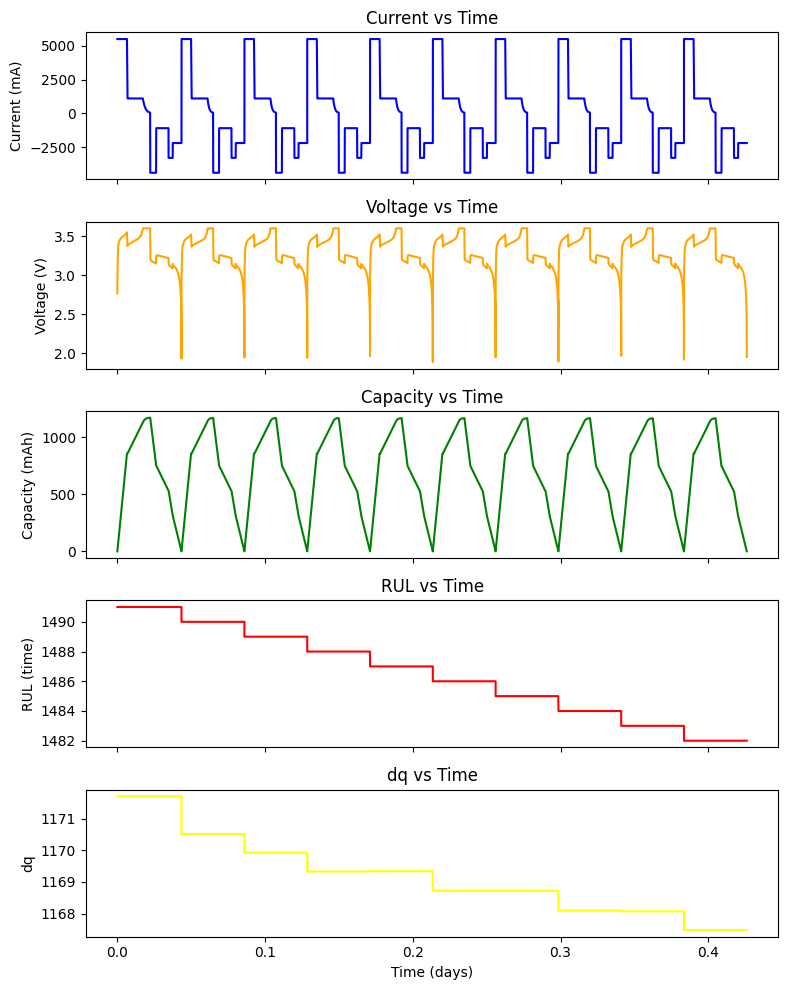

100%|██████████| 1491/1491 [01:23<00:00, 17.83it/s]


4-6


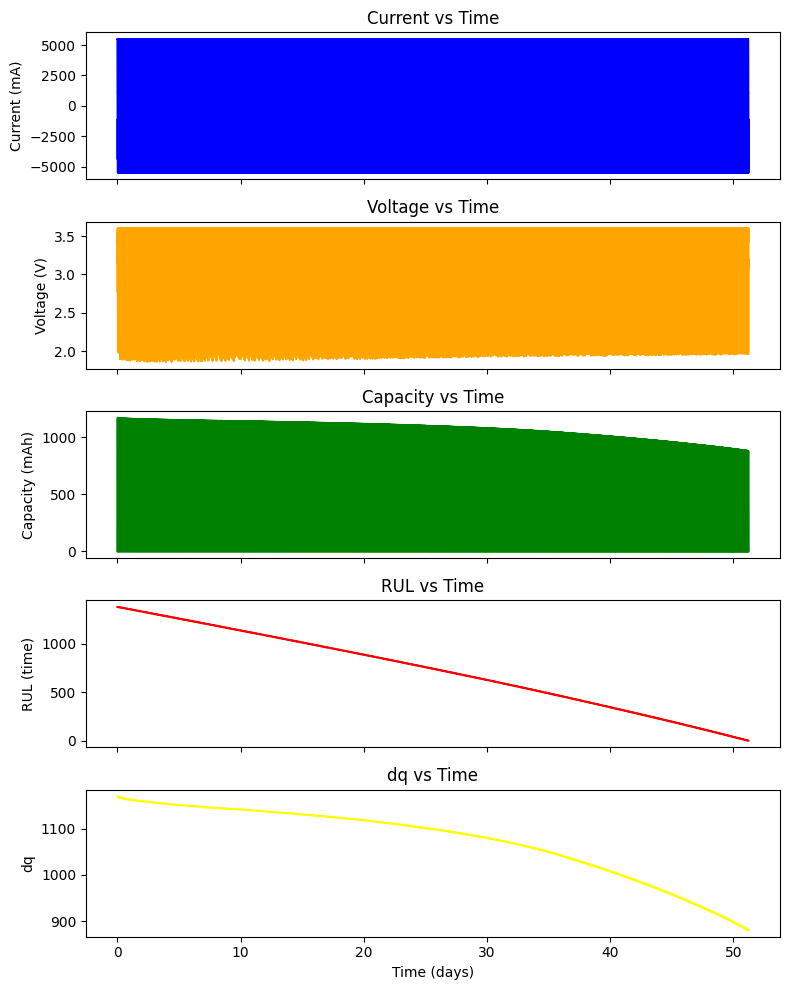

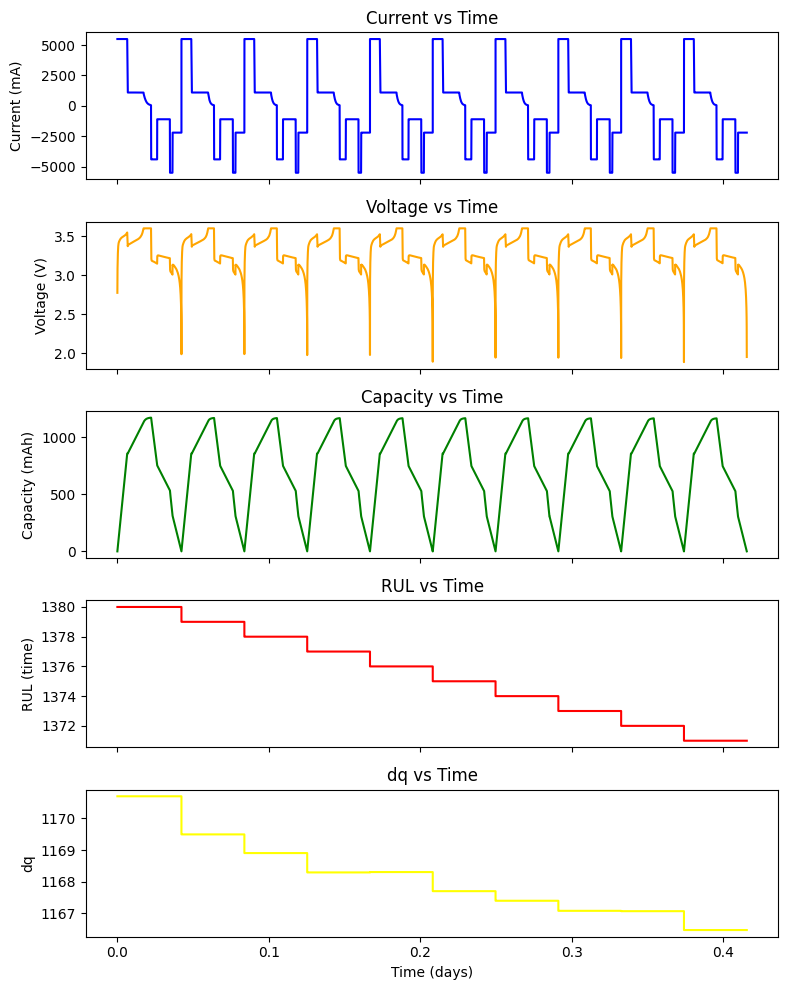

100%|██████████| 1380/1380 [01:13<00:00, 18.89it/s]


3-1


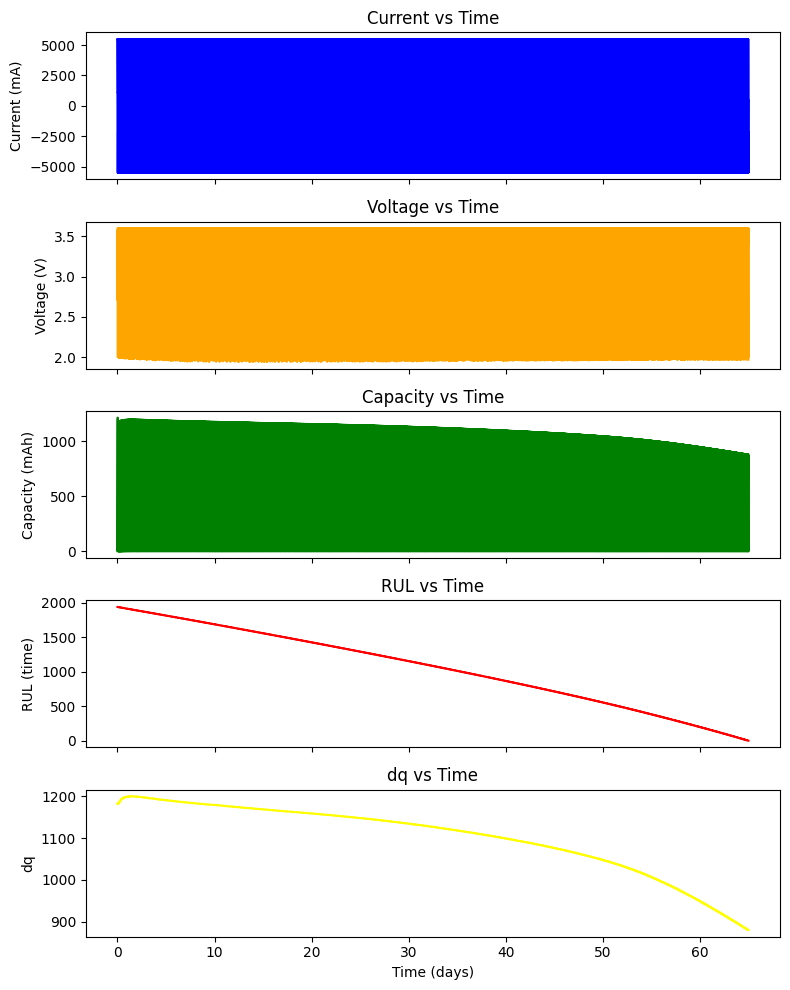

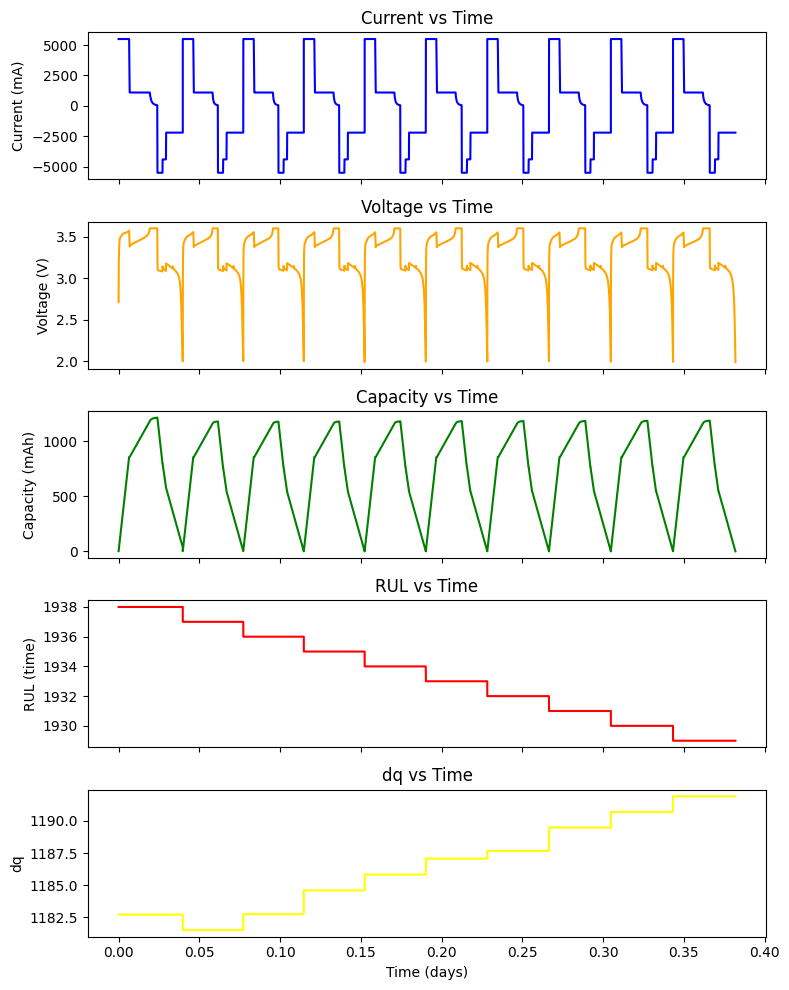

100%|██████████| 1938/1938 [01:37<00:00, 19.80it/s]


5-2


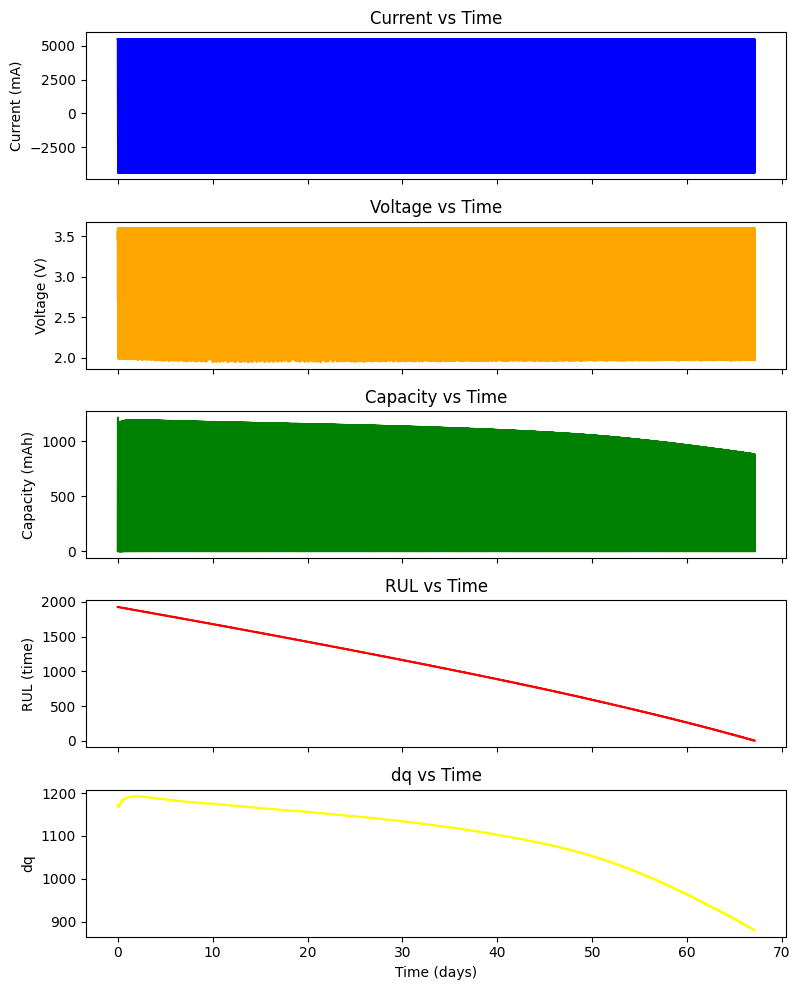

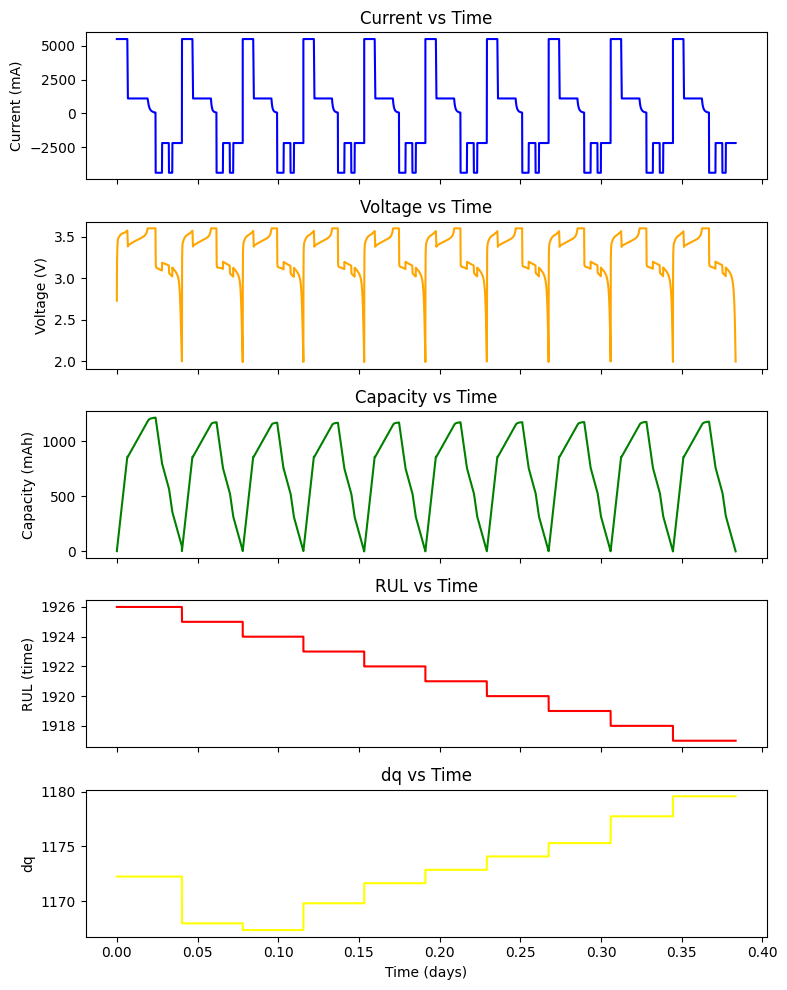

100%|██████████| 1926/1926 [01:35<00:00, 20.24it/s]


8-6


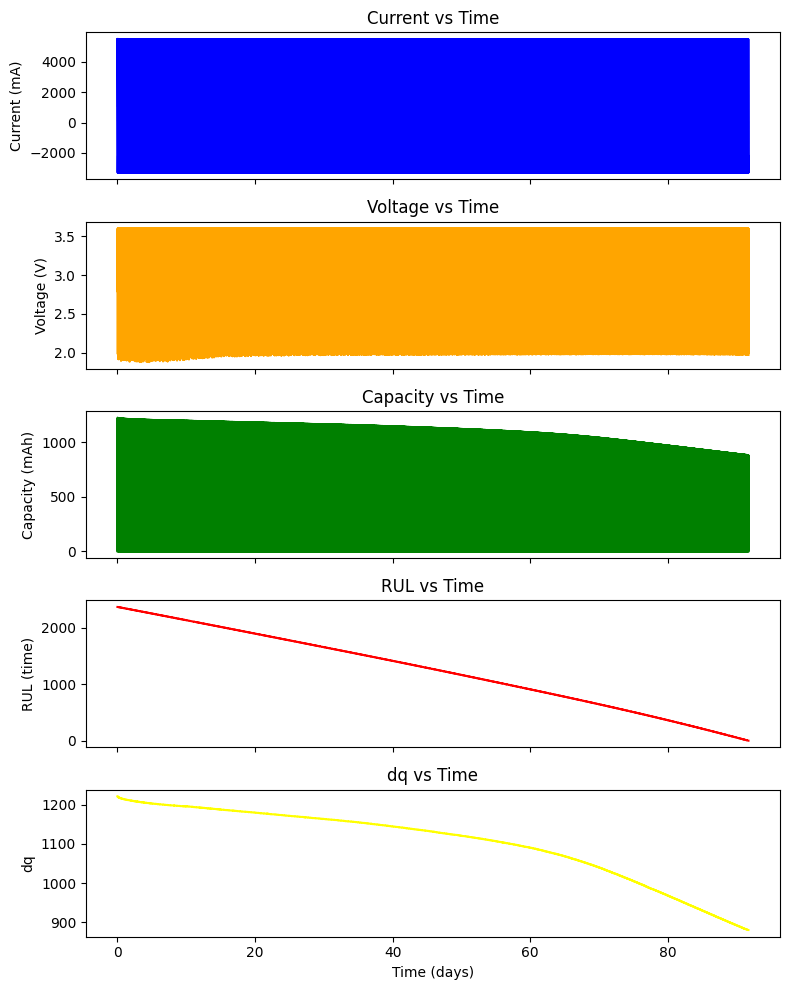

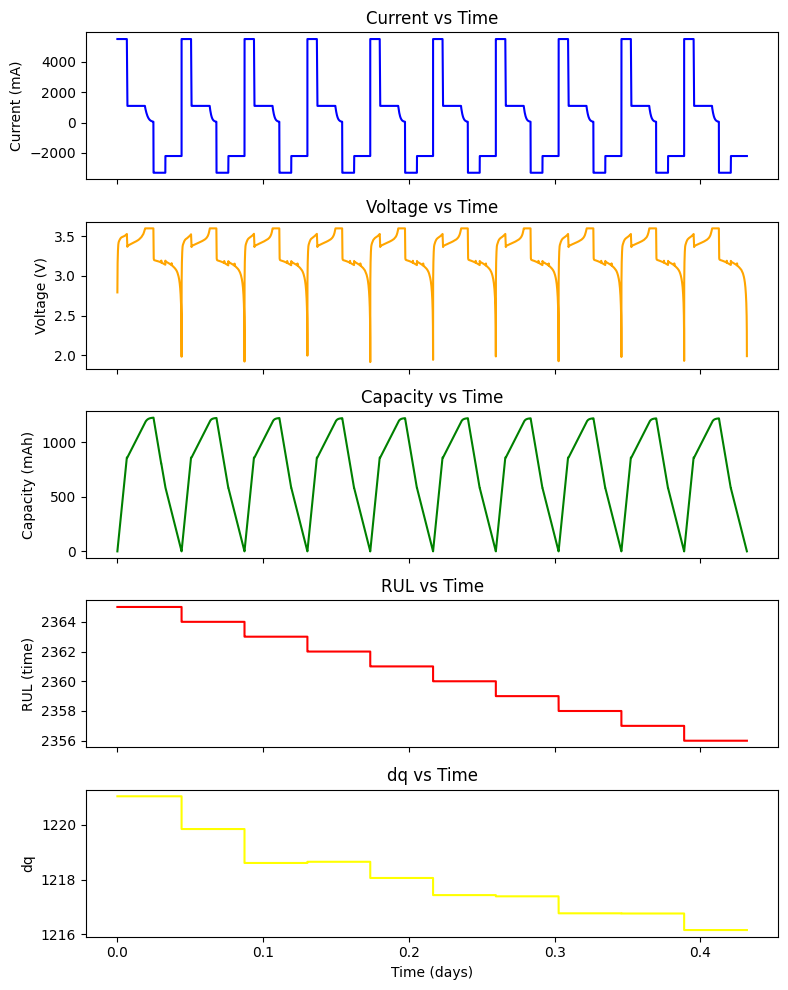

100%|██████████| 2365/2365 [02:11<00:00, 17.93it/s]


2-8


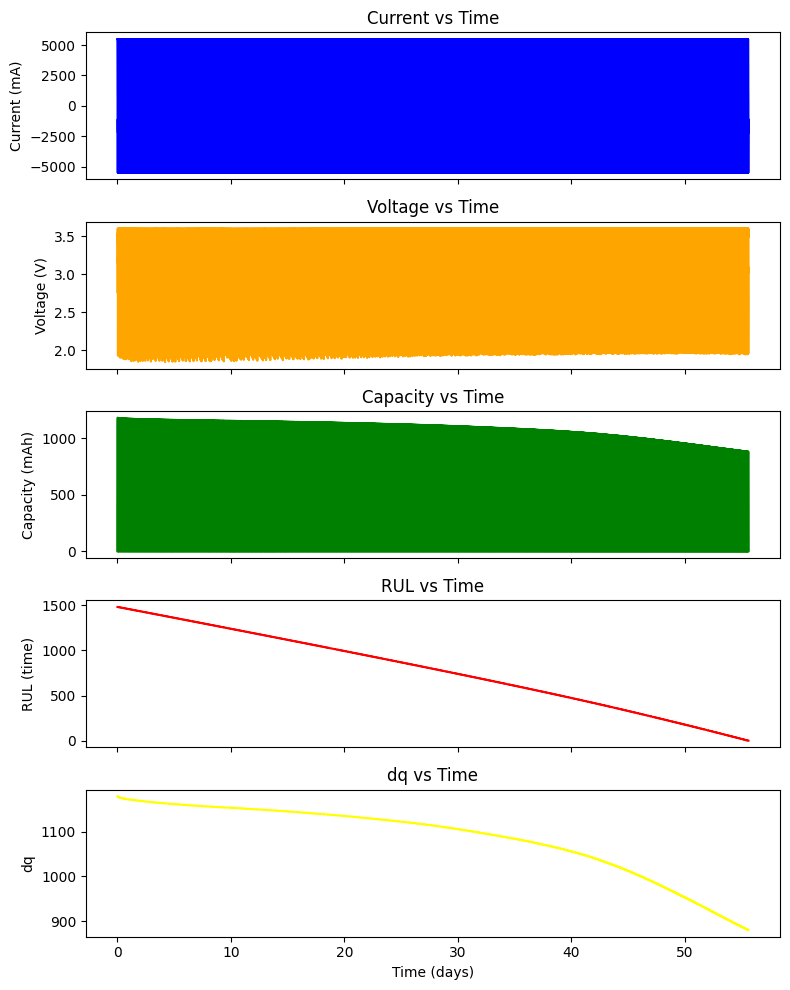

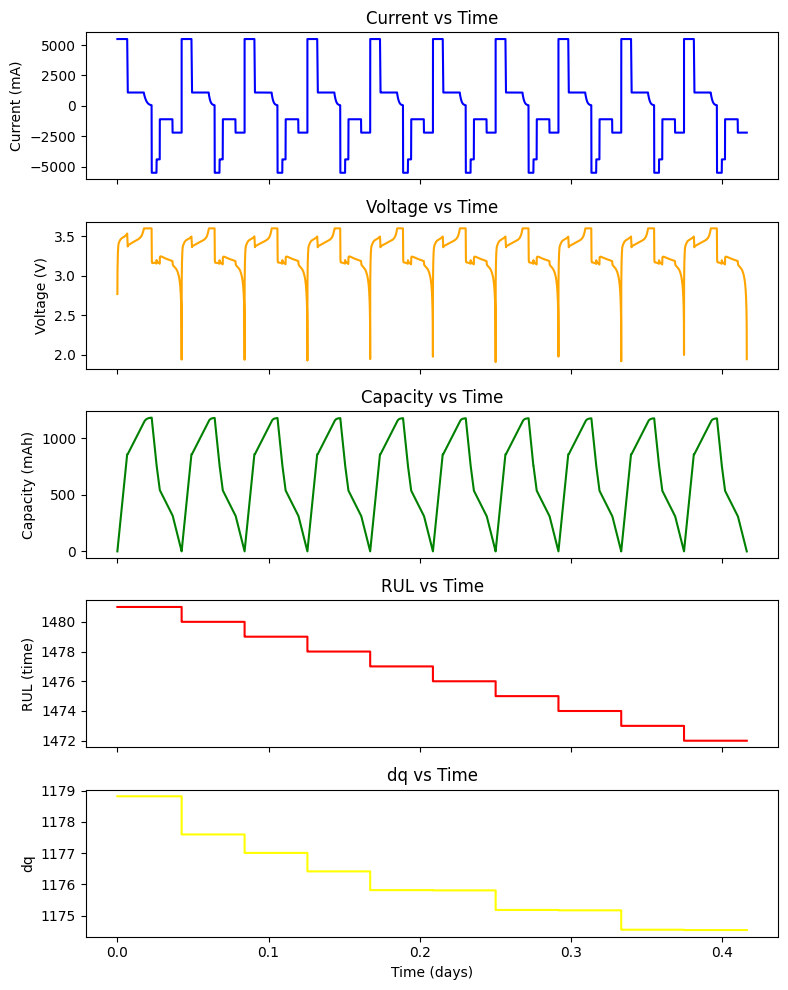

100%|██████████| 1481/1481 [01:22<00:00, 17.92it/s]


9-7


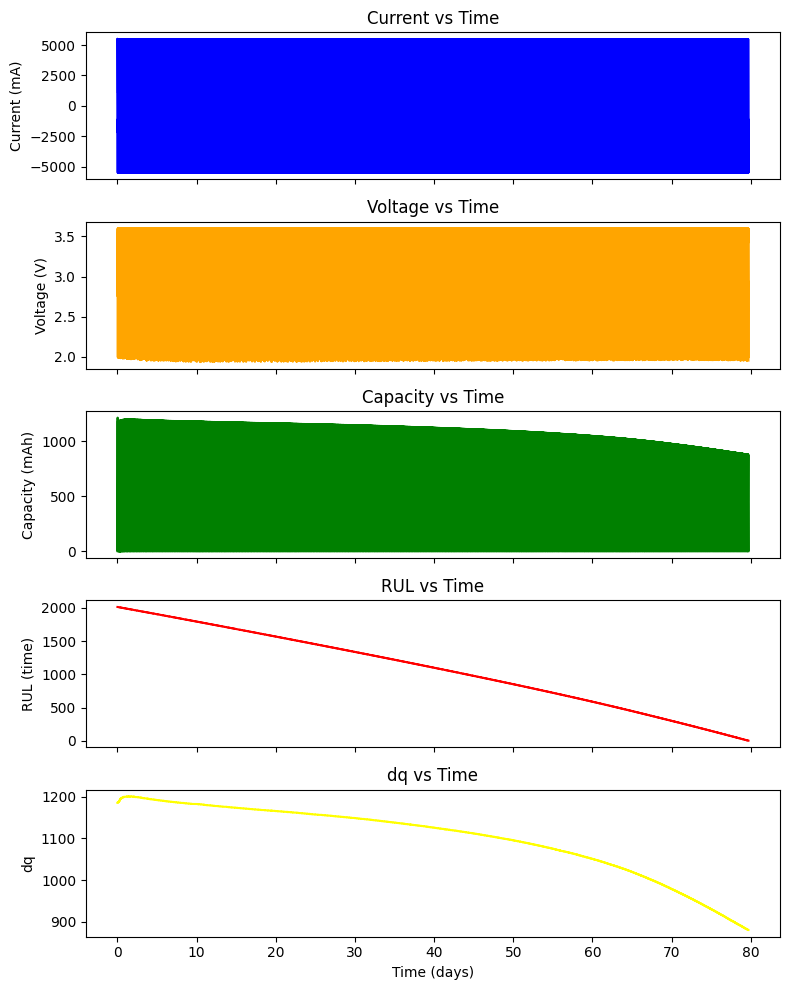

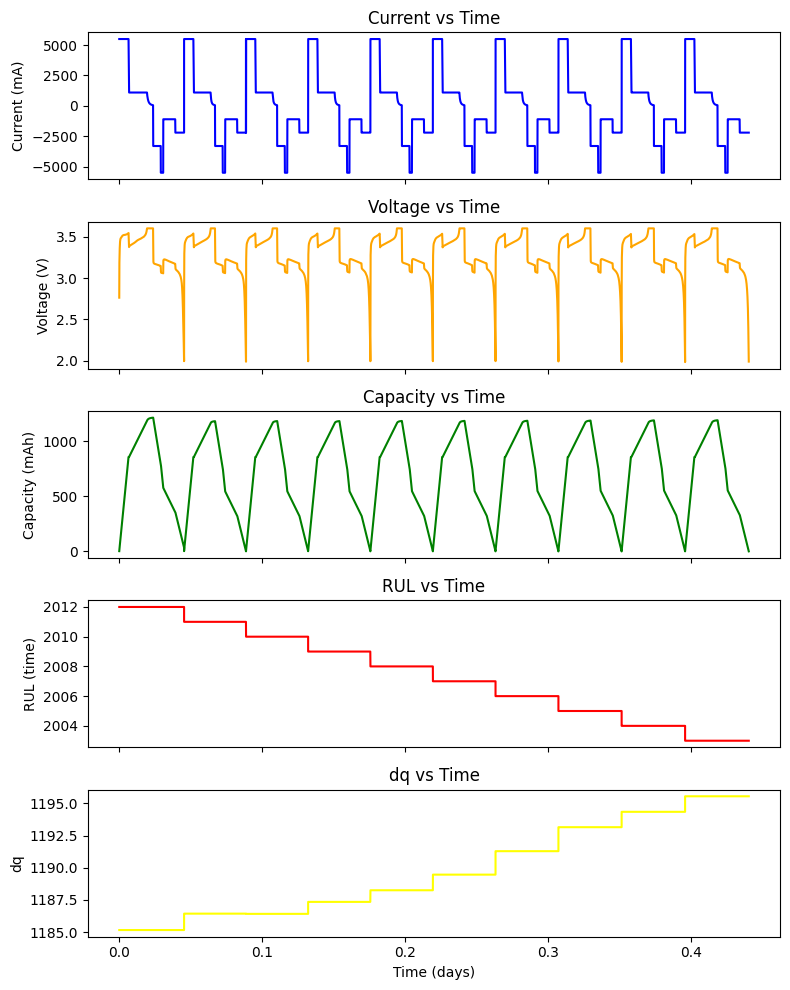

100%|██████████| 2012/2012 [01:55<00:00, 17.41it/s]


6-6


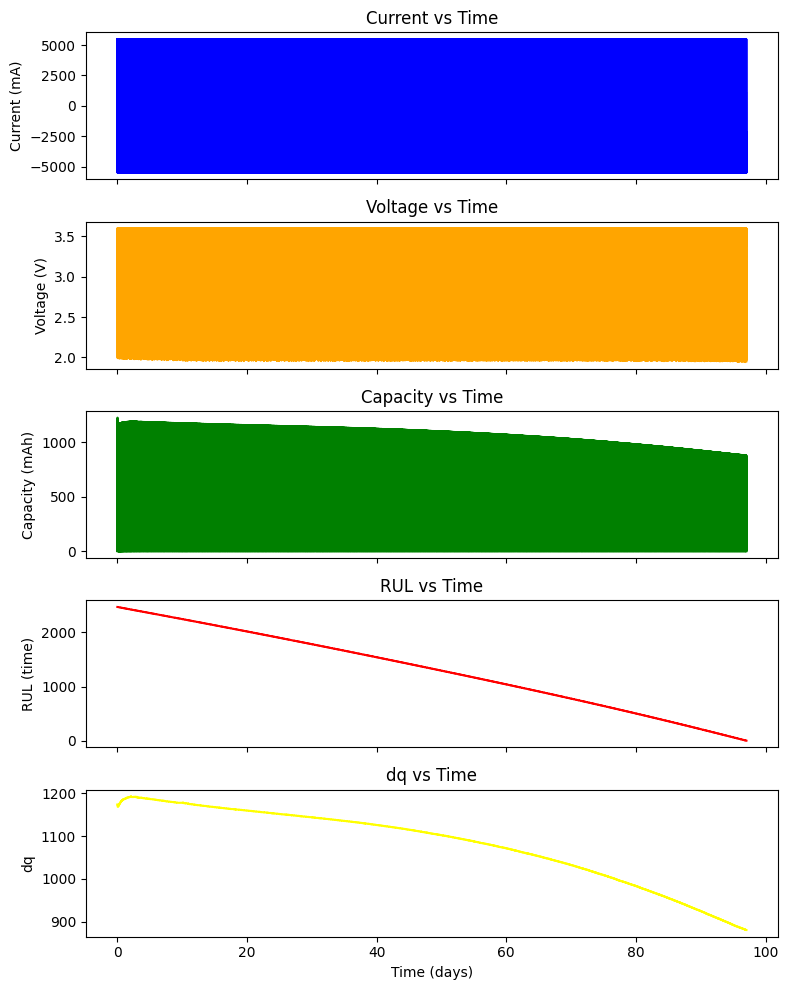

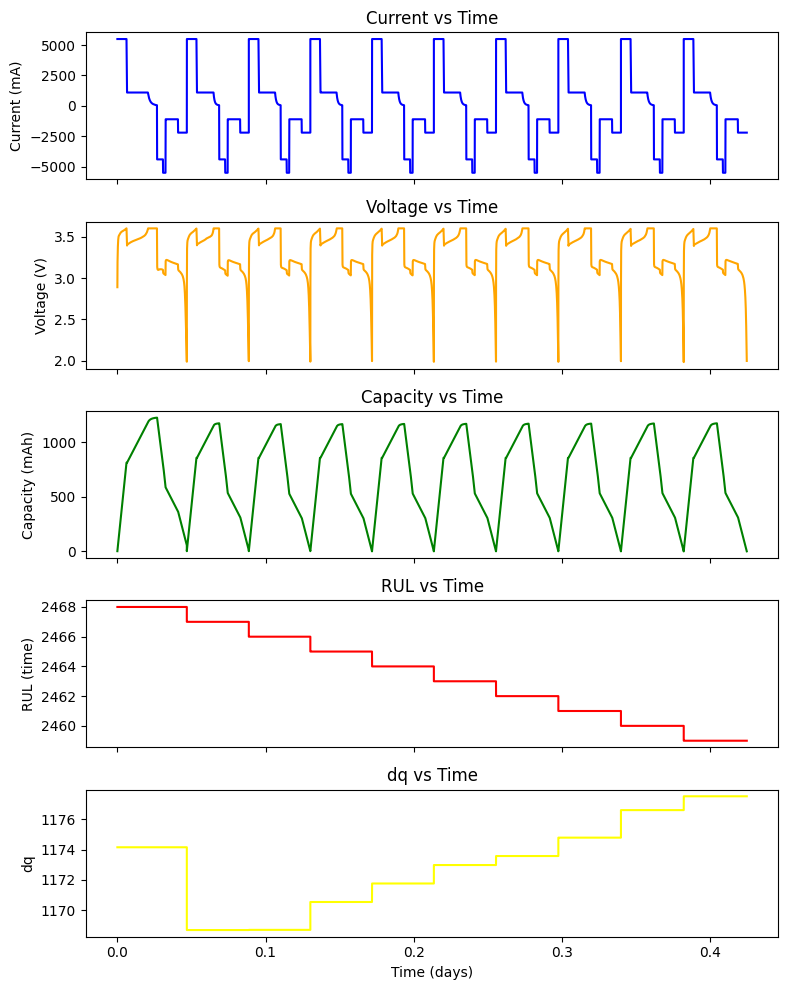

100%|██████████| 2468/2468 [02:27<00:00, 16.78it/s]


9-3


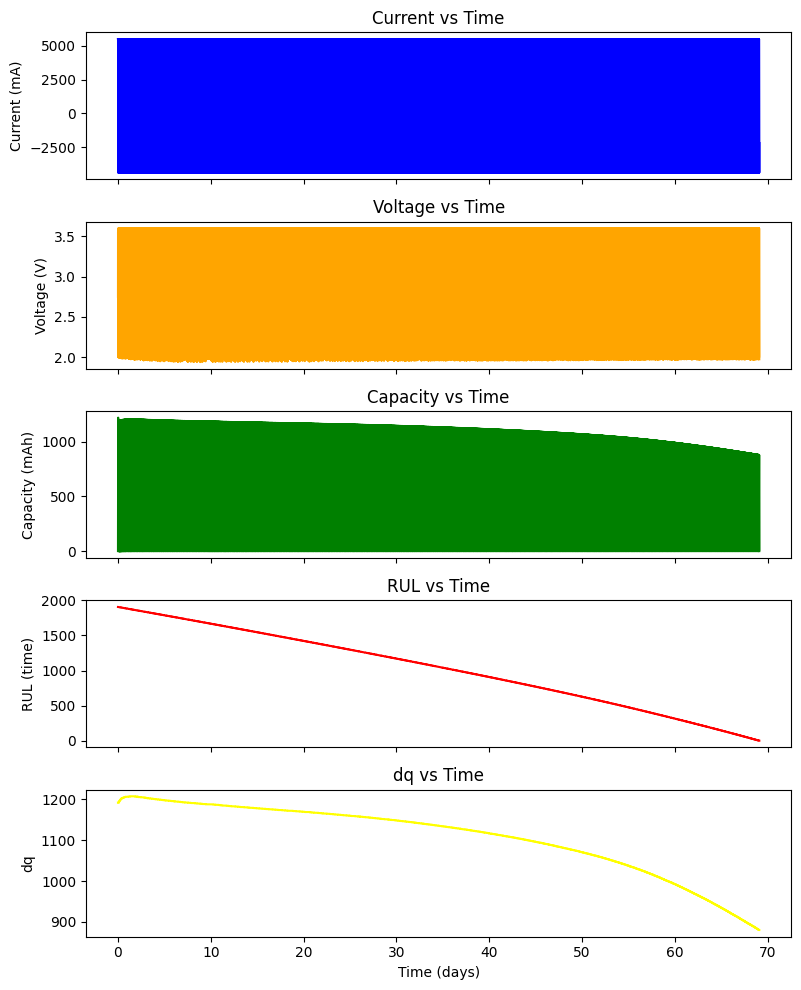

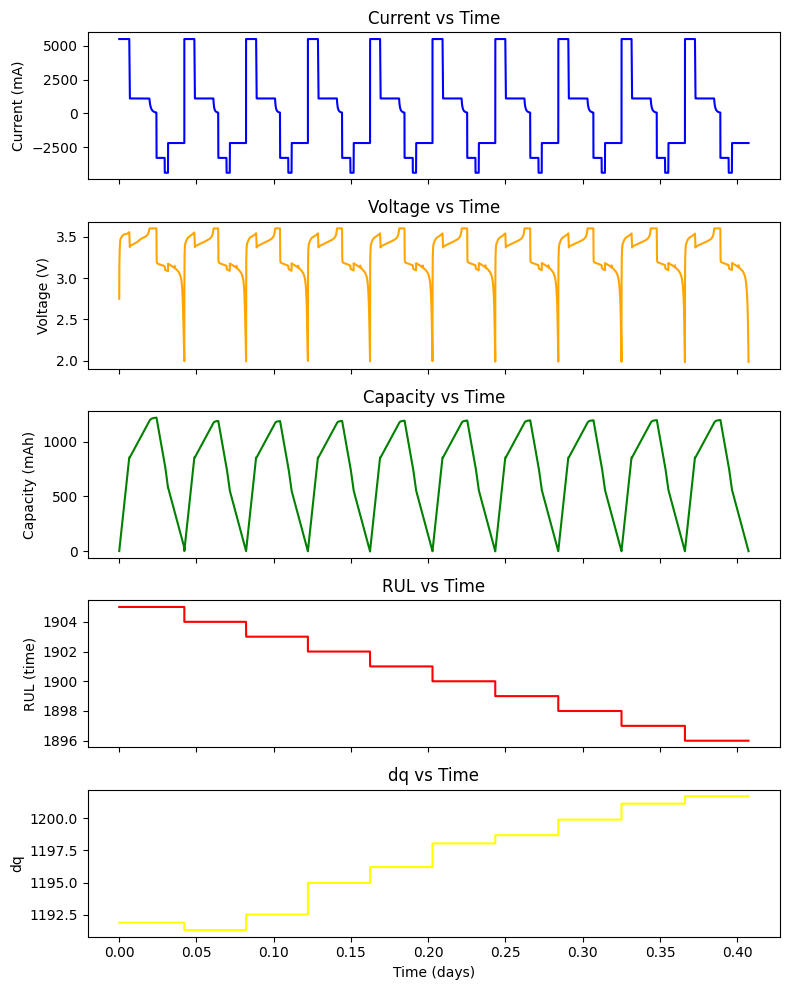

100%|██████████| 1905/1905 [01:43<00:00, 18.37it/s]


9-1


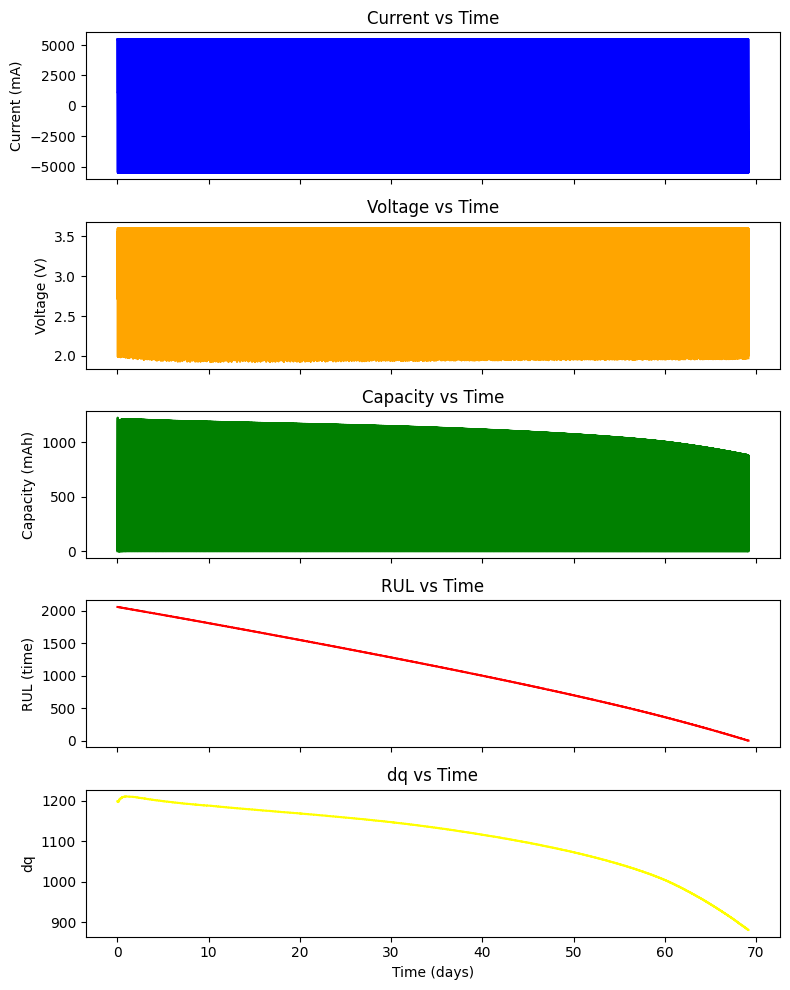

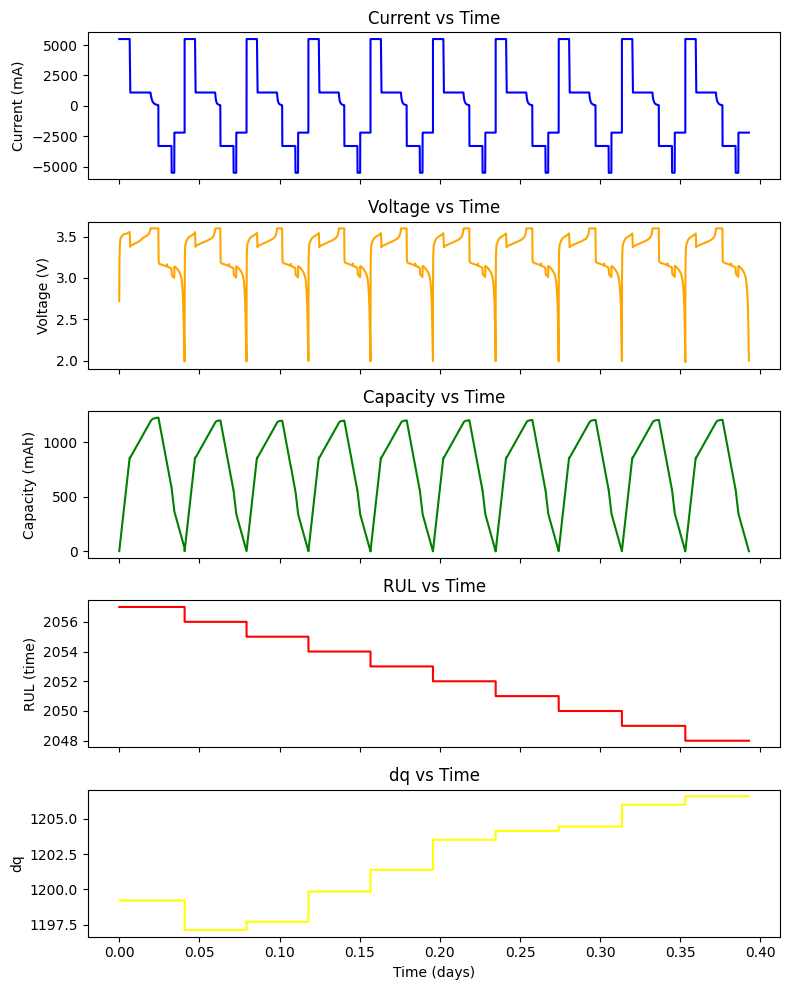

100%|██████████| 2057/2057 [01:42<00:00, 20.08it/s]


7-4


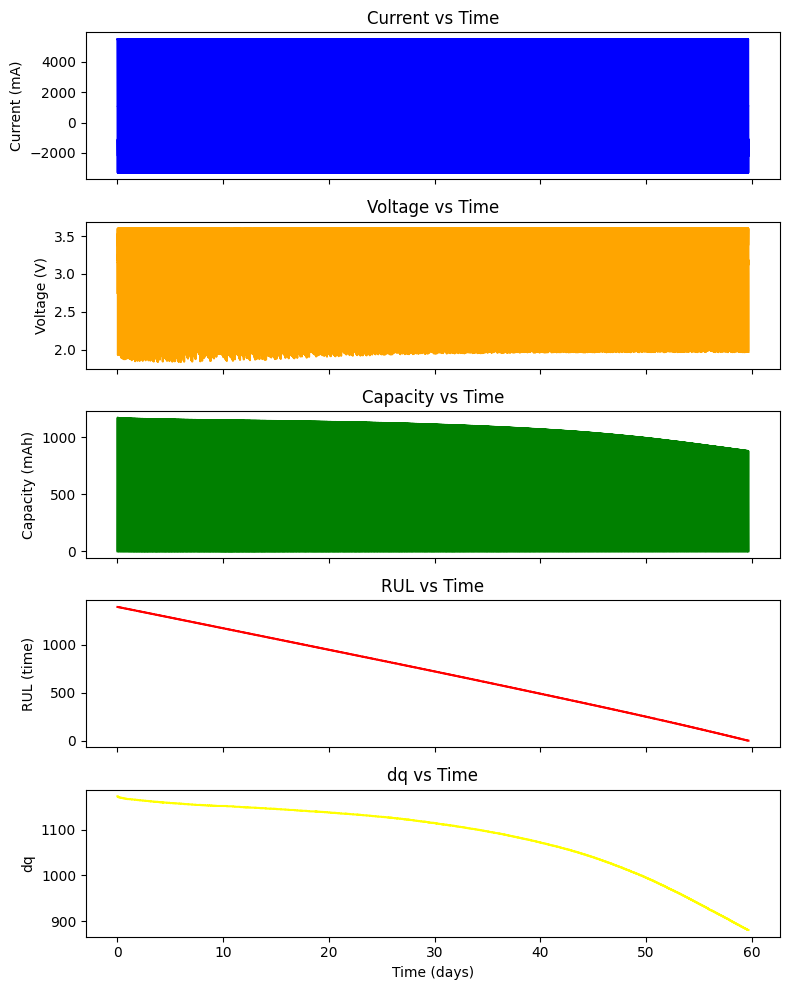

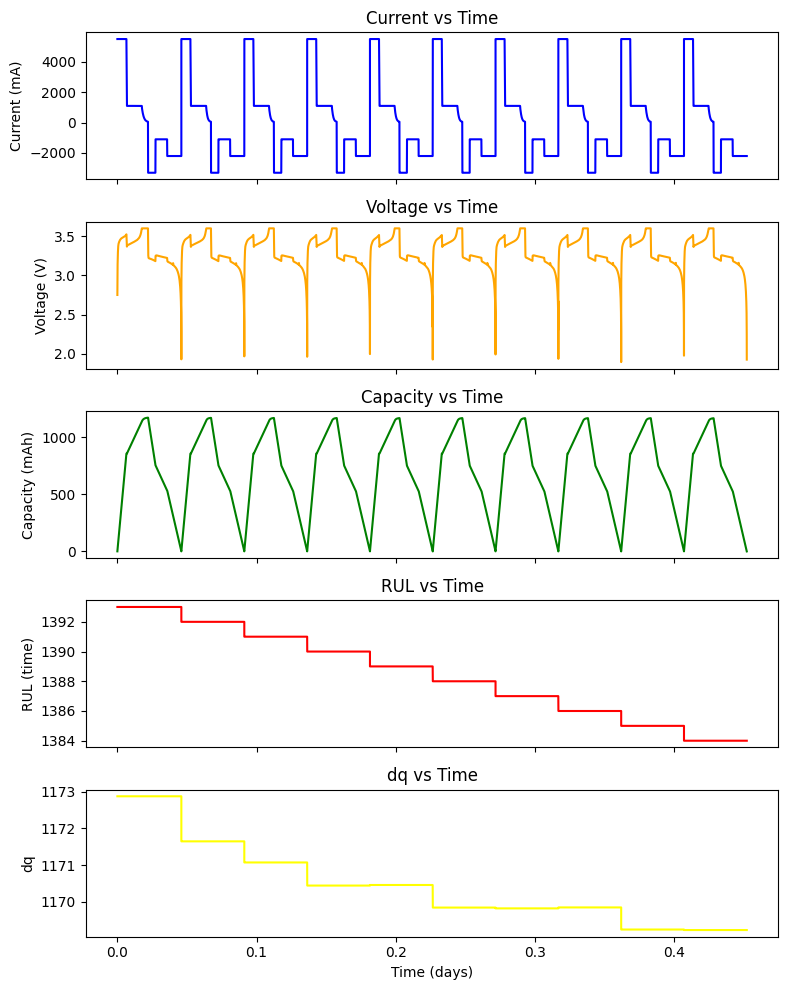

100%|██████████| 1393/1393 [01:26<00:00, 16.03it/s]


10-5


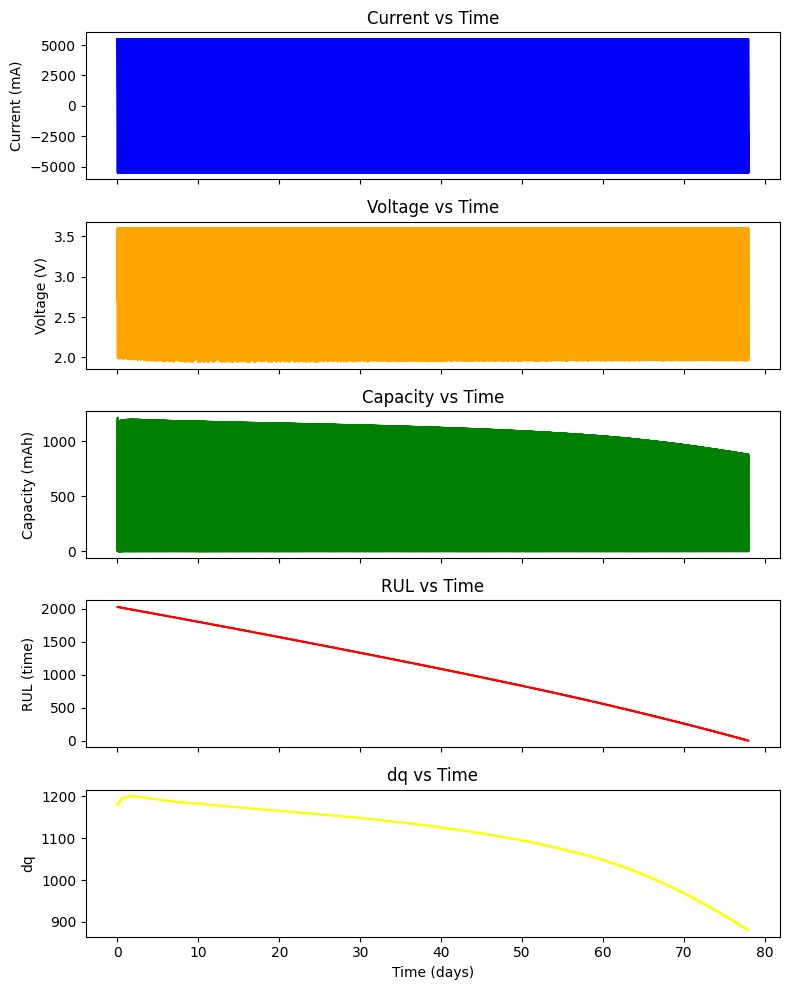

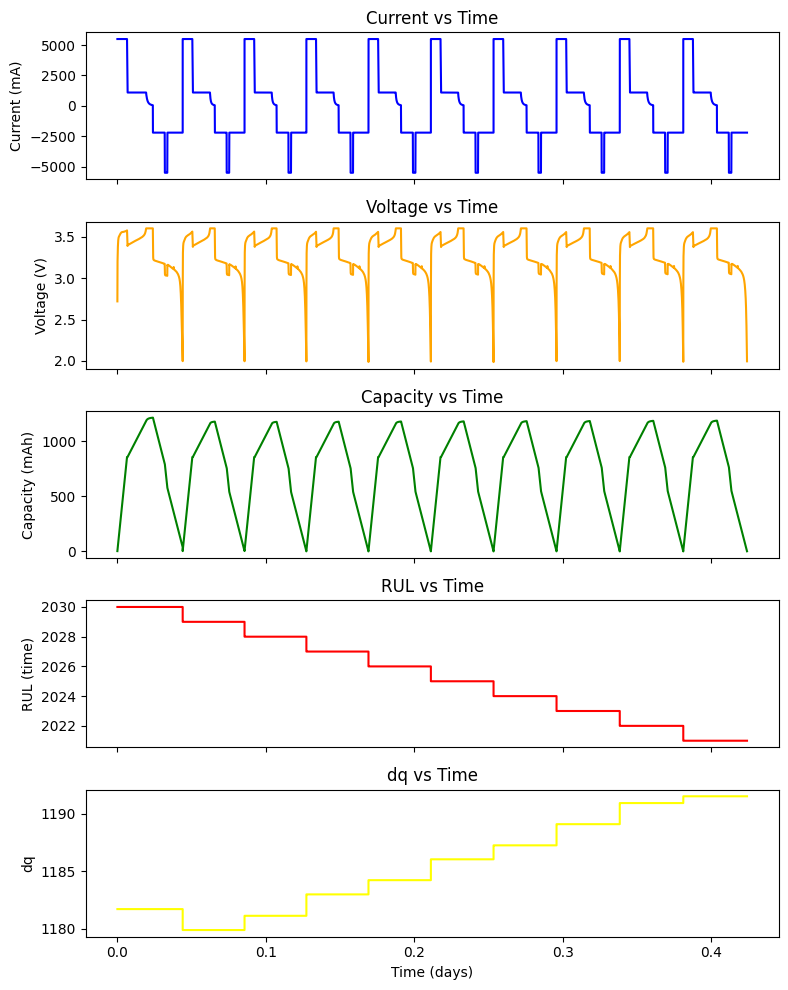

100%|██████████| 2030/2030 [01:53<00:00, 17.93it/s]


1-6


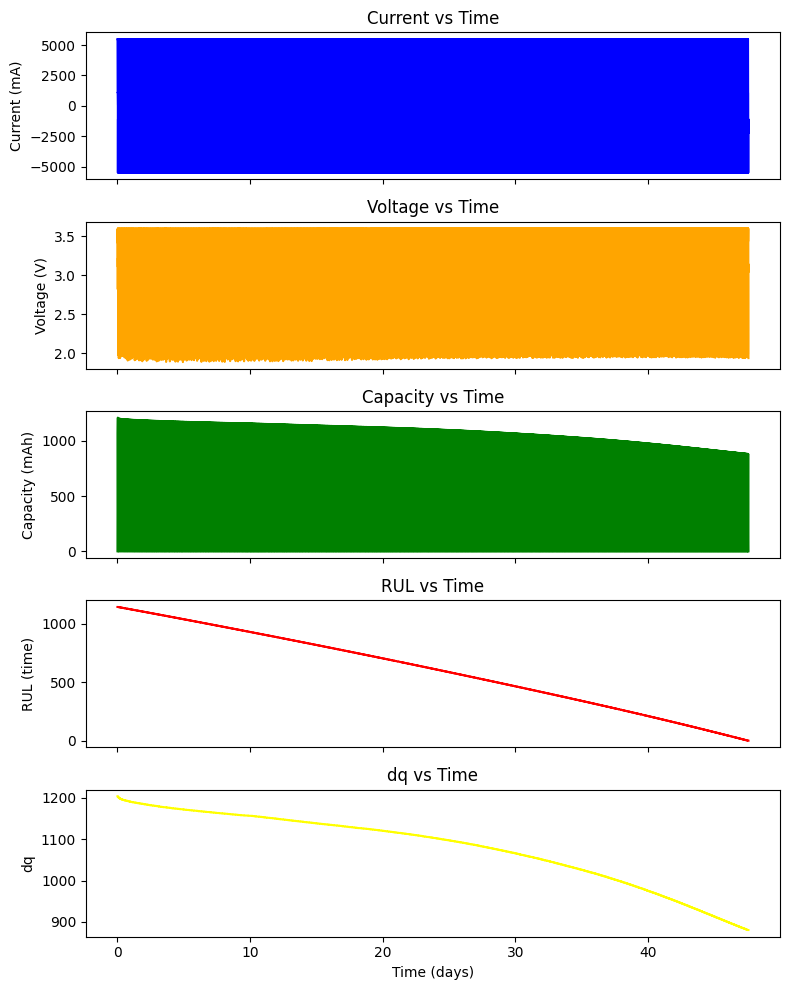

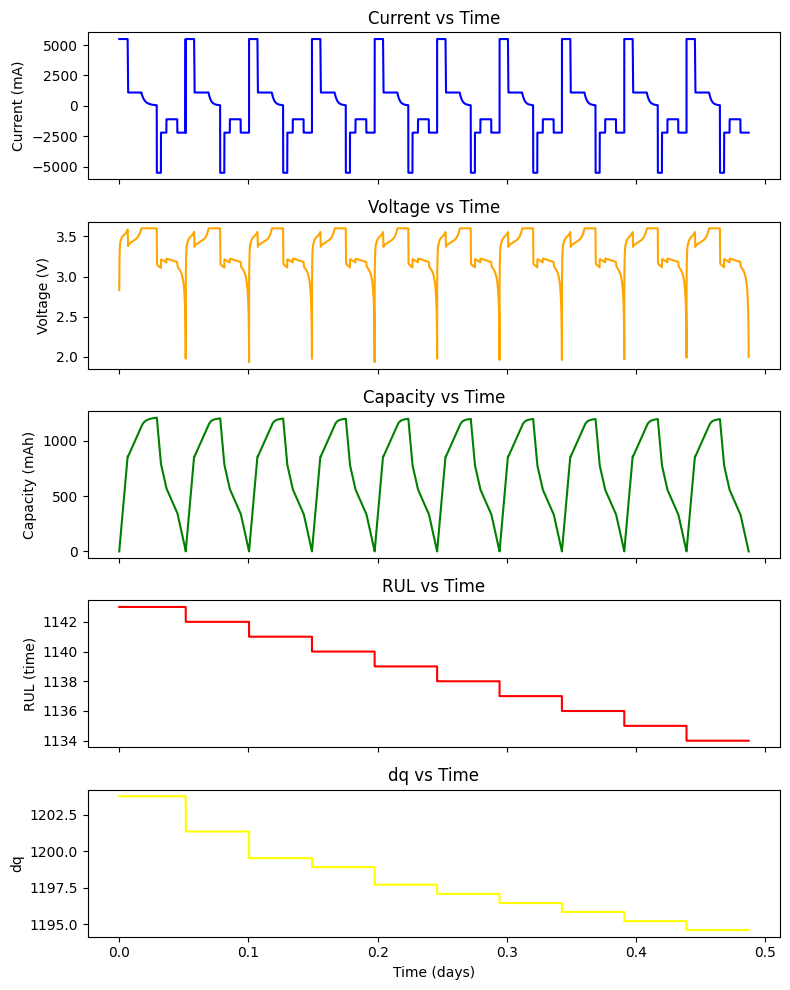

100%|██████████| 1143/1143 [01:08<00:00, 16.68it/s]


3-6


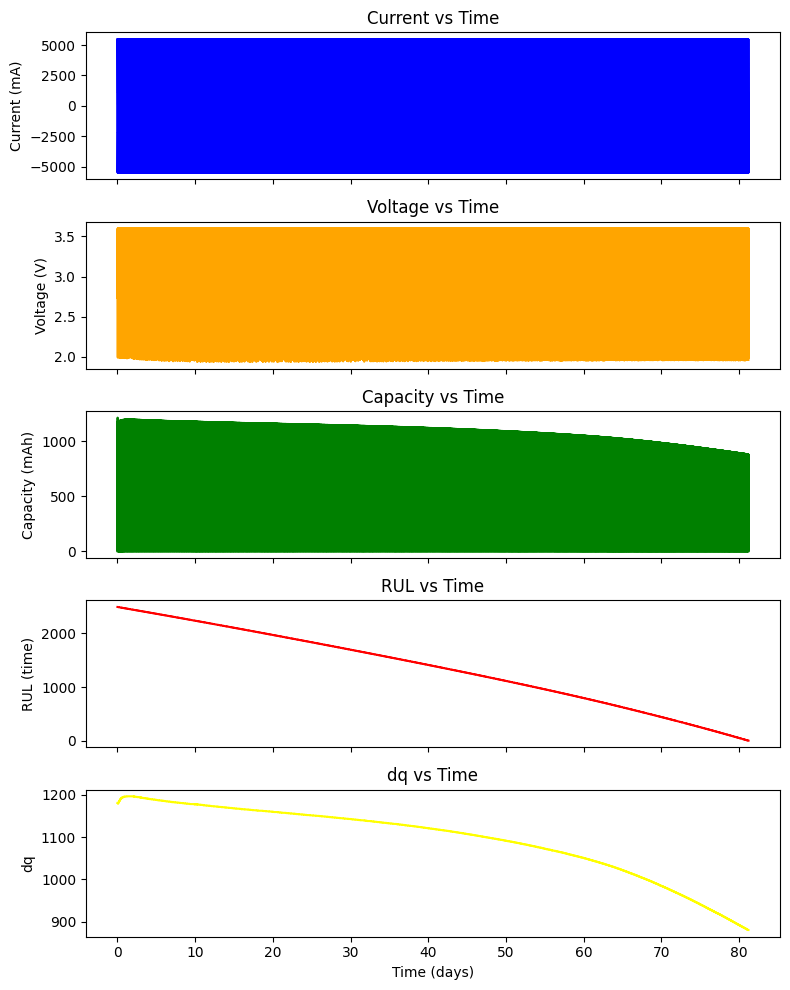

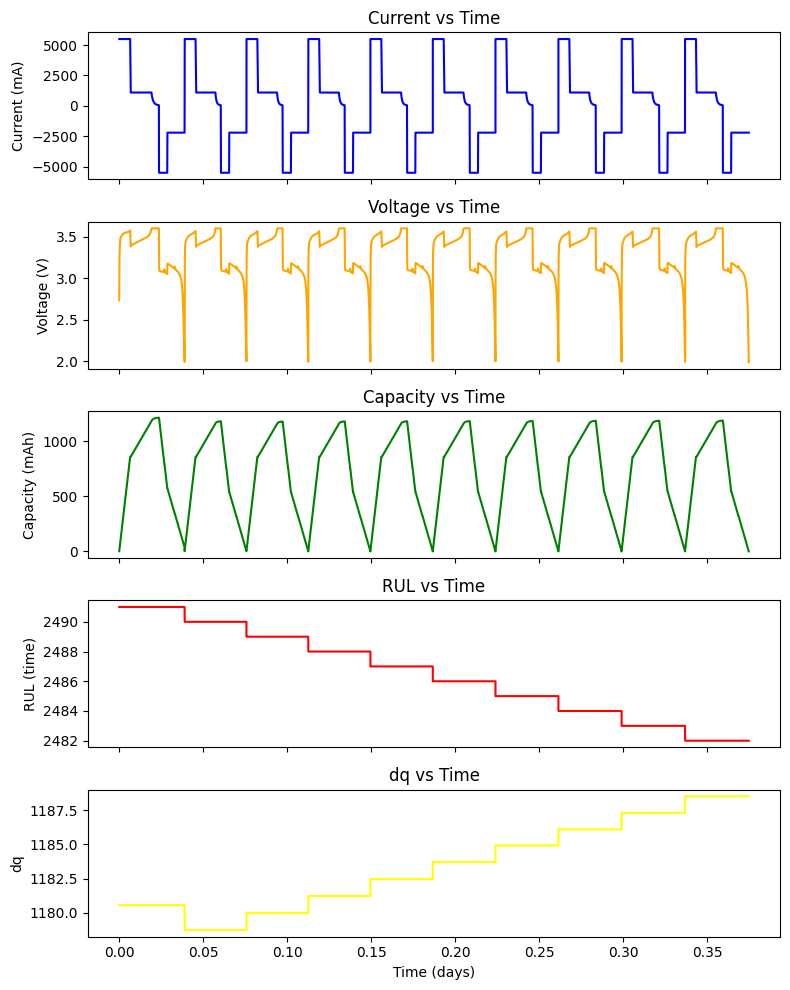

100%|██████████| 2491/2491 [02:04<00:00, 19.94it/s]


4-7


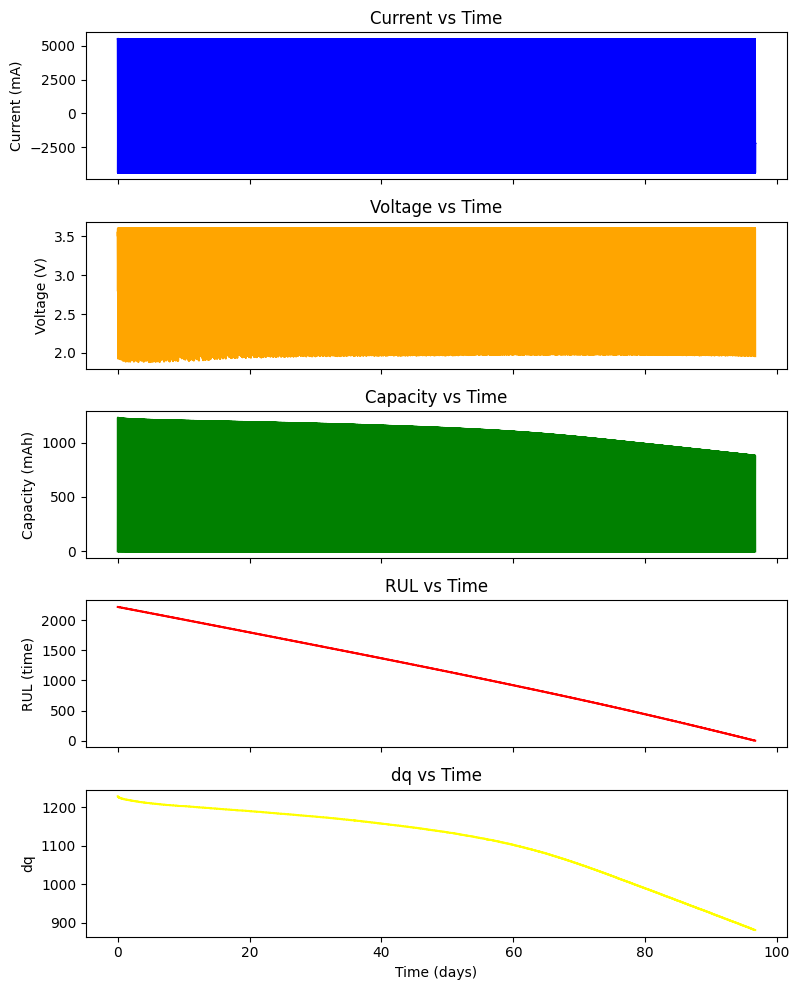

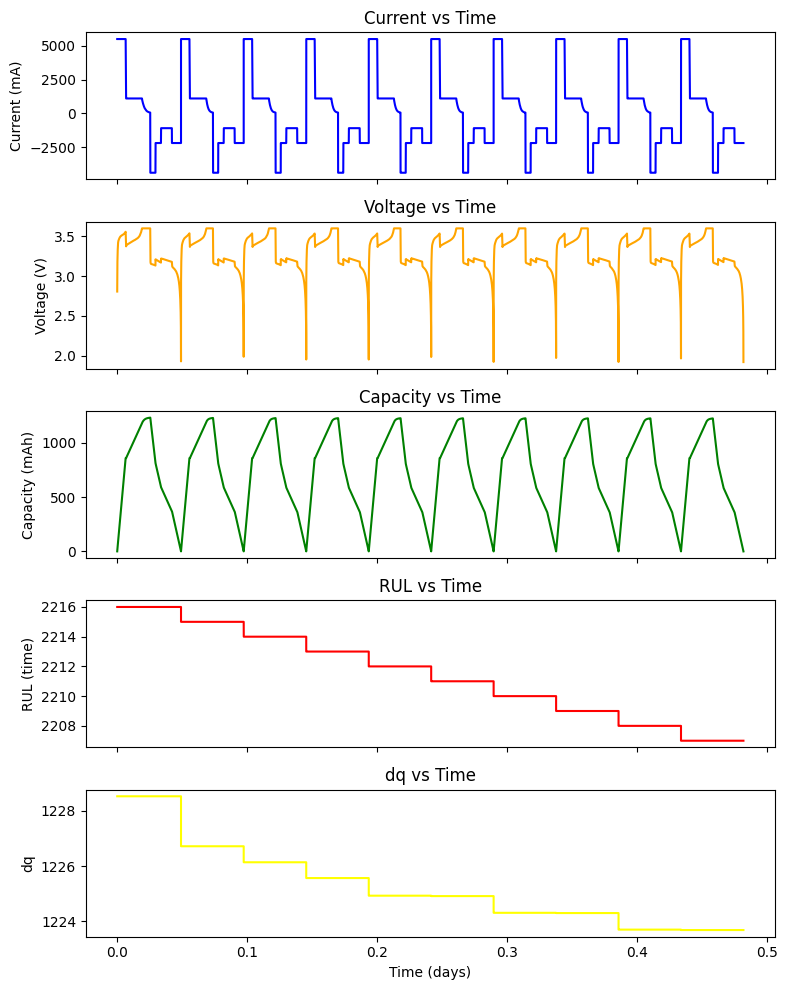

100%|██████████| 2216/2216 [02:22<00:00, 15.60it/s]


5-6


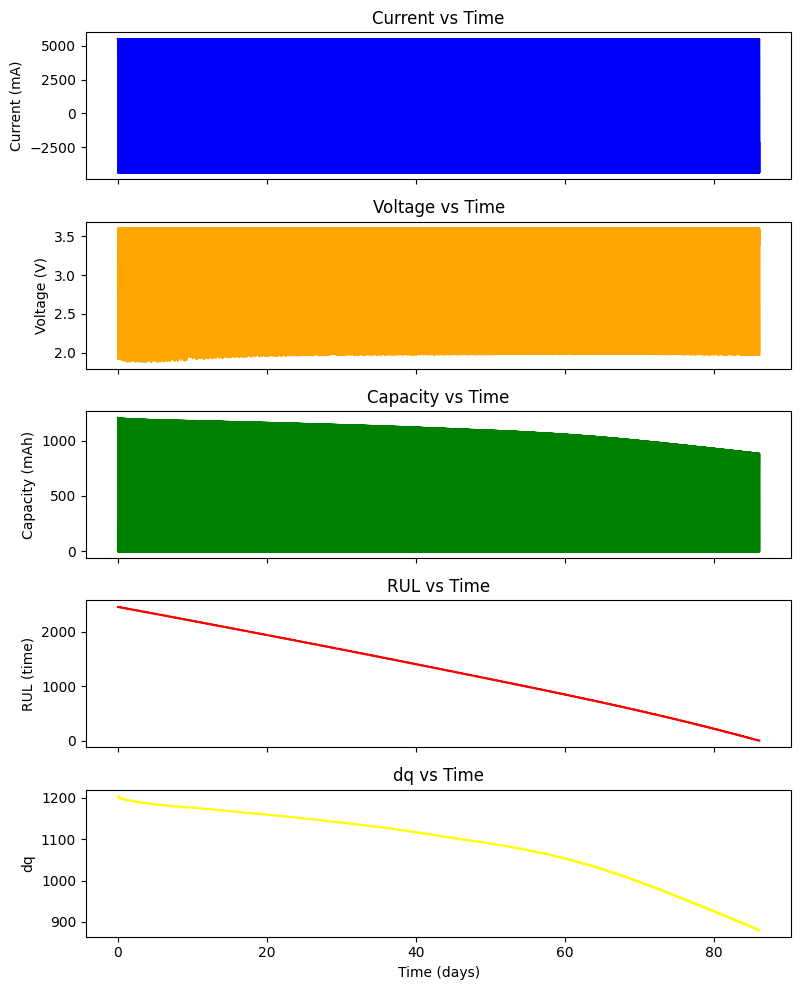

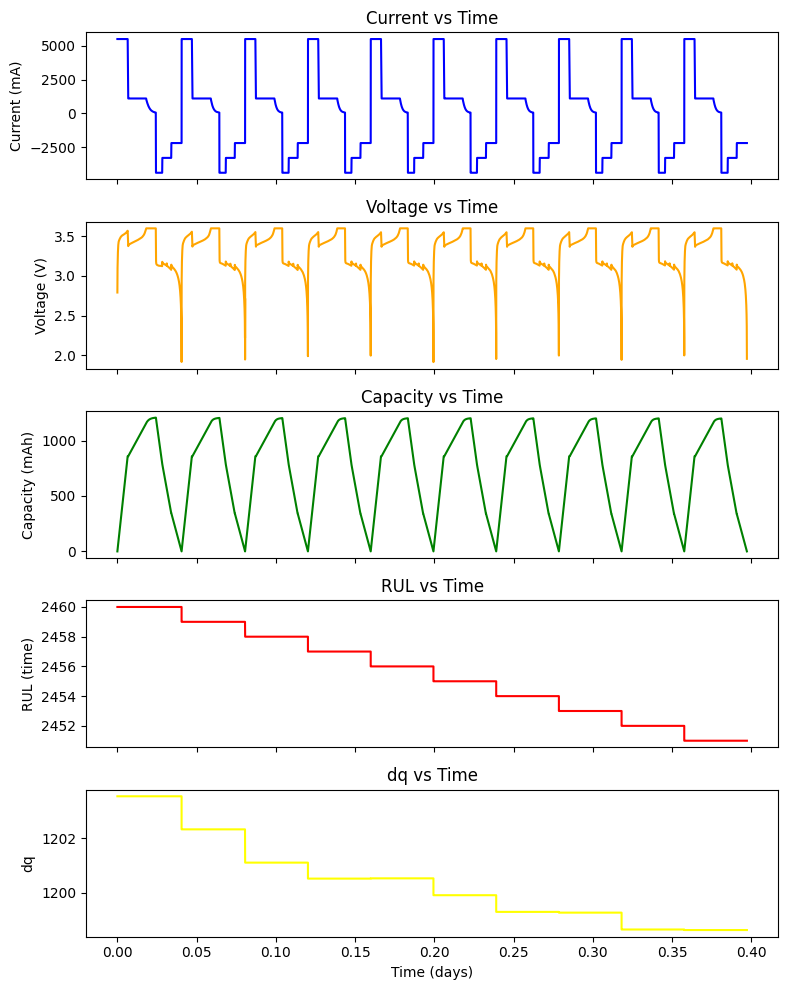

100%|██████████| 2460/2460 [02:09<00:00, 18.94it/s]


6-2


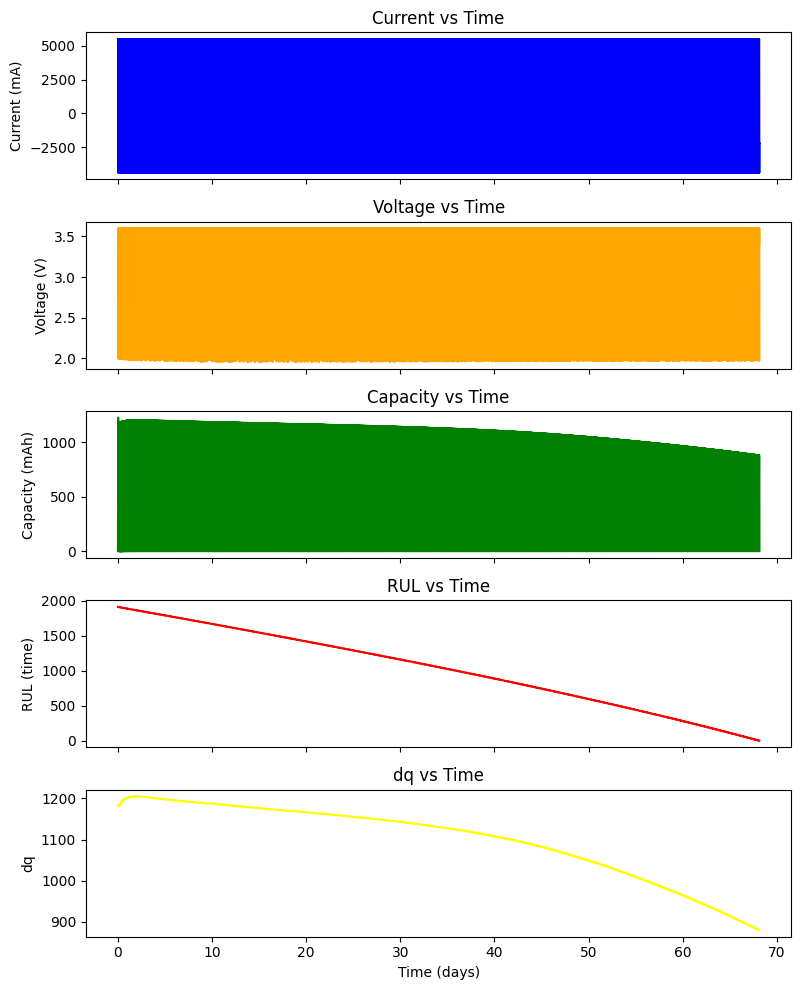

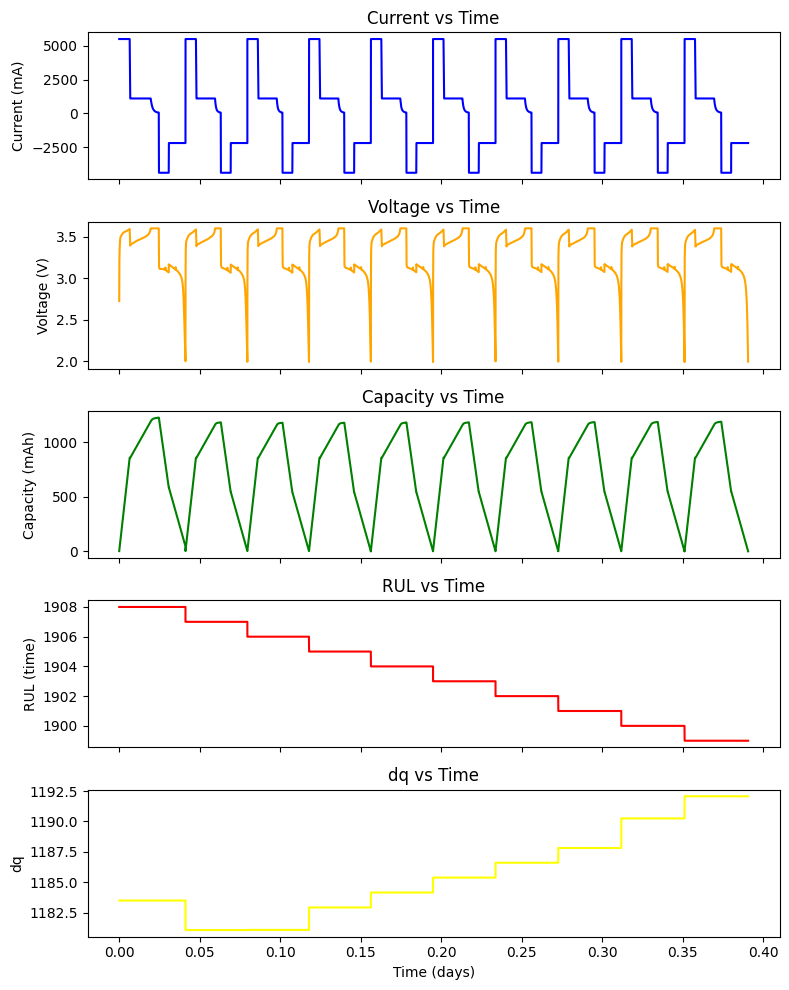

100%|██████████| 1908/1908 [01:39<00:00, 19.16it/s]


6-5


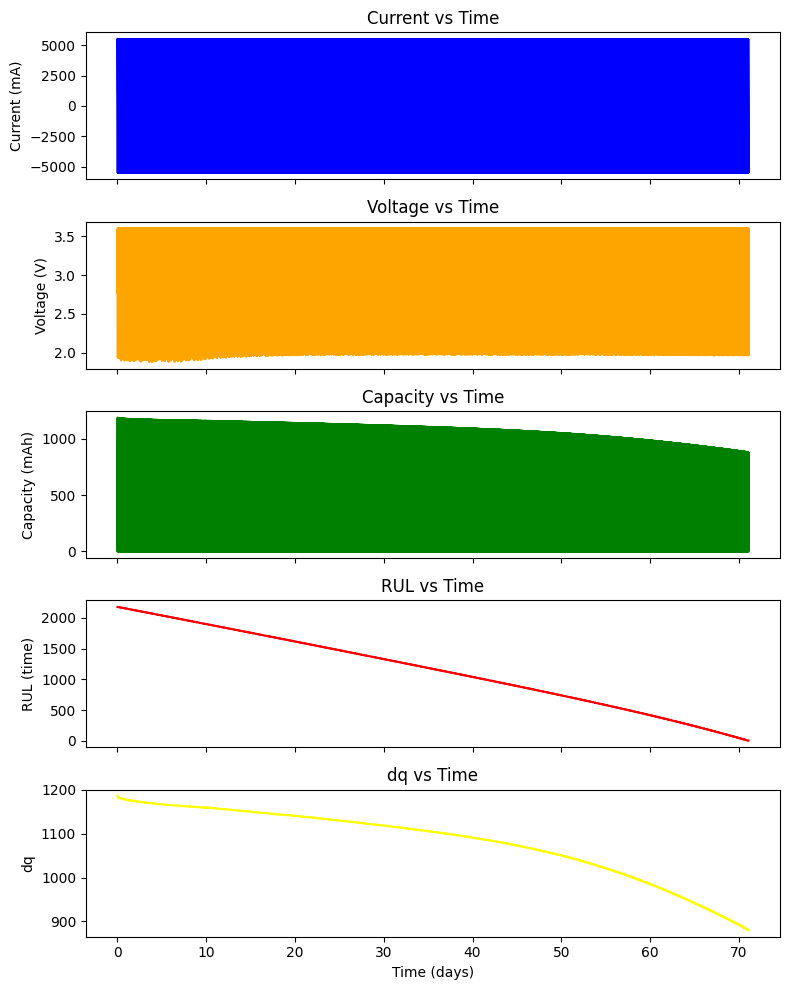

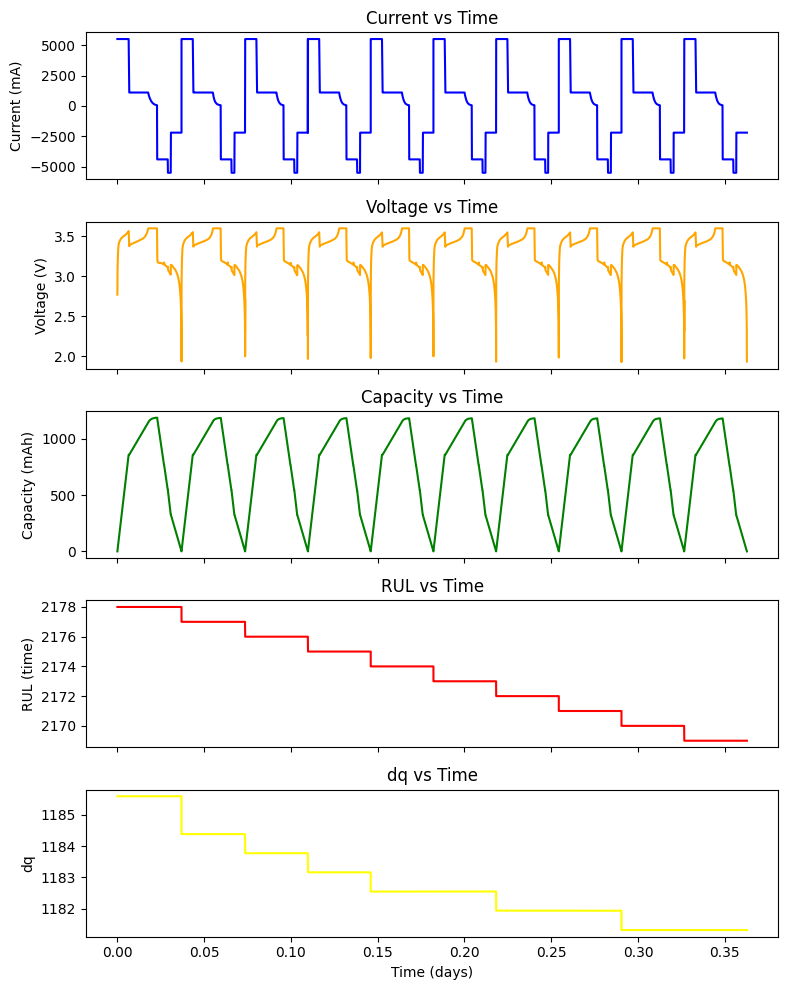

100%|██████████| 2178/2178 [01:44<00:00, 20.92it/s]


7-3


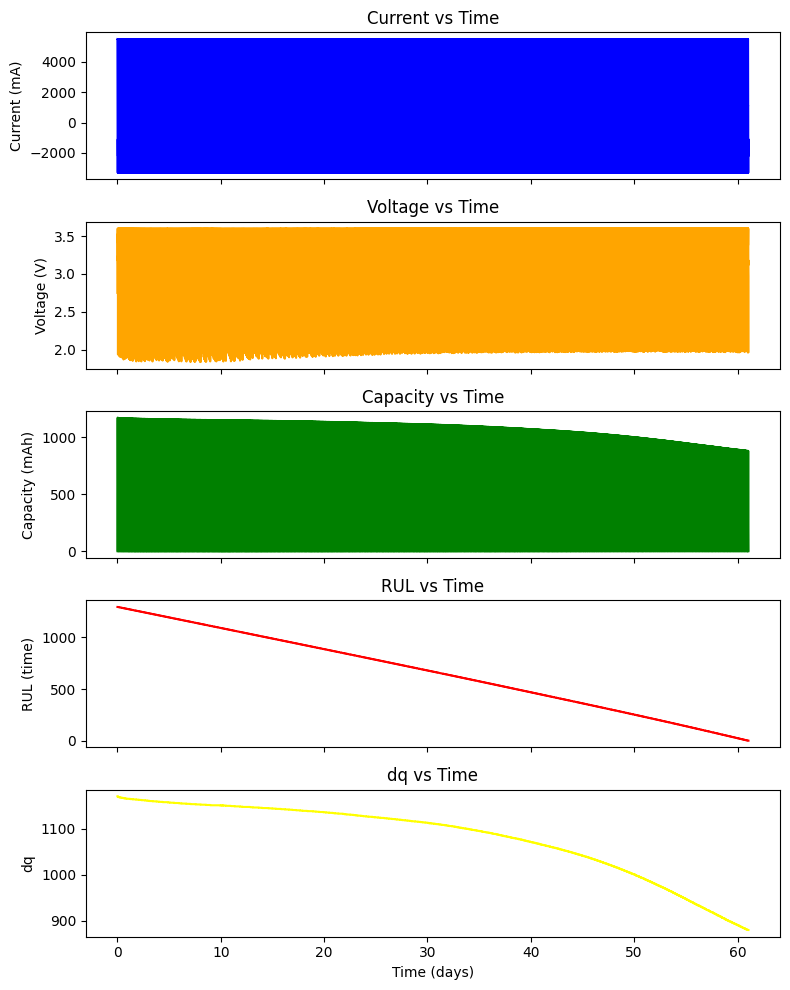

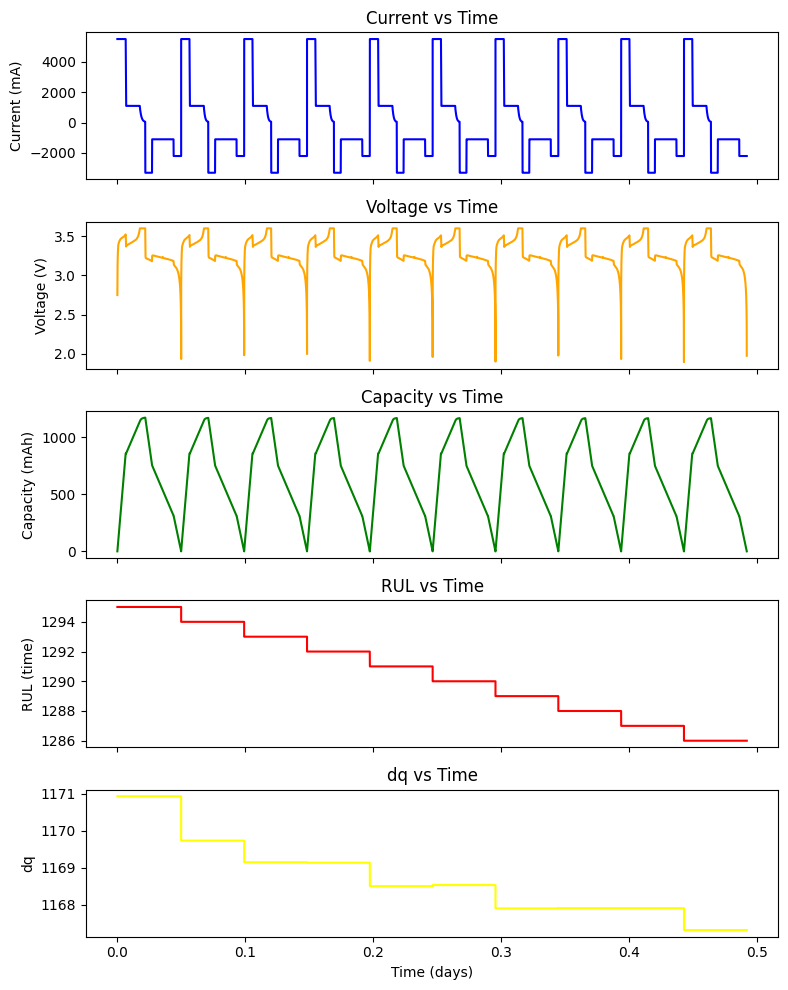

100%|██████████| 1295/1295 [01:31<00:00, 14.15it/s]


8-4


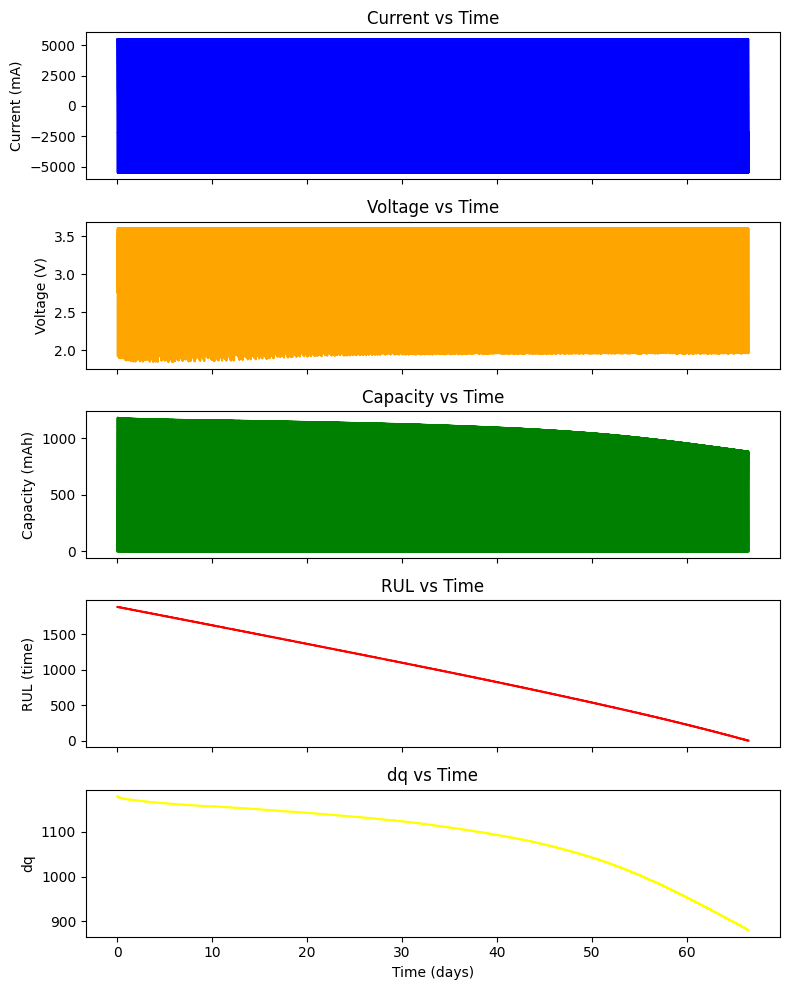

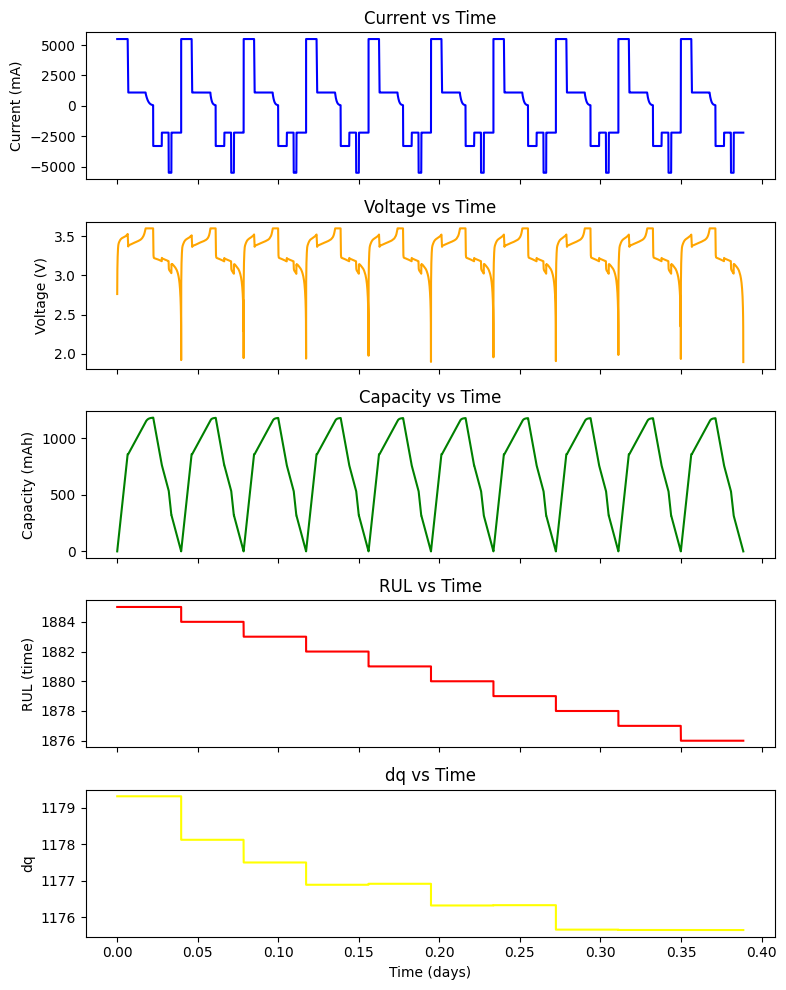

100%|██████████| 1885/1885 [01:42<00:00, 18.37it/s]


10-2


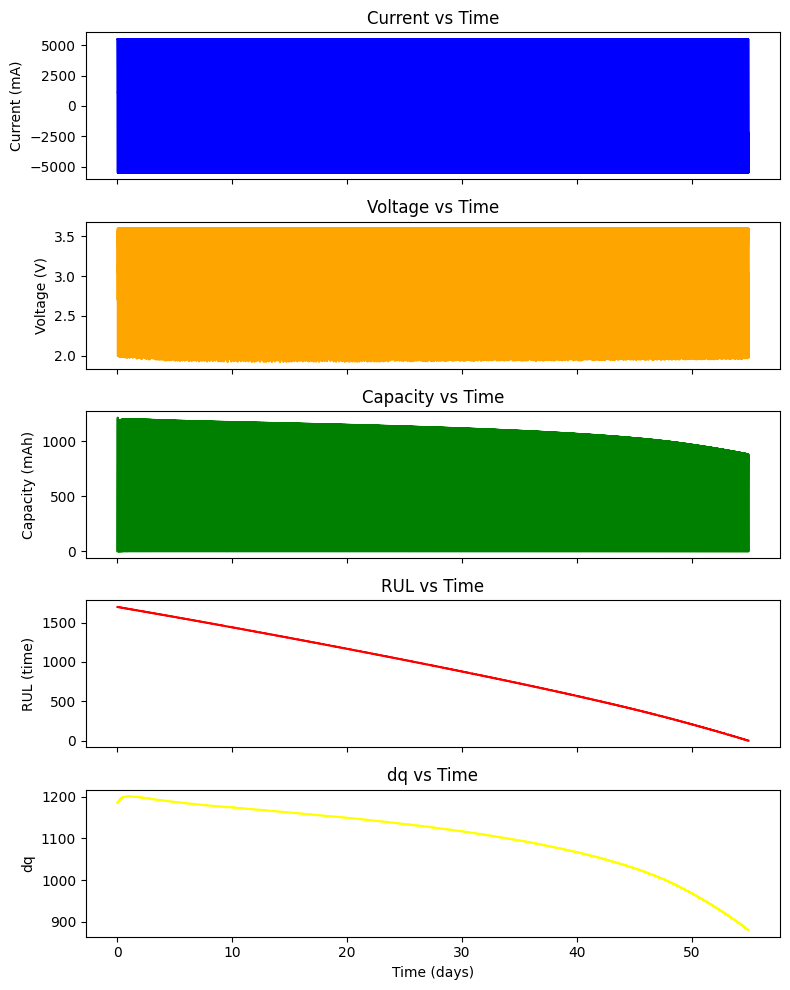

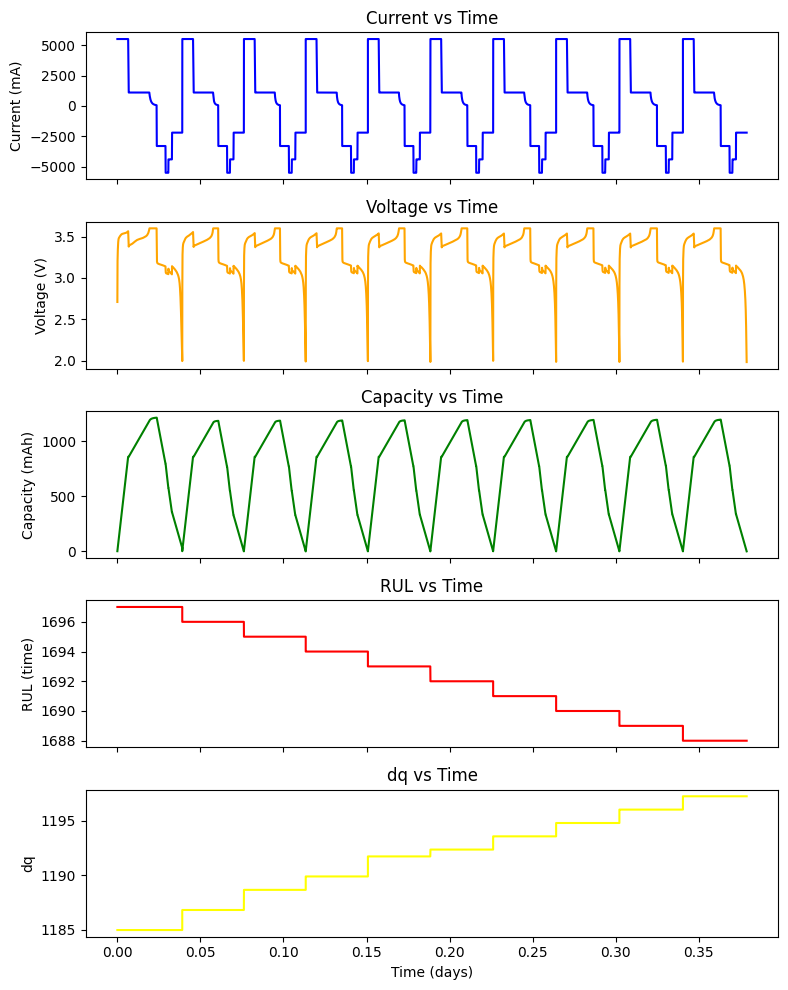

100%|██████████| 1697/1697 [01:27<00:00, 19.44it/s]


2-6


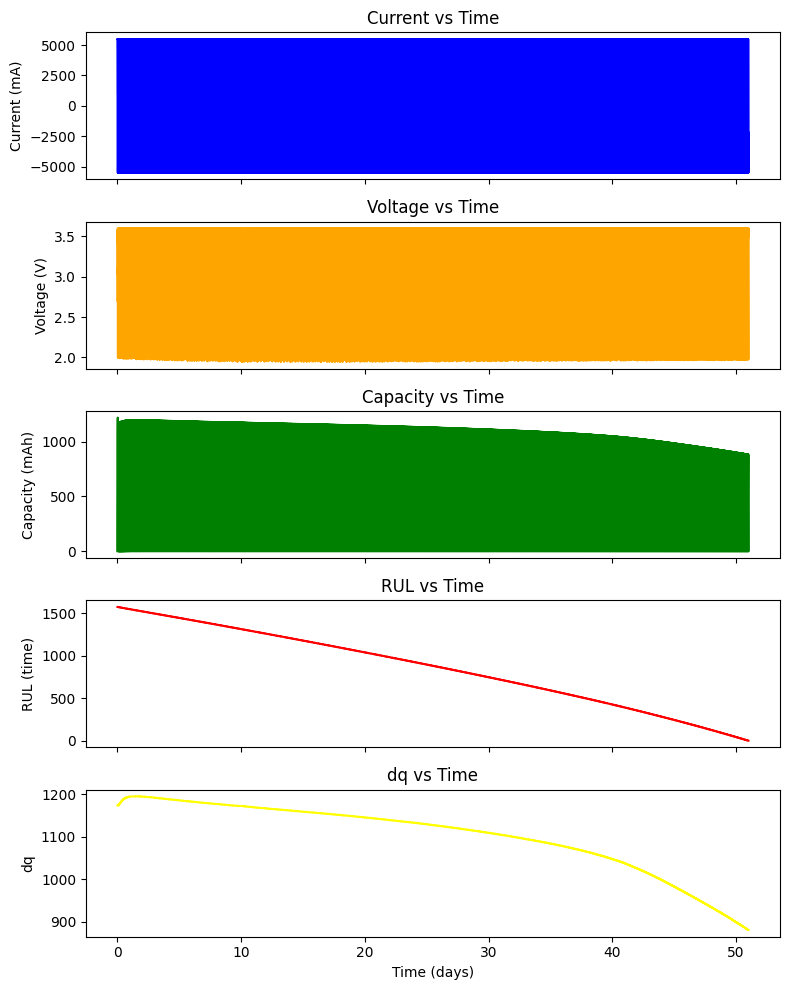

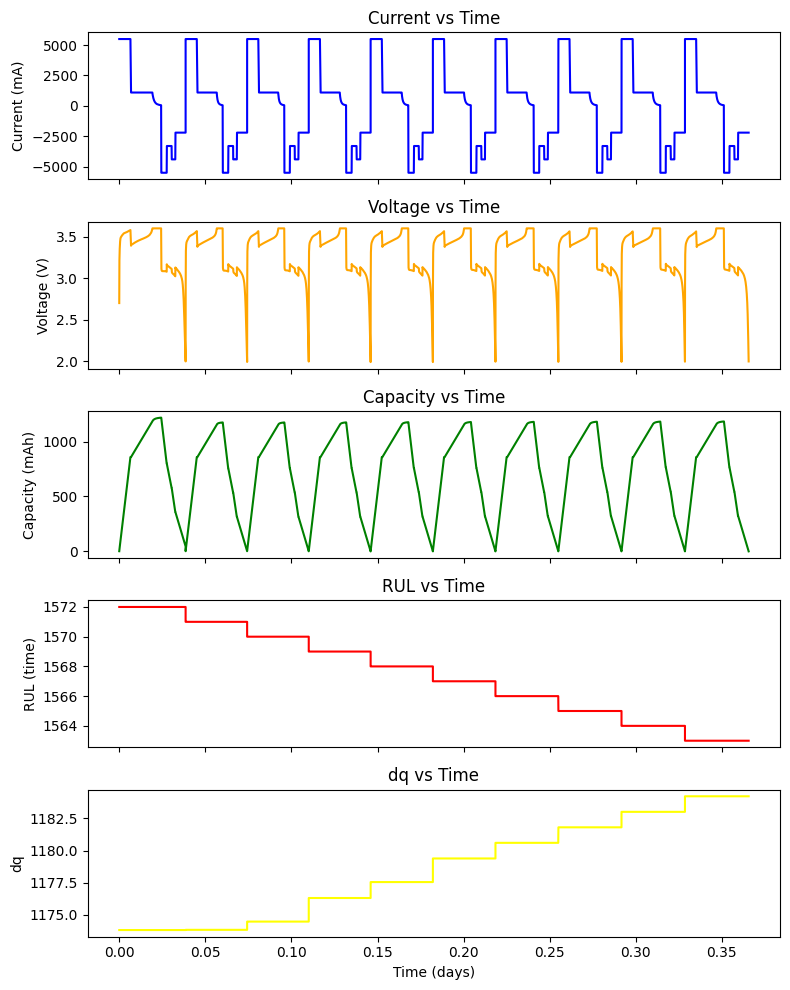

100%|██████████| 1572/1572 [01:17<00:00, 20.25it/s]


3-7


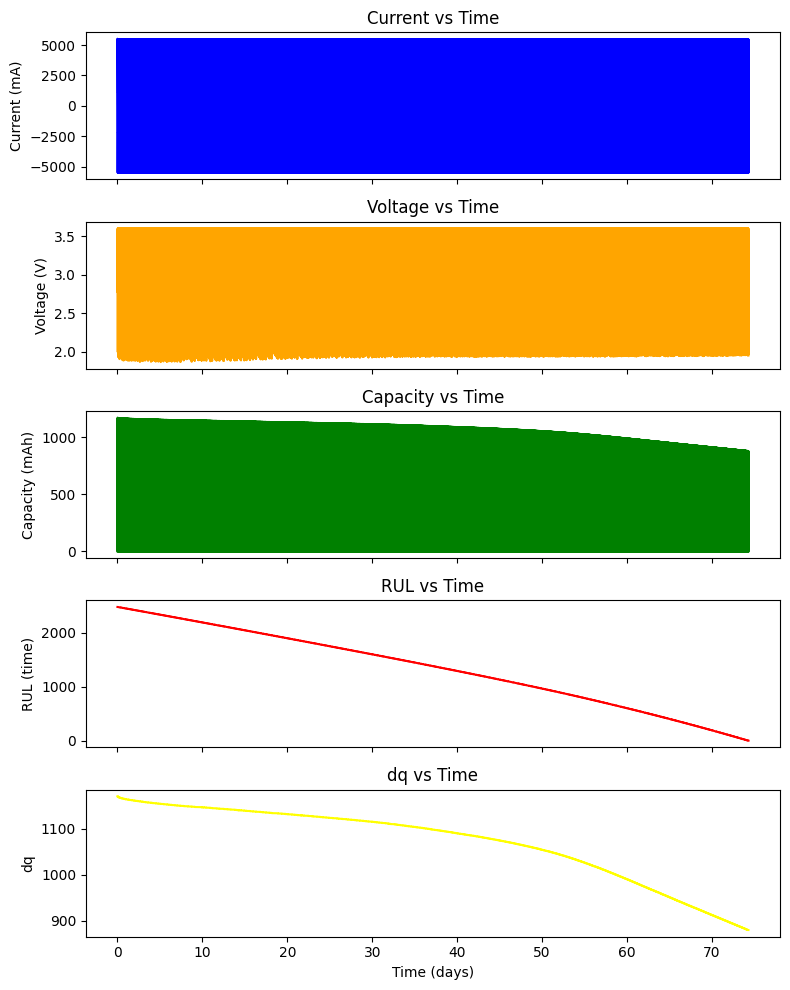

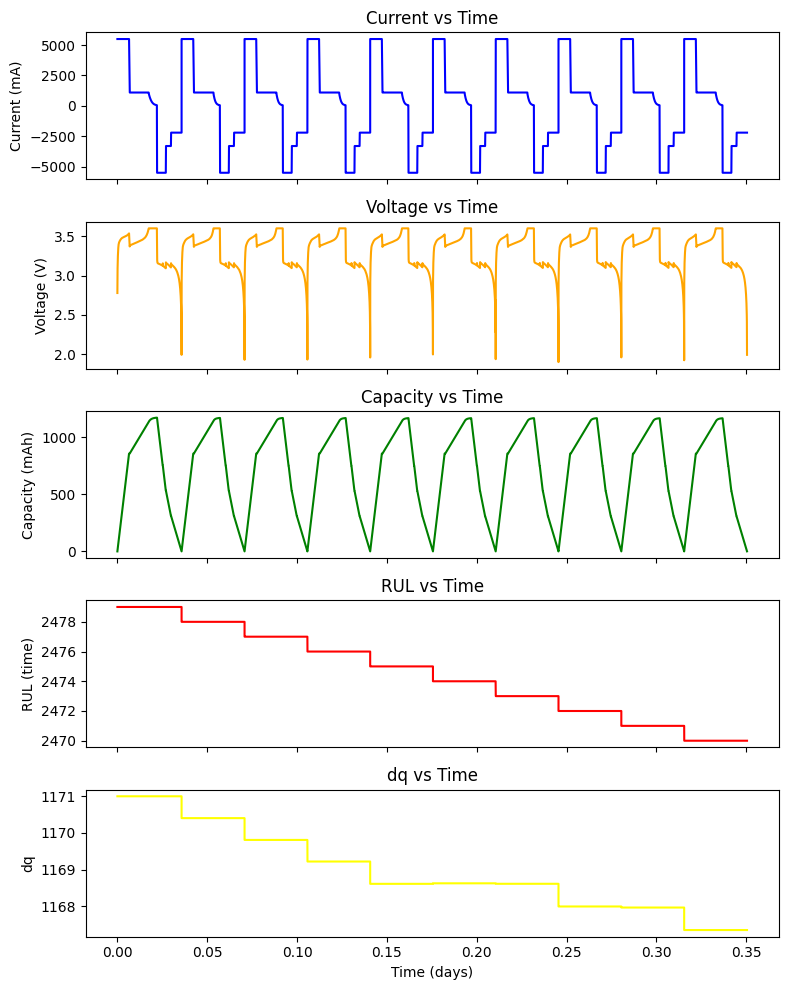

100%|██████████| 2479/2479 [01:54<00:00, 21.58it/s]


8-1


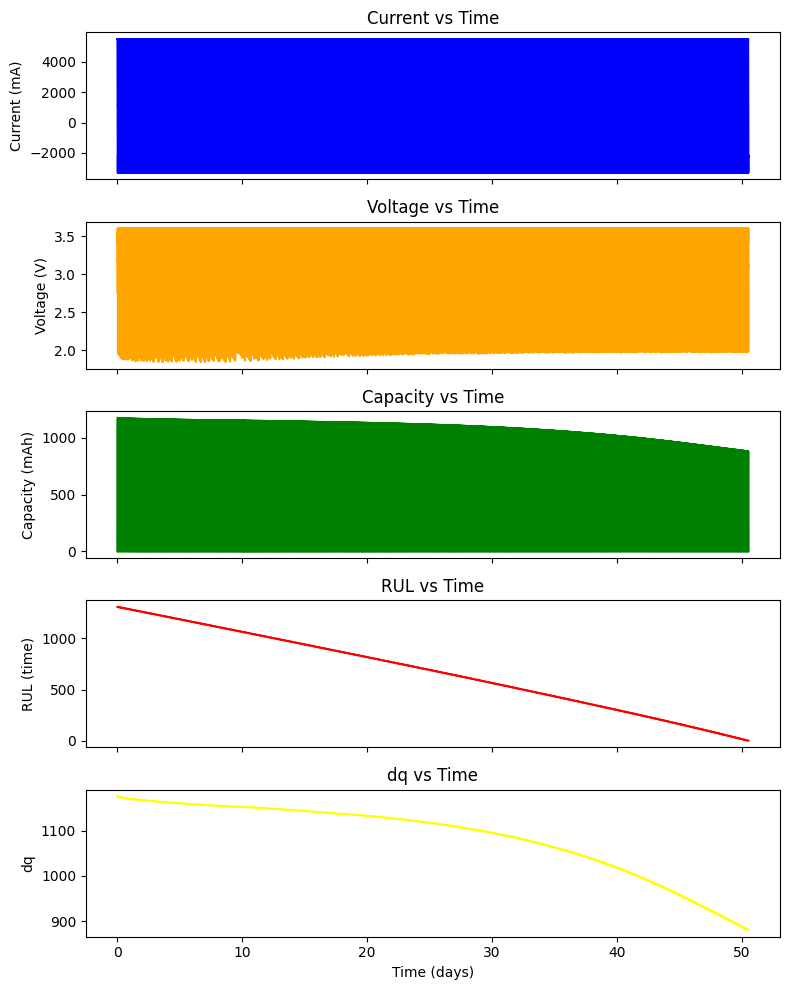

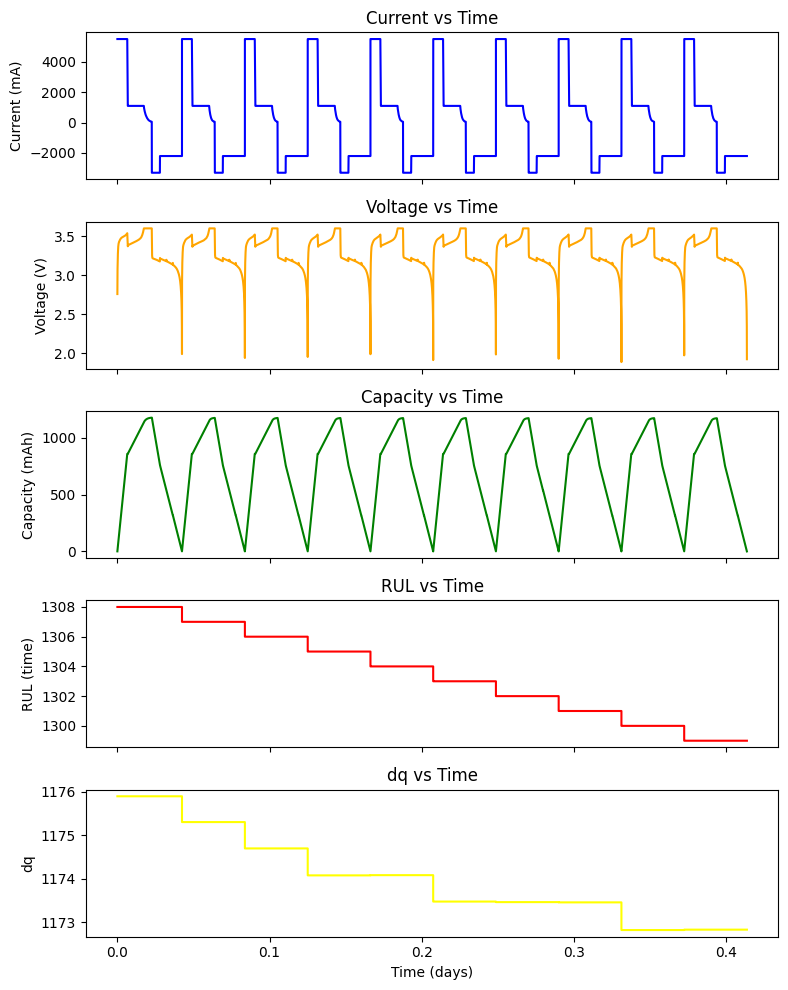

100%|██████████| 1308/1308 [01:18<00:00, 16.63it/s]


9-5


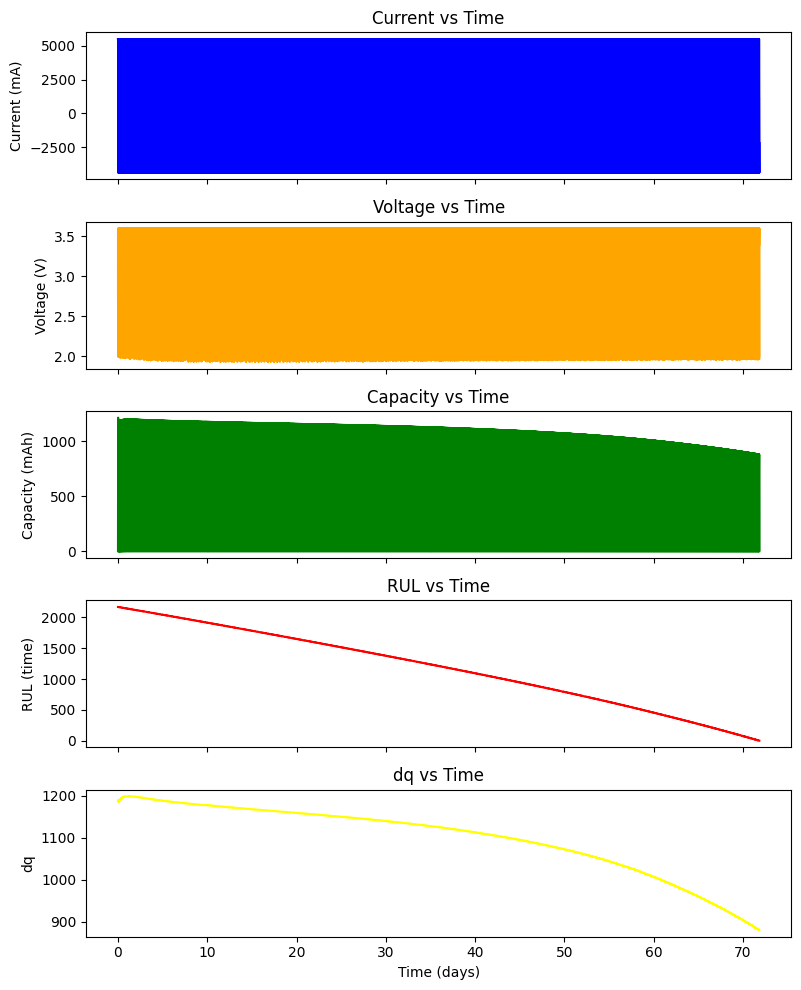

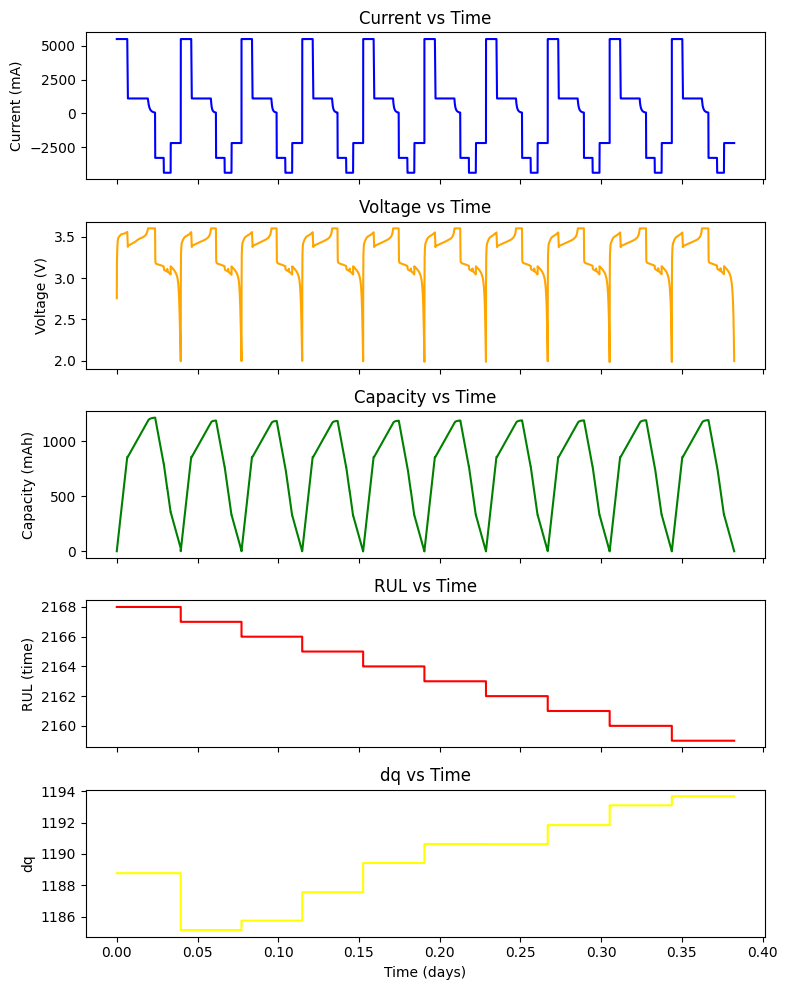

100%|██████████| 2168/2168 [01:47<00:00, 20.12it/s]


7-7


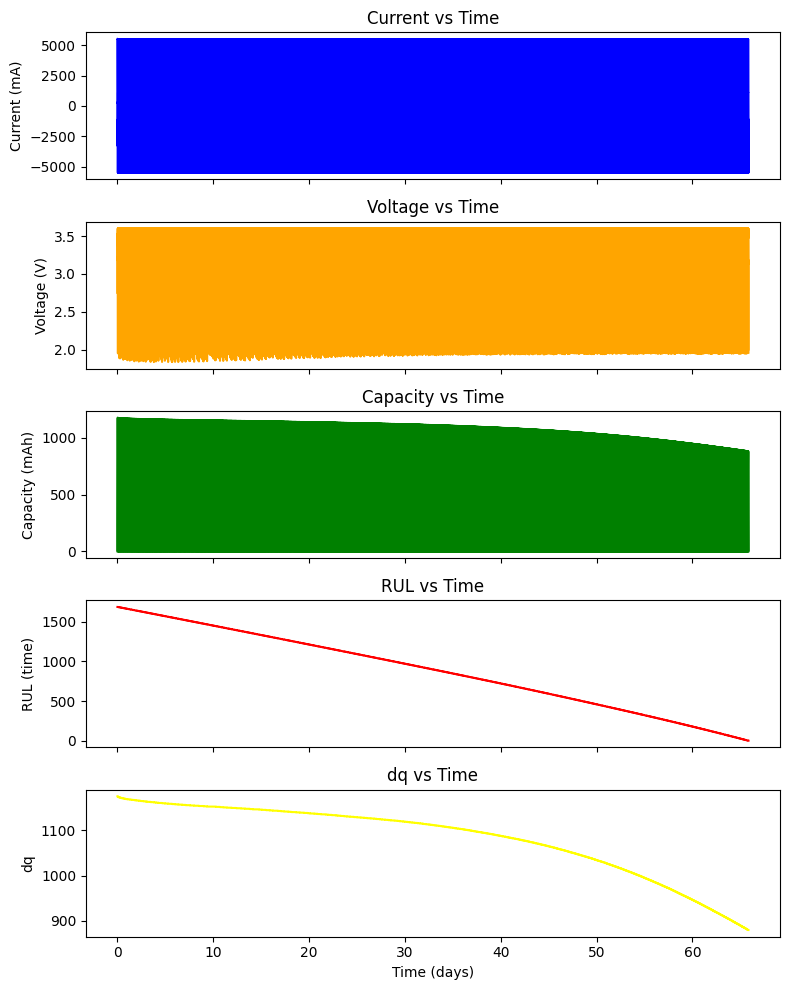

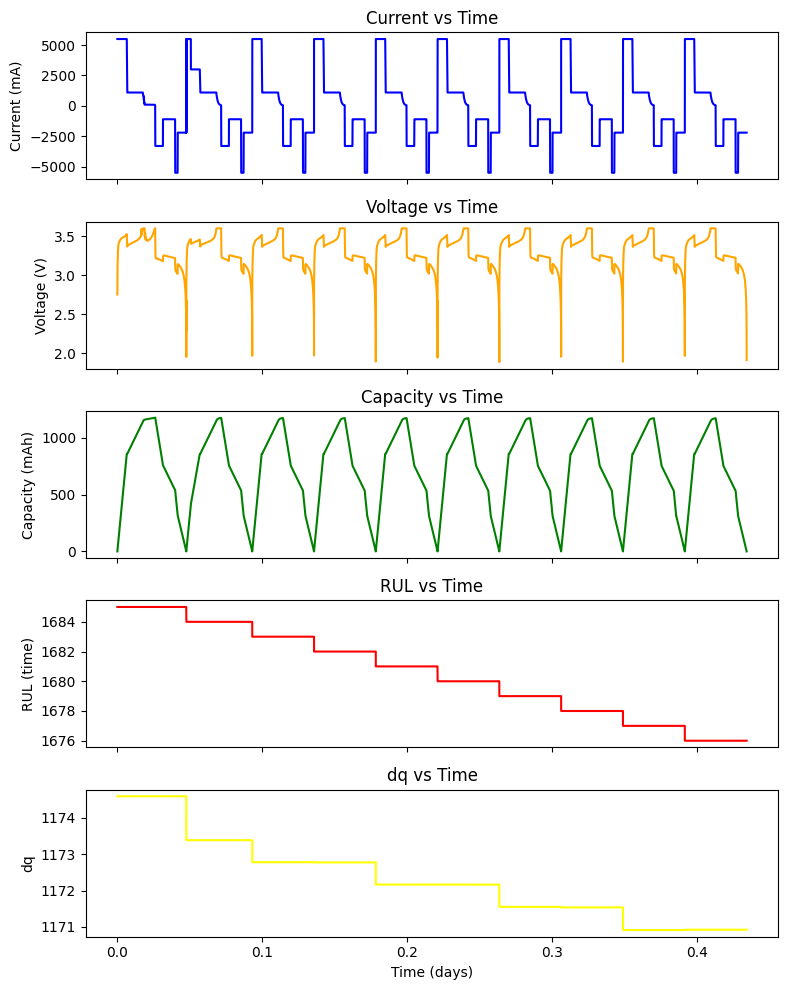

100%|██████████| 1685/1685 [01:37<00:00, 17.31it/s]


4-5


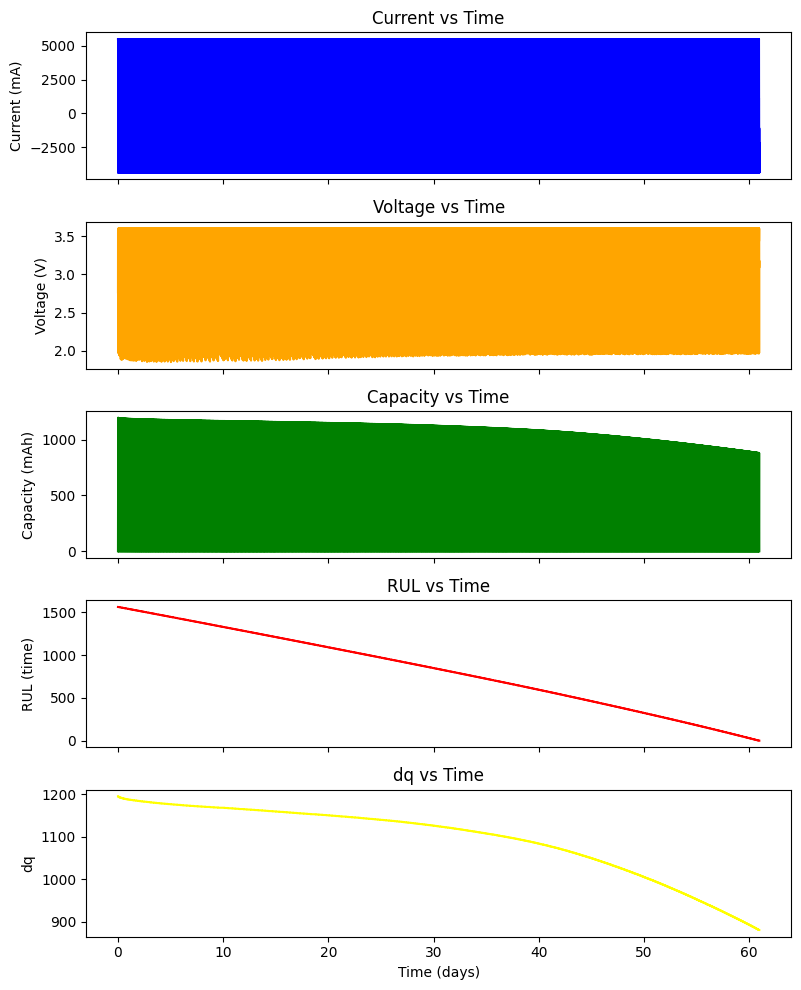

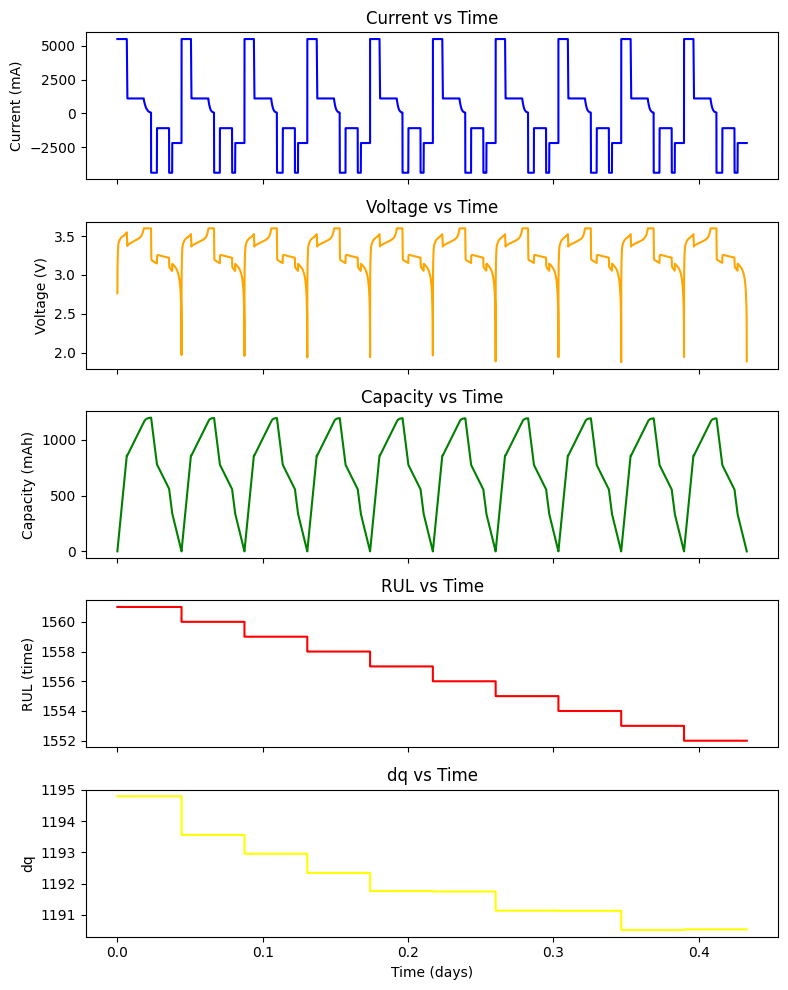

100%|██████████| 1561/1561 [01:28<00:00, 17.56it/s]


8-2


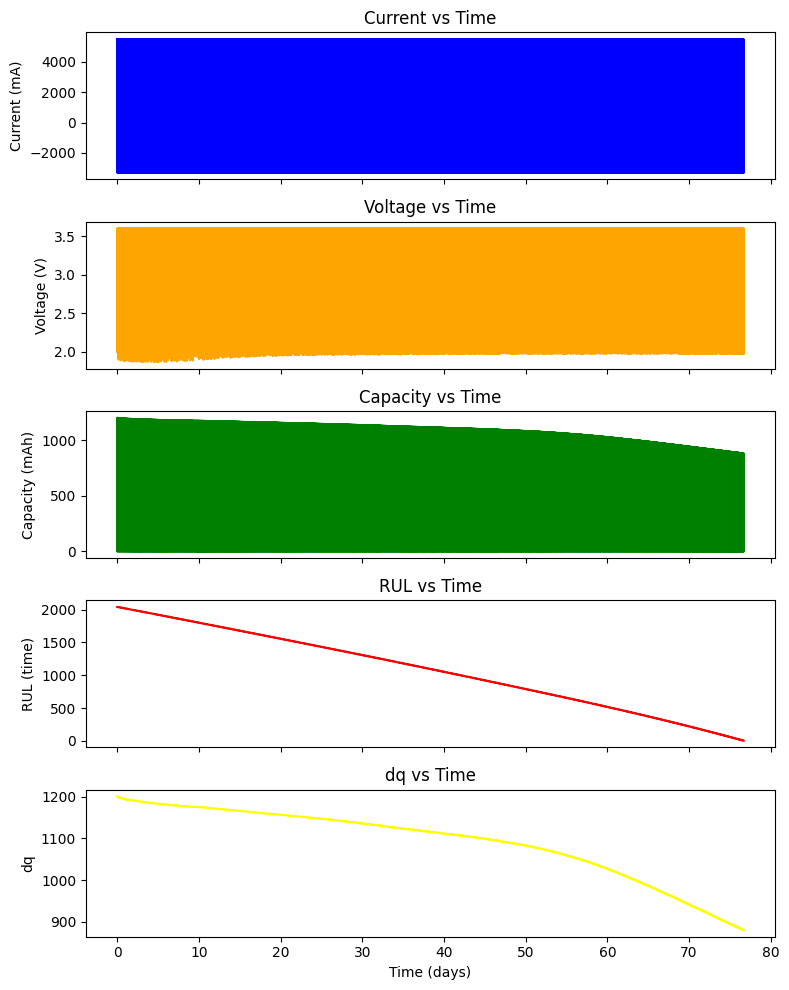

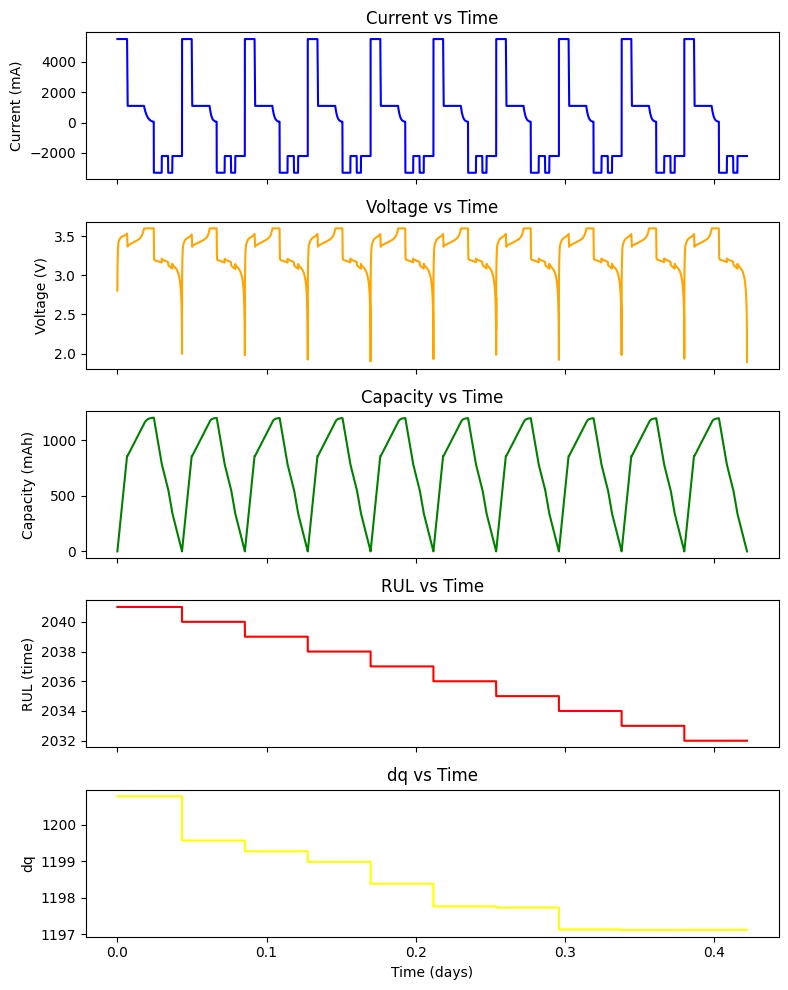

100%|██████████| 2041/2041 [01:53<00:00, 17.95it/s]


1-1


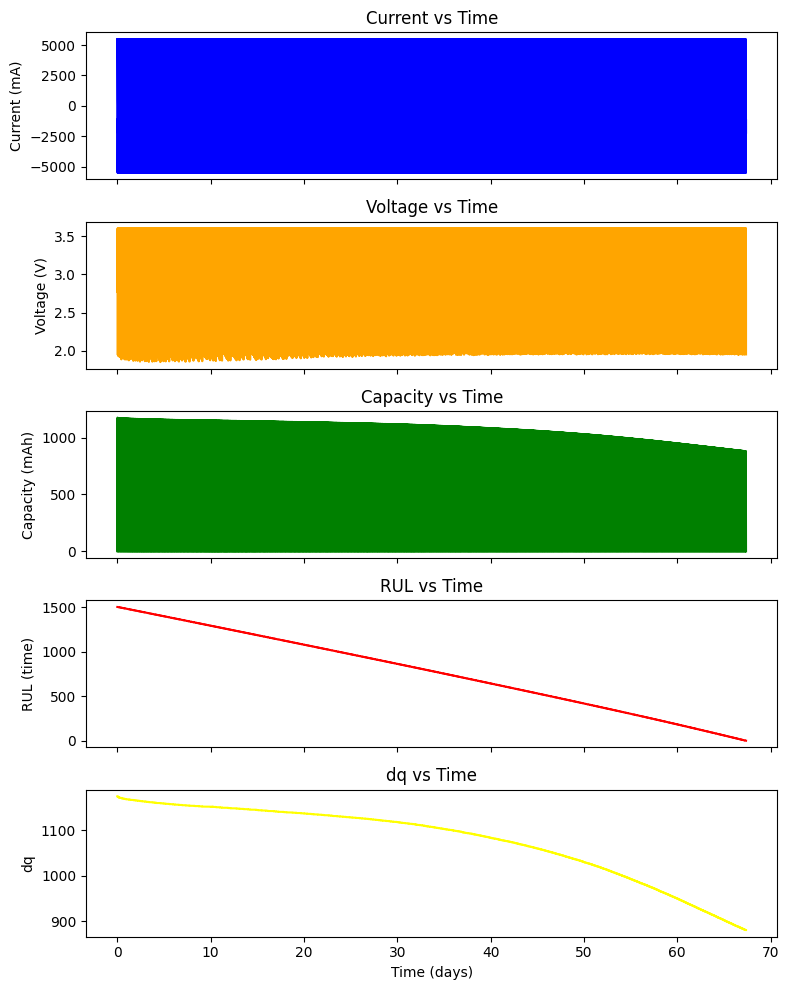

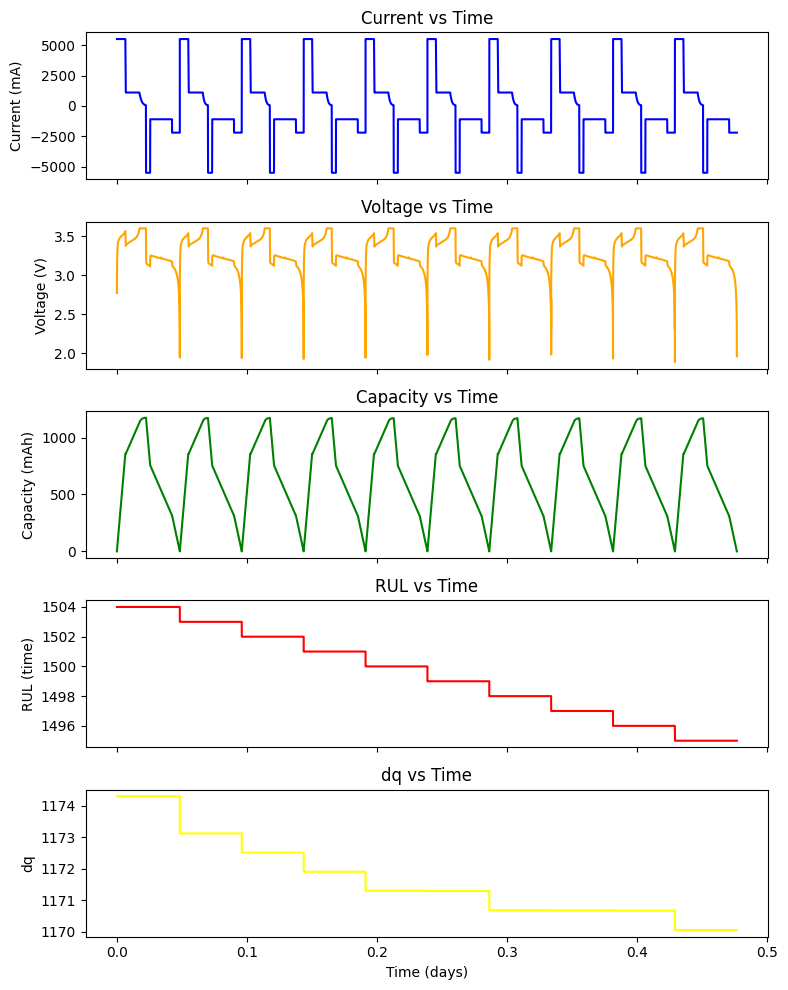

100%|██████████| 1504/1504 [01:38<00:00, 15.28it/s]


3-4


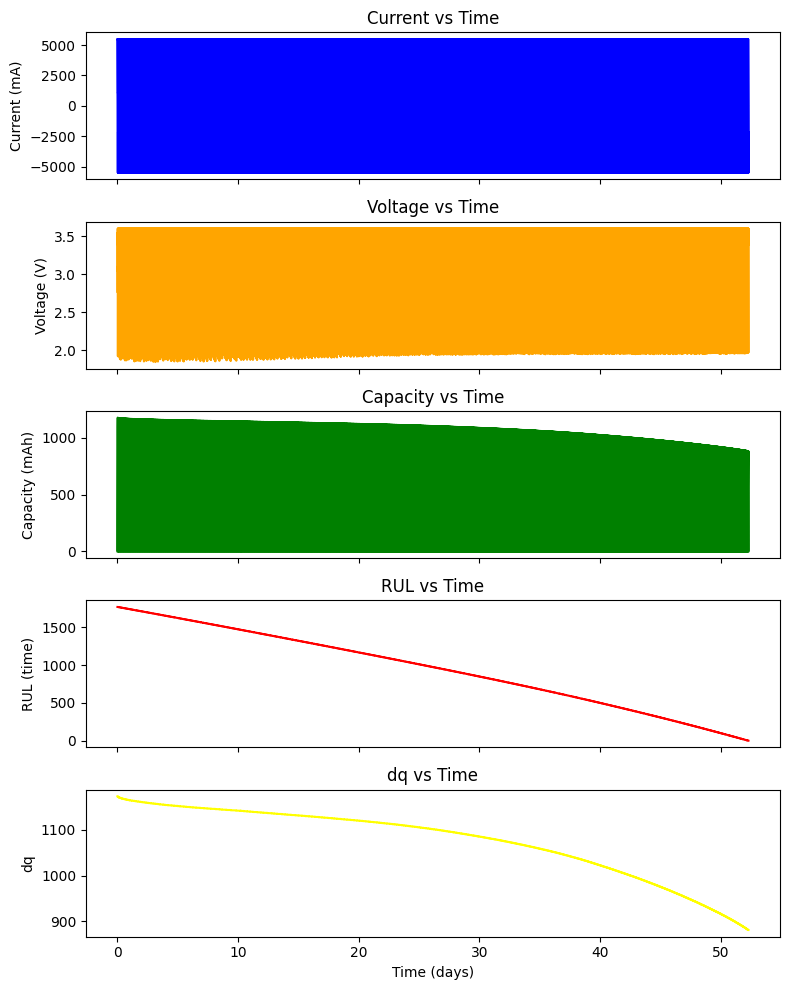

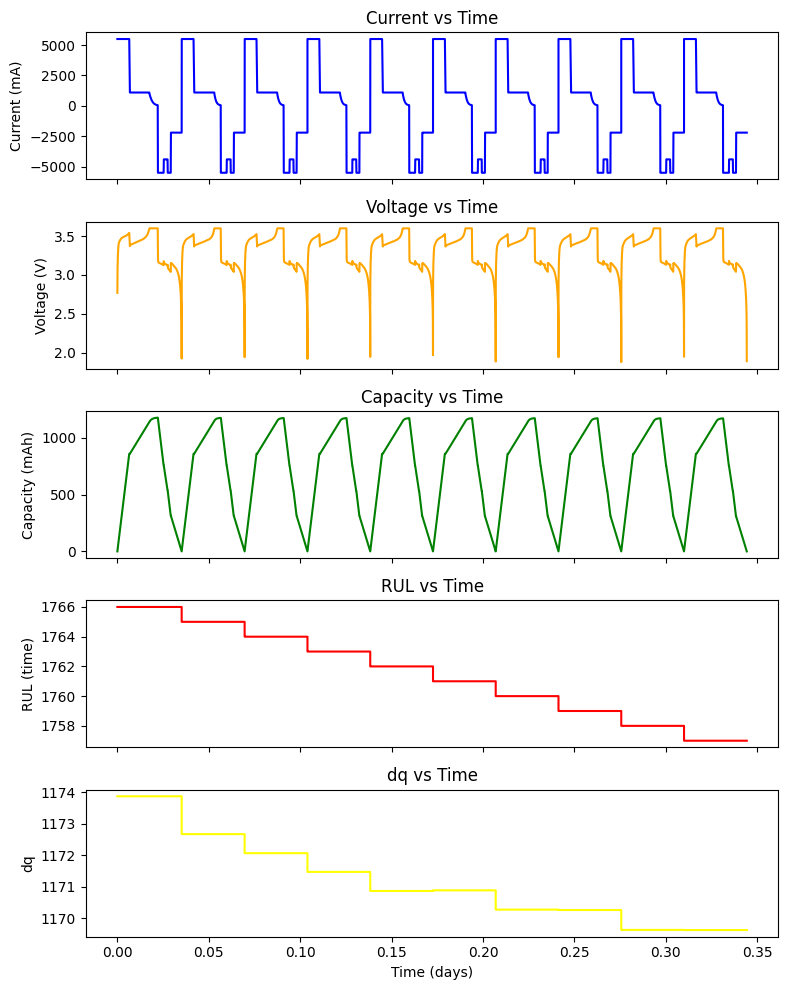

100%|██████████| 1766/1766 [01:20<00:00, 21.98it/s]


7-6


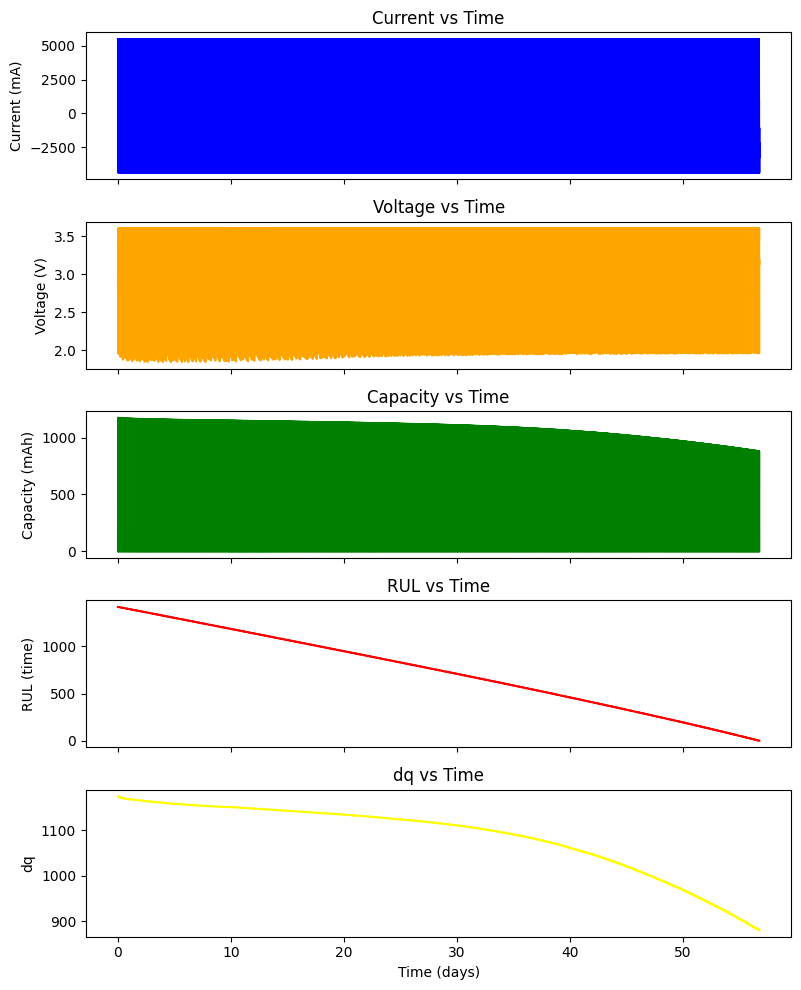

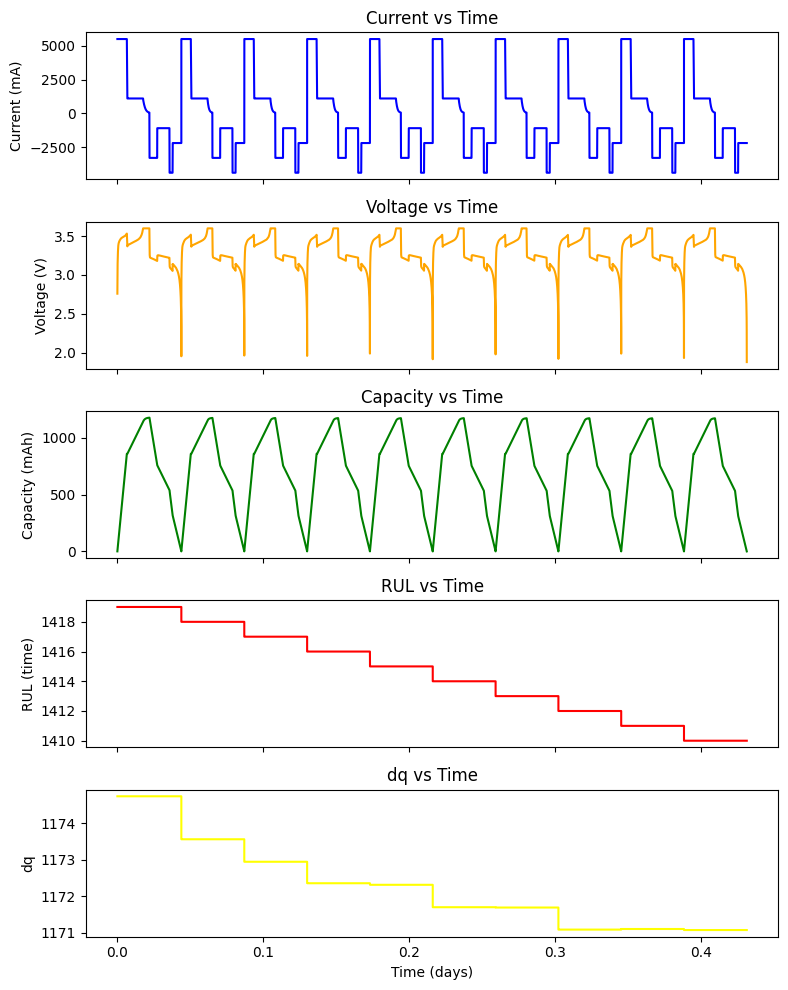

100%|██████████| 1419/1419 [01:25<00:00, 16.61it/s]


2-2


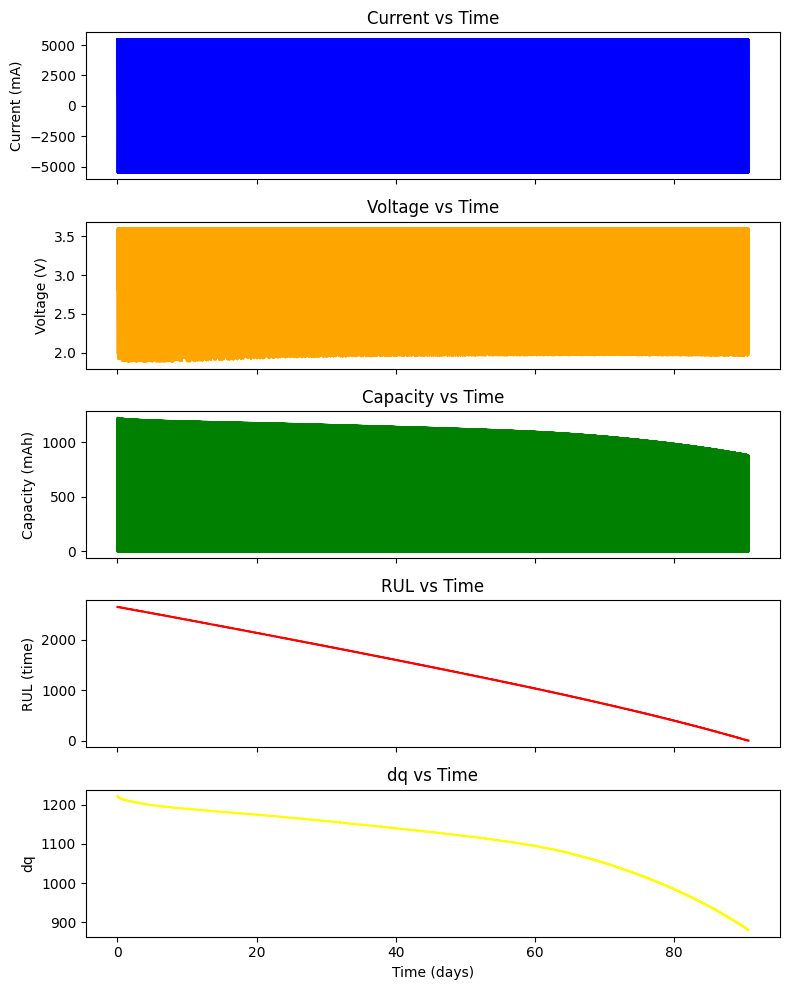

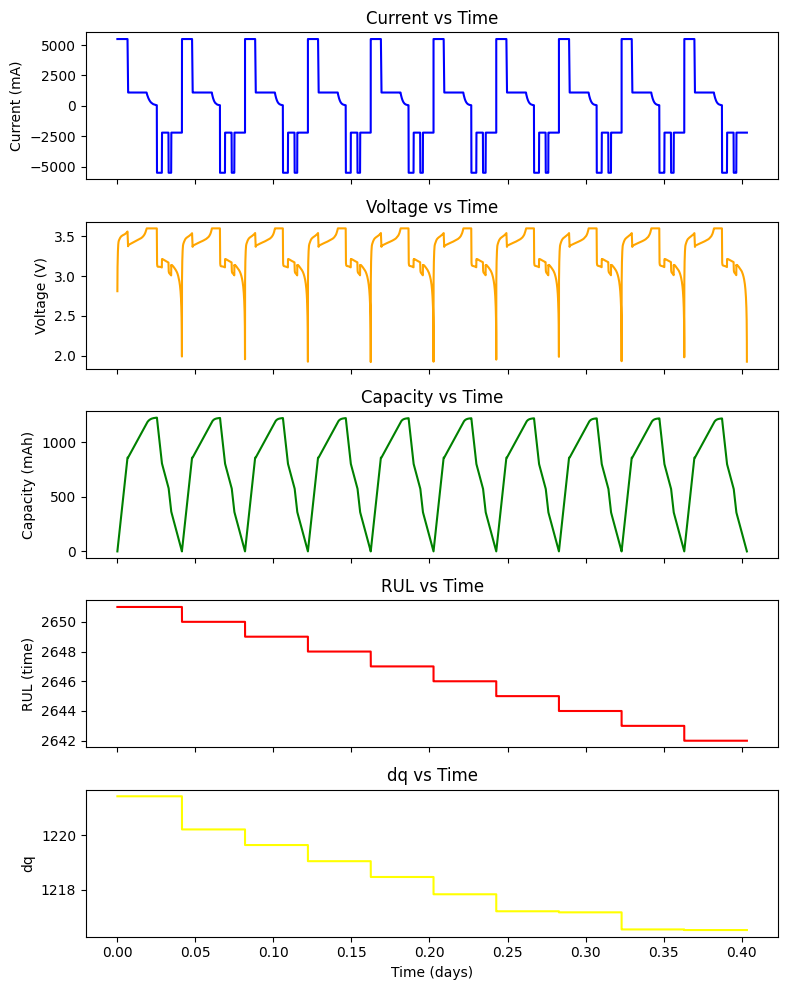

100%|██████████| 2651/2651 [02:13<00:00, 19.79it/s]


10-8


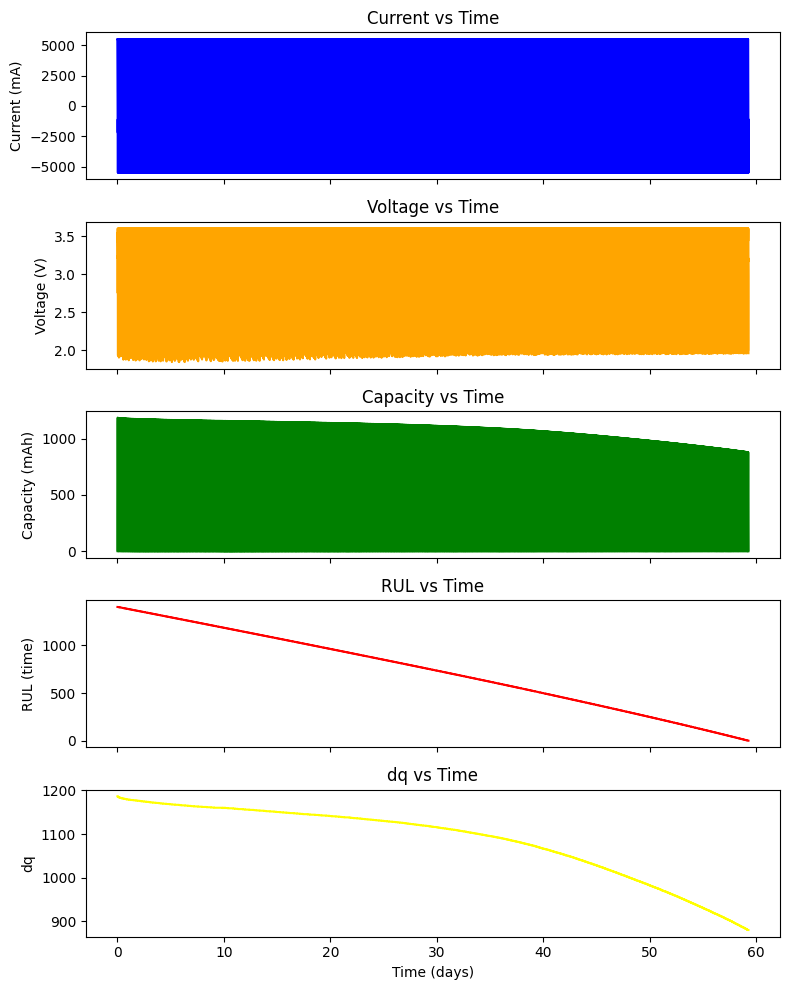

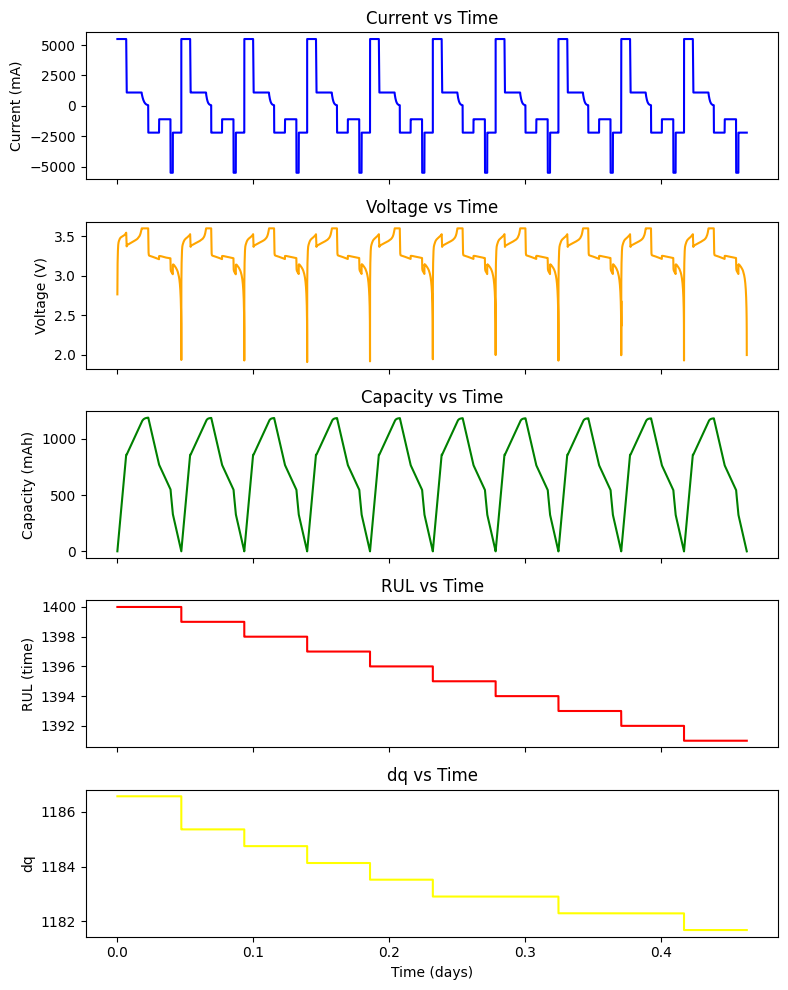

100%|██████████| 1400/1400 [01:26<00:00, 16.14it/s]


1-4


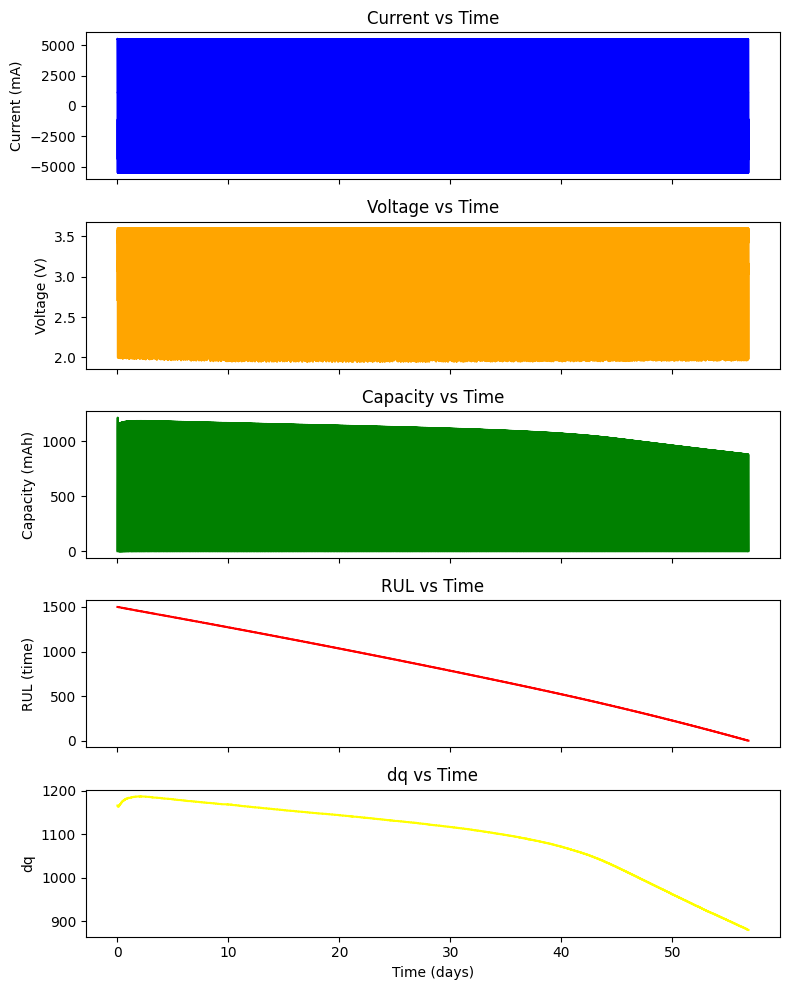

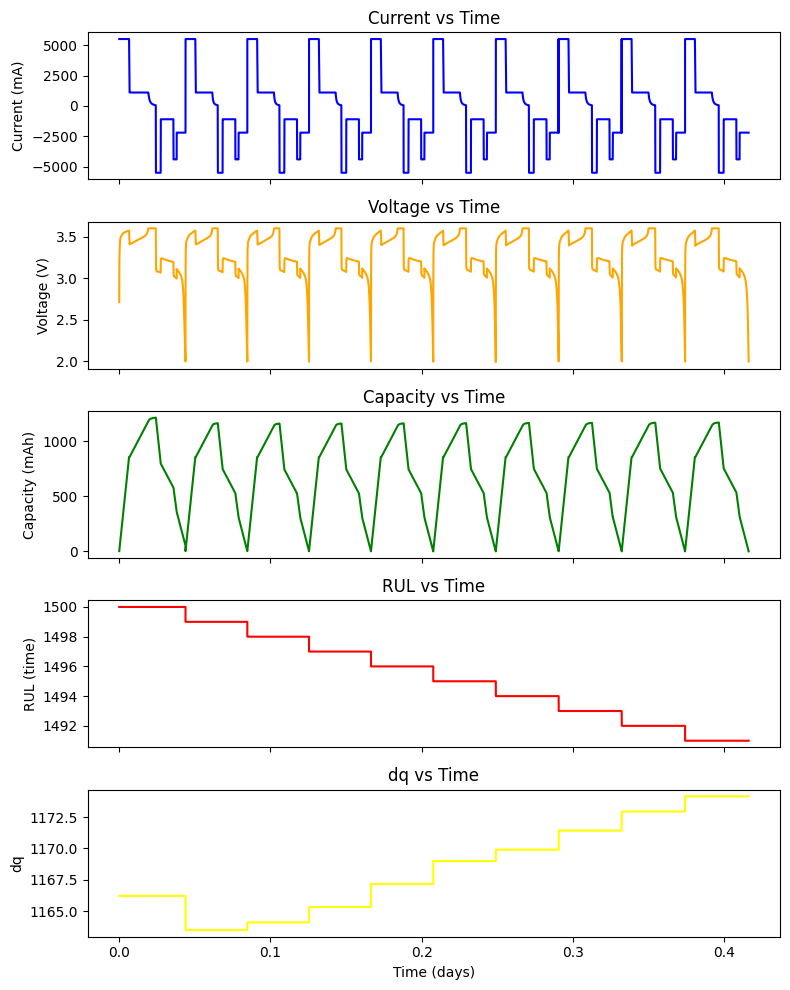

100%|██████████| 1500/1500 [01:23<00:00, 17.91it/s]


10-7


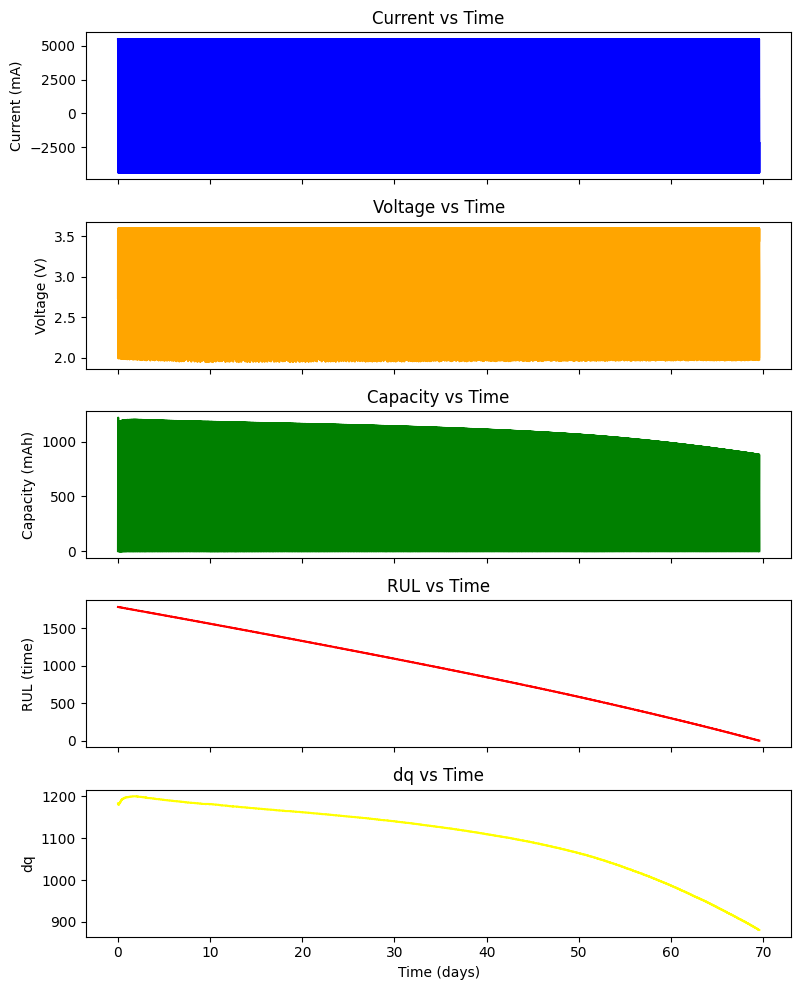

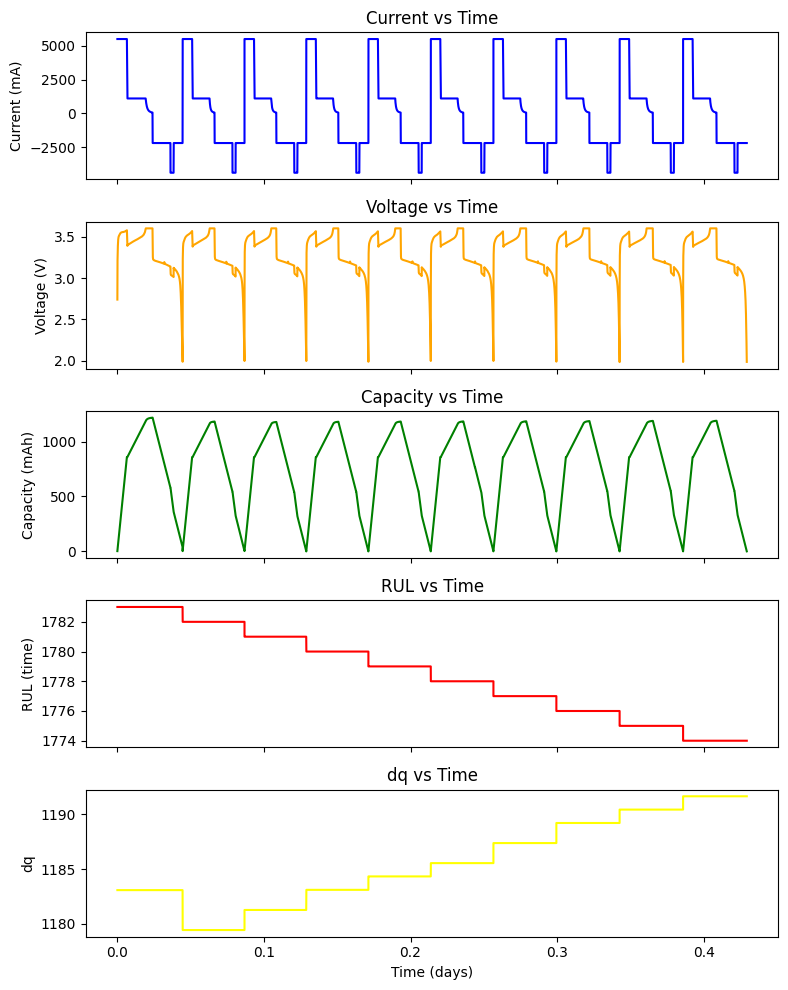

100%|██████████| 1783/1783 [01:41<00:00, 17.51it/s]


1-8


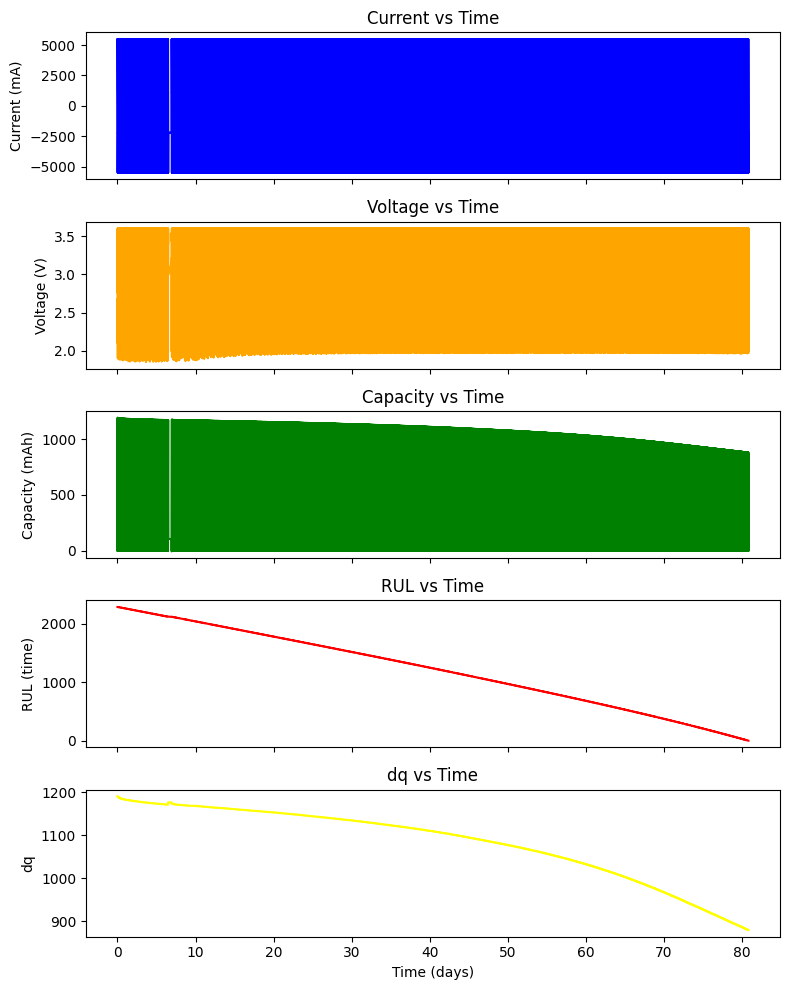

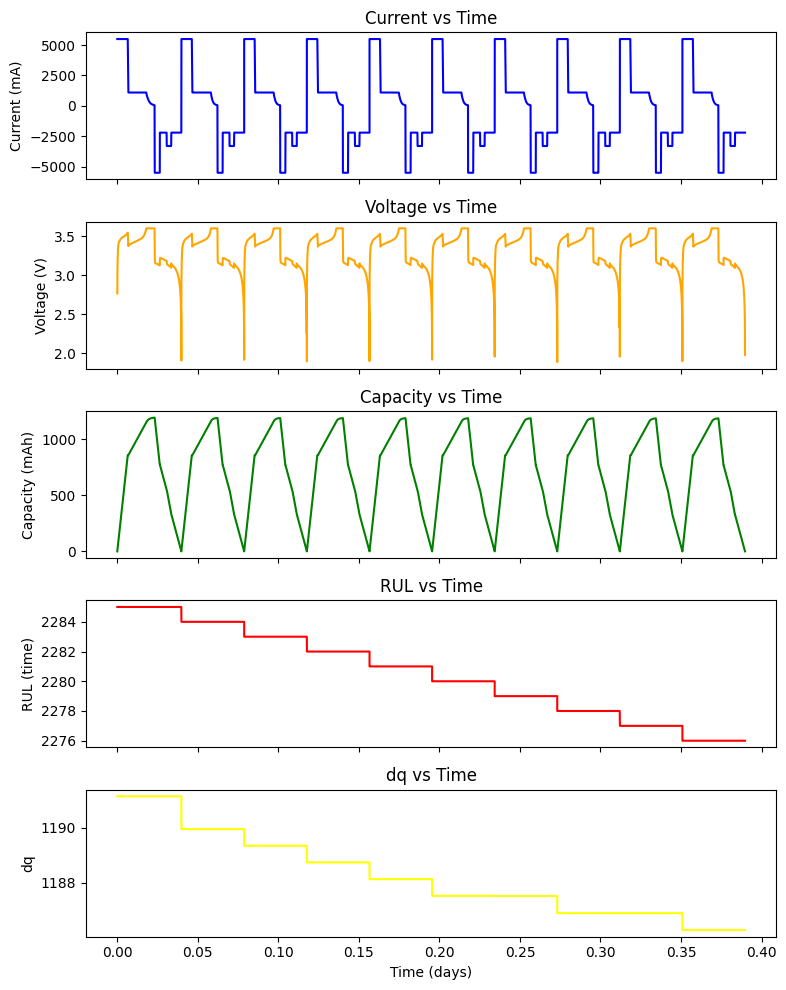

100%|██████████| 2285/2285 [02:16<00:00, 16.73it/s]


8-5


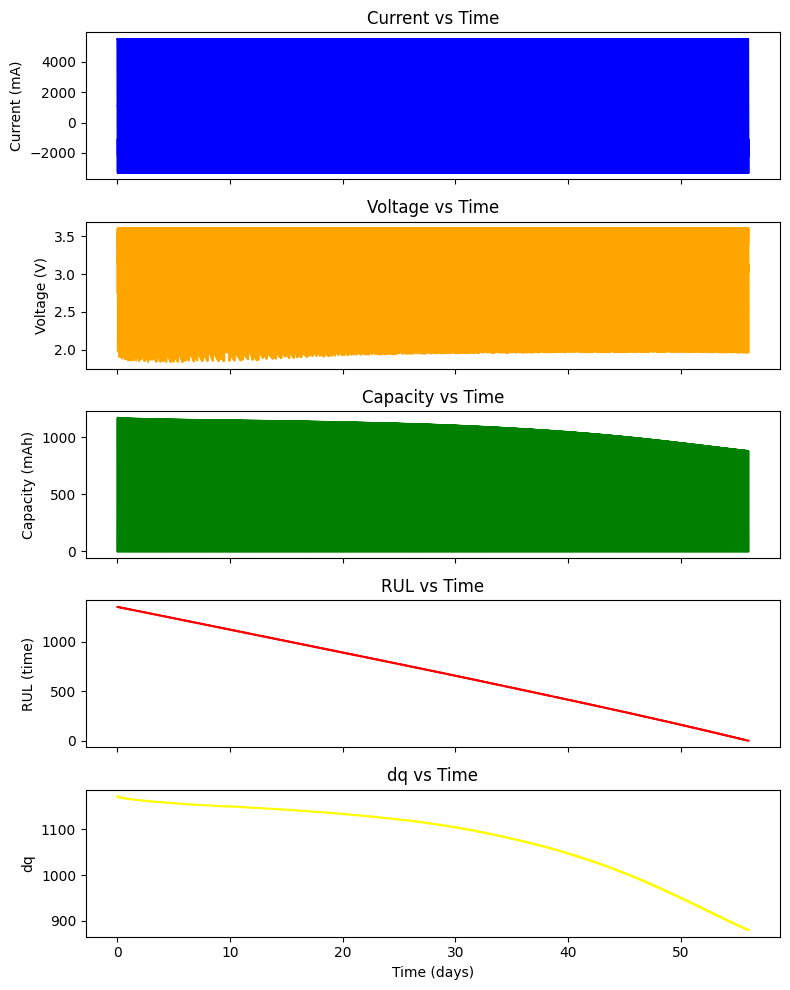

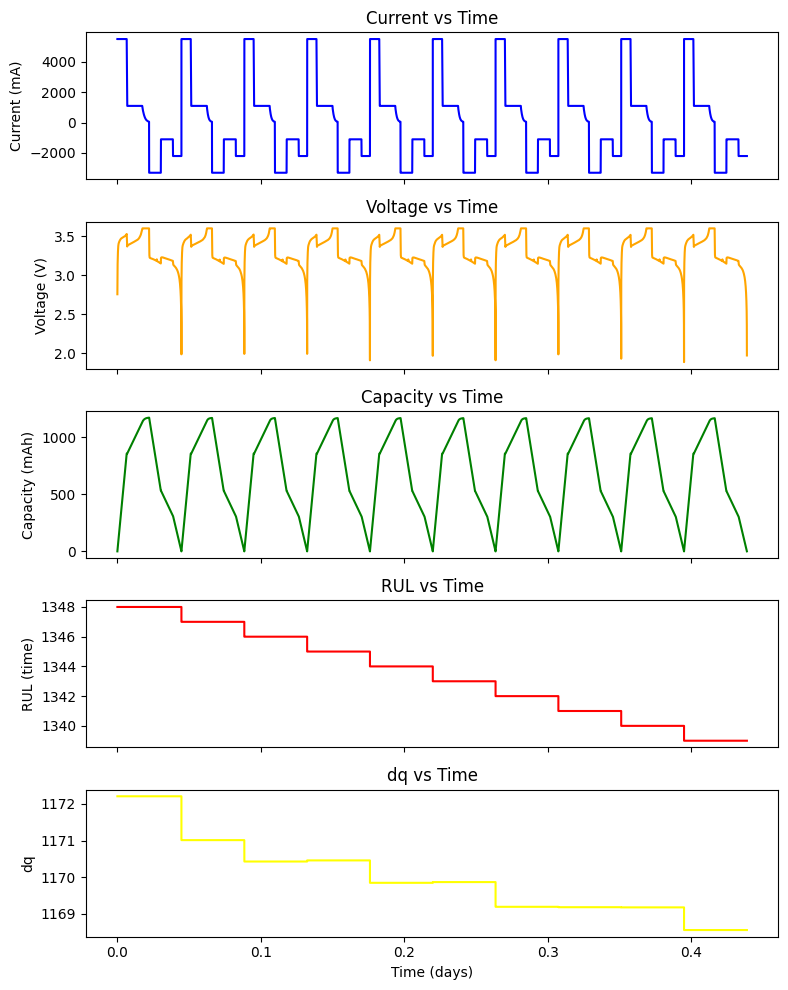

100%|██████████| 1348/1348 [01:21<00:00, 16.51it/s]


6-3


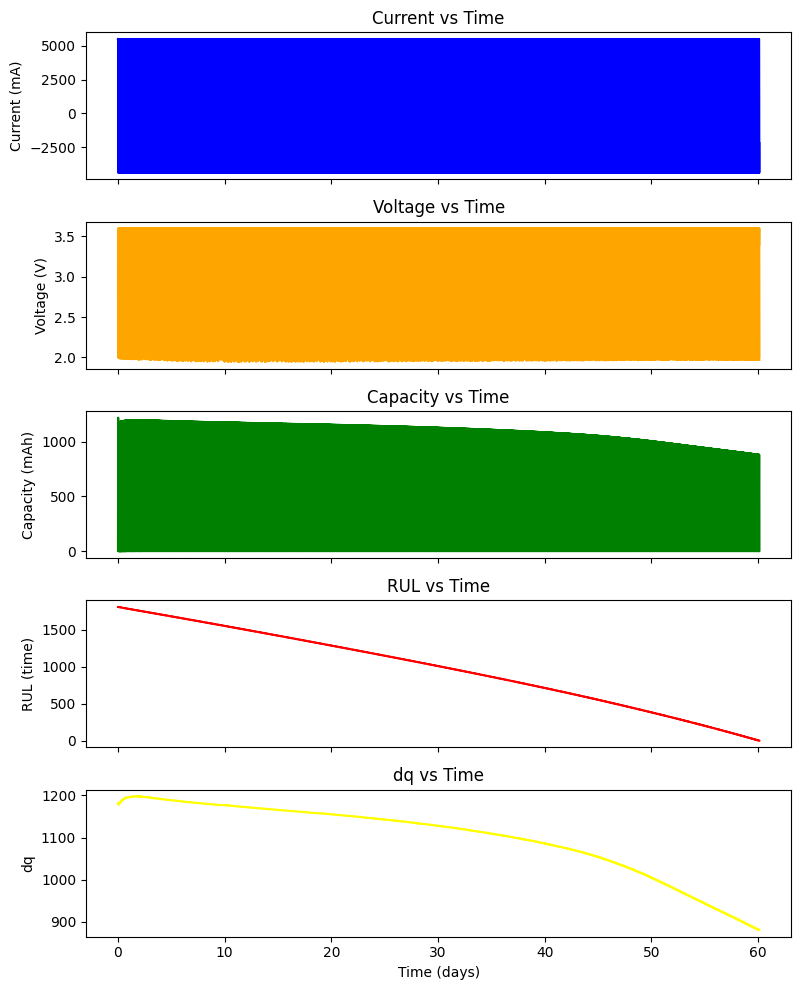

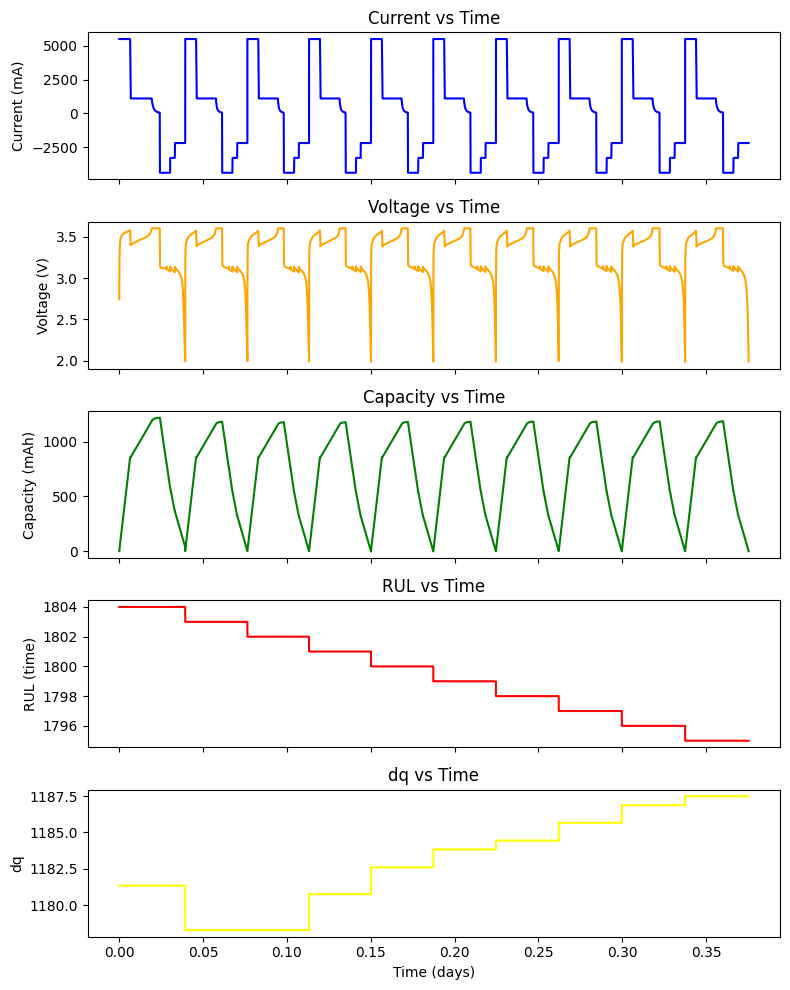

100%|██████████| 1804/1804 [01:31<00:00, 19.64it/s]


9-4


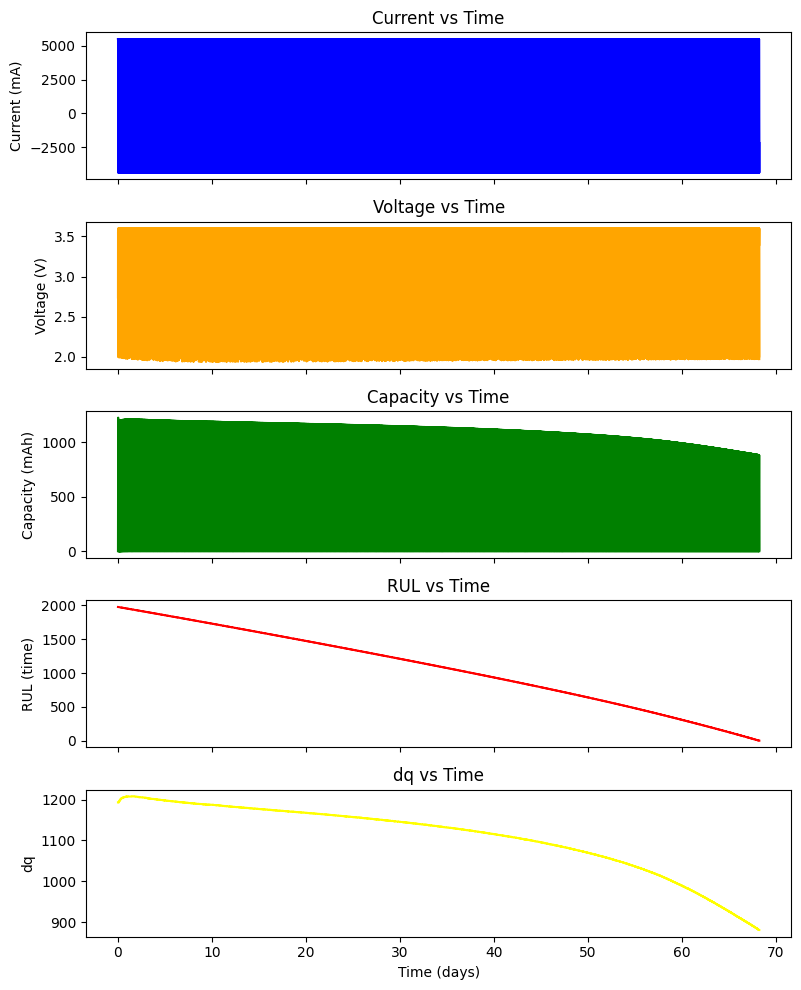

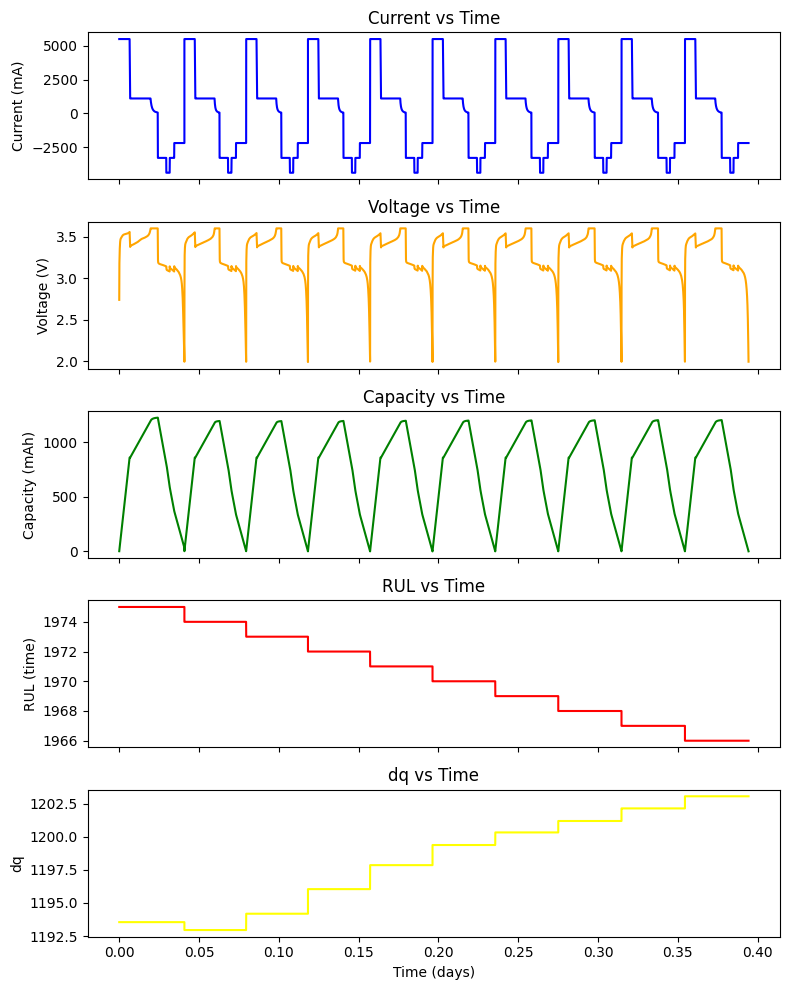

100%|██████████| 1975/1975 [01:41<00:00, 19.45it/s]


5-5


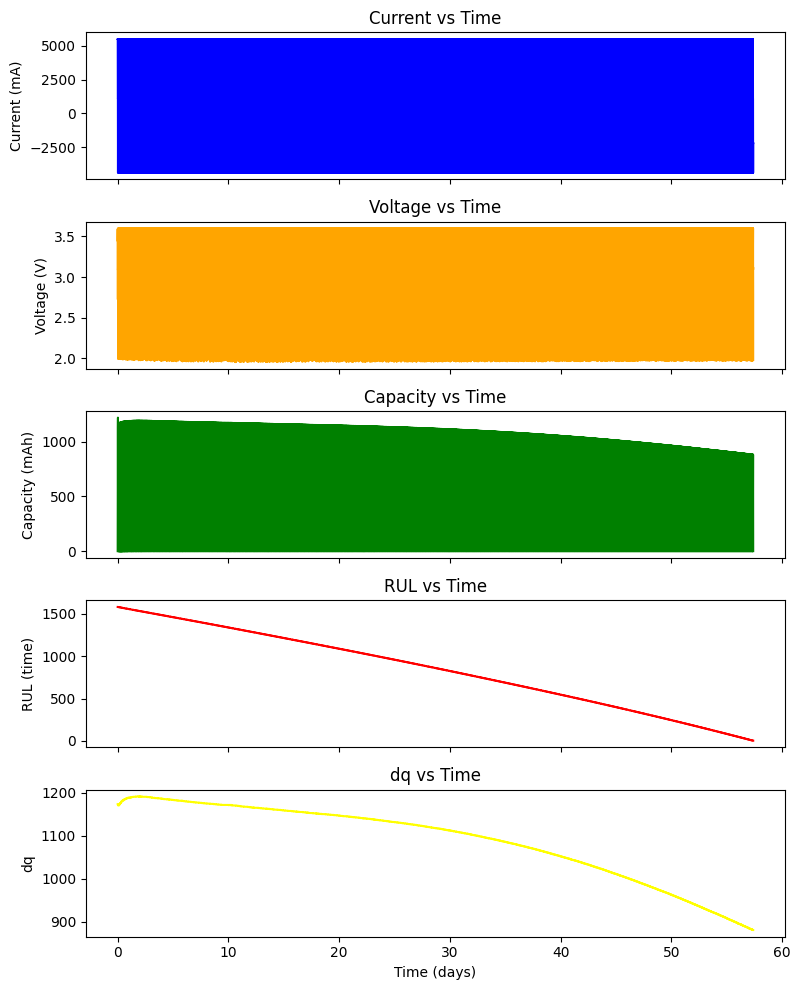

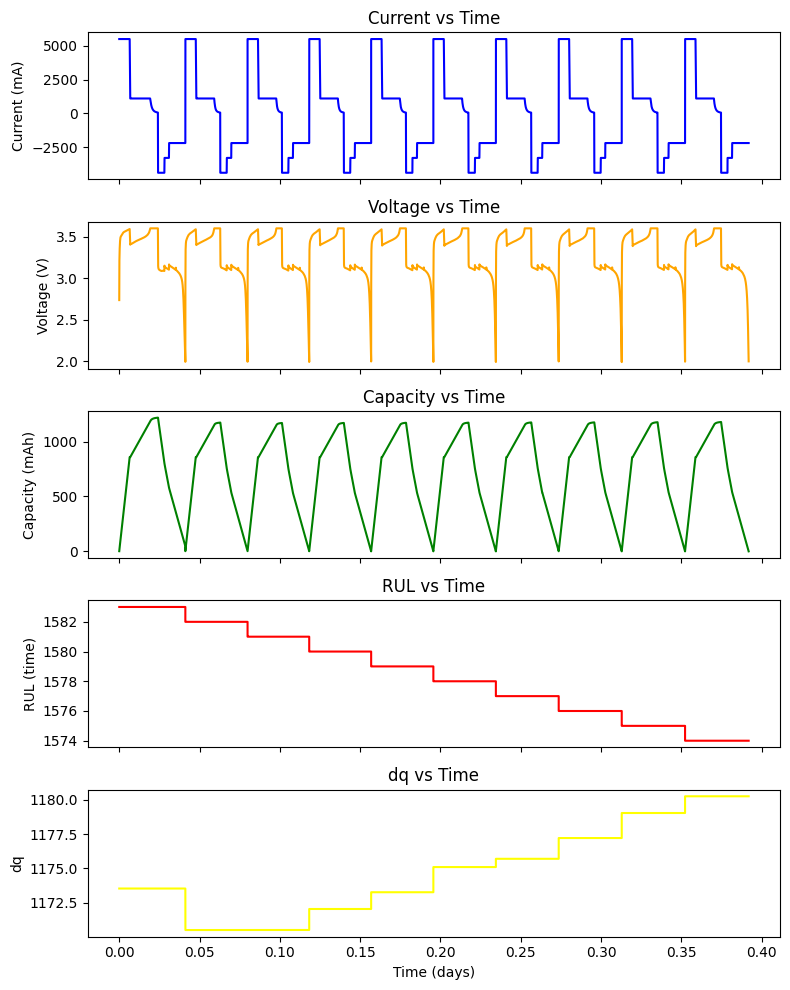

100%|██████████| 1583/1583 [01:23<00:00, 18.95it/s]


7-2


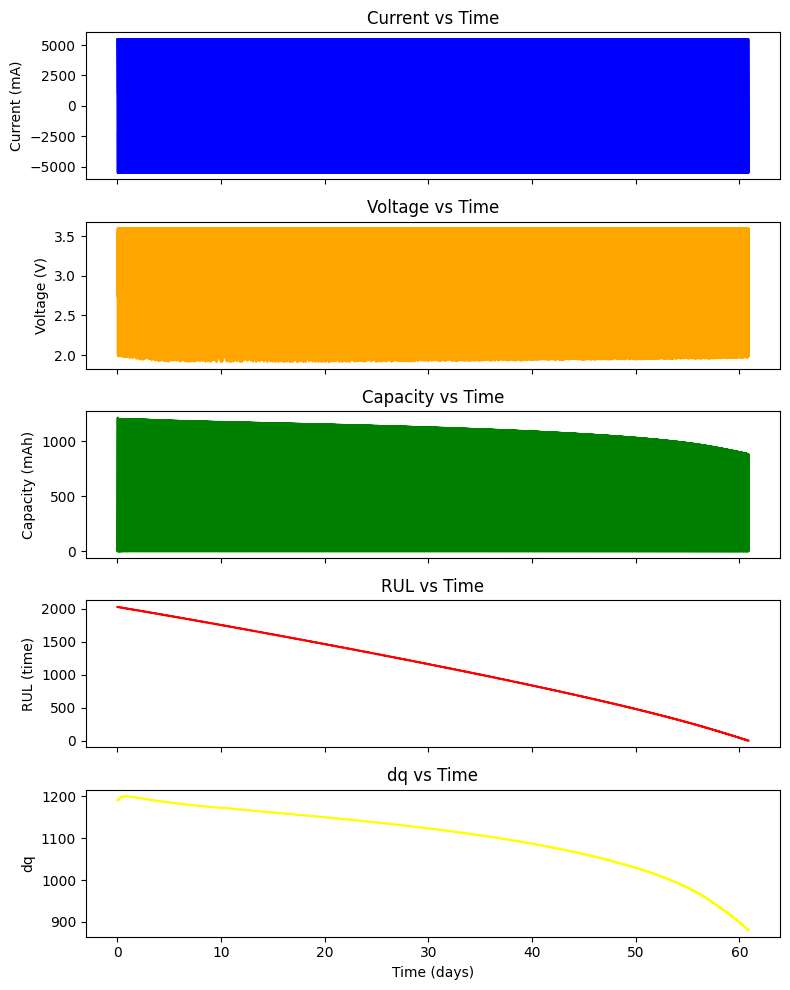

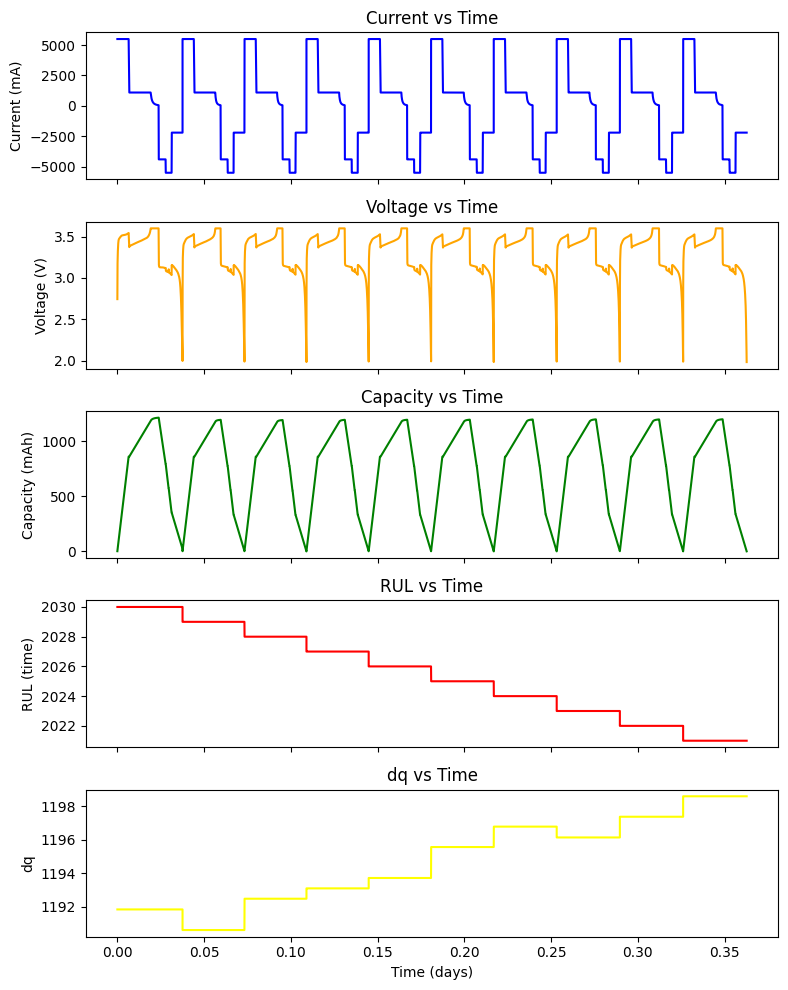

100%|██████████| 2030/2030 [01:33<00:00, 21.82it/s]


4-2


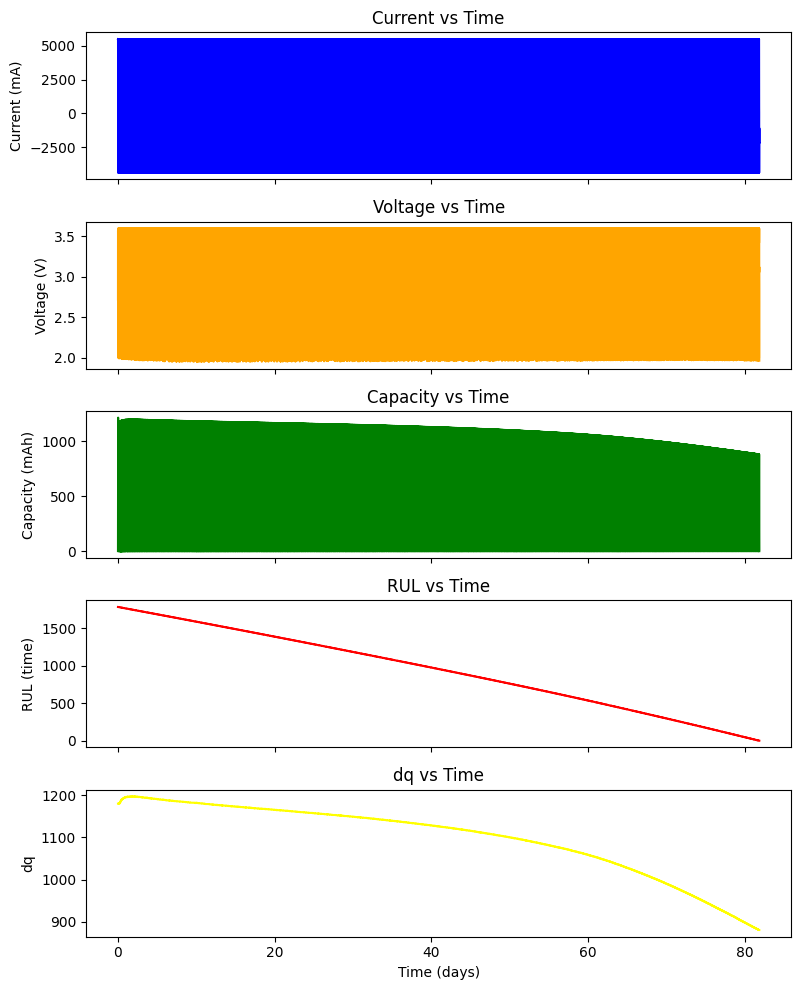

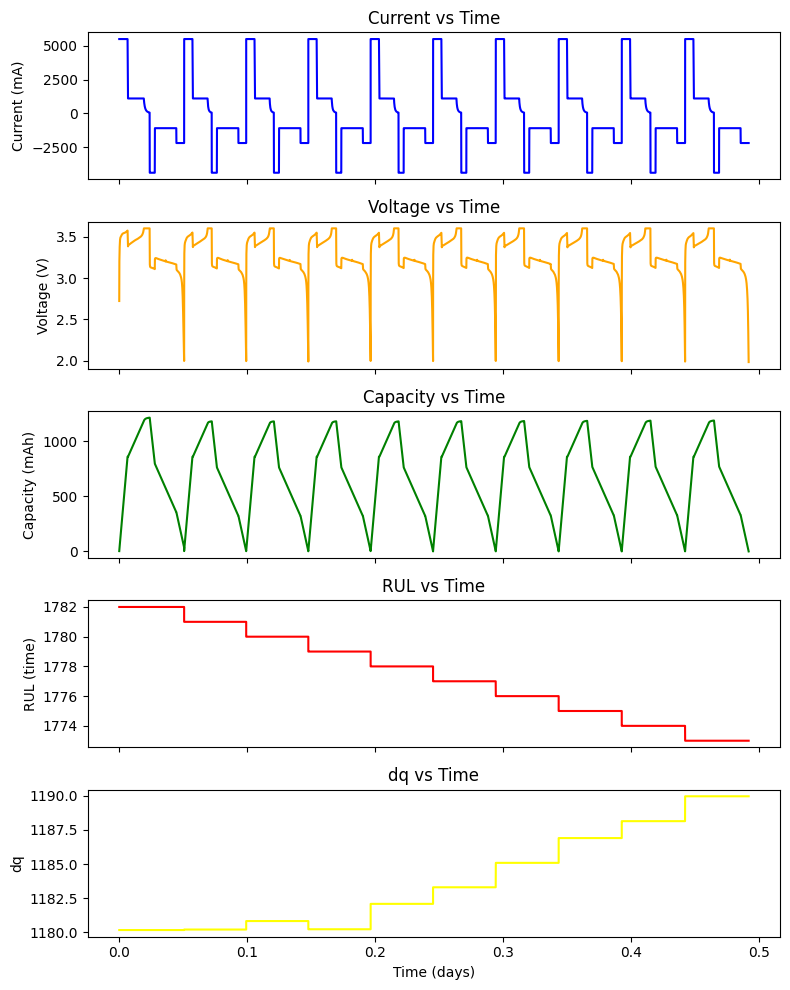

100%|██████████| 1782/1782 [02:02<00:00, 14.60it/s]


8-3


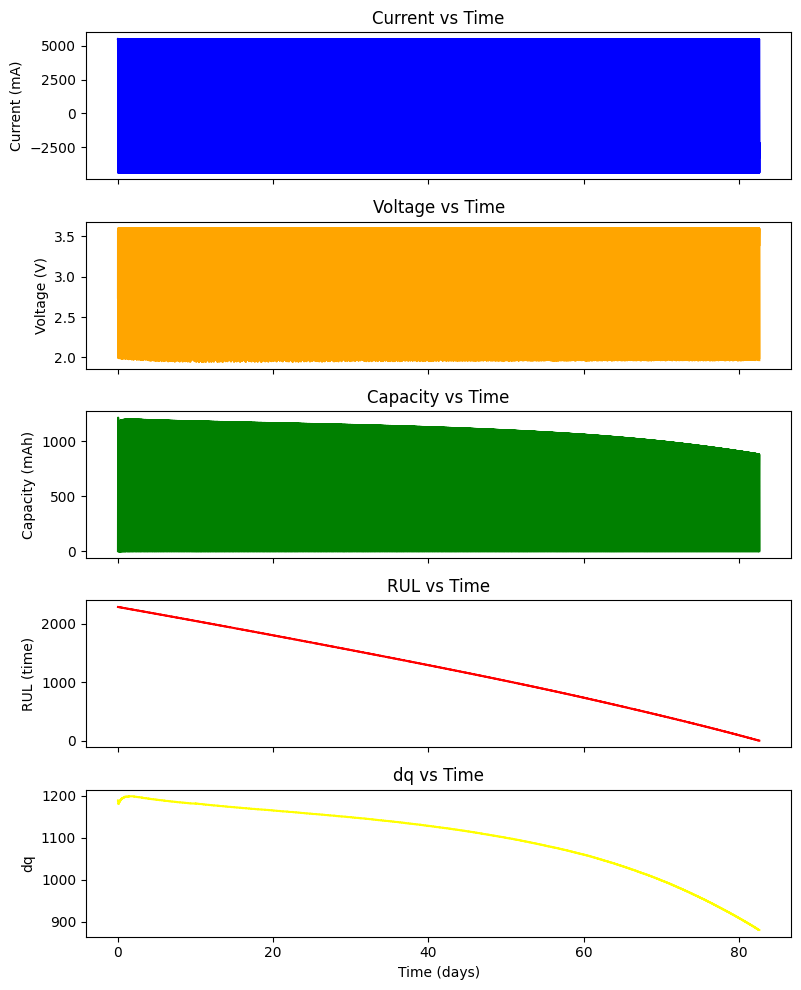

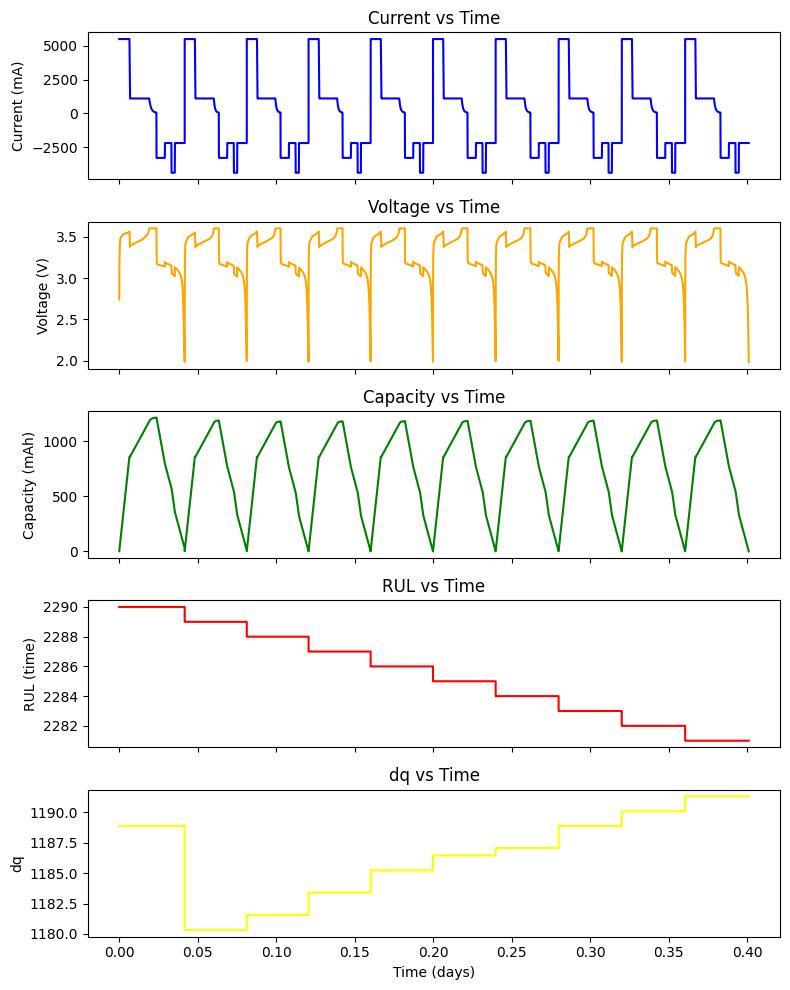

100%|██████████| 2290/2290 [02:01<00:00, 18.85it/s]


1-7


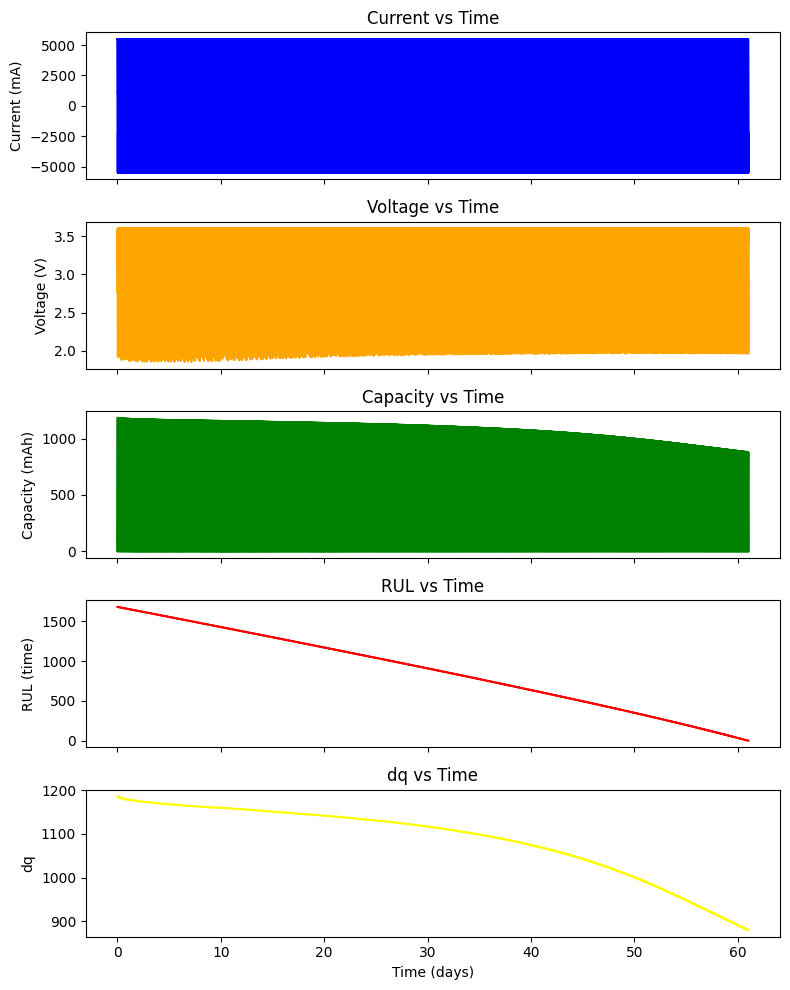

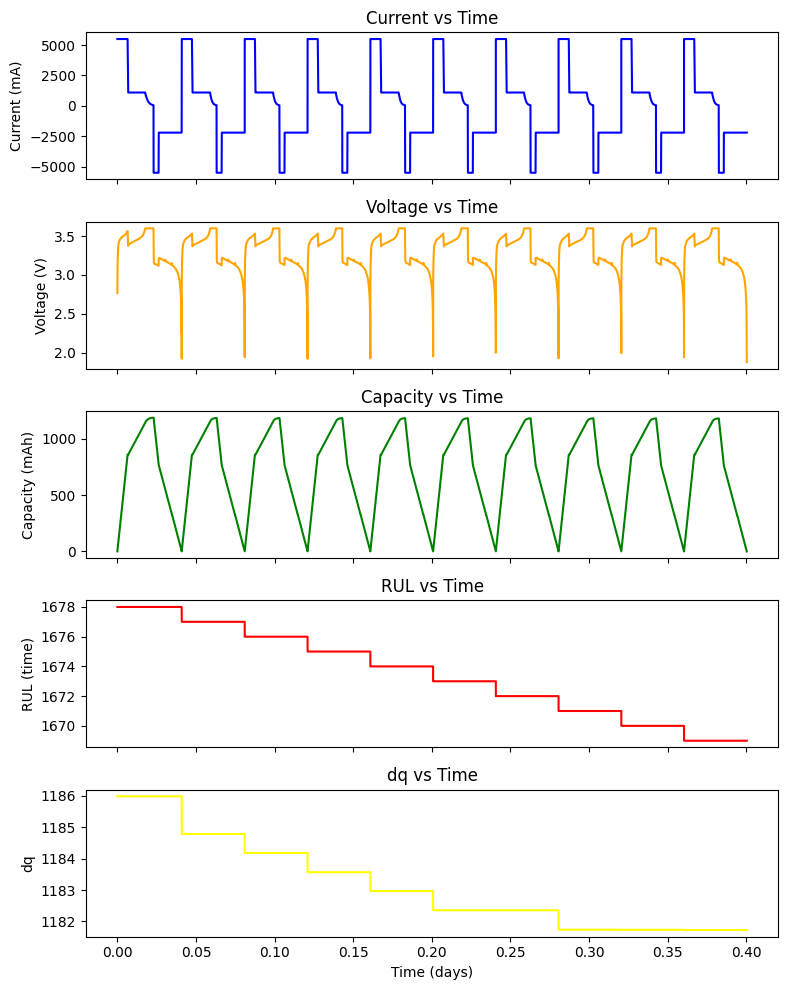

100%|██████████| 1678/1678 [01:29<00:00, 18.73it/s]


10-3


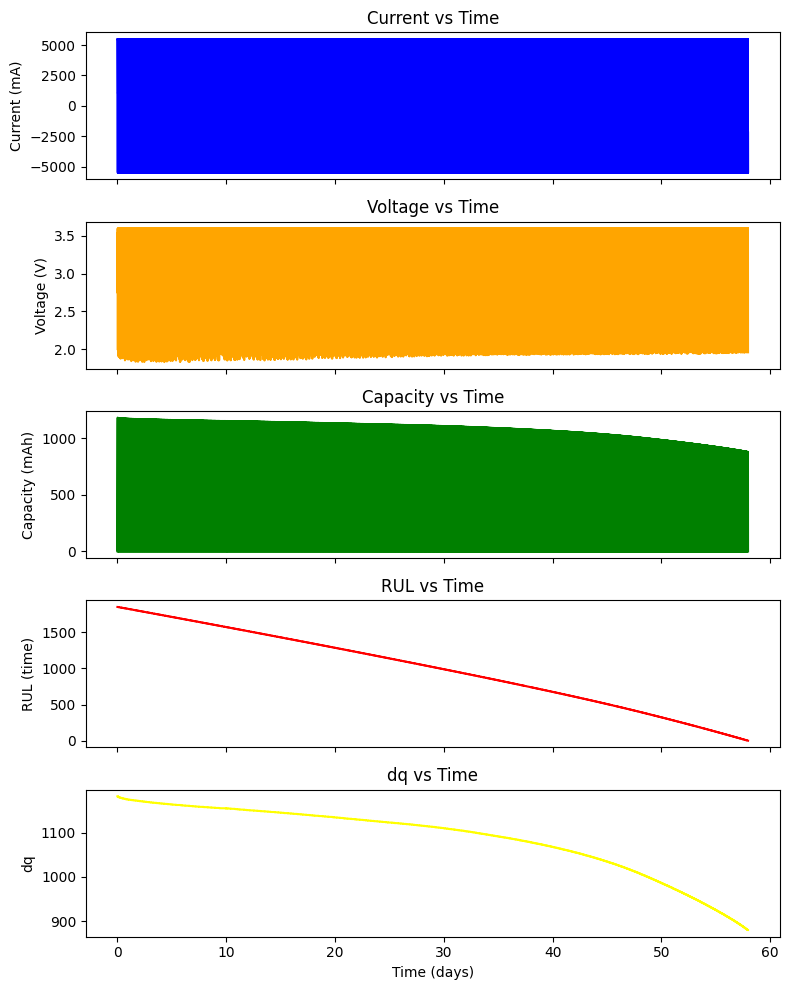

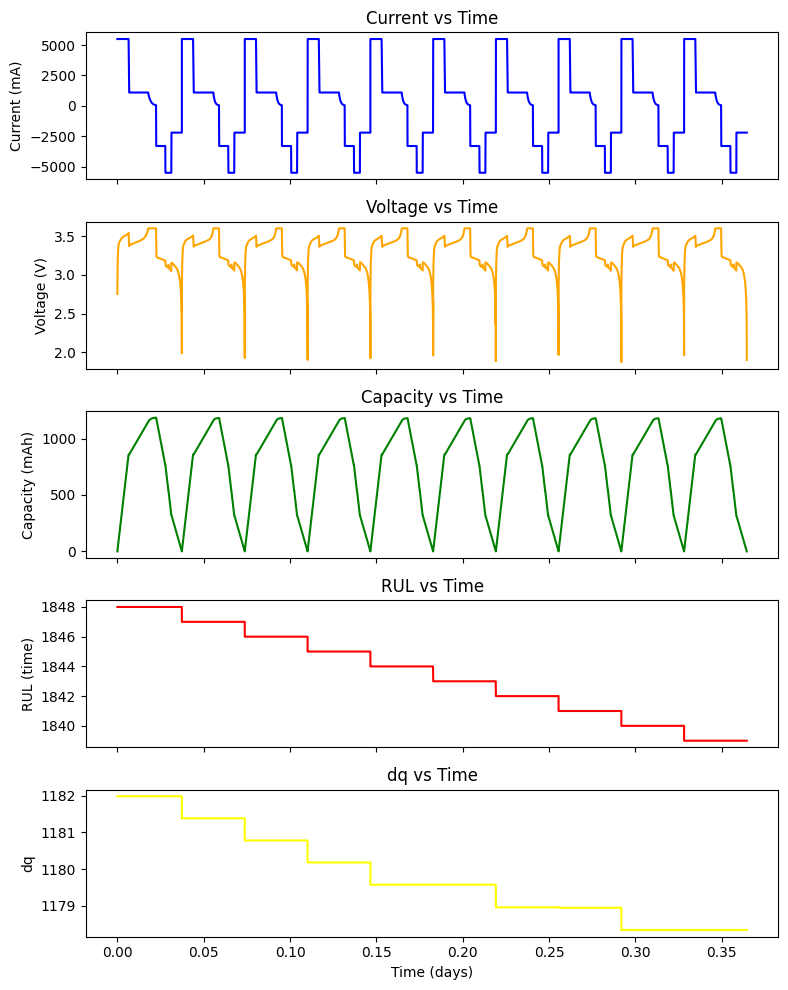

100%|██████████| 1848/1848 [01:26<00:00, 21.33it/s]


3-8


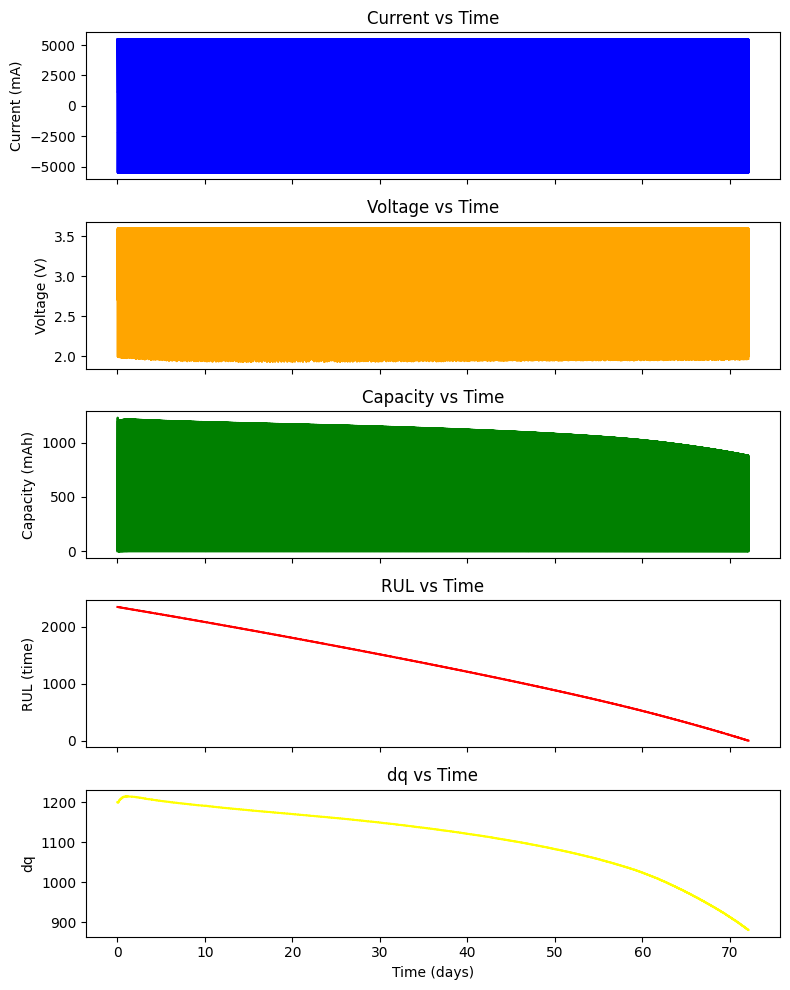

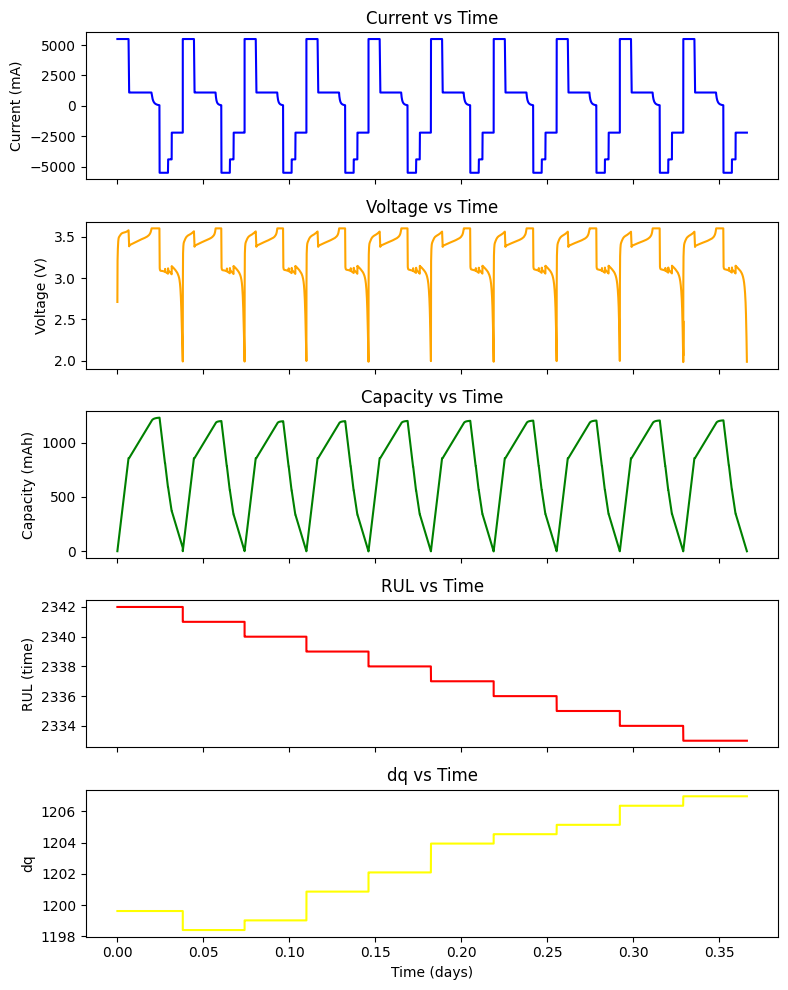

100%|██████████| 2342/2342 [01:52<00:00, 20.76it/s]


5-3


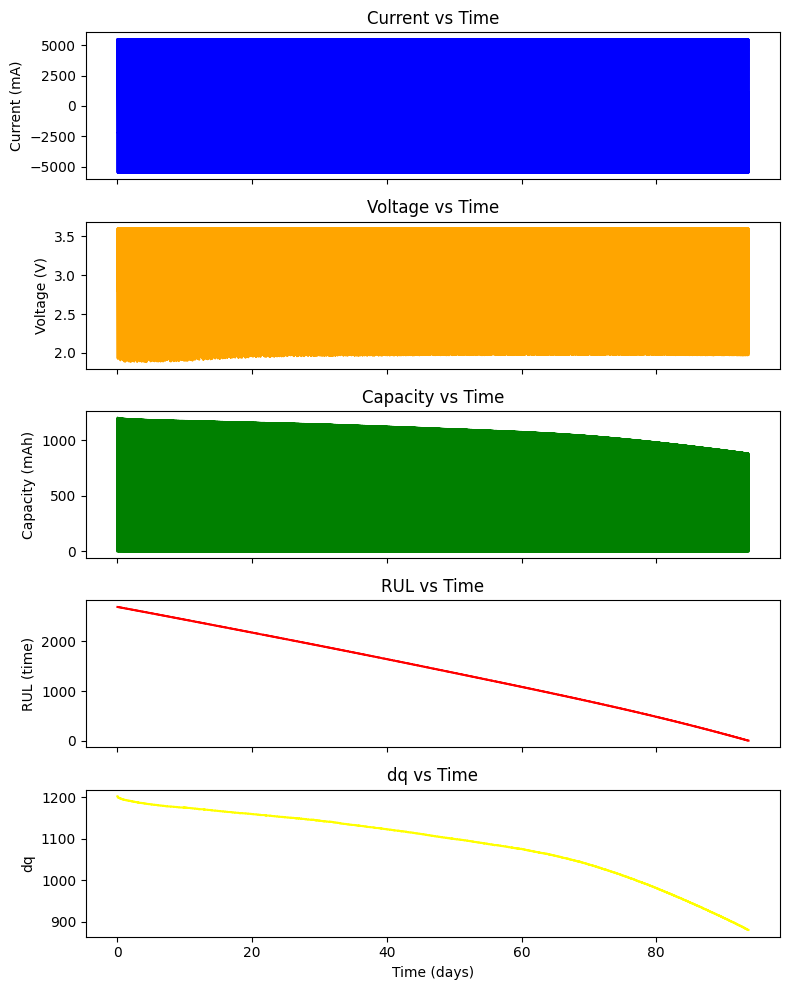

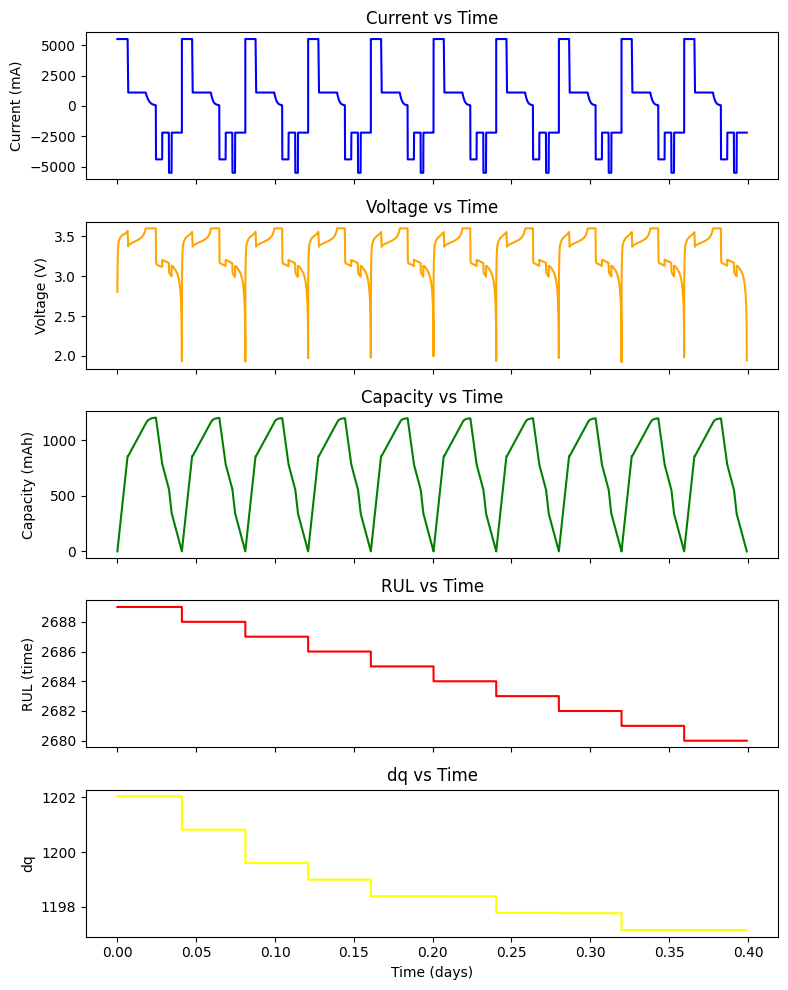

100%|██████████| 2689/2689 [02:22<00:00, 18.81it/s]


6-4


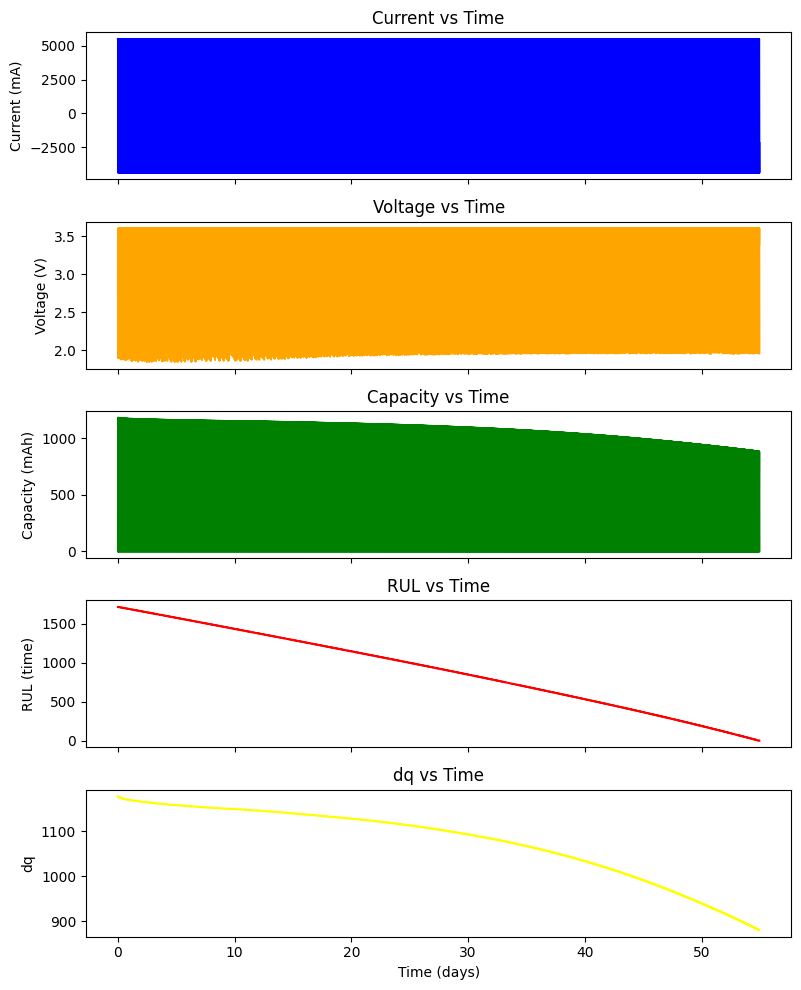

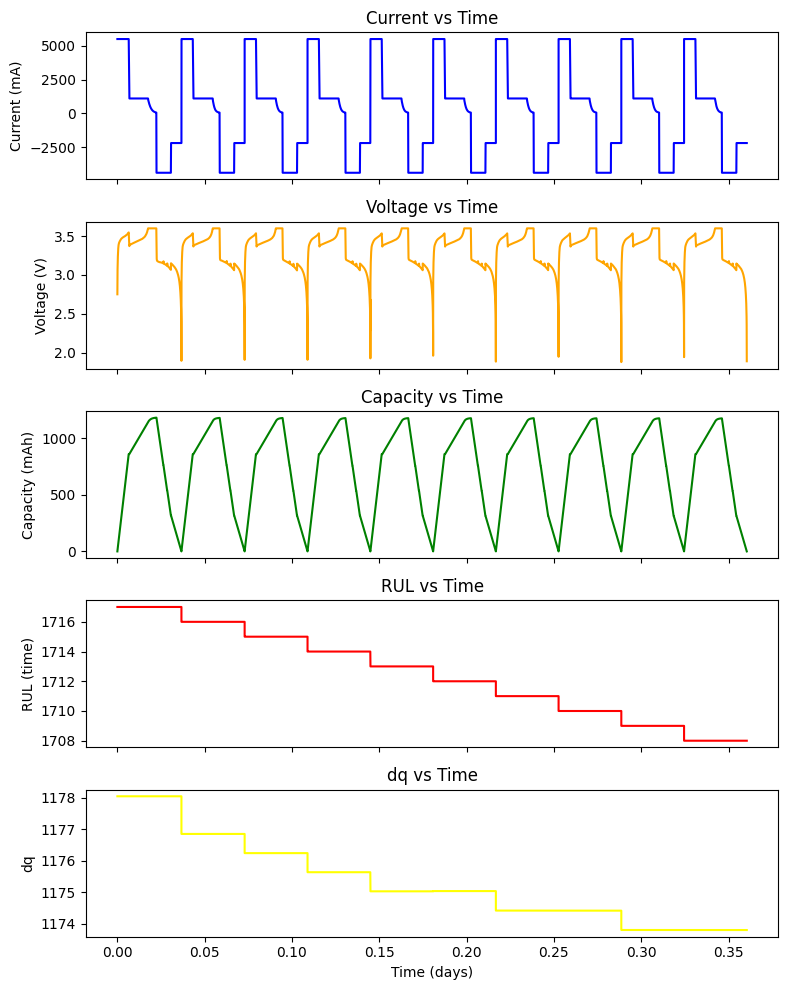

100%|██████████| 1717/1717 [01:23<00:00, 20.51it/s]


6-8


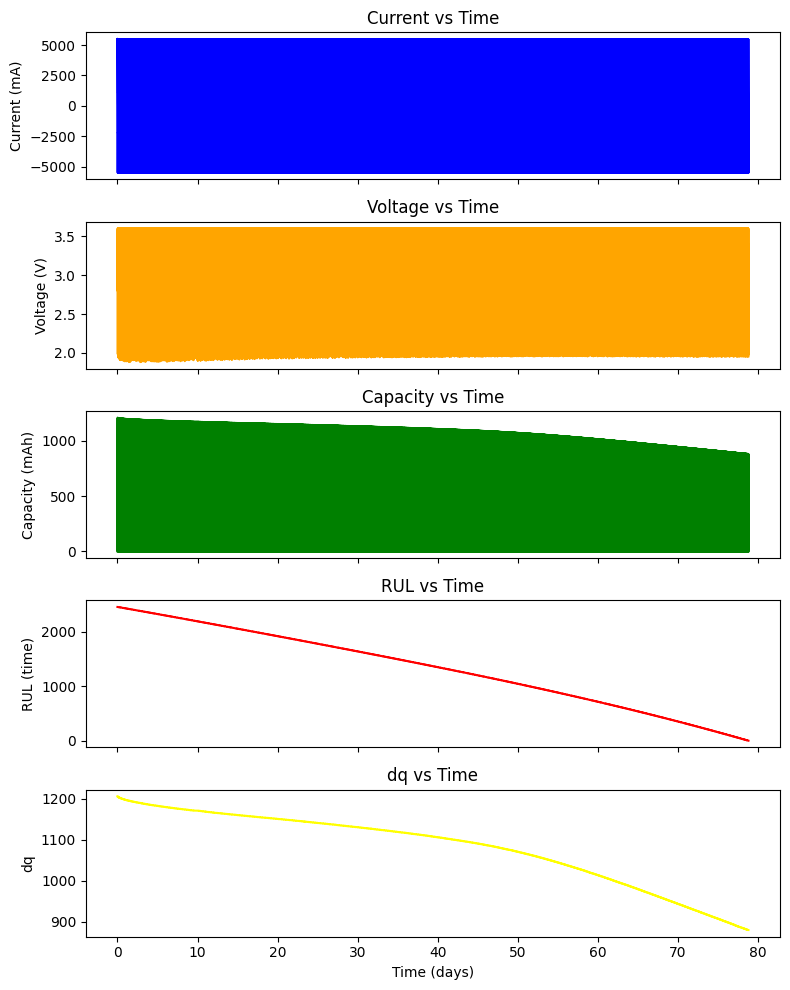

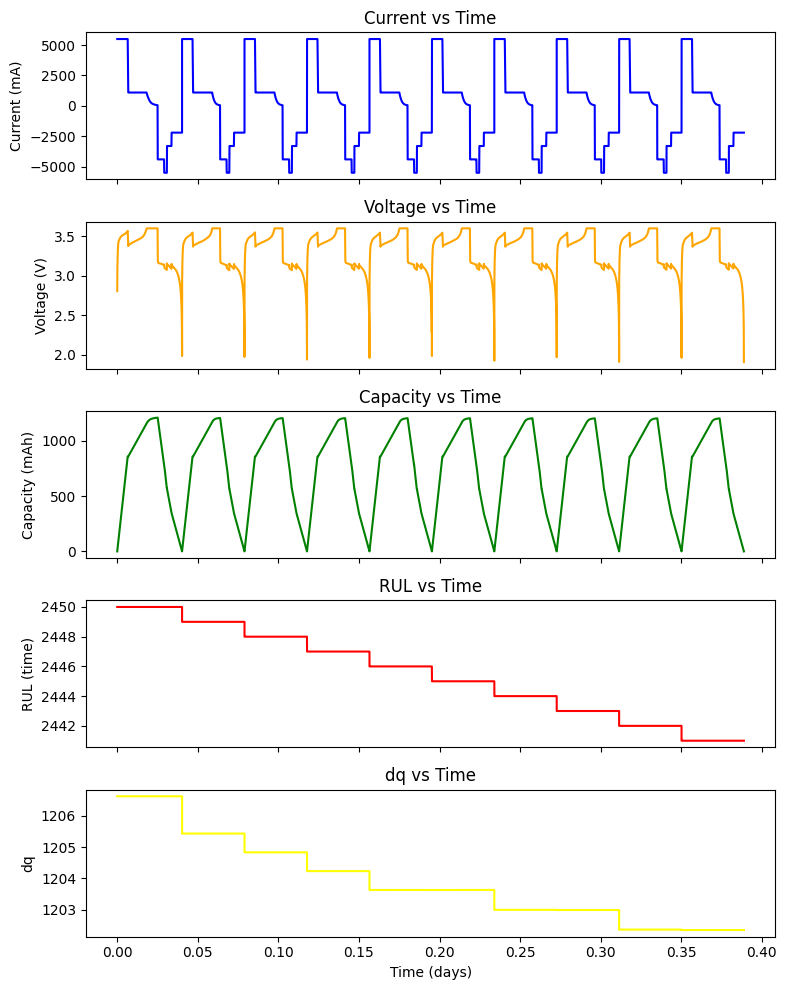

100%|██████████| 2450/2450 [02:04<00:00, 19.75it/s]


9-6


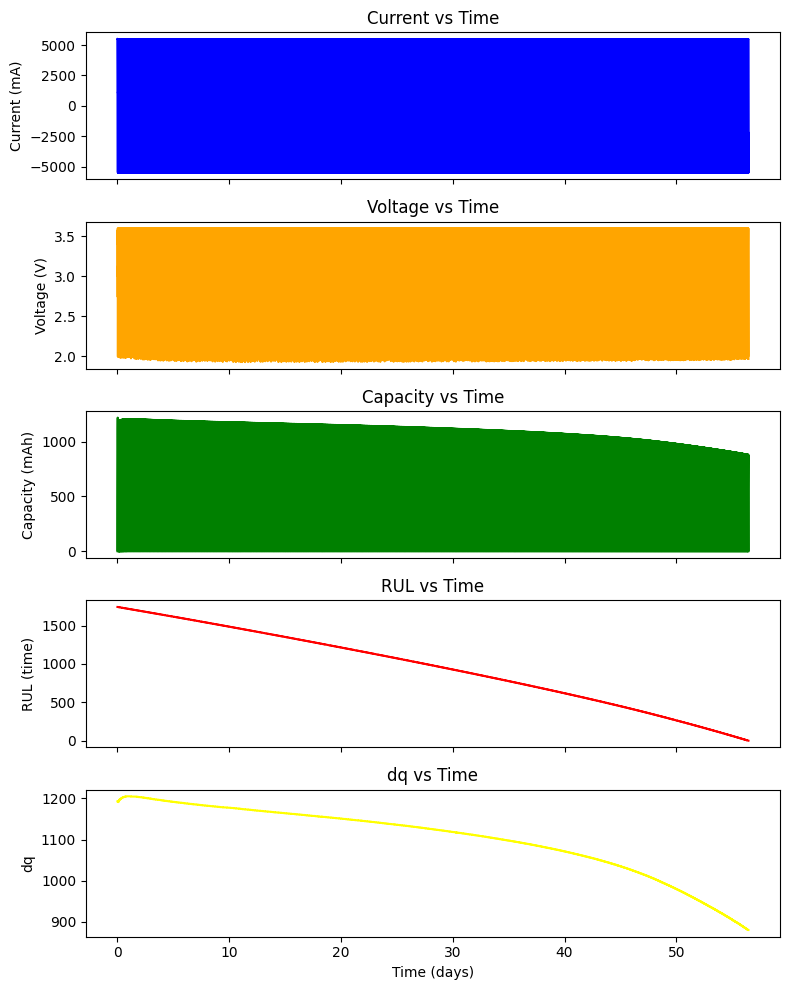

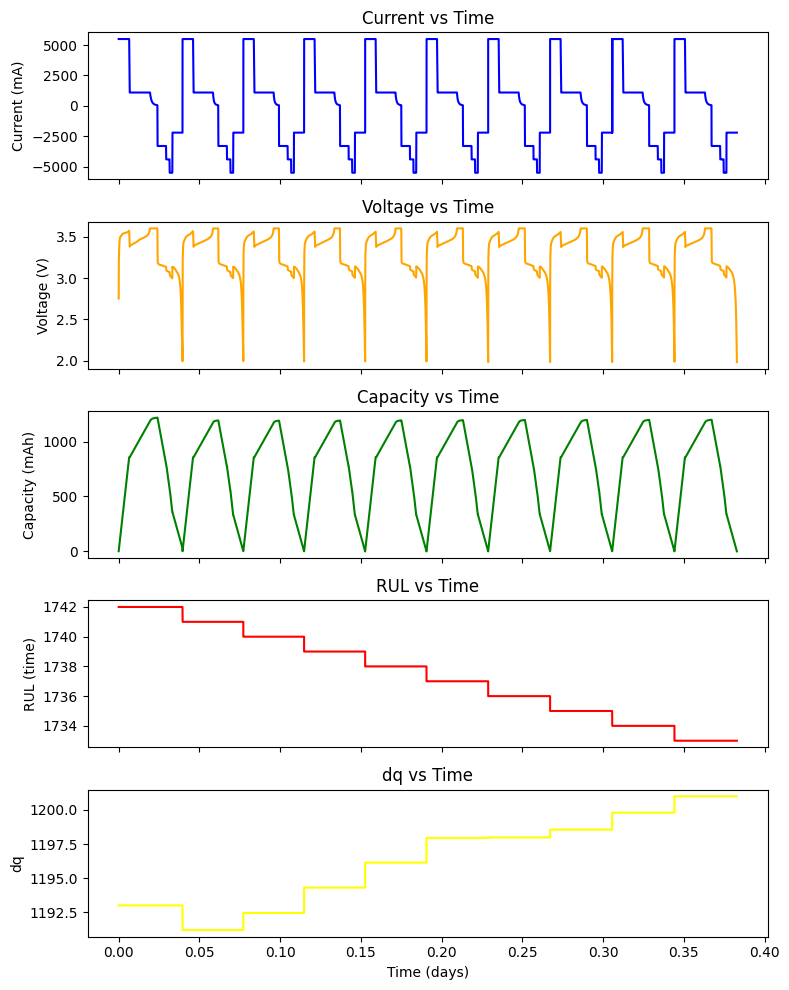

100%|██████████| 1742/1742 [01:25<00:00, 20.41it/s]


3-5


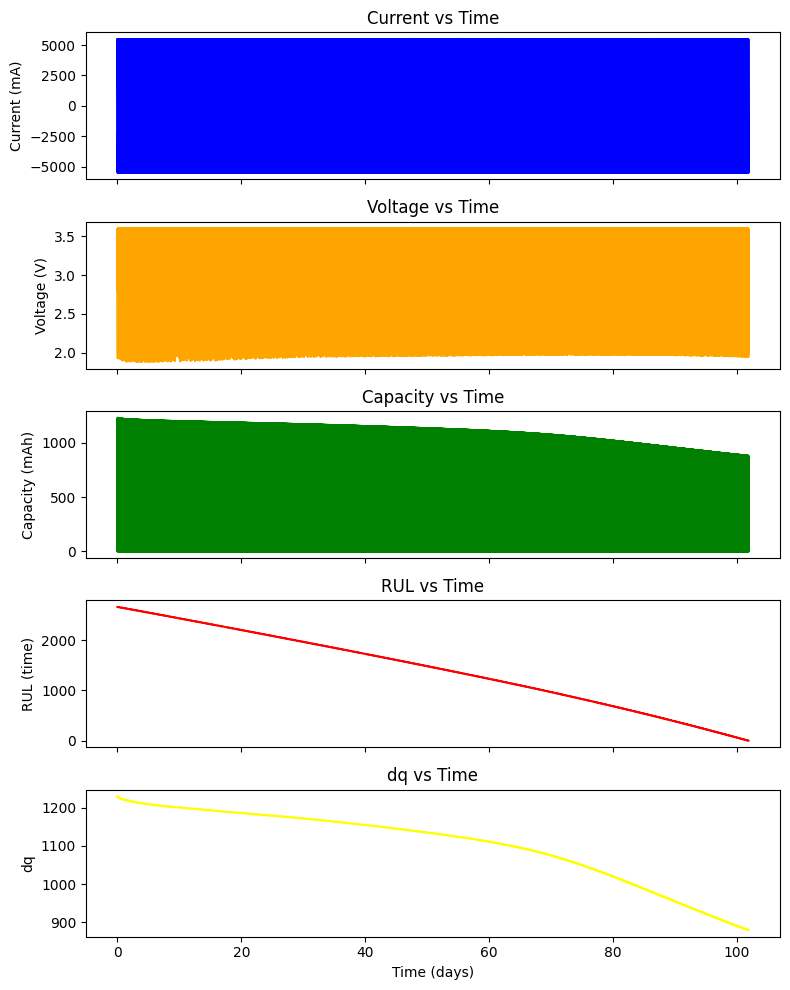

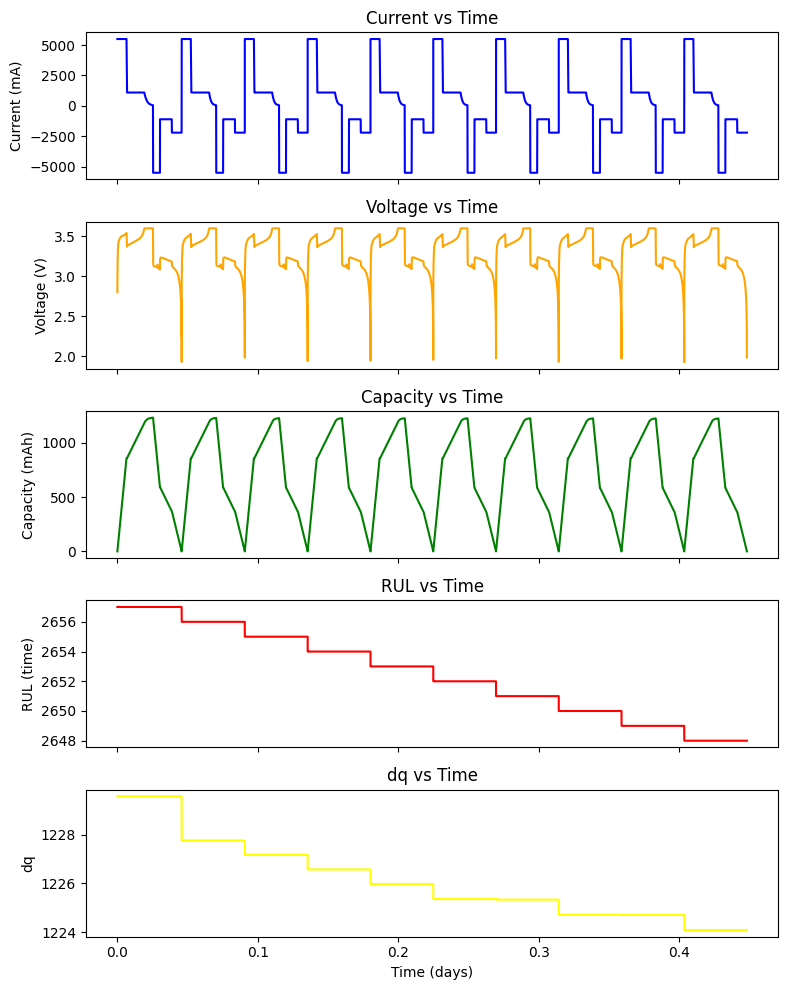

100%|██████████| 2657/2657 [02:34<00:00, 17.19it/s]


2-4


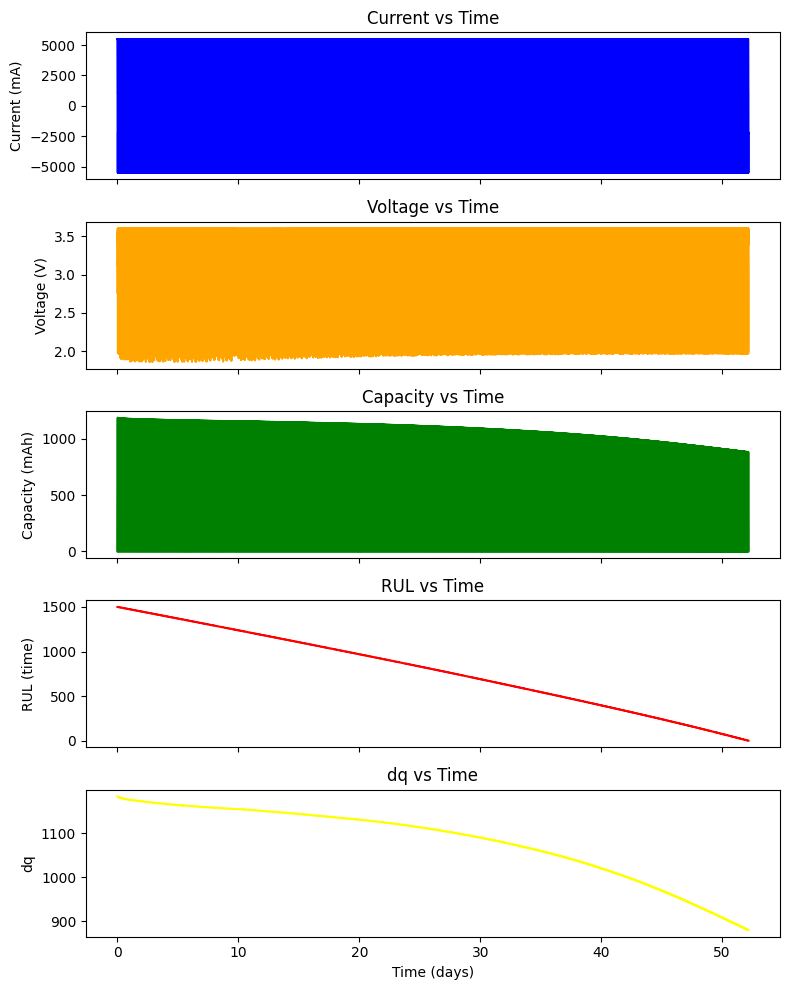

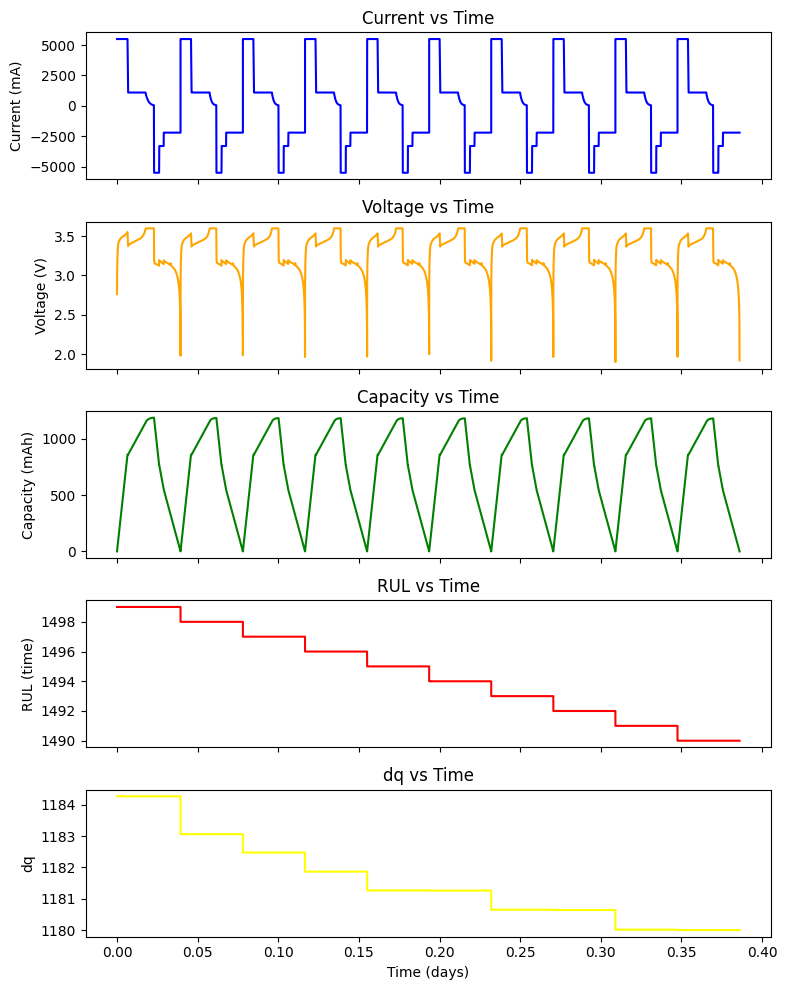

100%|██████████| 1499/1499 [01:22<00:00, 18.23it/s]


1-5


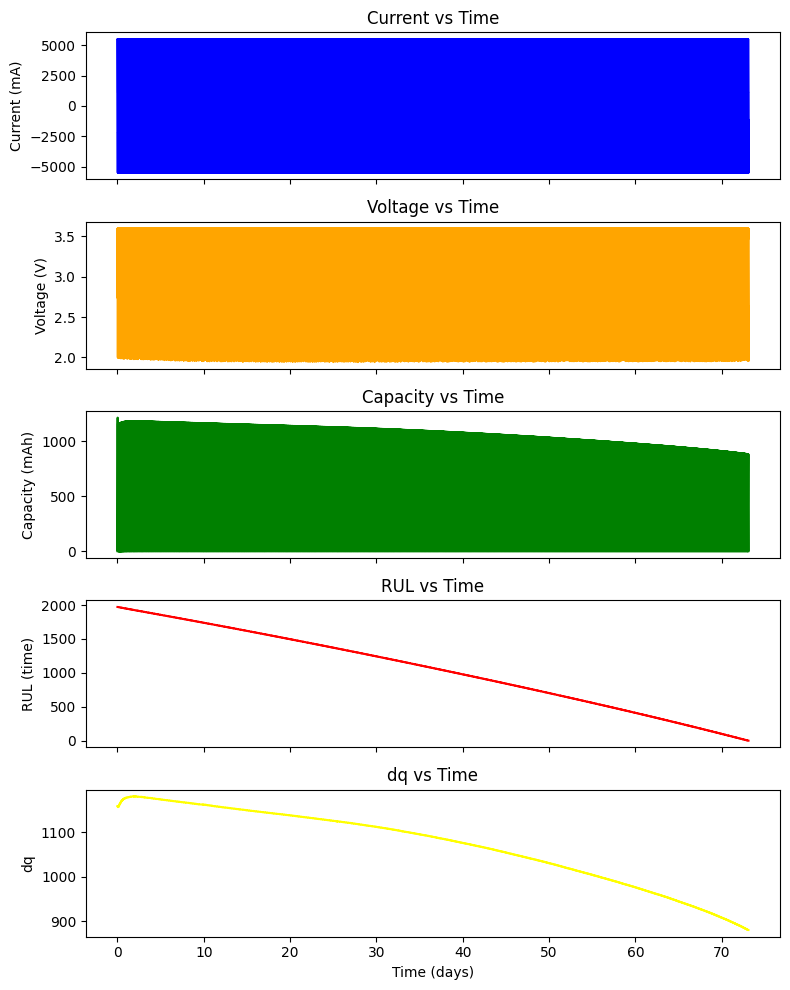

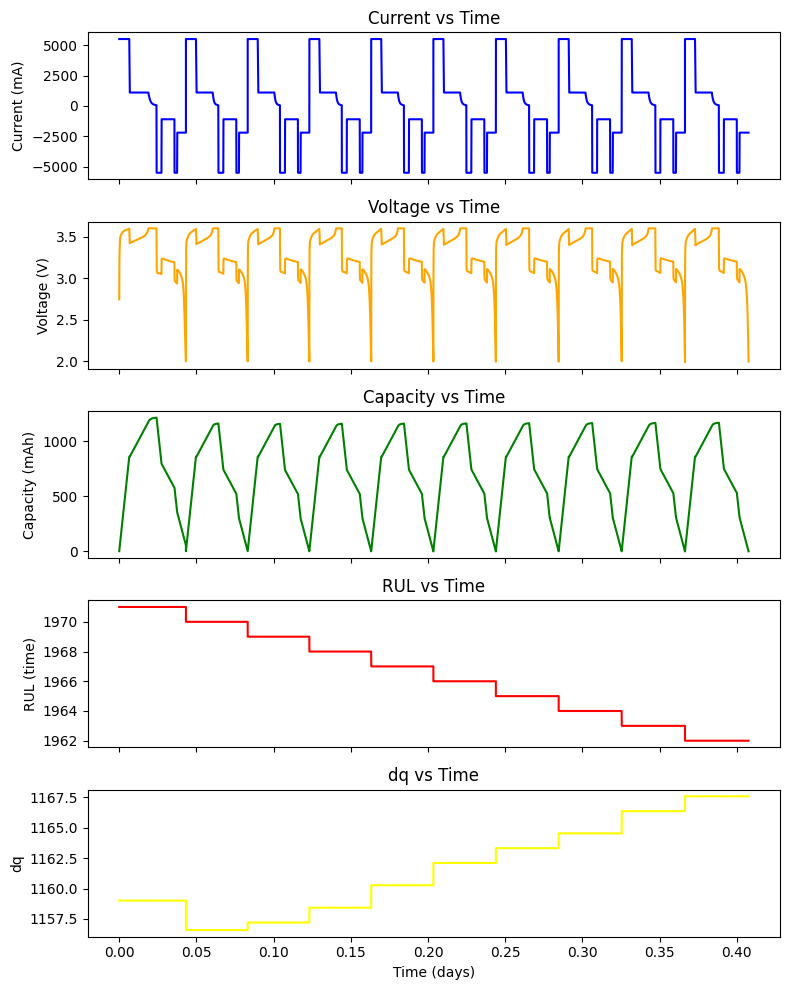

100%|██████████| 1971/1971 [01:49<00:00, 17.98it/s]


4-8


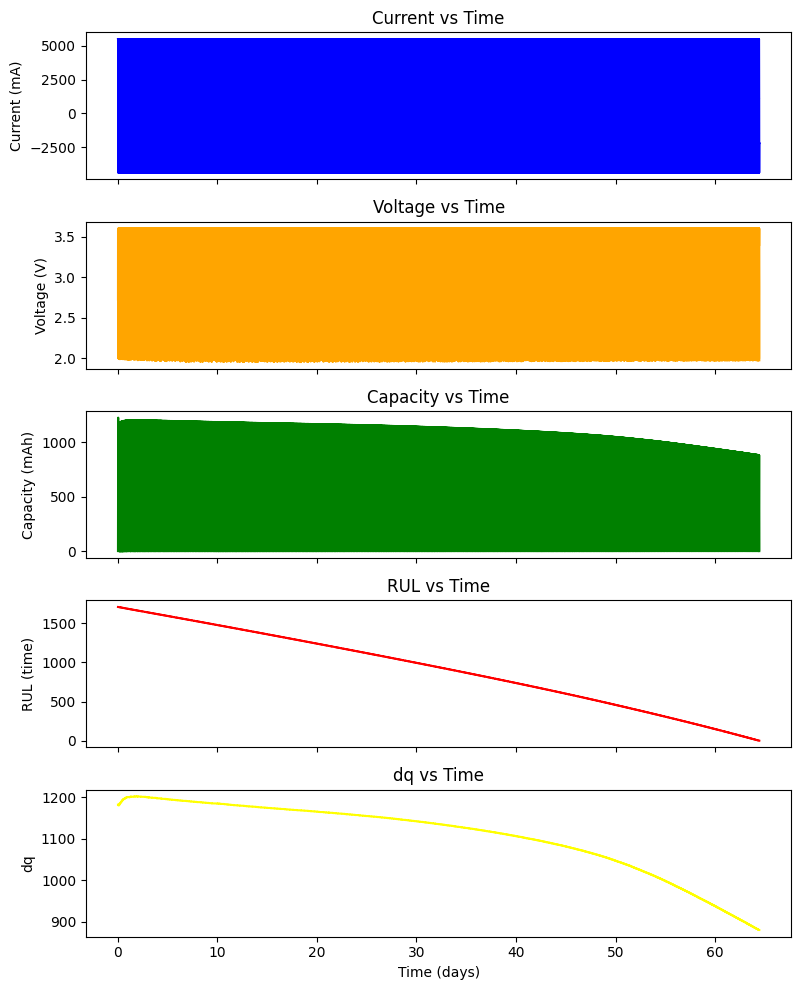

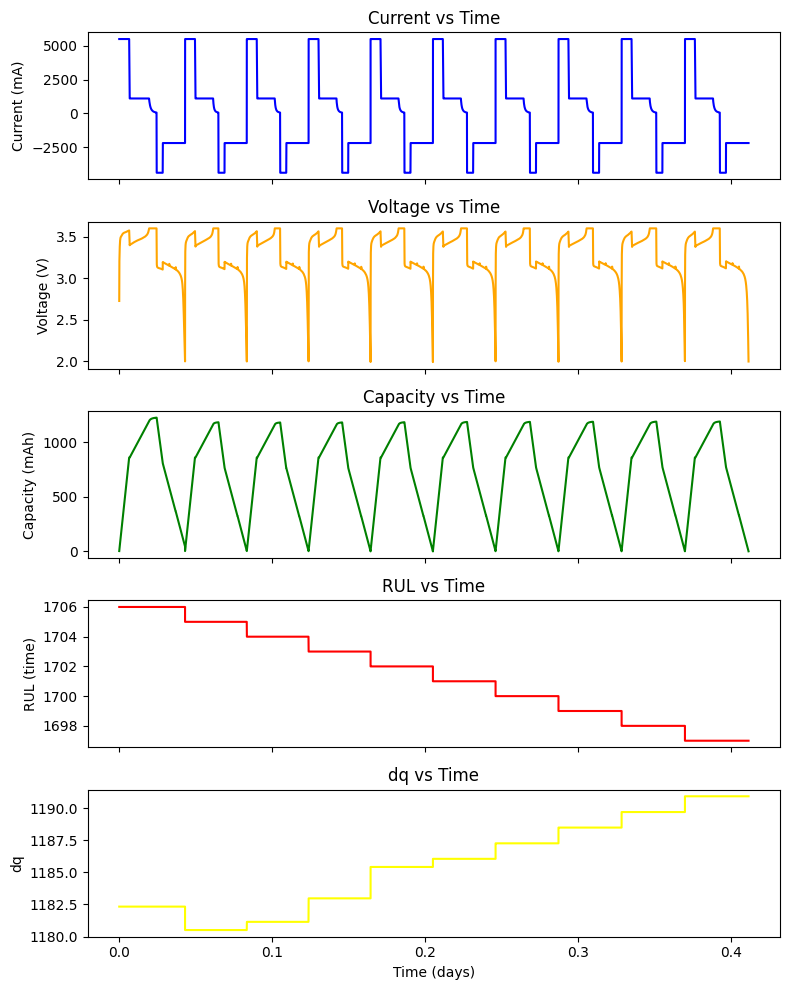

100%|██████████| 1706/1706 [01:34<00:00, 18.03it/s]


7-1


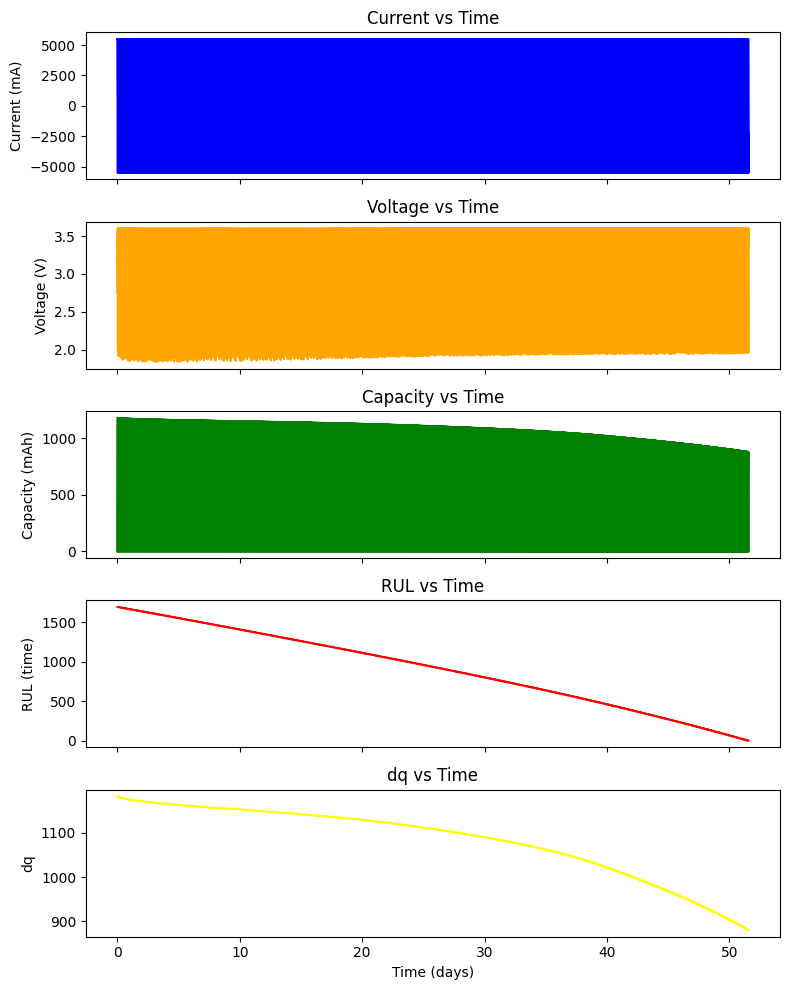

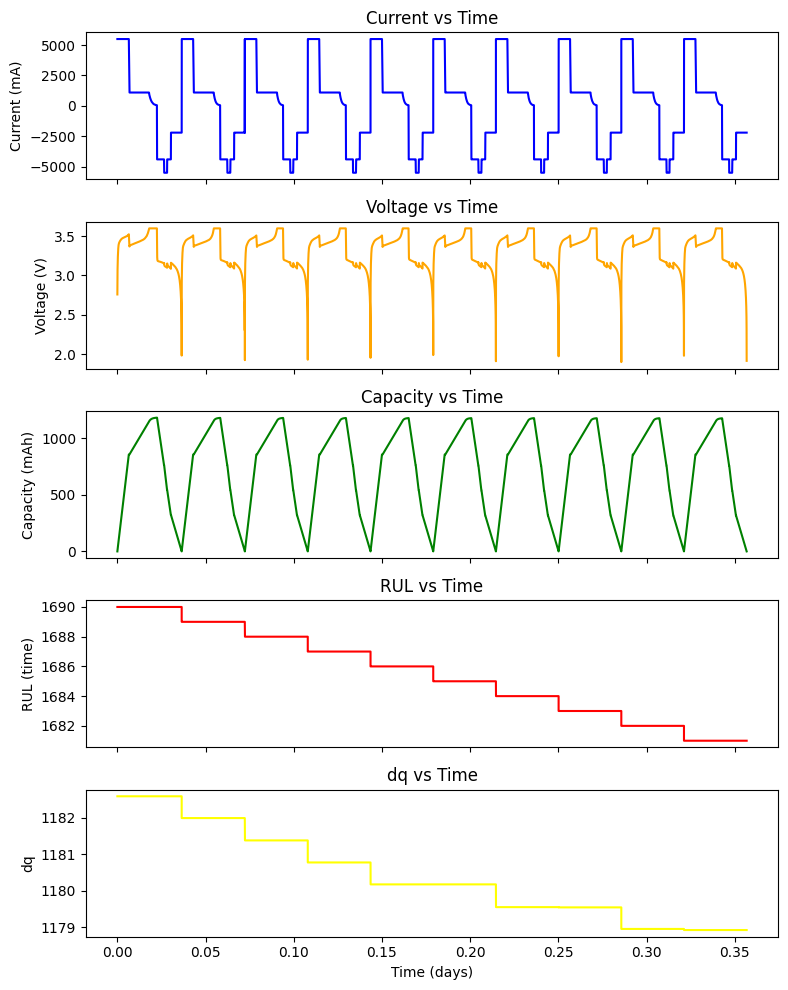

100%|██████████| 1690/1690 [01:21<00:00, 20.76it/s]


10-1


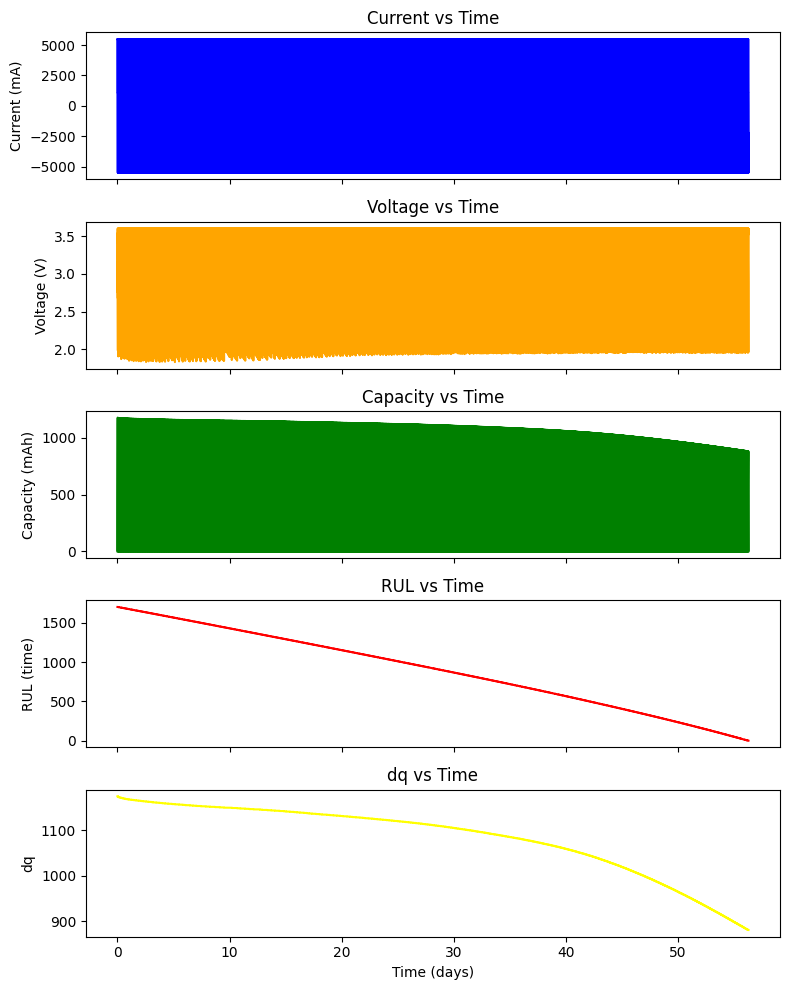

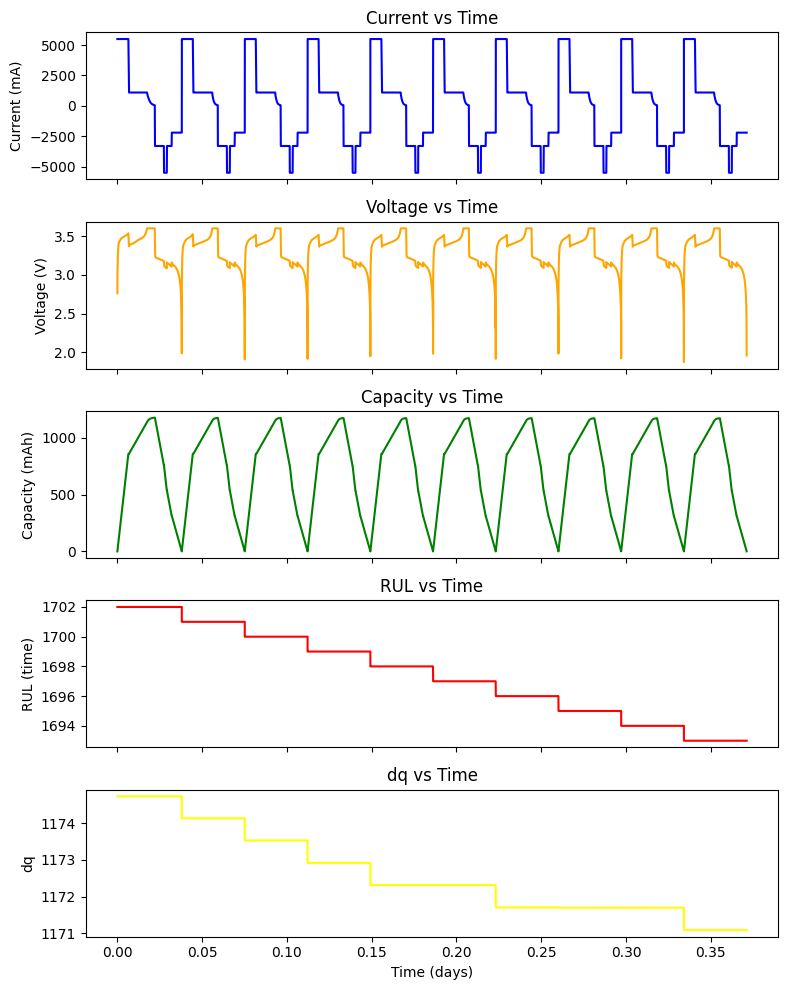

100%|██████████| 1702/1702 [01:30<00:00, 18.87it/s]


5-7


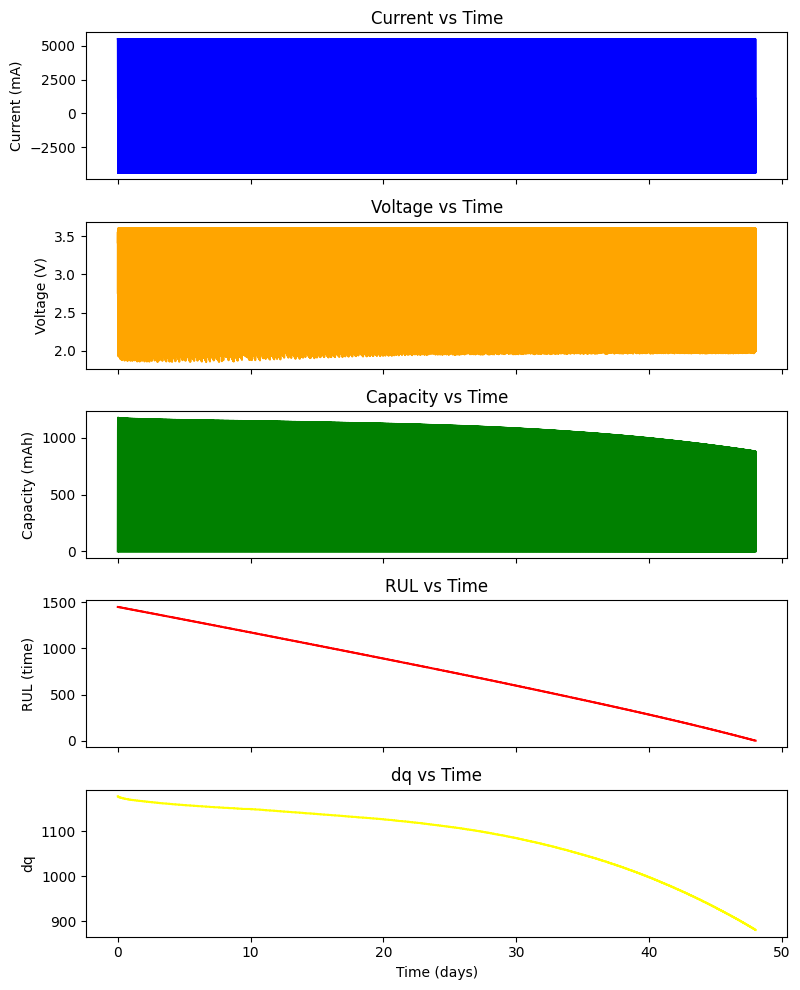

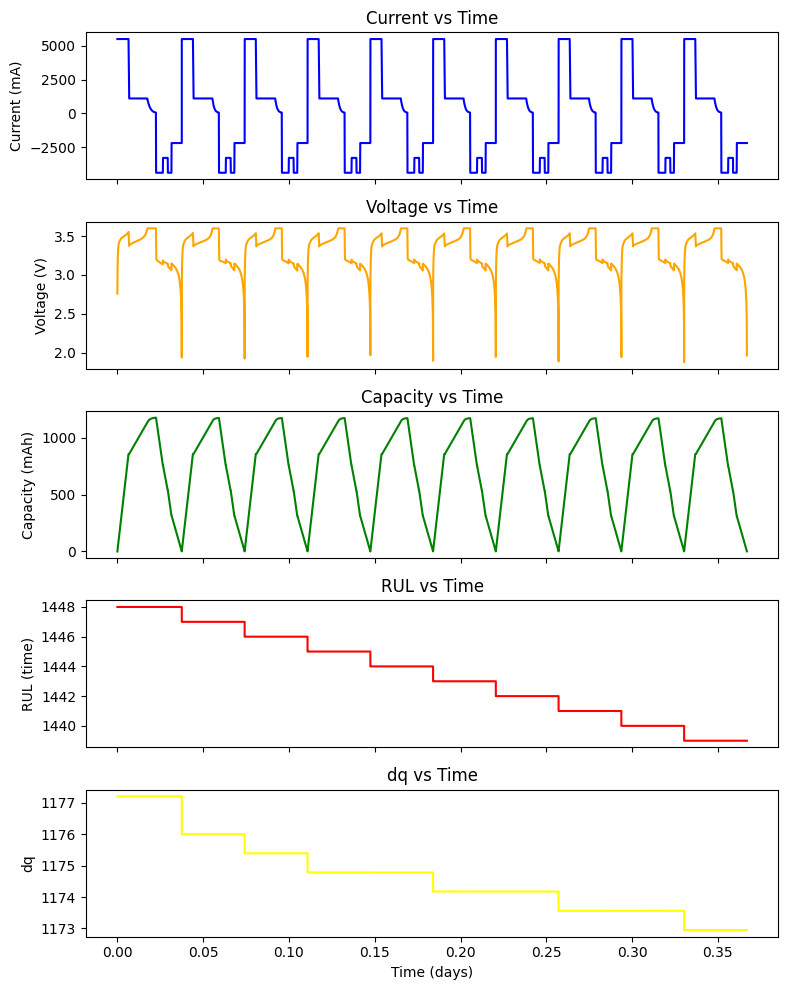

100%|██████████| 1448/1448 [01:13<00:00, 19.70it/s]


3-3


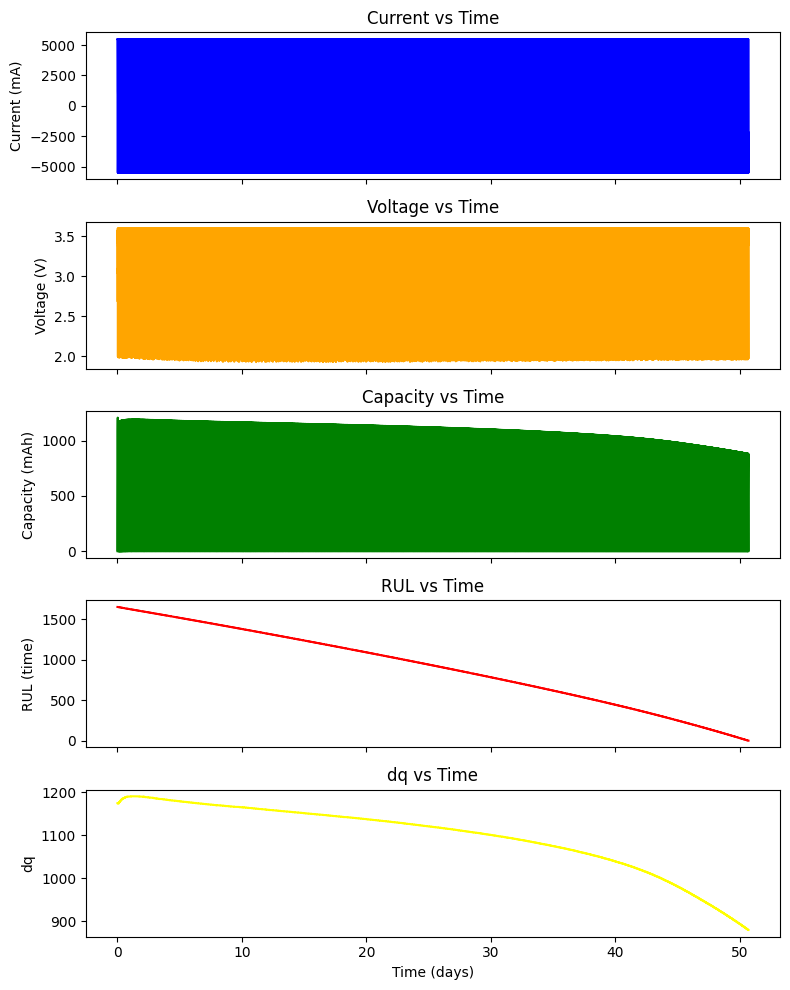

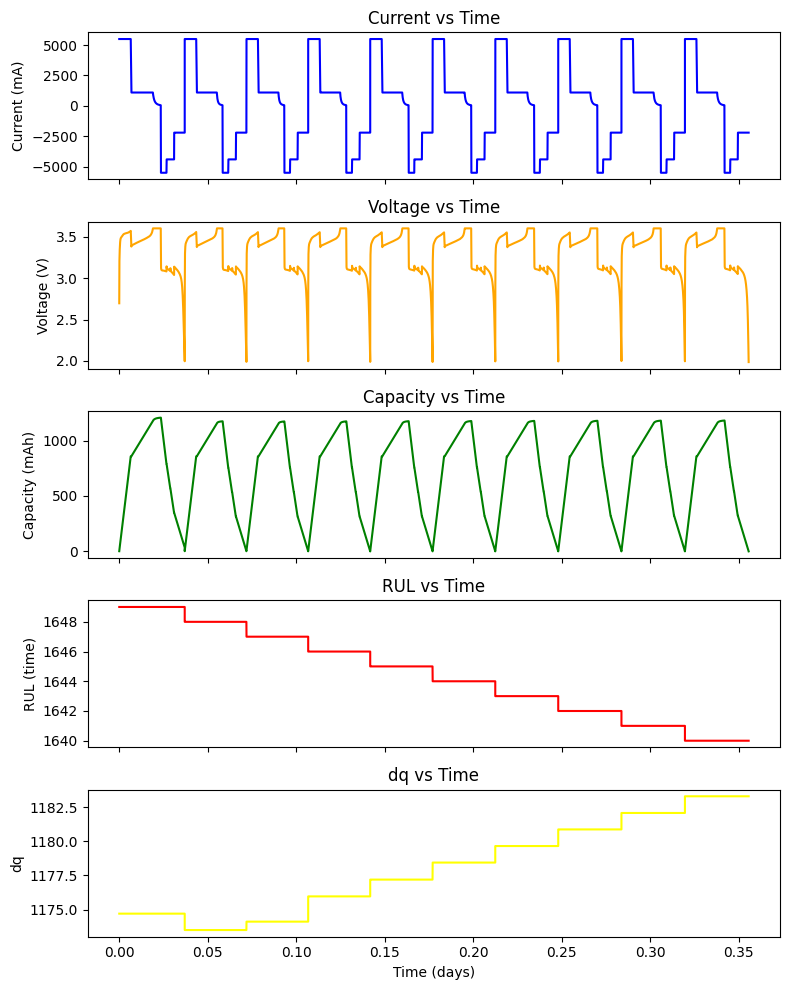

100%|██████████| 1649/1649 [01:14<00:00, 22.10it/s]


9-8


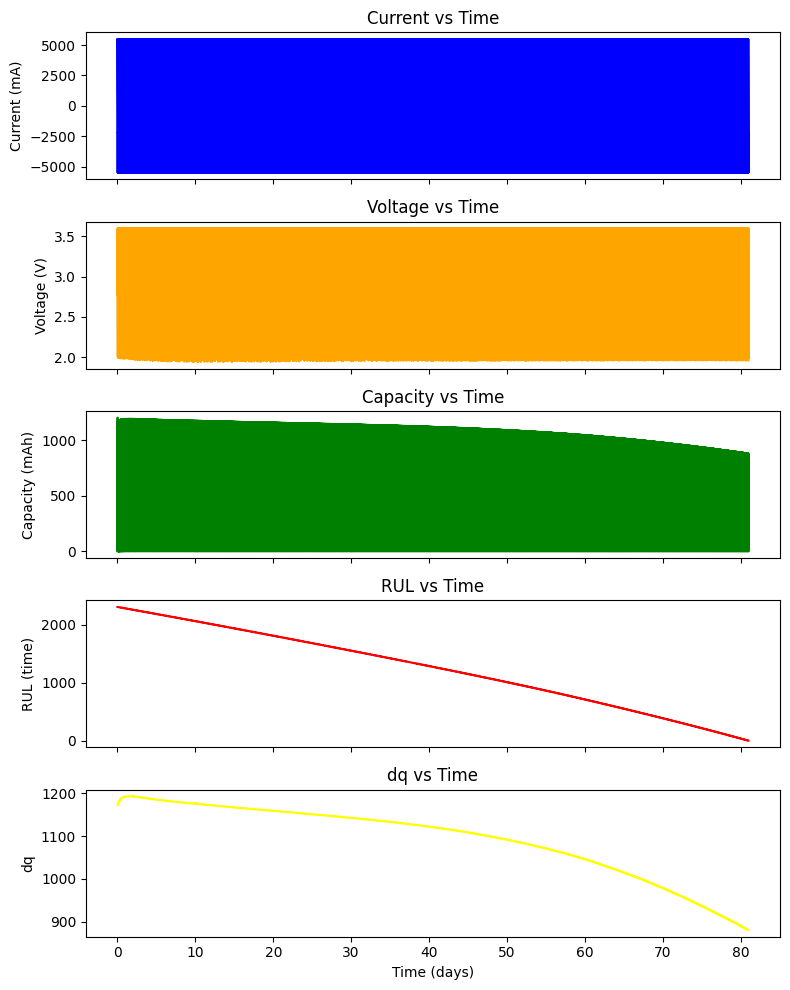

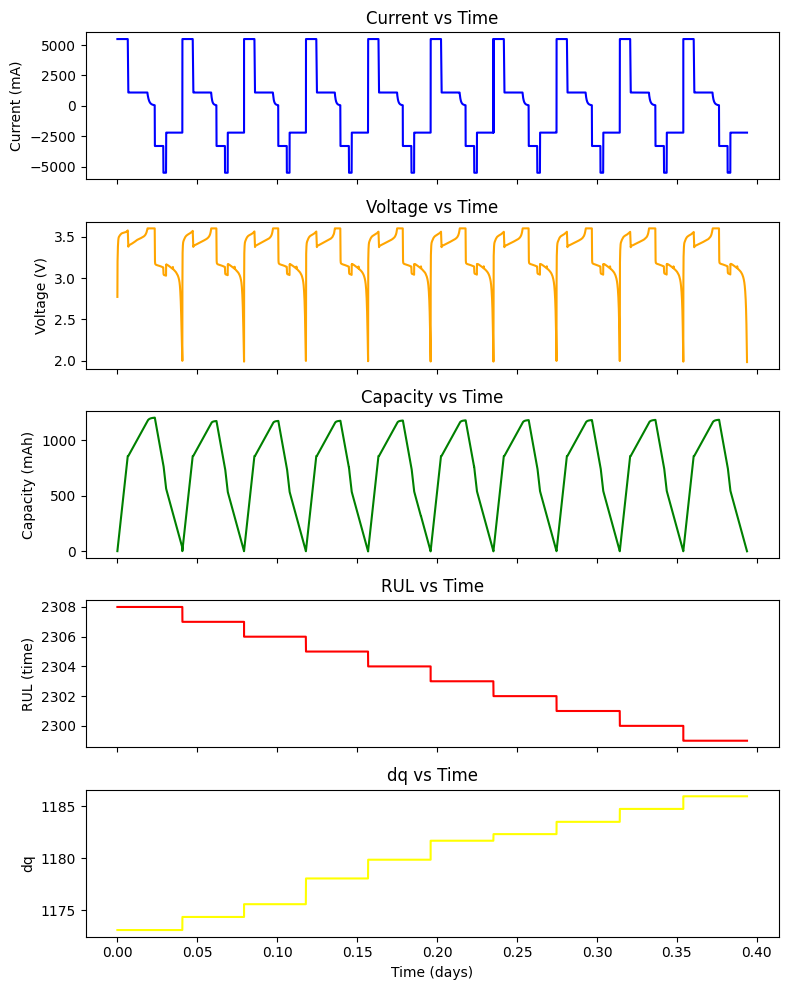

100%|██████████| 2308/2308 [02:03<00:00, 18.64it/s]


2-5


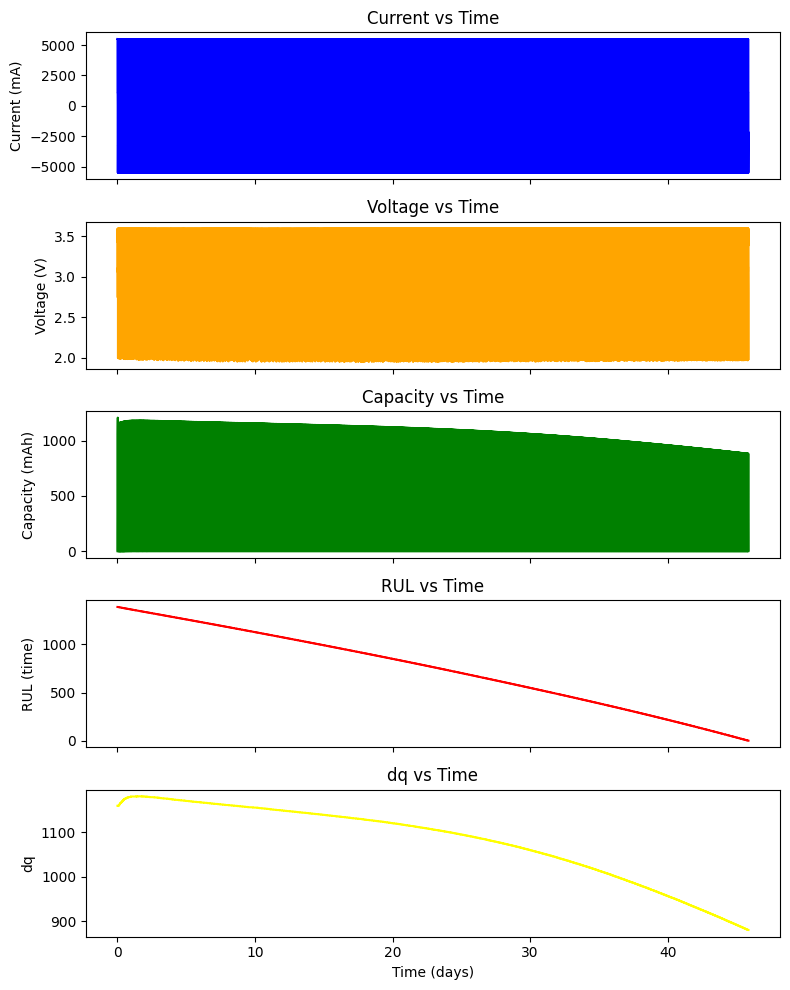

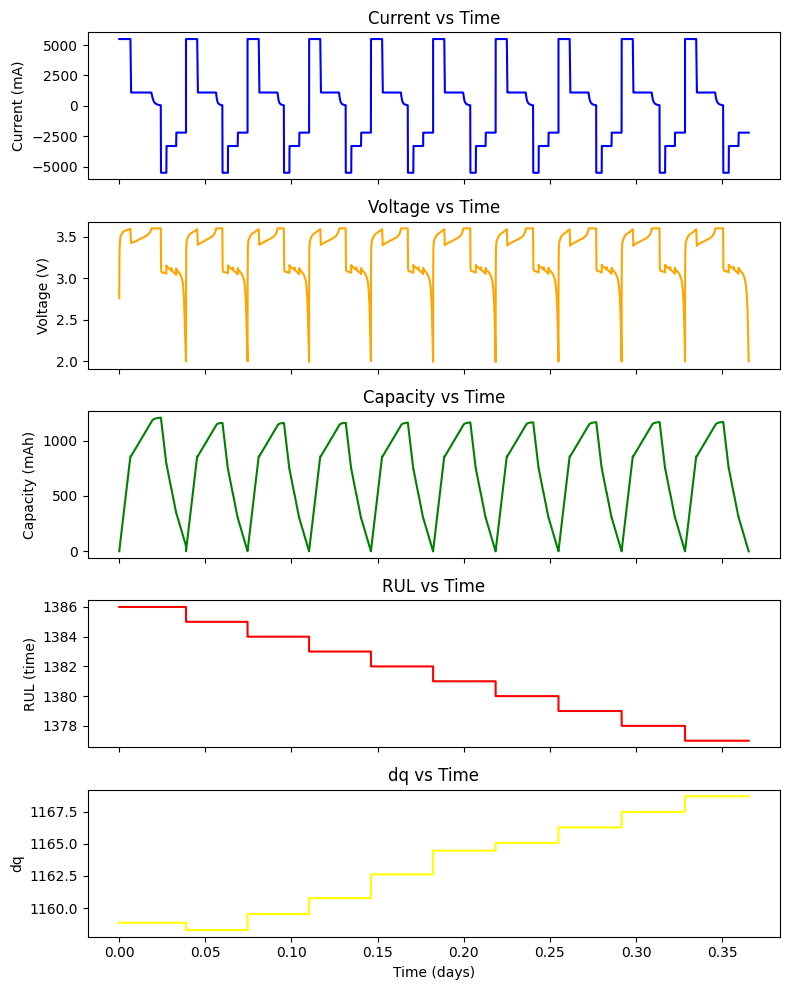

100%|██████████| 1386/1386 [01:09<00:00, 19.94it/s]


5-1


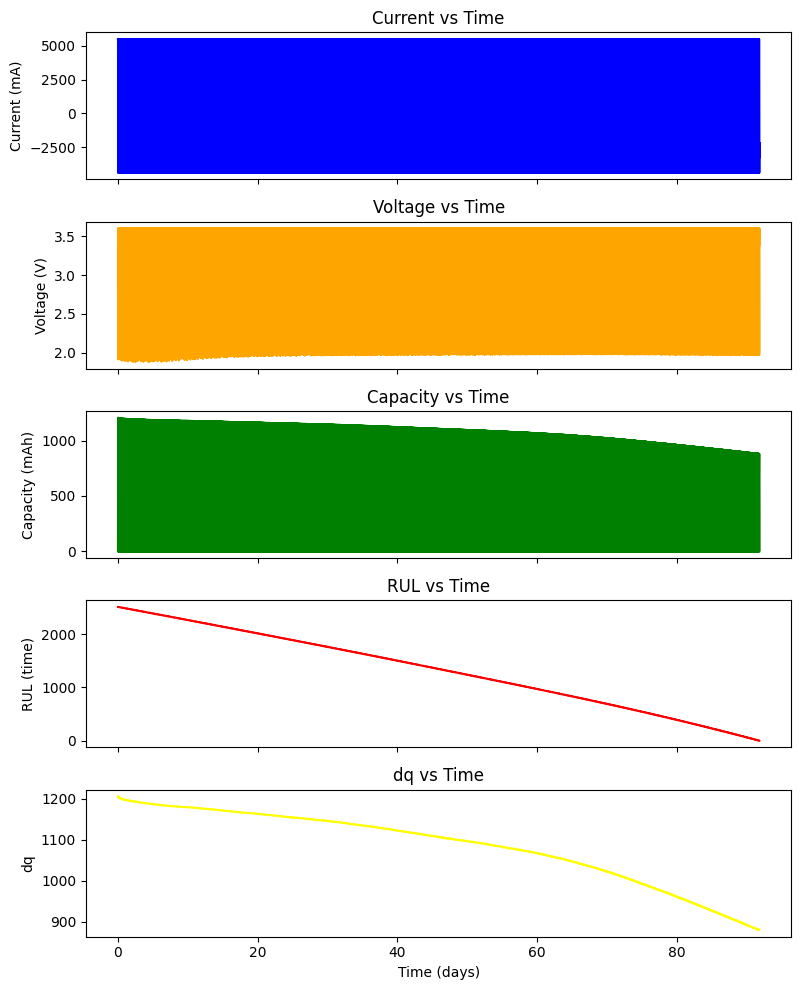

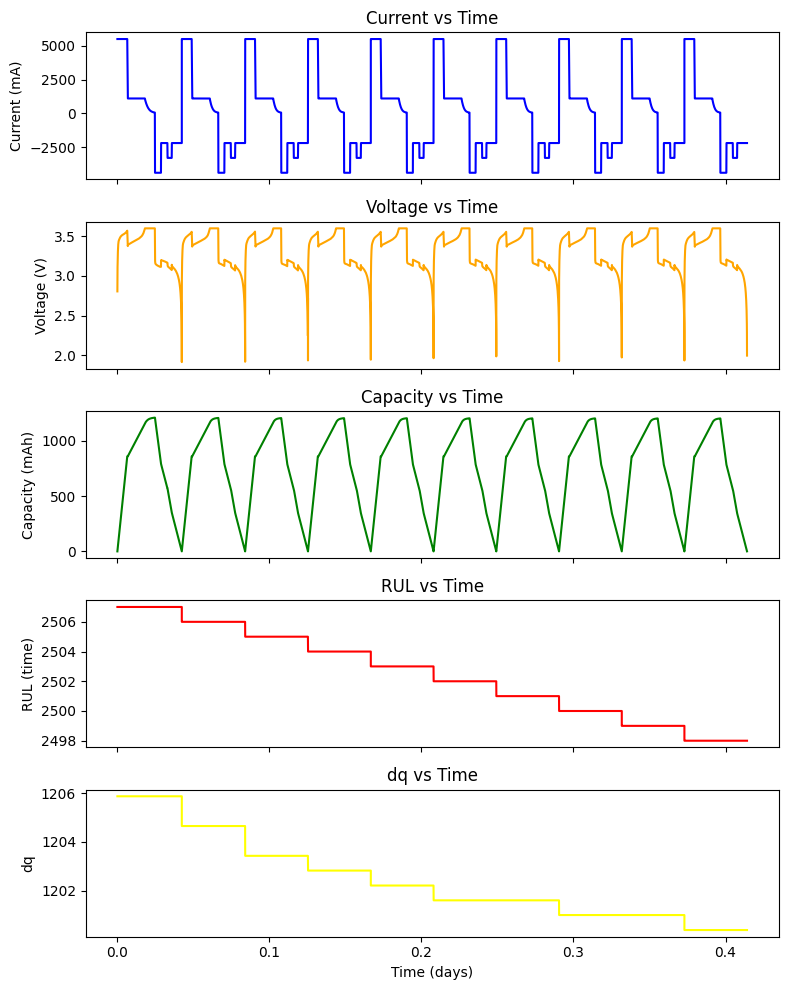

100%|██████████| 2507/2507 [02:16<00:00, 18.34it/s]


8-7


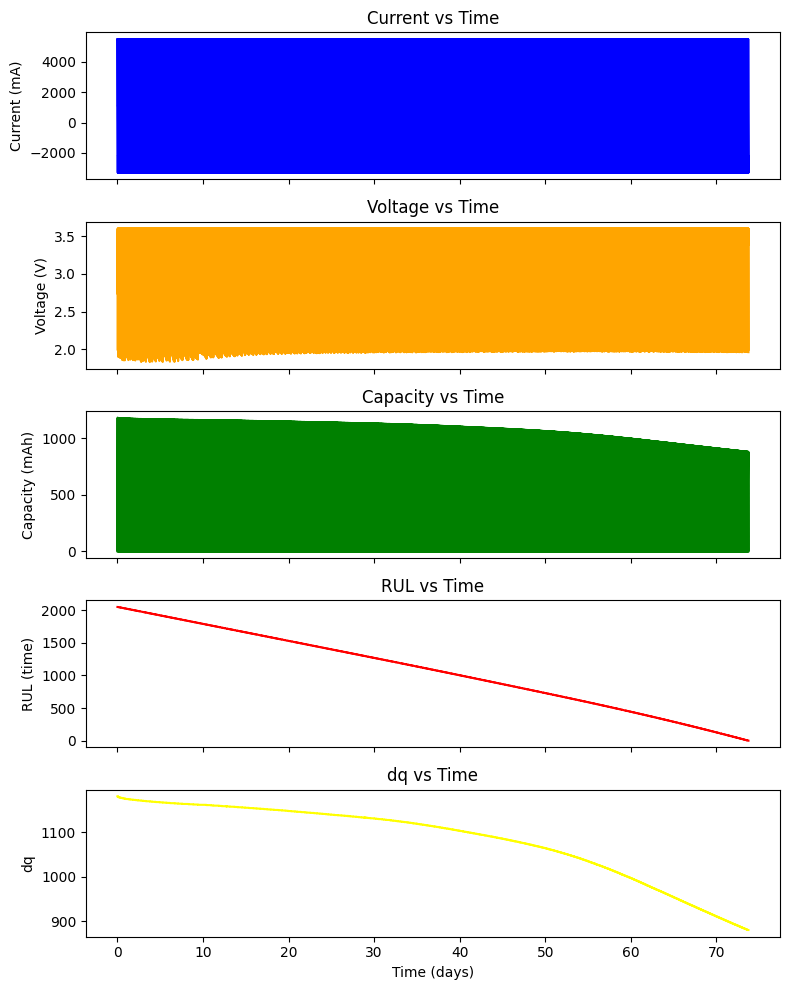

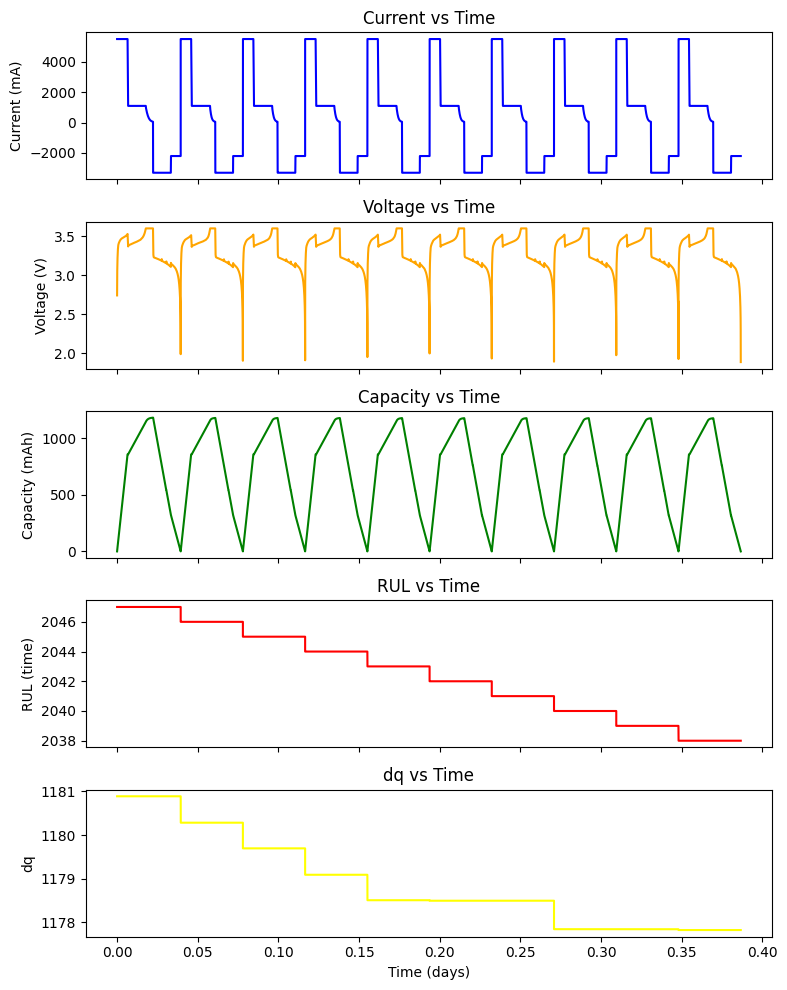

100%|██████████| 2047/2047 [01:48<00:00, 18.82it/s]


2-3


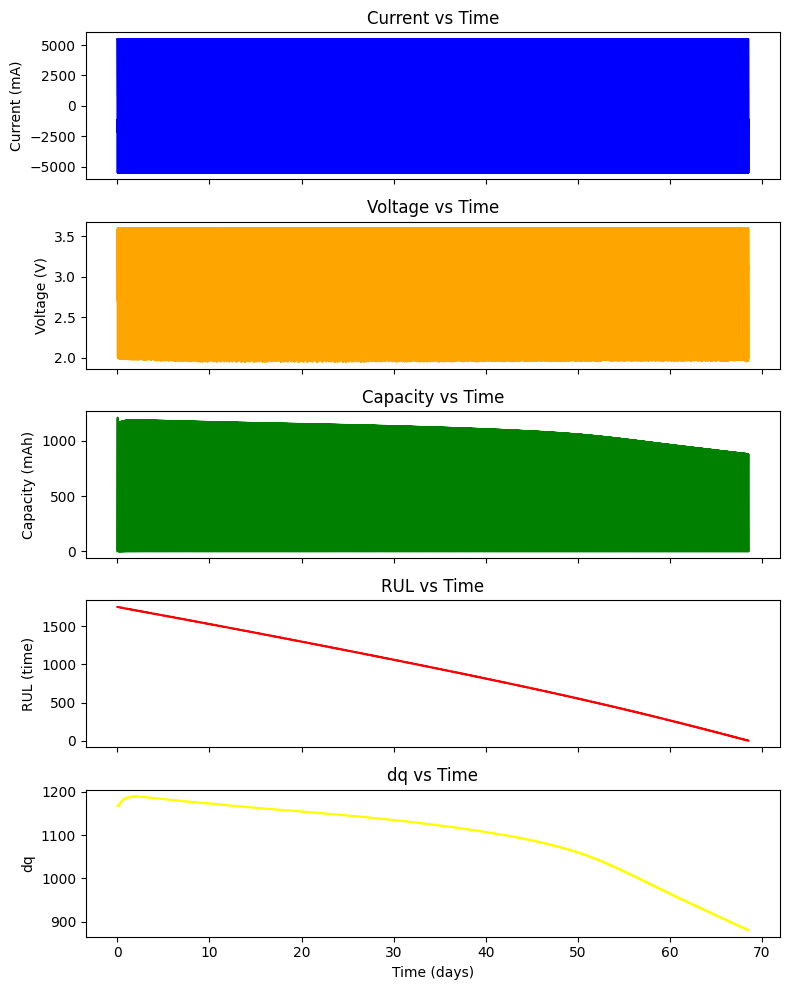

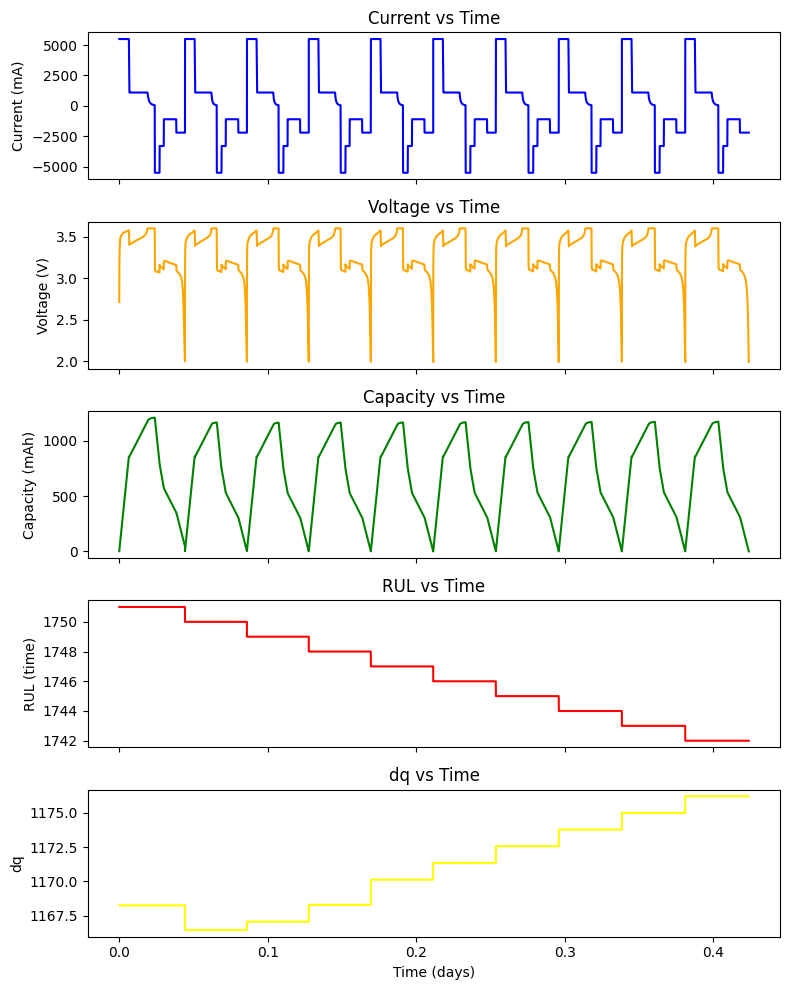

100%|██████████| 1751/1751 [01:40<00:00, 17.39it/s]


1-2


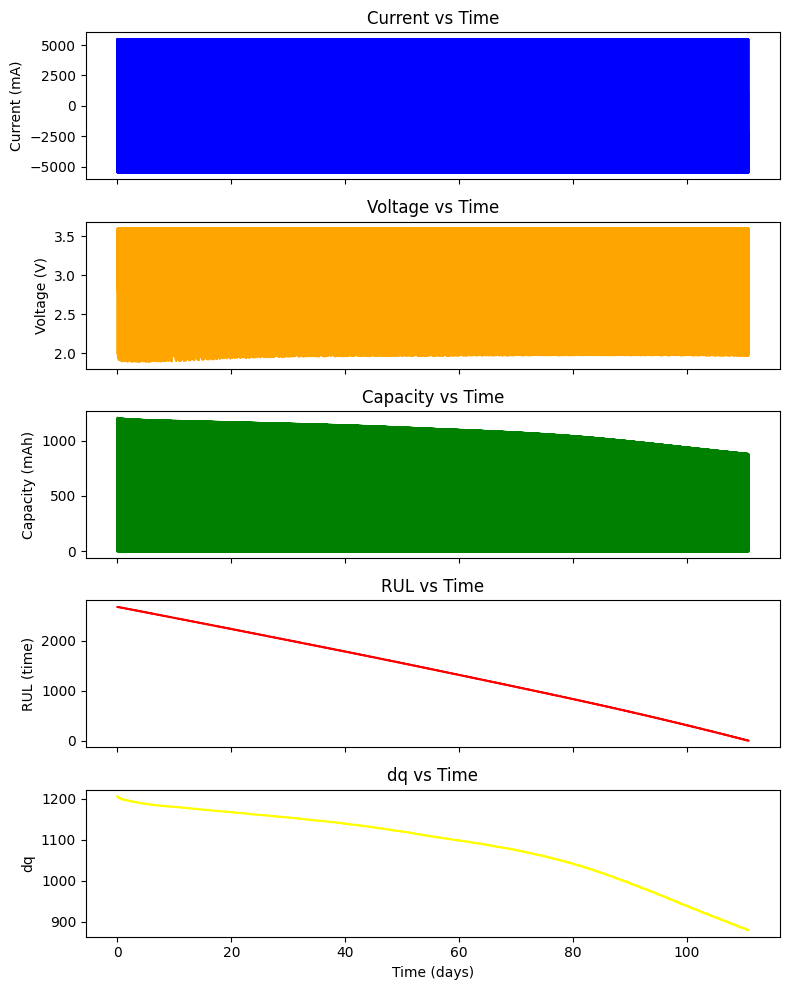

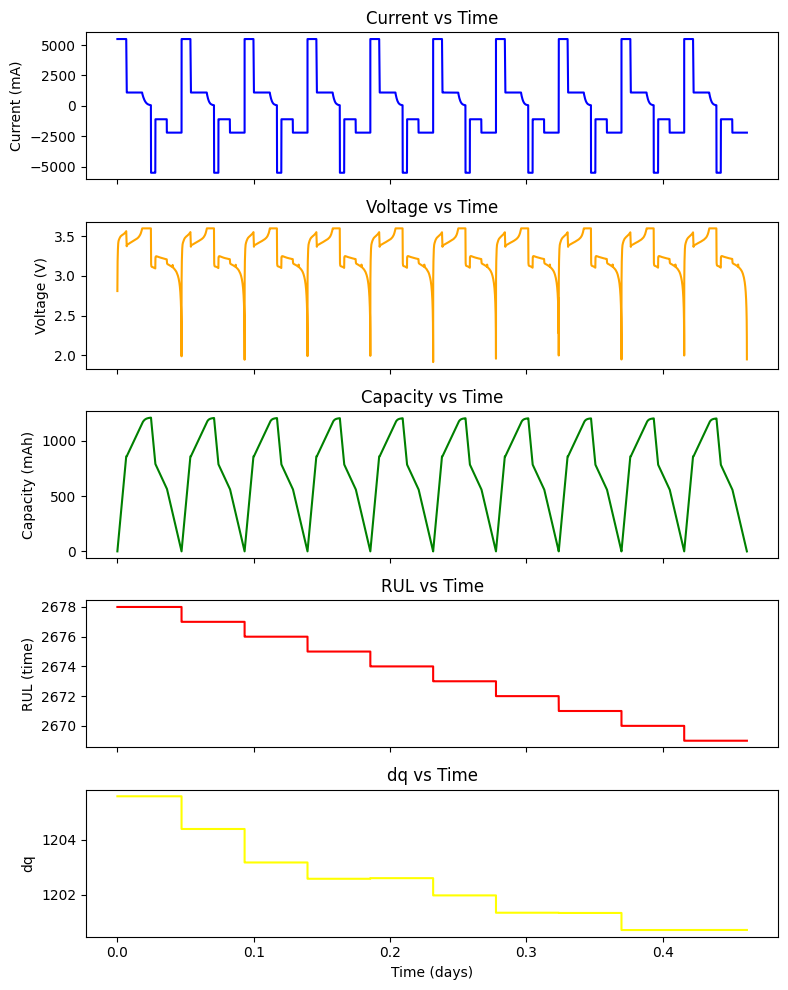

100%|██████████| 2678/2678 [02:48<00:00, 15.89it/s]


10-6


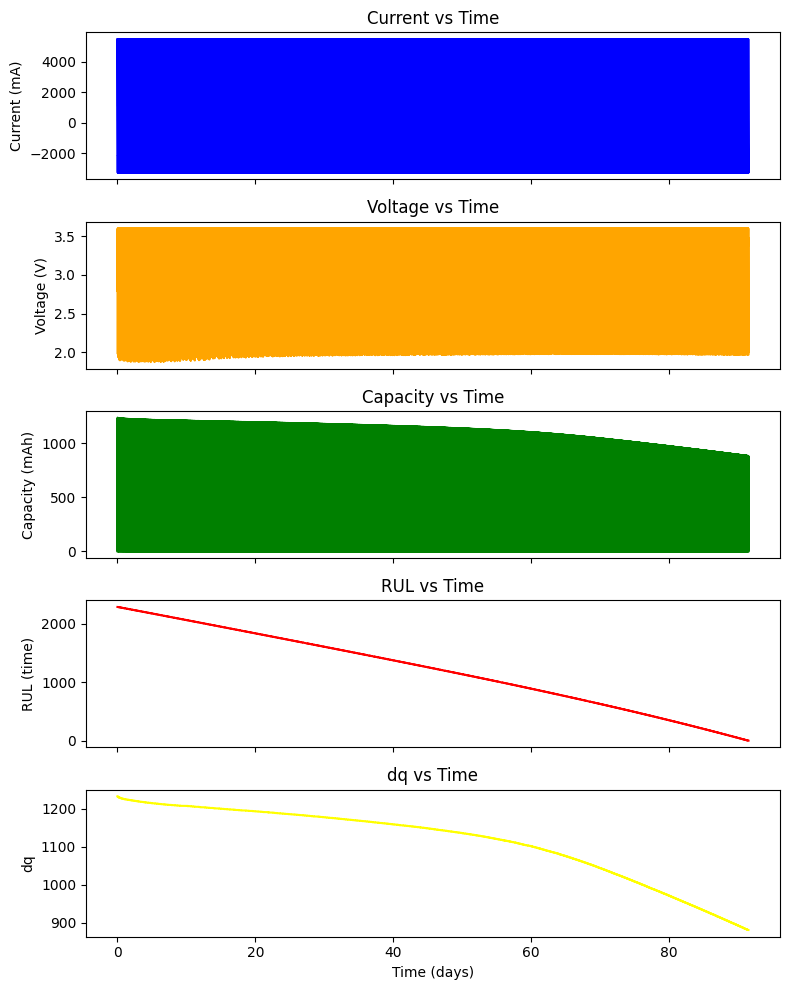

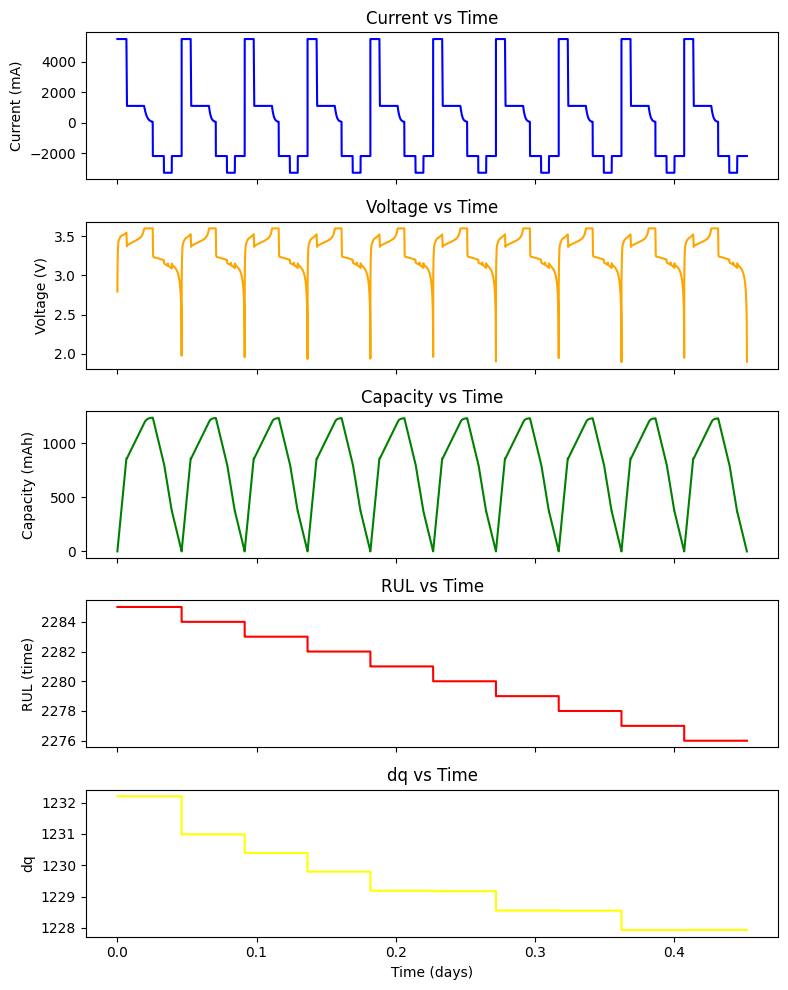

100%|██████████| 2285/2285 [02:31<00:00, 15.05it/s]


2-7


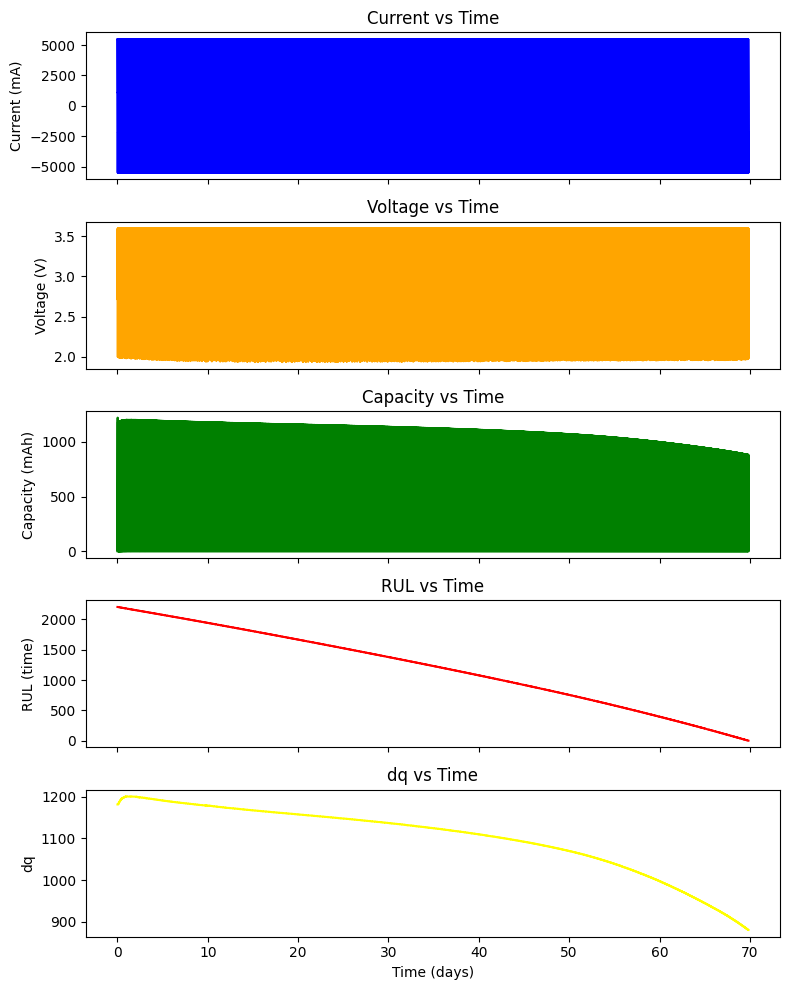

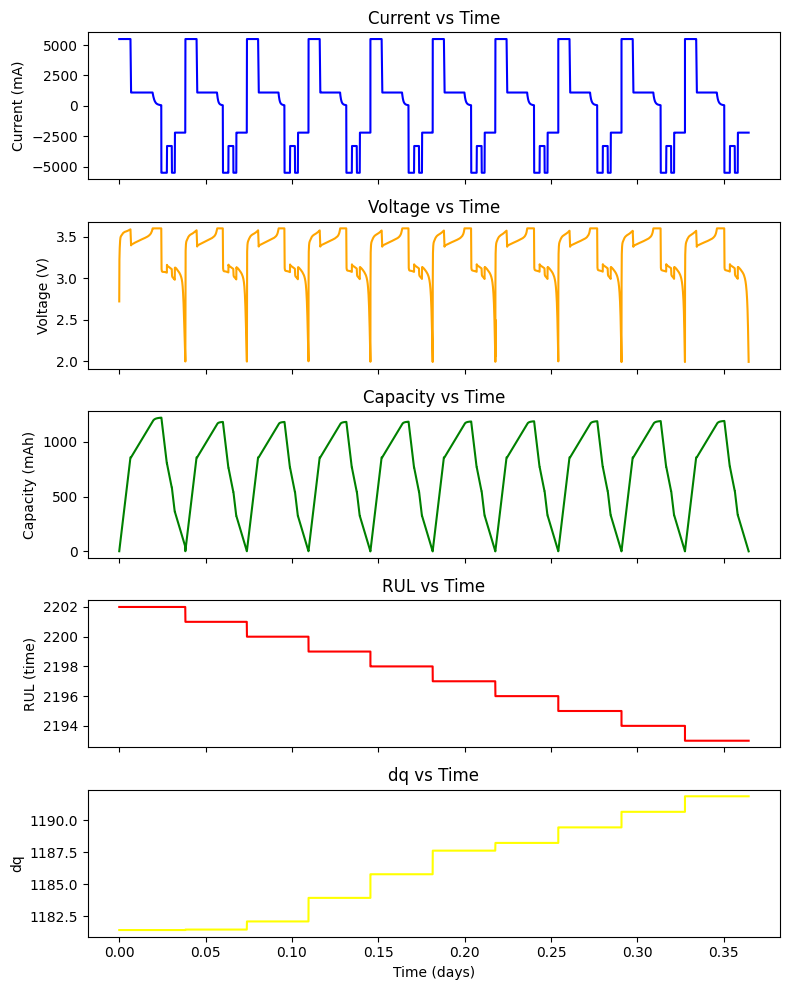

100%|██████████| 2202/2202 [01:57<00:00, 18.67it/s]


9-2


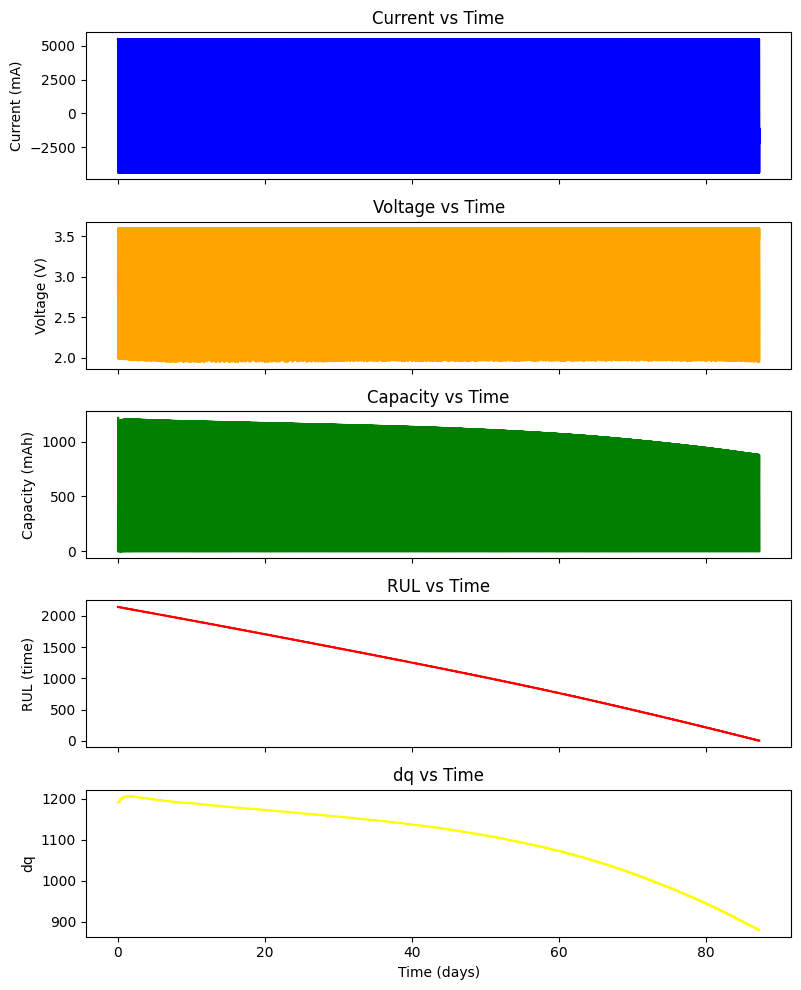

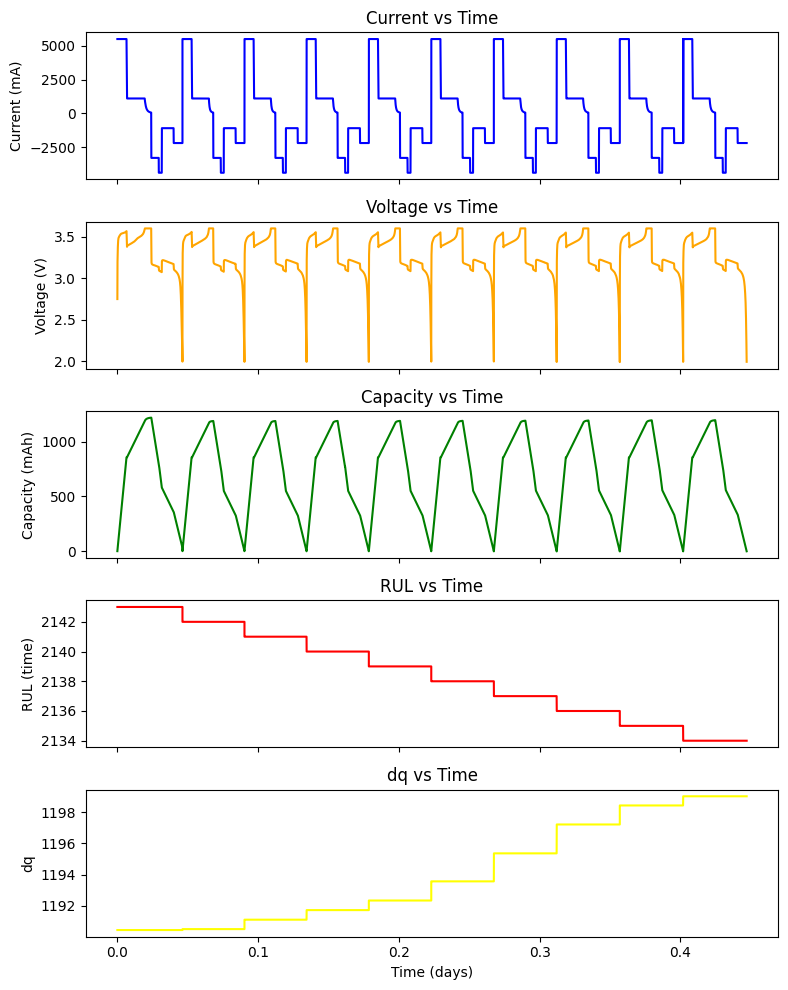

100%|██████████| 2143/2143 [02:11<00:00, 16.33it/s]


5-4


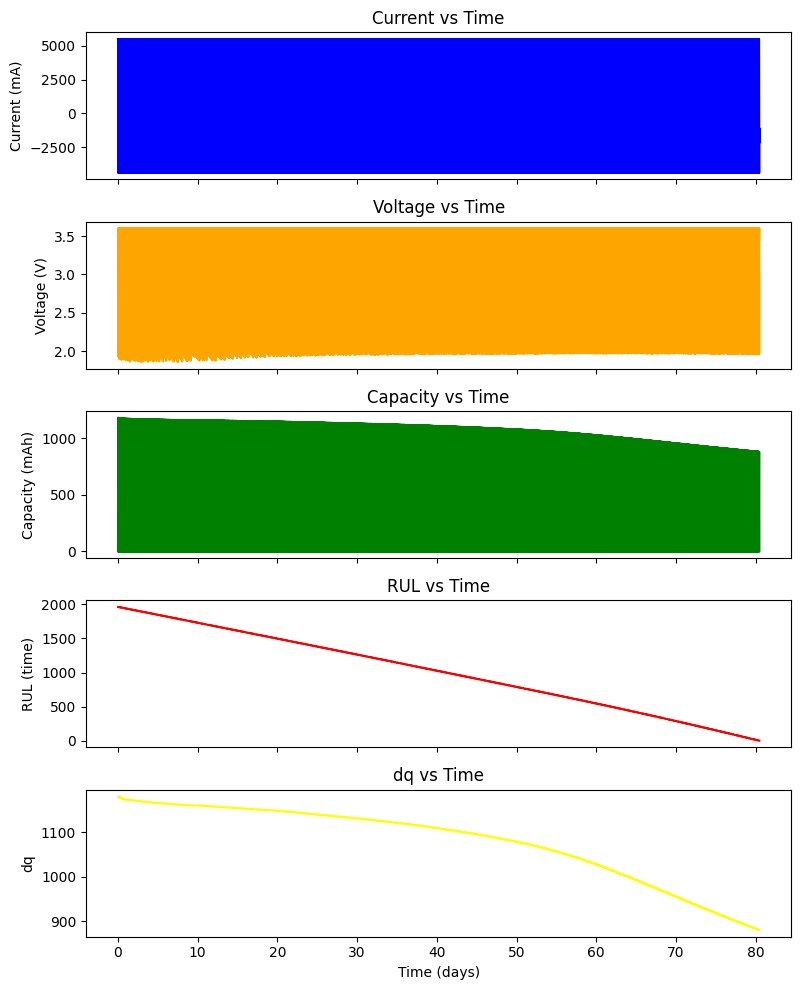

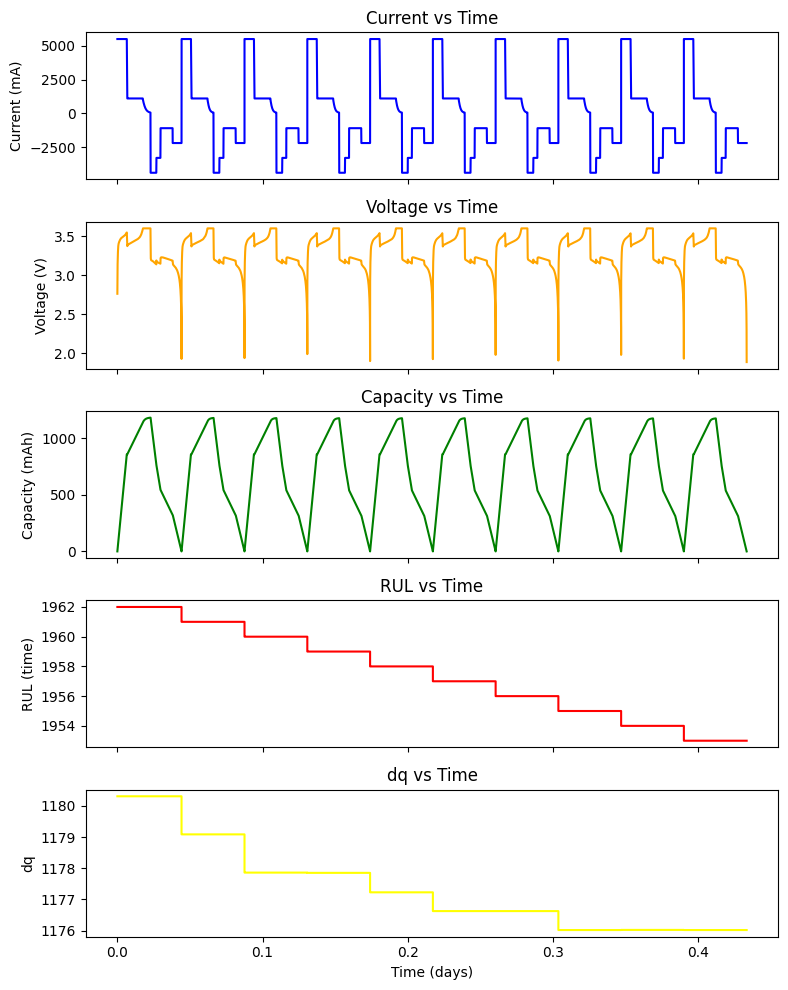

100%|██████████| 1962/1962 [01:59<00:00, 16.41it/s]


6-1


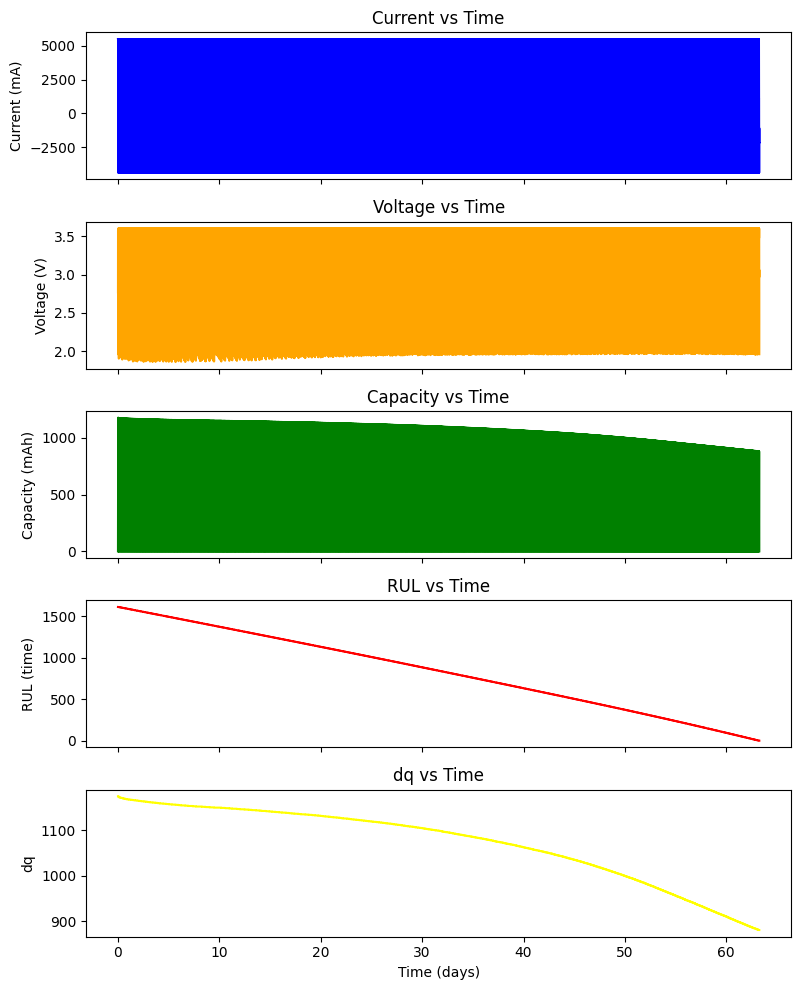

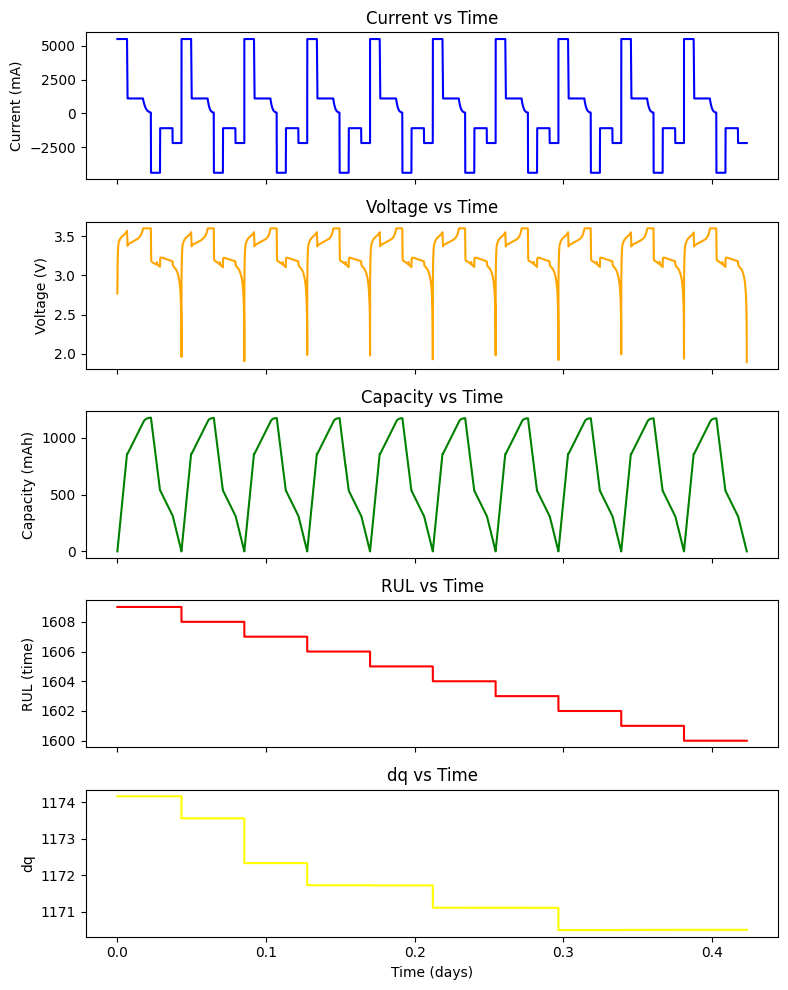

100%|██████████| 1609/1609 [01:31<00:00, 17.52it/s]


In [23]:
import pandas as pd
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# Precompute constant
C_rated = 1100.0 * 3600

    

os.makedirs('plots/',exist_ok=True)
os.makedirs('csvs/',exist_ok=True)

for cycle_regimen in filenames_without_pkl:
    #cycle_regimen = random.choice(filenames_without_pkl)#'10-1'
    unpickled_df = pd.read_pickle(f'{base_path}/{cycle_regimen}.pkl')#,engine='pyarrow',dtype_backend='pyarrow')
    print(cycle_regimen)
    df = pd.DataFrame(unpickled_df[cycle_regimen])#,engine='pyarrow',dtype_backend='pyarrow')
    rul = unpickled_df[cycle_regimen]['rul']
    dq = unpickled_df[cycle_regimen]['dq']
    data = unpickled_df[cycle_regimen]['data']
    ### Faster Code ########

    # Prepare a list to store all DataFrames, so we only concatenate at the end
    df_list = []

    # Initialize the previous_last_time for cumulative time calculation
    previous_last_time = 0

    # Iterate over the data dictionary
    for cycle_number, cycle_data in data.items():
        df_data = pd.DataFrame(cycle_data)

        # Calculate cumulative time
        df_data['Time (s) cumu'] = df_data['Time (s)'] + previous_last_time

        # Add 'rul' and 'dq' columns directly without creating lists
        df_data['rul'] = rul[cycle_number]
        df_data['dq'] = dq[cycle_number]

        # Update the previous_last_time for the next cycle
        previous_last_time = df_data['Time (s) cumu'].iloc[-1]

        # Store the DataFrame in the list
        df_list.append(df_data)

    # Concatenate all DataFrames at once
    merge_df = pd.concat(df_list, ignore_index=True)

    # Sort only once if needed
    merge_df = merge_df.sort_values(by='Time (s) cumu', ascending=True).reset_index(drop=True)


    df = merge_df#.copy()

    import matplotlib.pyplot as plt

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(5, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu']/86400, df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu']/86400, df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu']/86400, df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    #axs[2].set_xlabel('Time (s)')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu']/86400, df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    #axs[3].set_xlabel('Time (s)')

    # Plot Capacity vs Time
    axs[4].plot(df['Time (s) cumu']/86400, df['dq'], color='yellow')
    axs[4].set_ylabel('dq')
    axs[4].set_title('dq vs Time')
    axs[4].set_xlabel('Time (days)')

    # Add some spacing between plots
    plt.tight_layout()

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-full-plot.png', dpi=300)
    # Display the plots
    plt.show()


    df = merge_df#.copy()
    df = df[df['Cycle number']<11]

    # Create a figure with 5 vertical subplots
    fig, axs = plt.subplots(5, 1, figsize=(8, 10), sharex=True)

    # Plot Current vs Time
    axs[0].plot(df['Time (s) cumu']/86400, df['Current (mA)'], color='blue')
    axs[0].set_ylabel('Current (mA)')
    axs[0].set_title('Current vs Time')

    # Plot Voltage vs Time
    axs[1].plot(df['Time (s) cumu']/86400, df['Voltage (V)'], color='orange')
    axs[1].set_ylabel('Voltage (V)')
    axs[1].set_title('Voltage vs Time')

    # Plot Capacity vs Time
    axs[2].plot(df['Time (s) cumu']/86400, df['Capacity (mAh)'], color='green')
    axs[2].set_ylabel('Capacity (mAh)')
    axs[2].set_title('Capacity vs Time')
    #axs[2].set_xlabel('Time (s)')

    # Plot RUL vs Time
    axs[3].plot(df['Time (s) cumu']/86400, df['rul'], color='red')
    axs[3].set_ylabel('RUL (time)')
    axs[3].set_title('RUL vs Time')
    #axs[3].set_xlabel('Time (s)')

    # Plot Capacity vs Time
    axs[4].plot(df['Time (s) cumu']/86400, df['dq'], color='yellow')
    axs[4].set_ylabel('dq')
    axs[4].set_title('dq vs Time')
    axs[4].set_xlabel('Time (days)')

    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('plots/'+cycle_regimen+'-first-10-plot.png', dpi=300)
    # Add some spacing between plots
    plt.tight_layout()

    # Display the plots
    plt.show()

    merge_df.loc[merge_df['Capacity (mAh)'] == 0, 'previous_SOC'] = 0
    
    # Temporary storage for the computed SOC values
    cc_soc_values = np.zeros(len(merge_df))
    
    # Process each group
    for _, group in tqdm(merge_df.groupby('Cycle number')):
        # Initialize variables
        soc_values = []
        initial_SOC = 0  # Assuming this starts at 0 for each group
    
        # Iterate over each row in the group
        t_end = group.iloc[0]['Time (s)']  # Set initial t_end to the first time value
    
        for i, row in group.iterrows():
            if row["previous_SOC"] == 0:
                # Reset SOC calculation at the start of a new cycle
                initial_SOC = row["previous_SOC"]
                I_bat = row['Current (mA)']
                t_start = row['Time (s)']
                t_end = t_start  # Initialize t_end for the first row
            else:
                # Use previous SOC and time values for the next row
                t_start = t_end
                t_end = row['Time (s)']
                I_bat = row['Current (mA)']
    
            # Calculate SOC
            SOC = current_integration(initial_SOC=initial_SOC, C_rated=C_rated, I_bat=I_bat, t_start=t_start, t_end=t_end)
    
            # Update the initial_SOC for the next iteration
            initial_SOC = SOC
    
            # Store the result
            soc_values.append(SOC)
    
        # Assign computed SOC values back to the original DataFrame using loc with index slicing
        cc_soc_values[group.index] = soc_values
    
    # Finally, assign all computed SOC values to the DataFrame column in a single operation
    merge_df["CC_SOC"] = cc_soc_values
    merge_df.to_csv('csvs/'+cycle_regimen+'.csv',index=False)

# store important battery data information over each cycle

100%|██████████| 2651/2651 [00:02<00:00, 1113.34it/s]


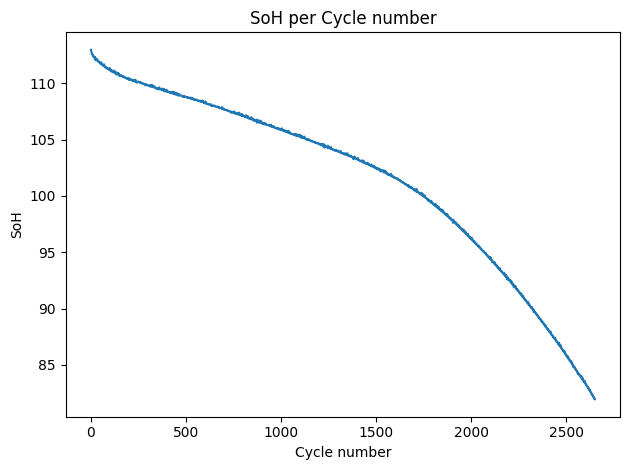

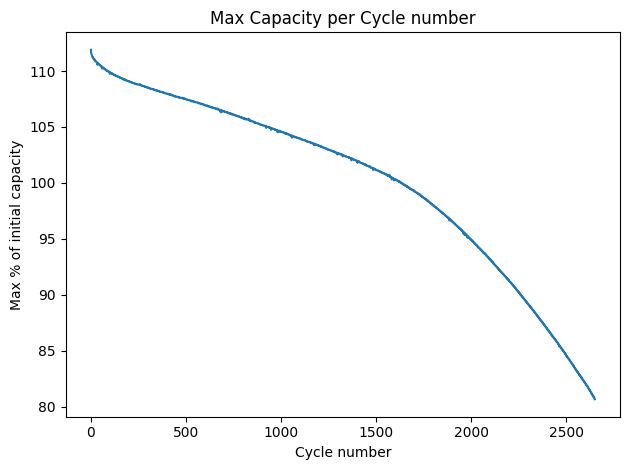

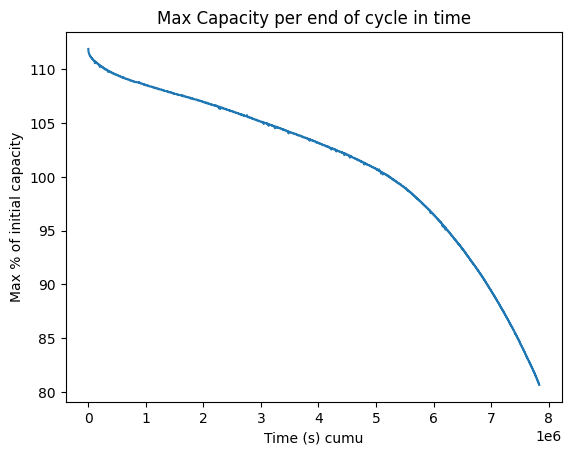

<Figure size 640x480 with 0 Axes>

100%|██████████| 1561/1561 [00:01<00:00, 1115.79it/s]


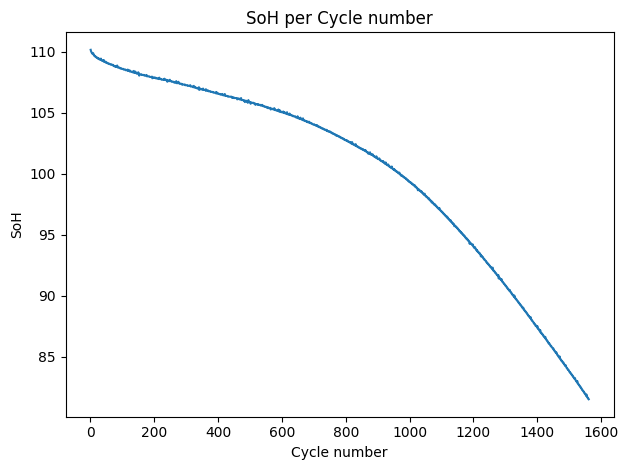

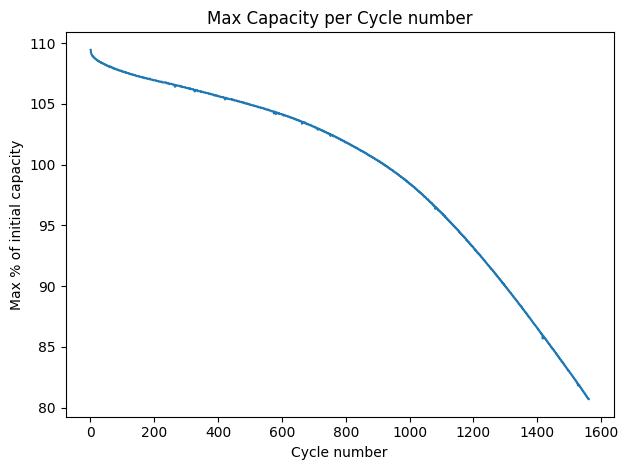

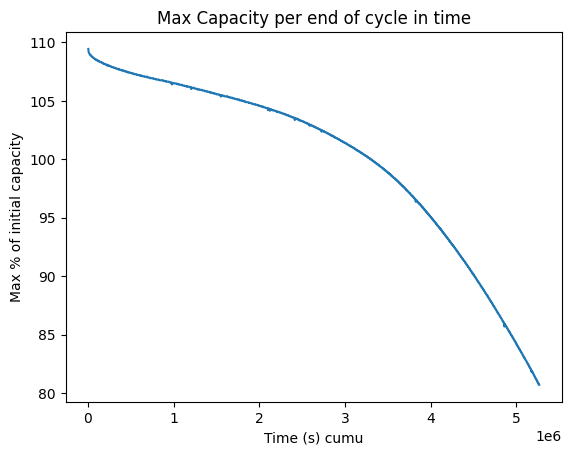

<Figure size 640x480 with 0 Axes>

100%|██████████| 1690/1690 [00:01<00:00, 1112.86it/s]


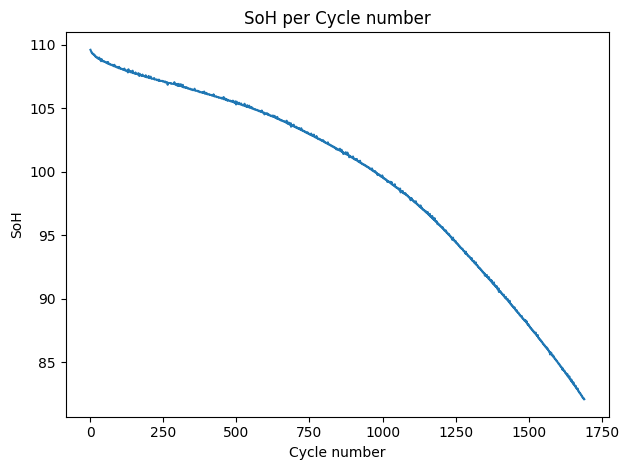

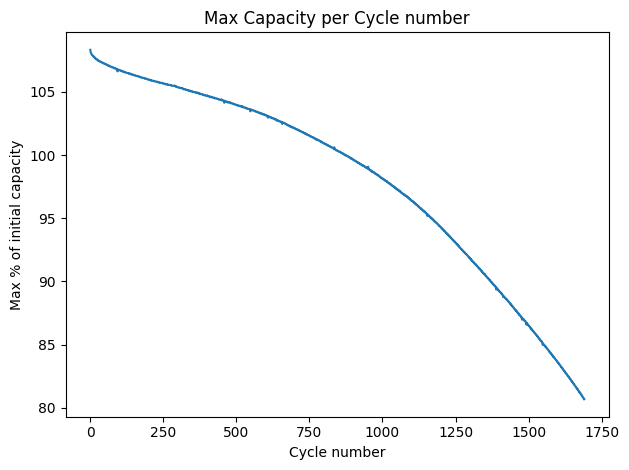

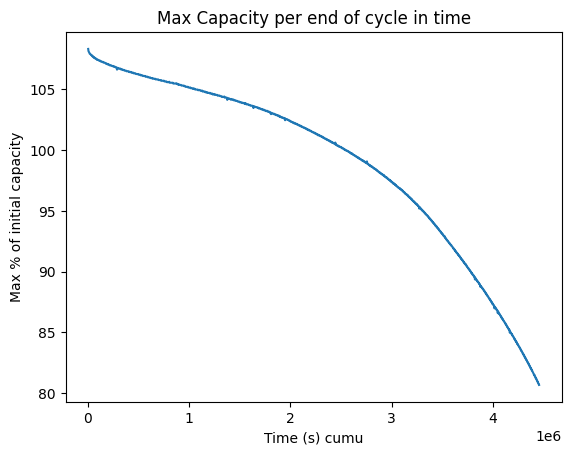

<Figure size 640x480 with 0 Axes>

100%|██████████| 1393/1393 [00:01<00:00, 1091.89it/s]


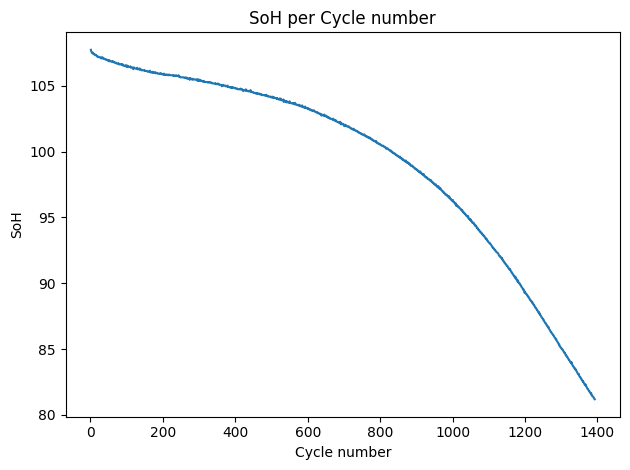

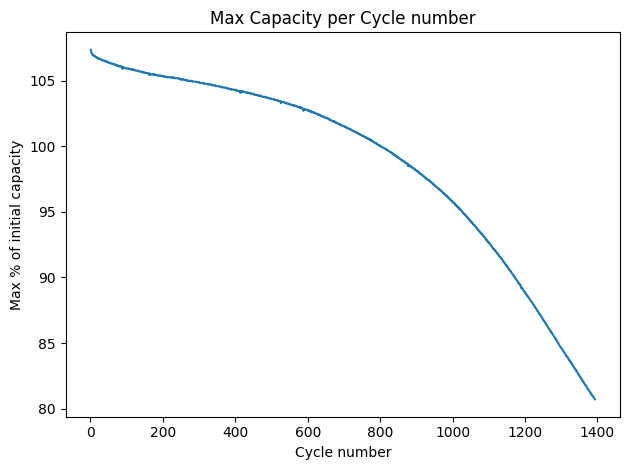

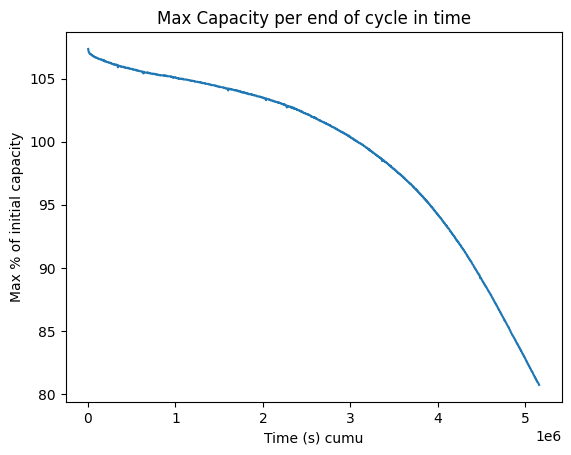

<Figure size 640x480 with 0 Axes>

100%|██████████| 1499/1499 [00:01<00:00, 1122.46it/s]


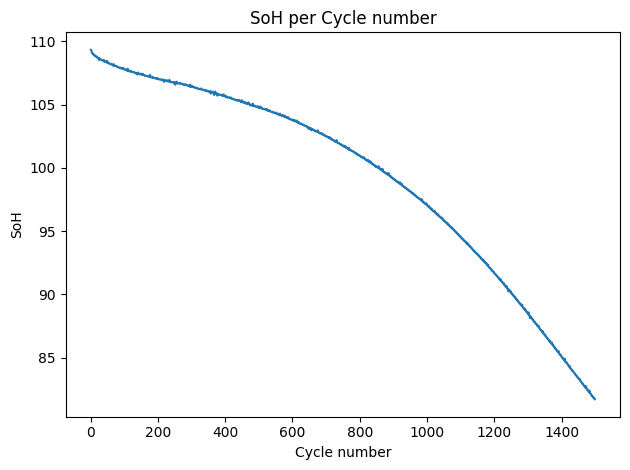

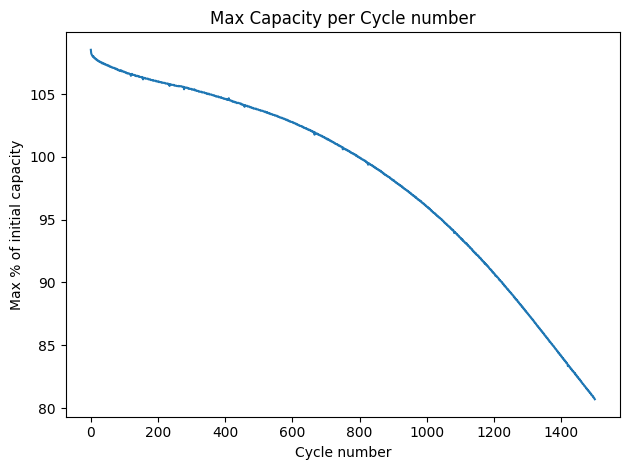

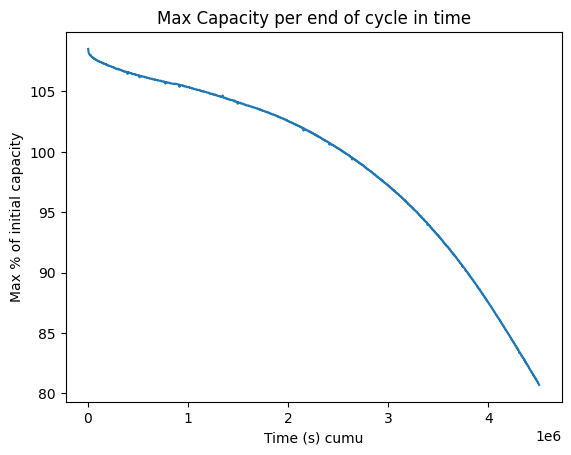

<Figure size 640x480 with 0 Axes>

100%|██████████| 1386/1386 [00:01<00:00, 1125.10it/s]


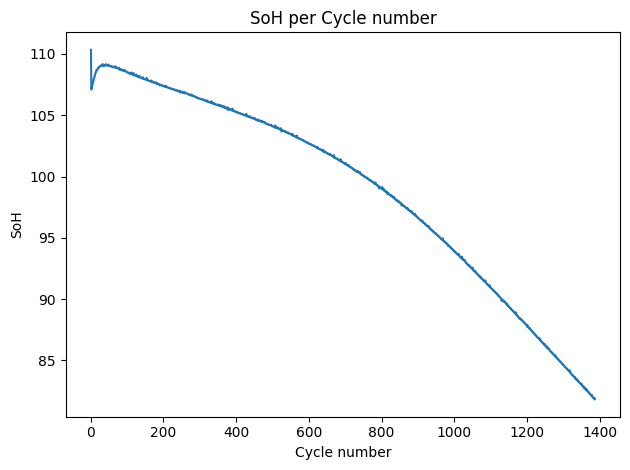

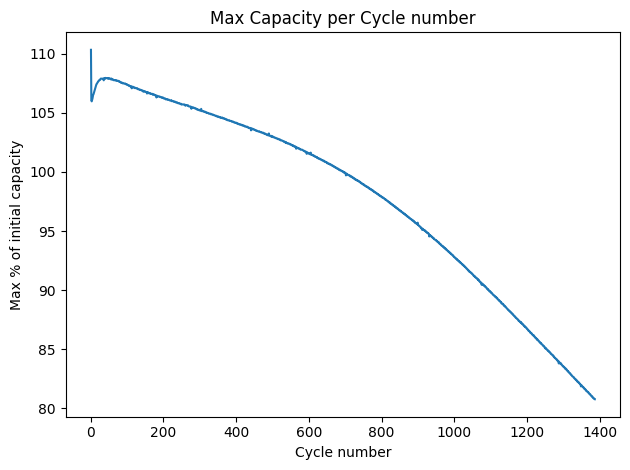

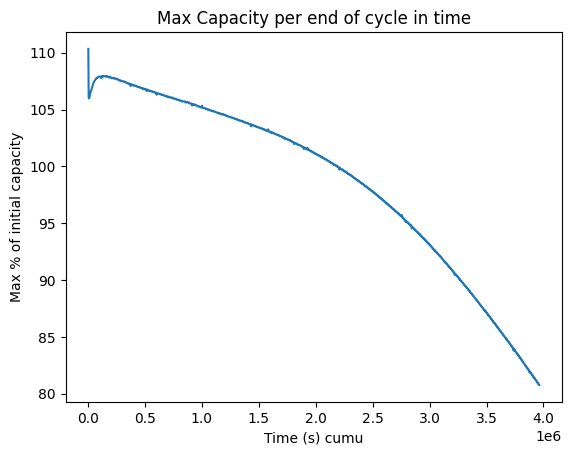

<Figure size 640x480 with 0 Axes>

100%|██████████| 1926/1926 [00:01<00:00, 1147.45it/s]


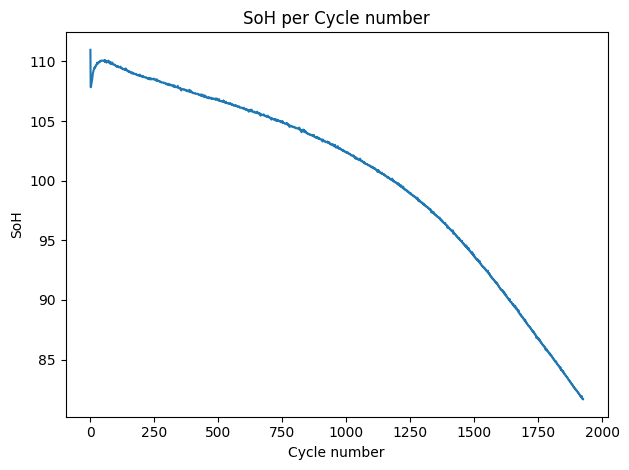

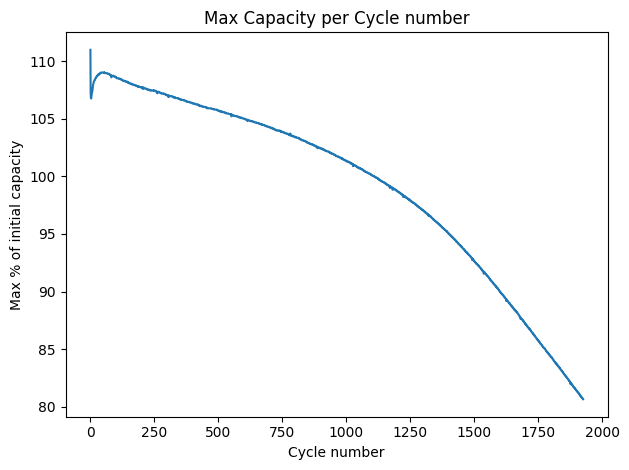

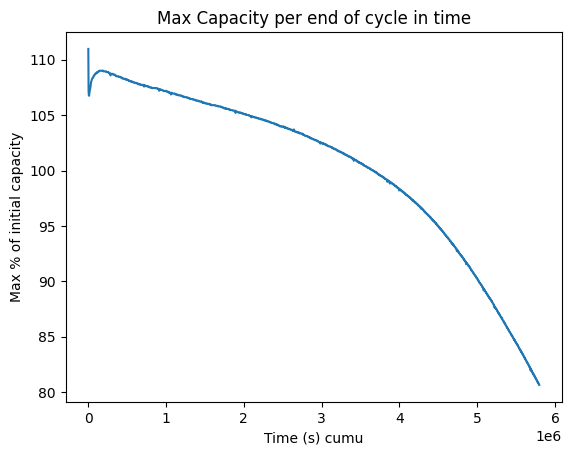

<Figure size 640x480 with 0 Axes>

100%|██████████| 1649/1649 [00:01<00:00, 1152.45it/s]


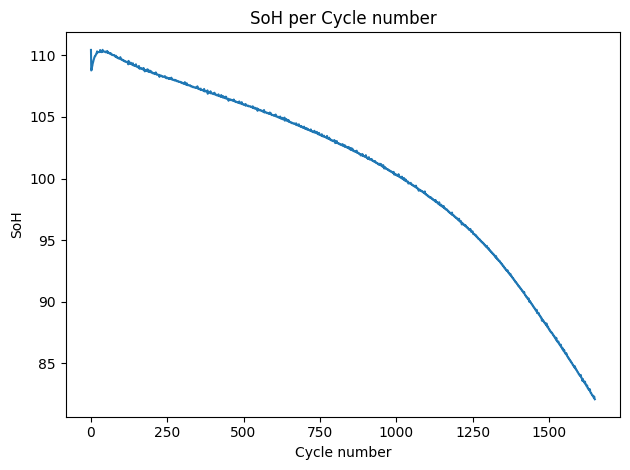

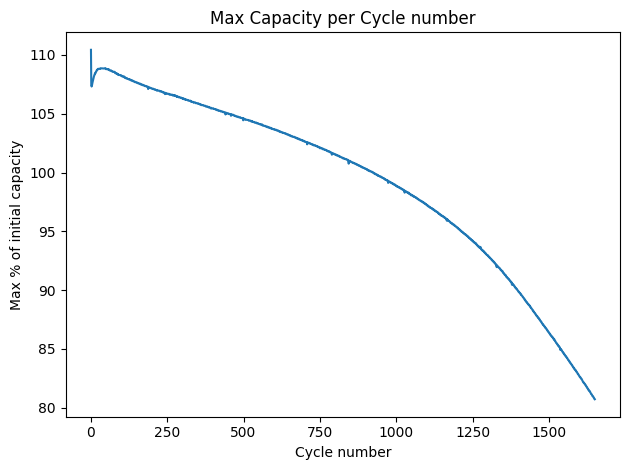

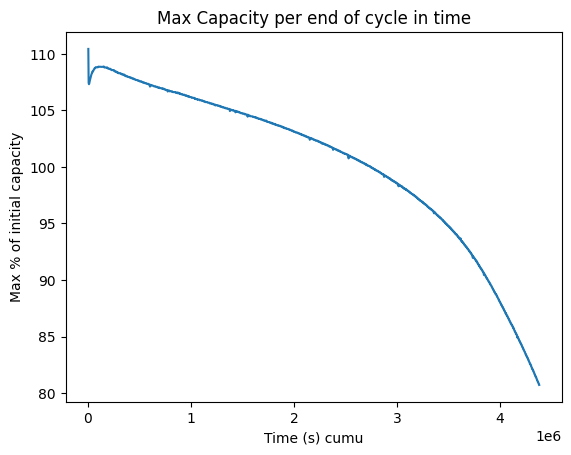

<Figure size 640x480 with 0 Axes>

100%|██████████| 1448/1448 [00:01<00:00, 1147.11it/s]


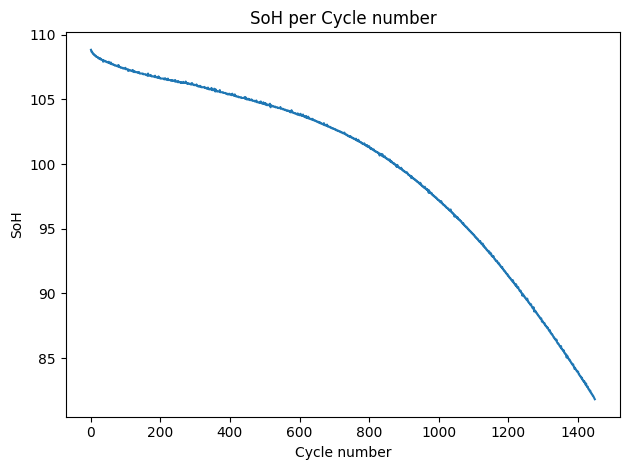

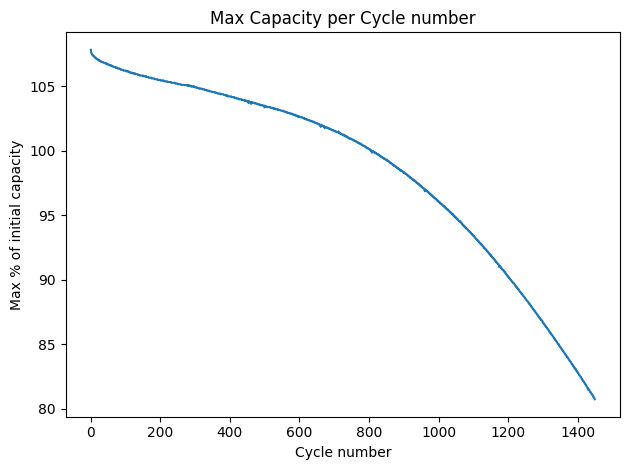

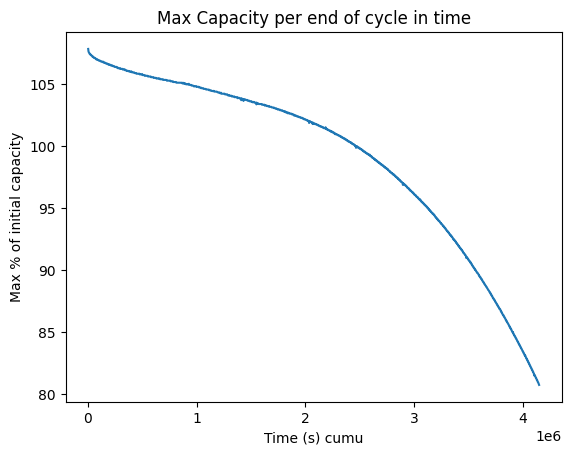

<Figure size 640x480 with 0 Axes>

100%|██████████| 1609/1609 [00:01<00:00, 1123.54it/s]


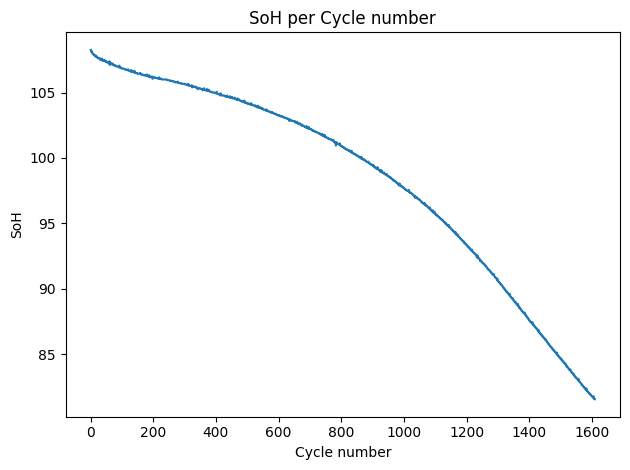

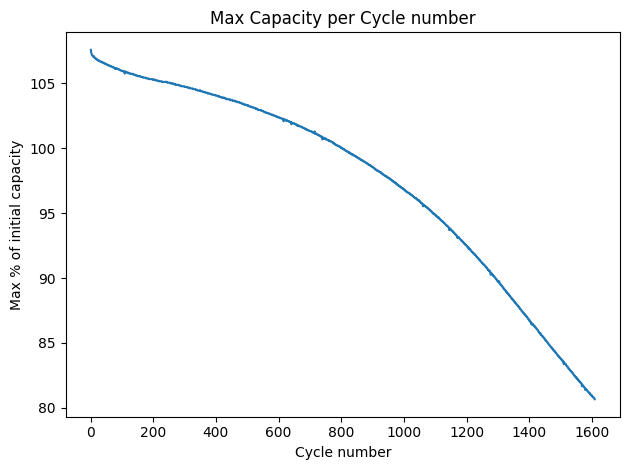

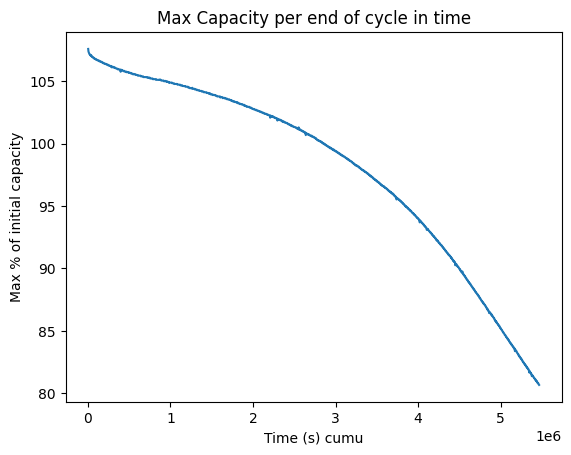

<Figure size 640x480 with 0 Axes>

100%|██████████| 1811/1811 [00:01<00:00, 1021.76it/s]


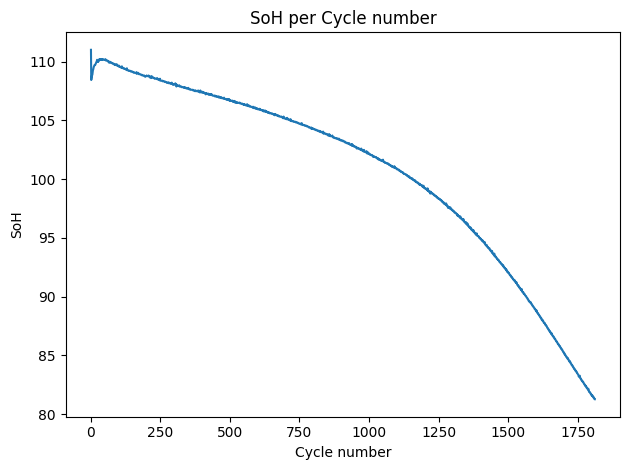

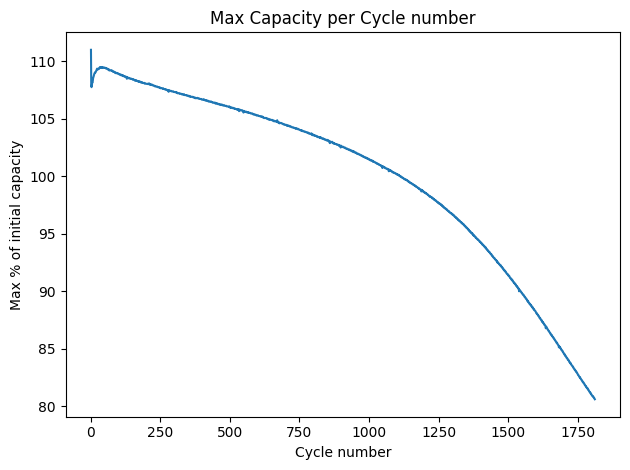

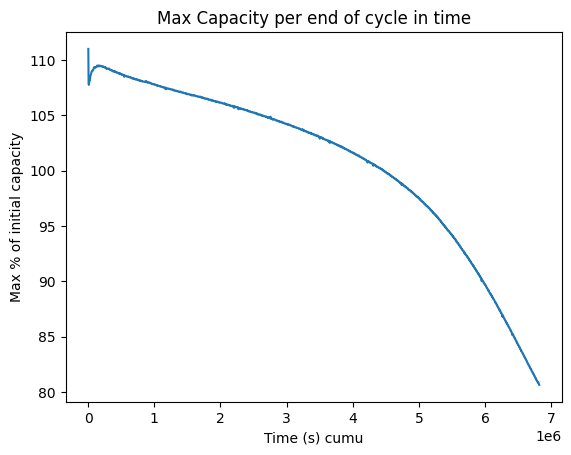

<Figure size 640x480 with 0 Axes>

100%|██████████| 1908/1908 [00:01<00:00, 1089.92it/s]


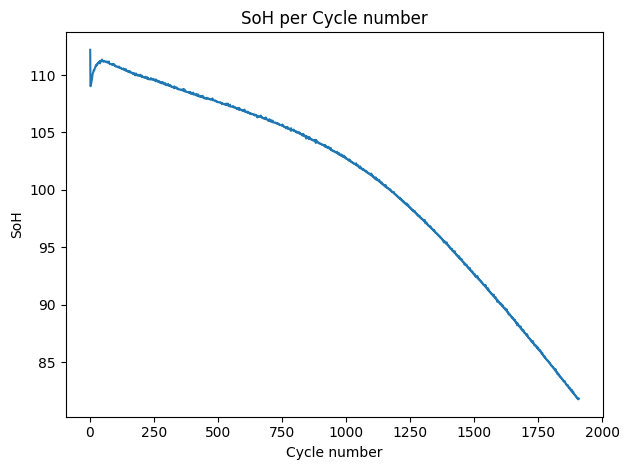

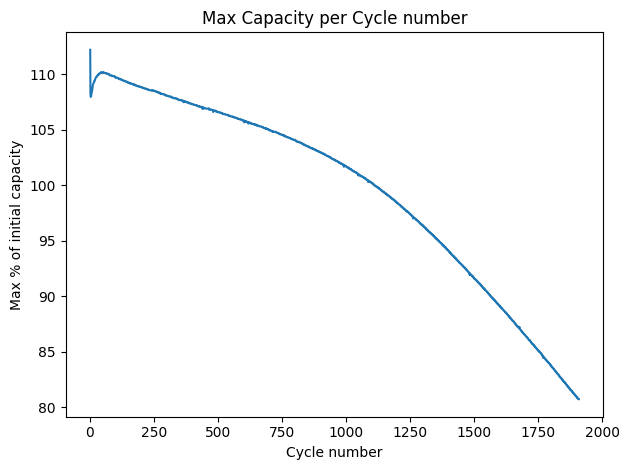

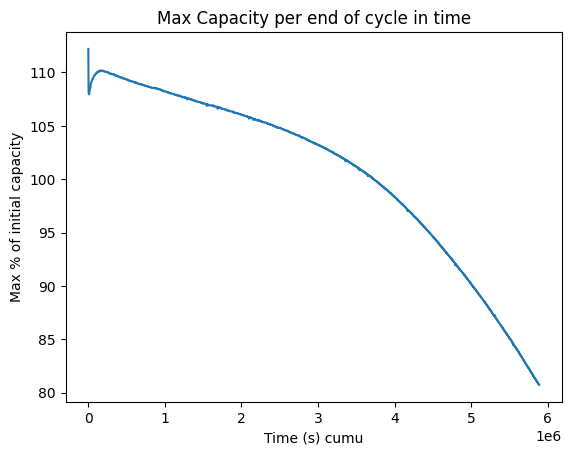

<Figure size 640x480 with 0 Axes>

100%|██████████| 1938/1938 [00:01<00:00, 1023.71it/s]


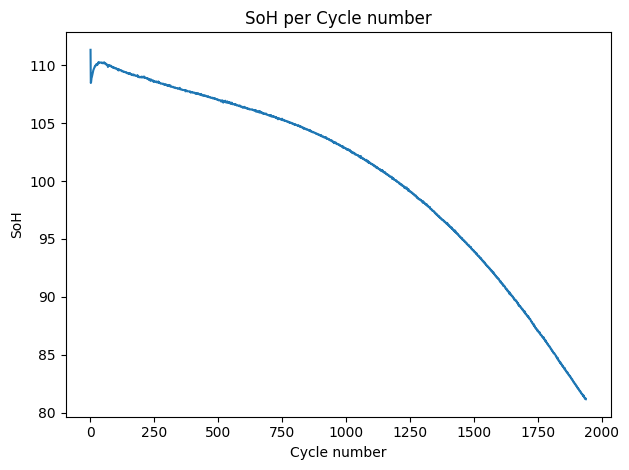

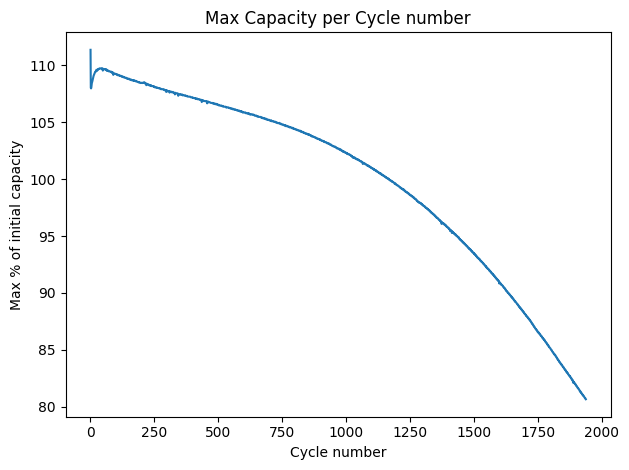

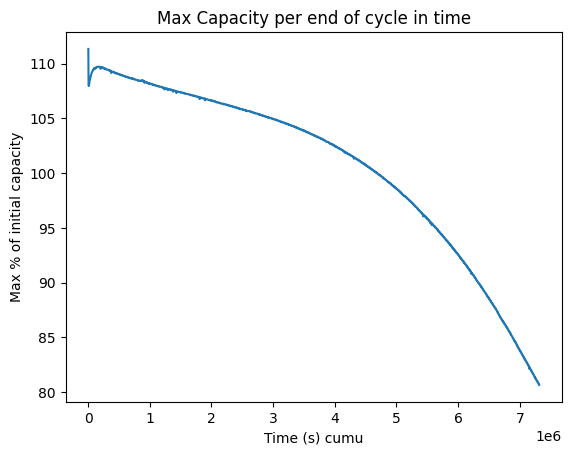

<Figure size 640x480 with 0 Axes>

100%|██████████| 1348/1348 [00:01<00:00, 1100.96it/s]


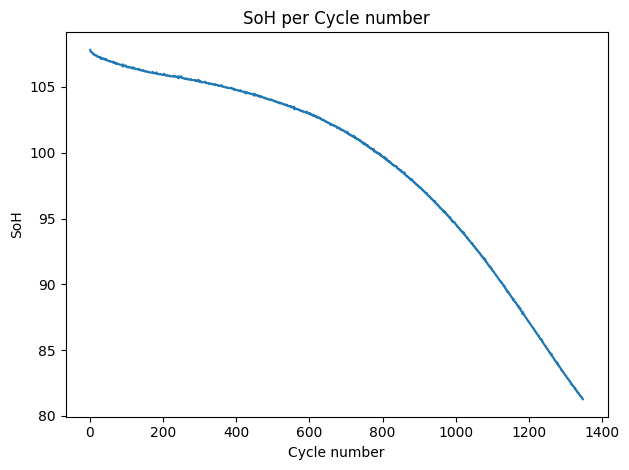

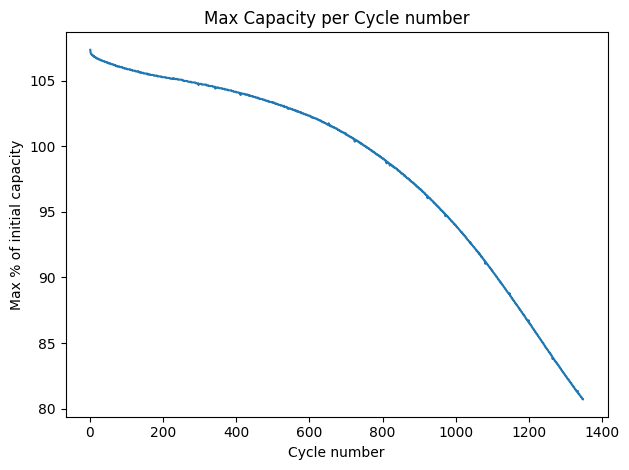

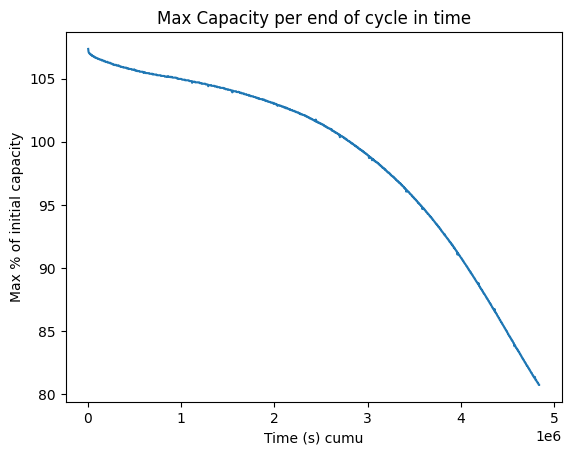

<Figure size 640x480 with 0 Axes>

100%|██████████| 2468/2468 [00:02<00:00, 1033.20it/s]


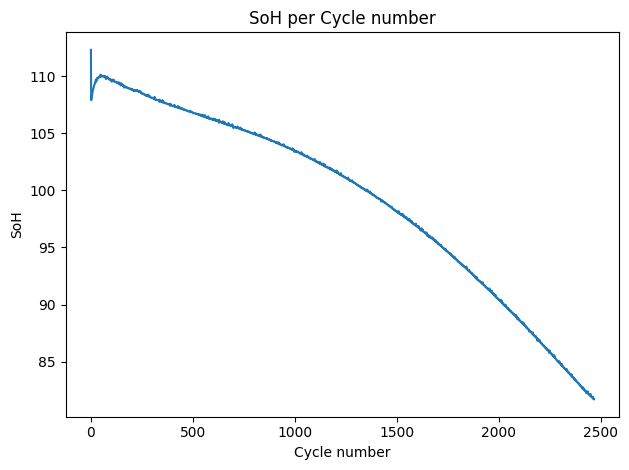

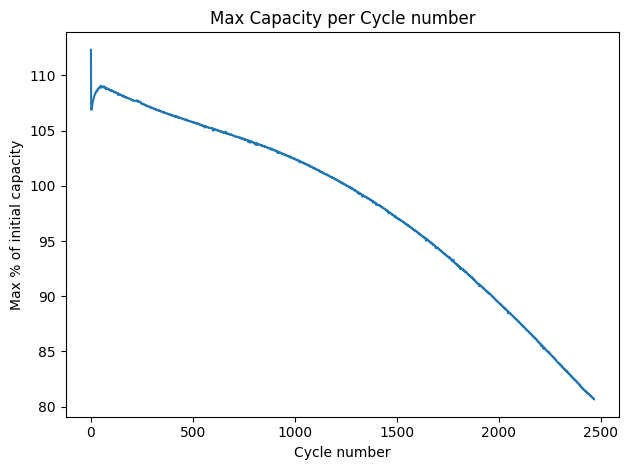

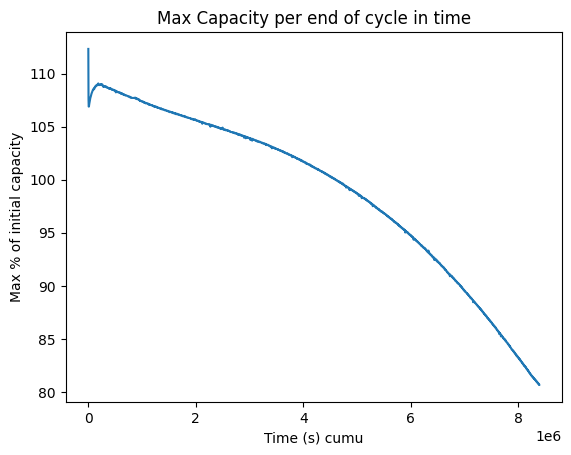

<Figure size 640x480 with 0 Axes>

100%|██████████| 2178/2178 [00:02<00:00, 937.03it/s] 


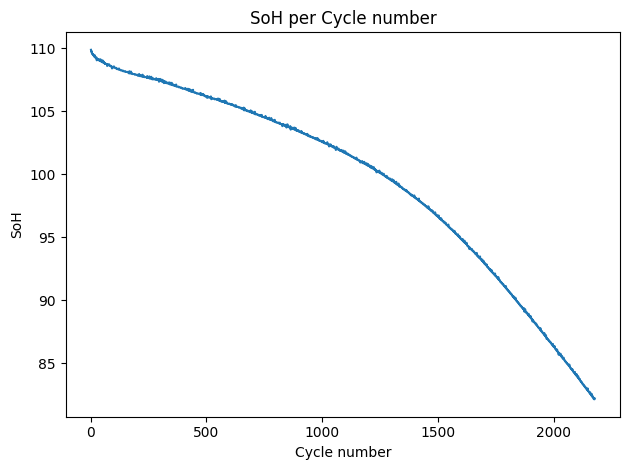

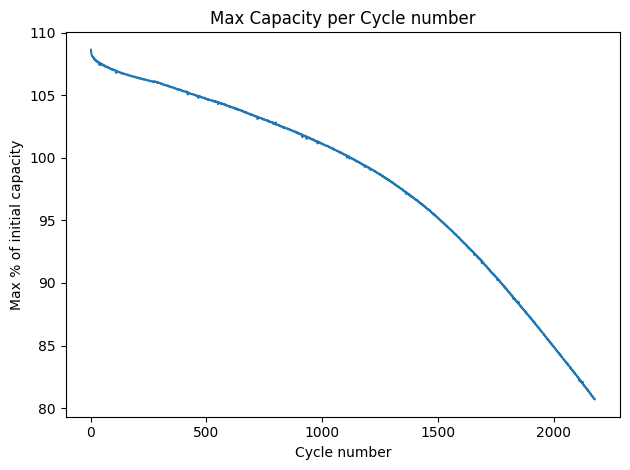

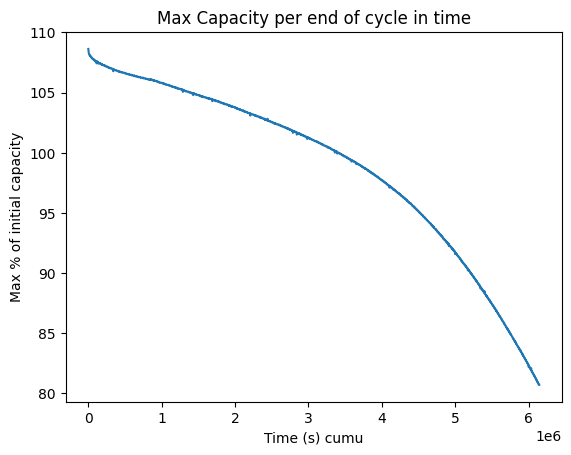

<Figure size 640x480 with 0 Axes>

100%|██████████| 1400/1400 [00:01<00:00, 1046.47it/s]


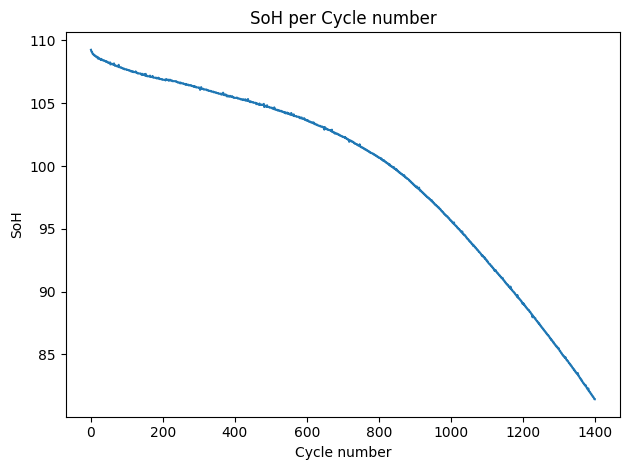

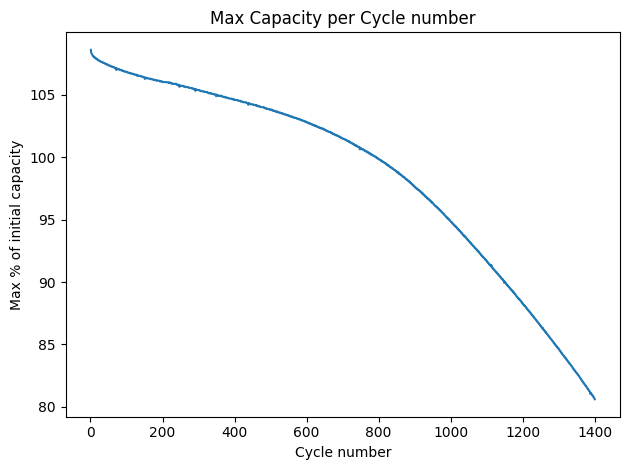

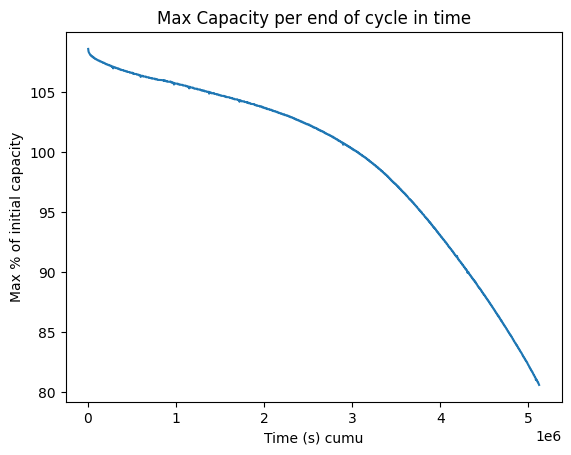

<Figure size 640x480 with 0 Axes>

100%|██████████| 1685/1685 [00:05<00:00, 321.91it/s]


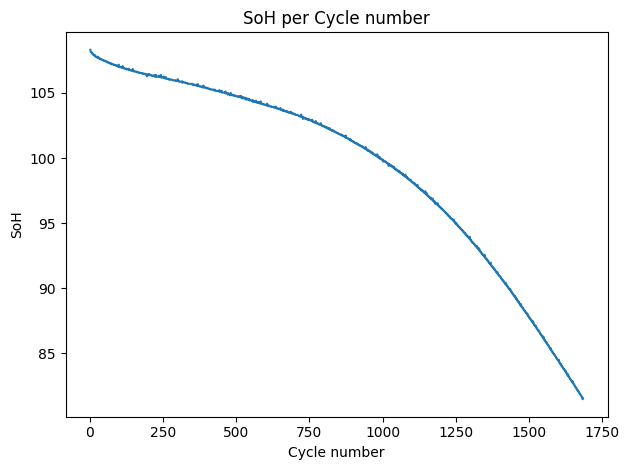

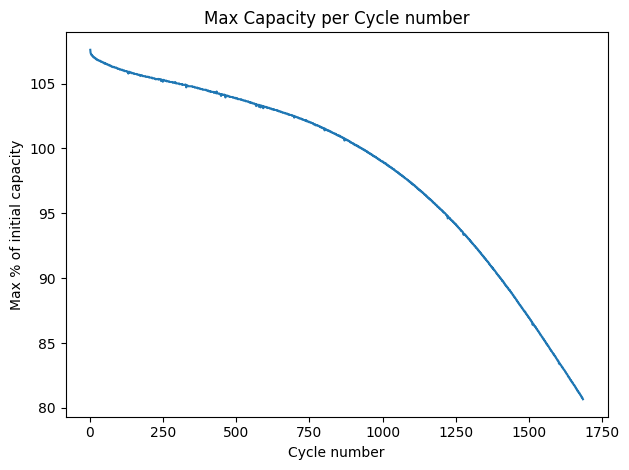

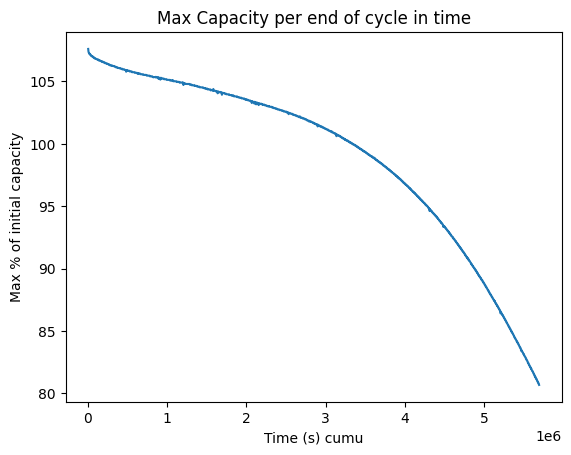

<Figure size 640x480 with 0 Axes>

100%|██████████| 2460/2460 [00:02<00:00, 1151.72it/s]


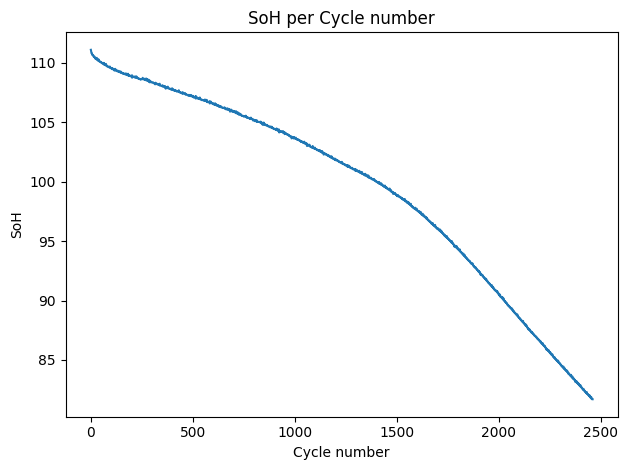

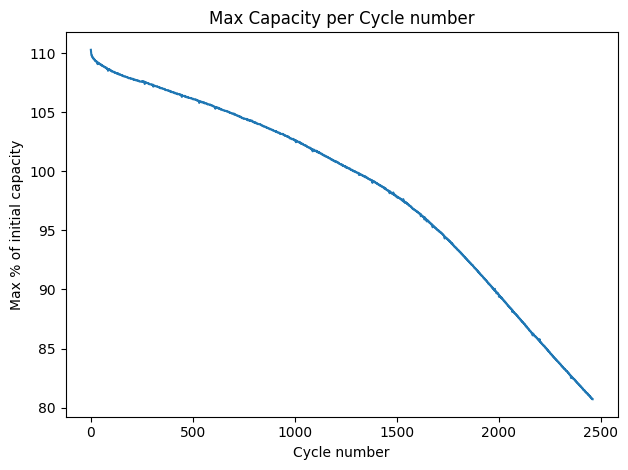

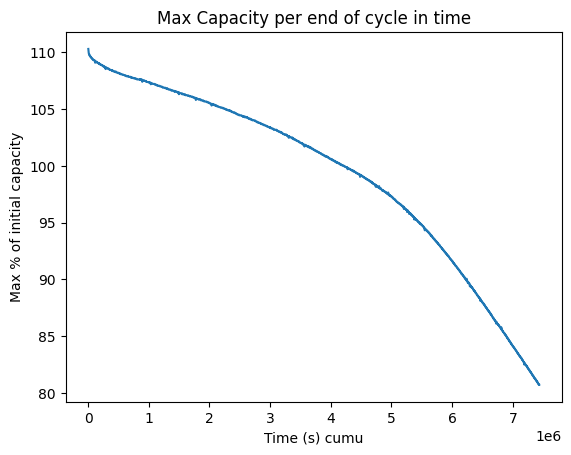

<Figure size 640x480 with 0 Axes>

100%|██████████| 2143/2143 [00:01<00:00, 1079.56it/s]


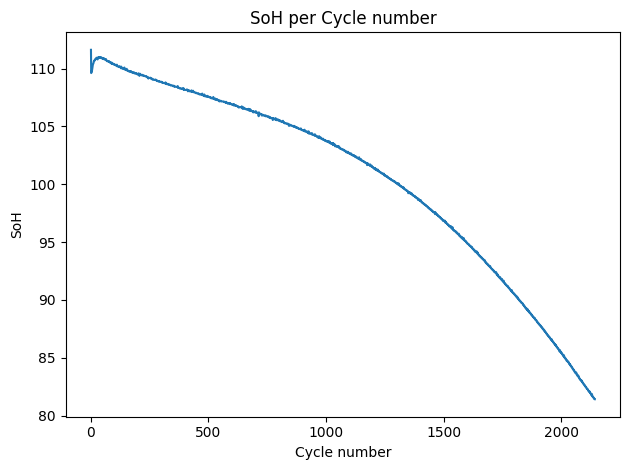

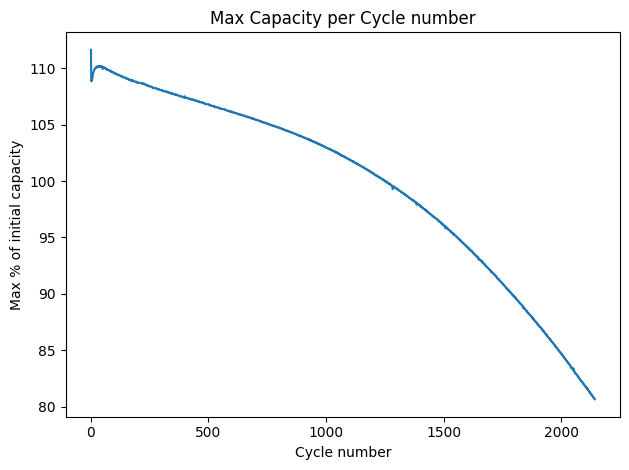

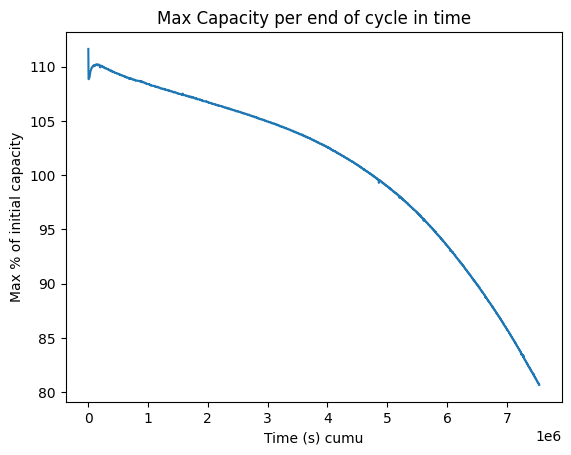

<Figure size 640x480 with 0 Axes>

100%|██████████| 2342/2342 [00:02<00:00, 1148.11it/s]


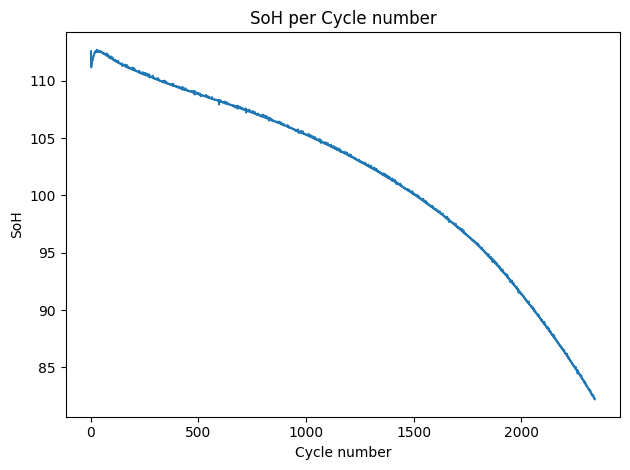

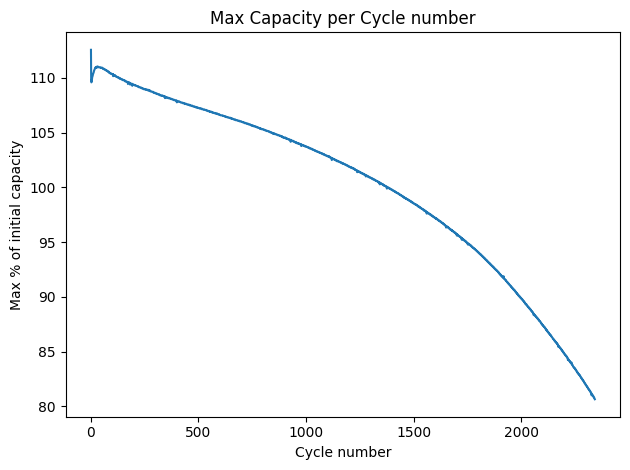

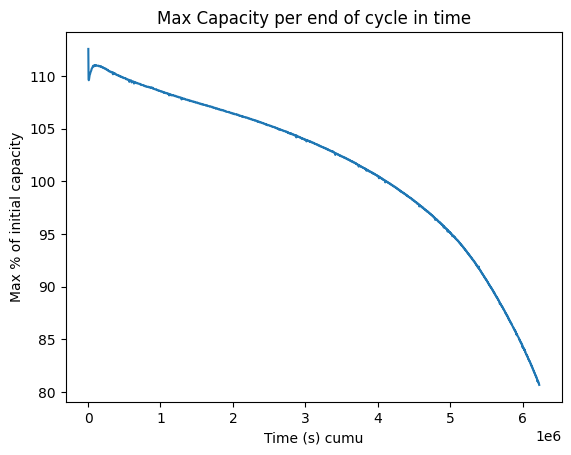

<Figure size 640x480 with 0 Axes>

100%|██████████| 2290/2290 [00:02<00:00, 1085.71it/s]


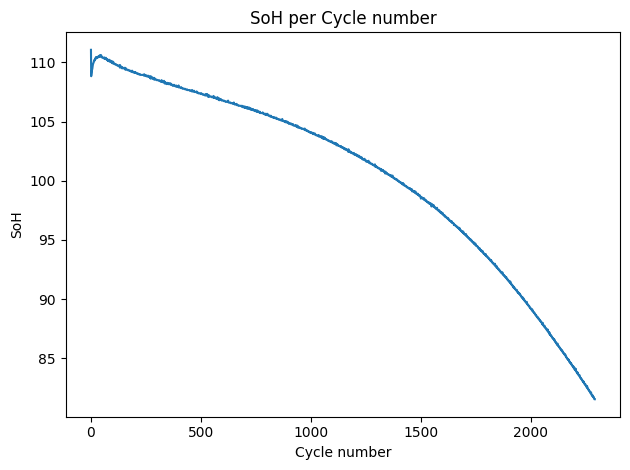

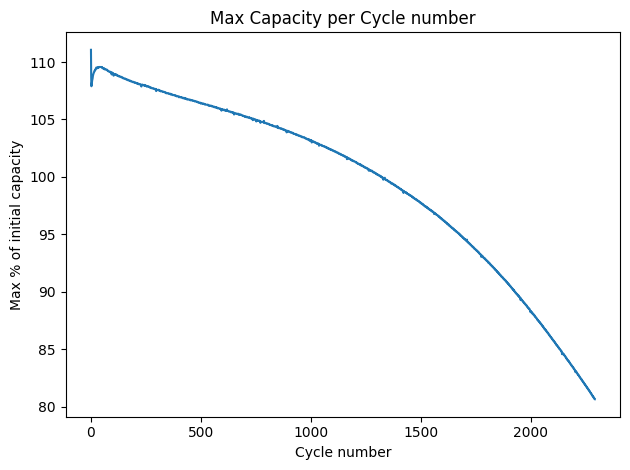

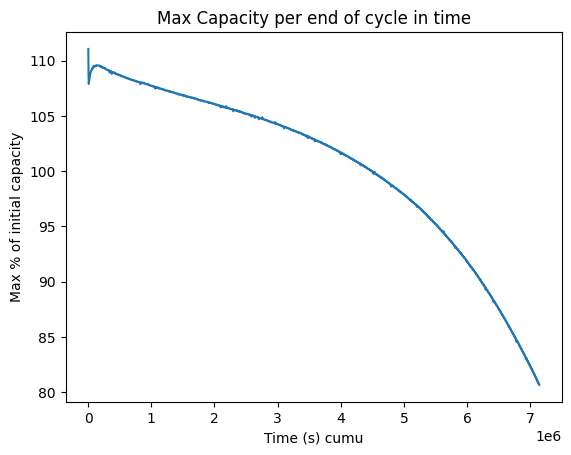

<Figure size 640x480 with 0 Axes>

100%|██████████| 1905/1905 [00:01<00:00, 957.24it/s] 


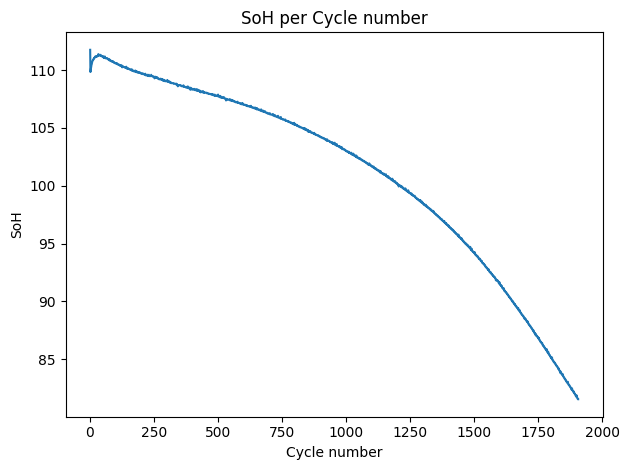

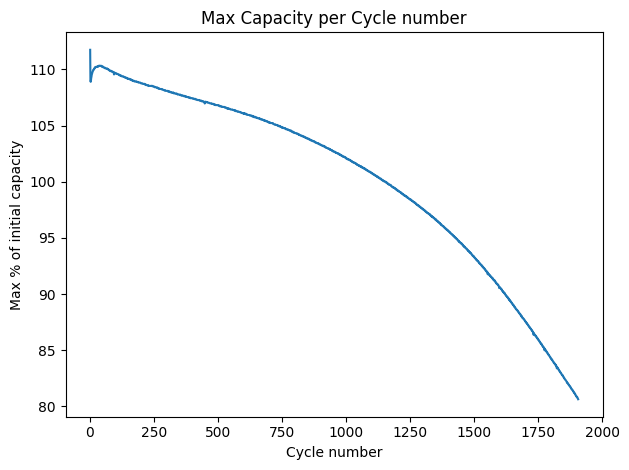

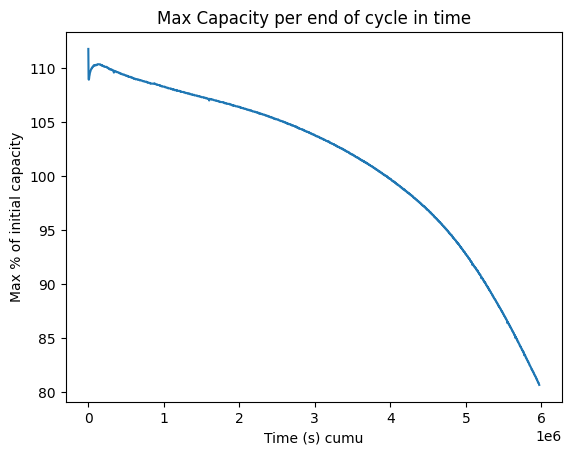

<Figure size 640x480 with 0 Axes>

100%|██████████| 2216/2216 [00:02<00:00, 1107.04it/s]


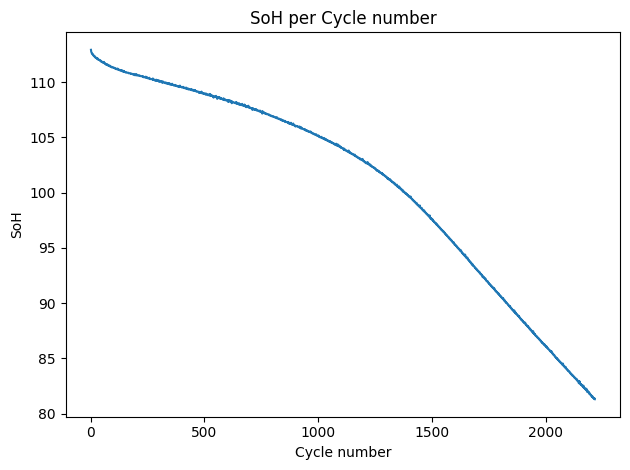

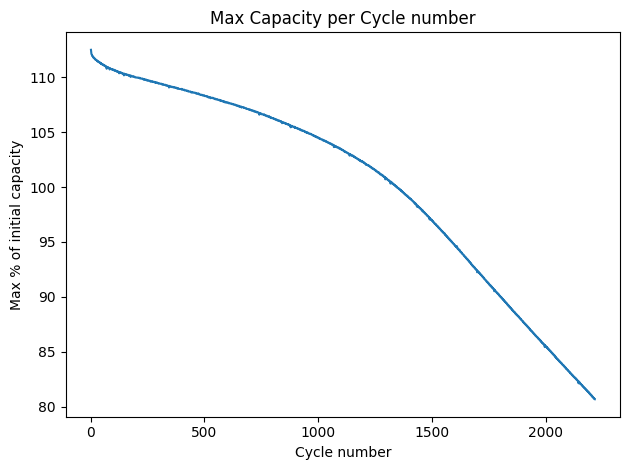

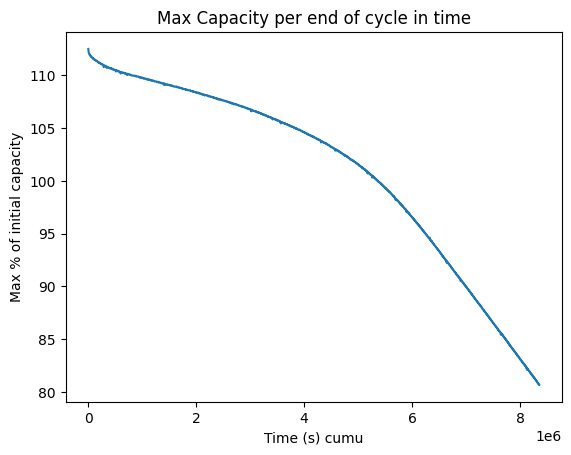

<Figure size 640x480 with 0 Axes>

100%|██████████| 1858/1858 [00:01<00:00, 1086.78it/s]


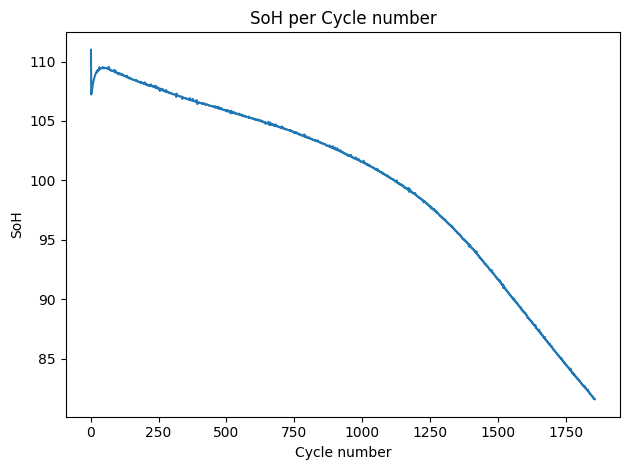

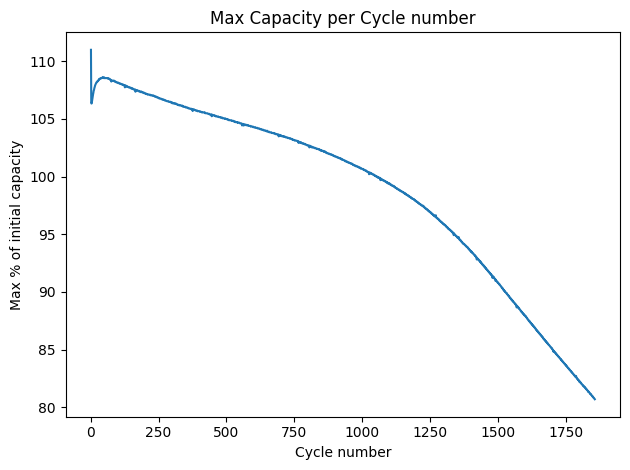

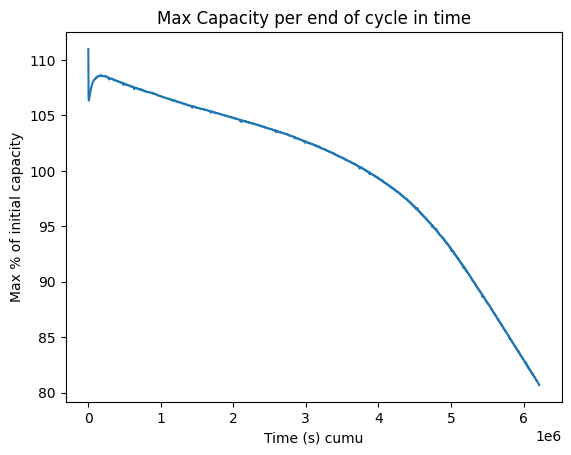

<Figure size 640x480 with 0 Axes>

100%|██████████| 1875/1875 [00:01<00:00, 1110.73it/s]


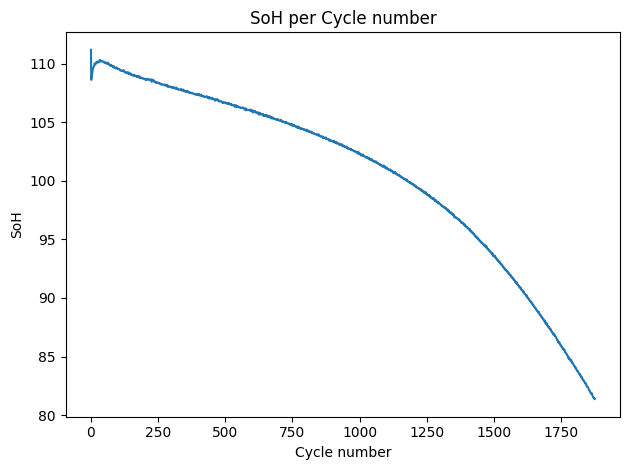

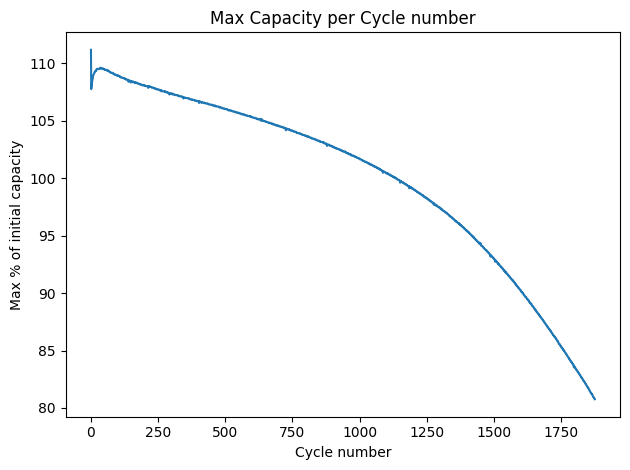

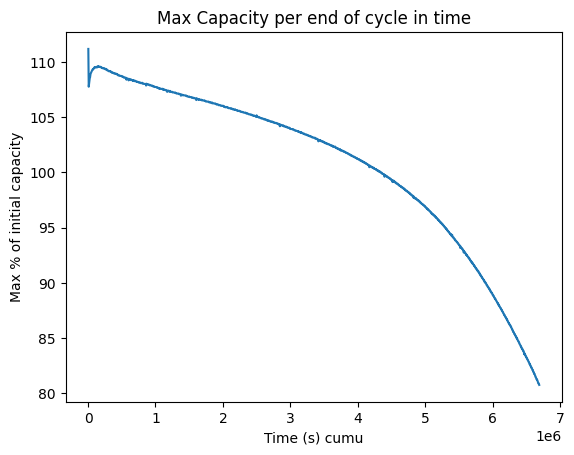

<Figure size 640x480 with 0 Axes>

100%|██████████| 2365/2365 [00:02<00:00, 1102.48it/s]


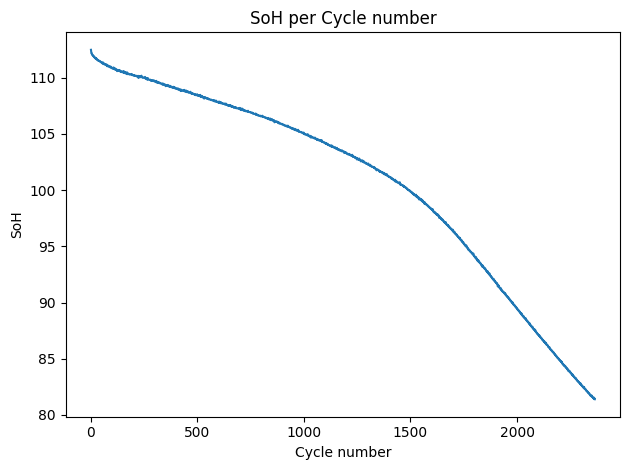

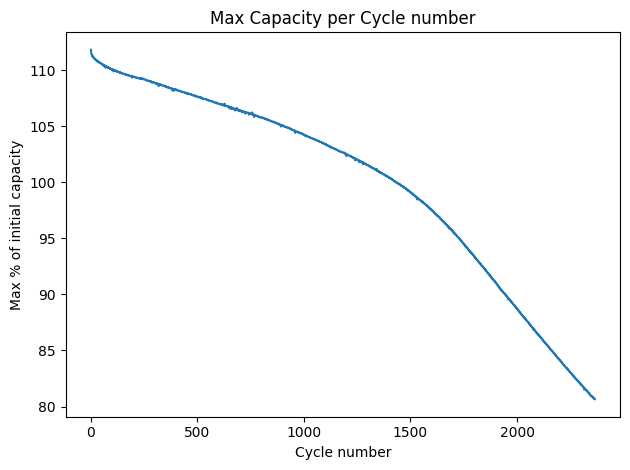

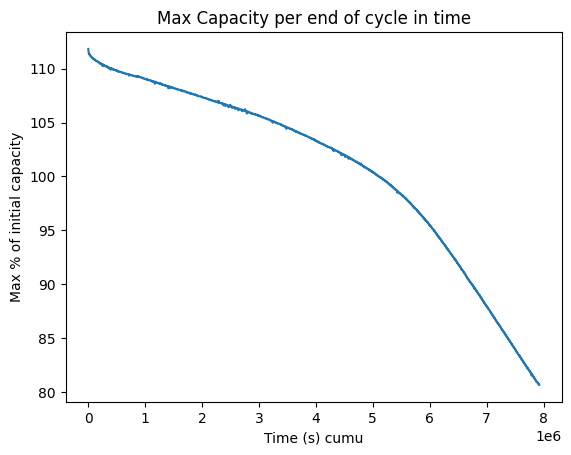

<Figure size 640x480 with 0 Axes>

100%|██████████| 1583/1583 [00:01<00:00, 1155.90it/s]


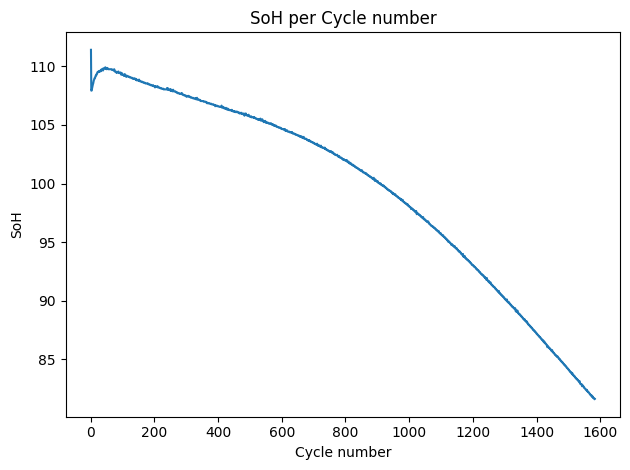

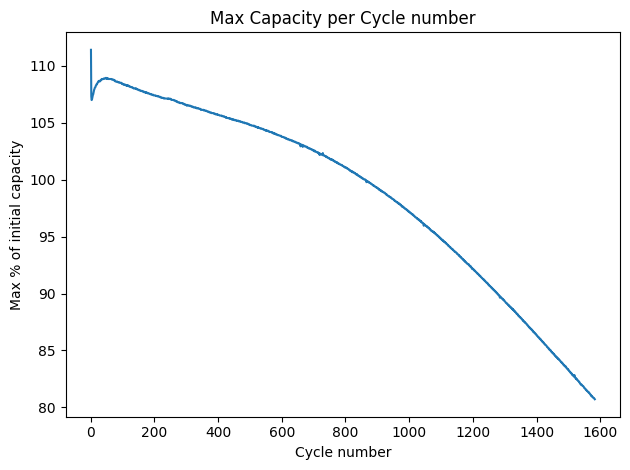

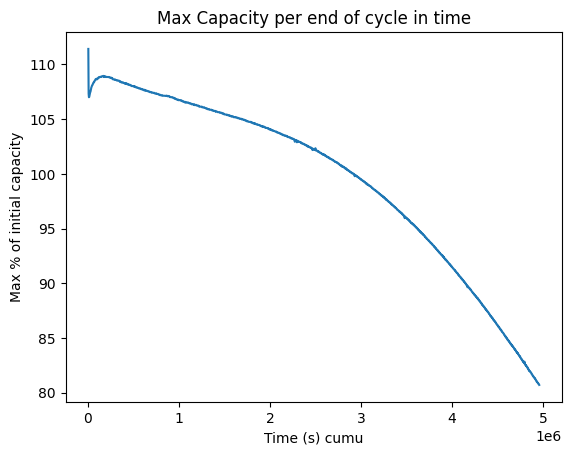

<Figure size 640x480 with 0 Axes>

100%|██████████| 1885/1885 [00:01<00:00, 1109.52it/s]


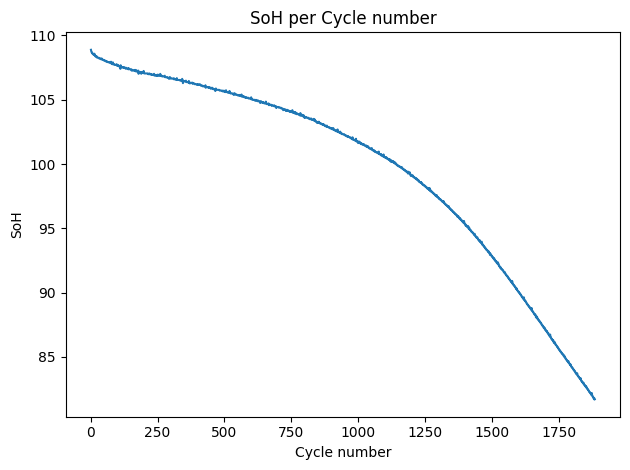

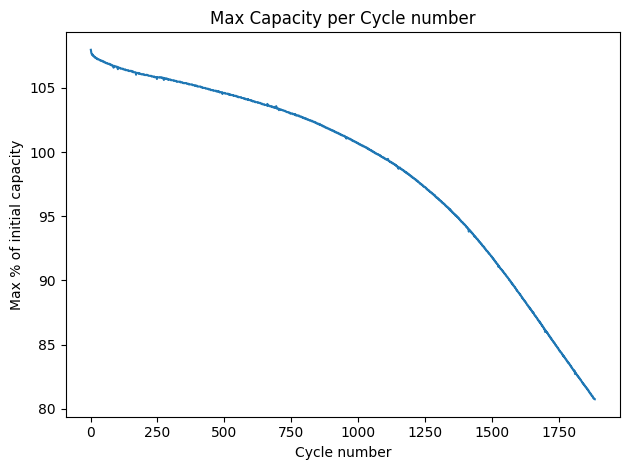

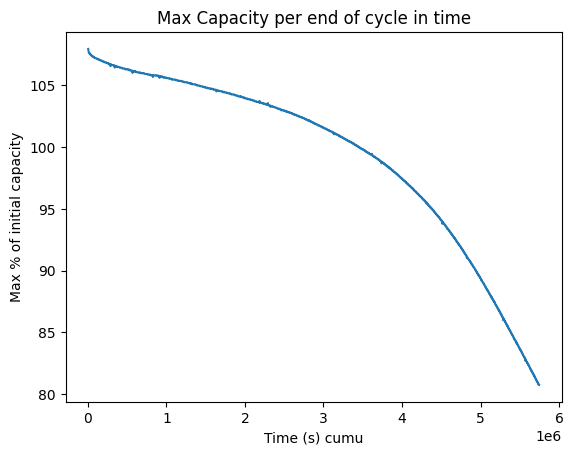

<Figure size 640x480 with 0 Axes>

100%|██████████| 1481/1481 [00:01<00:00, 1143.51it/s]


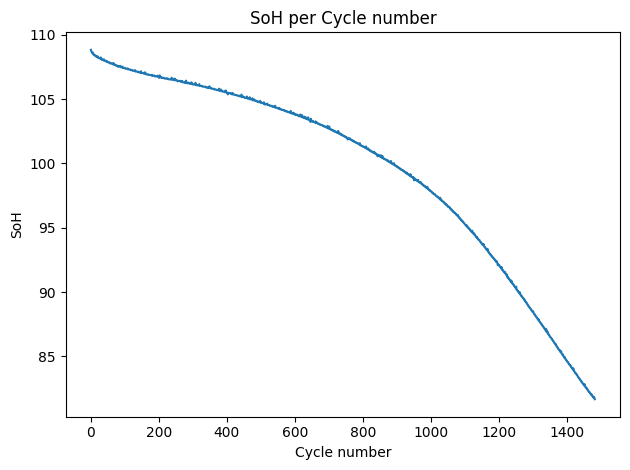

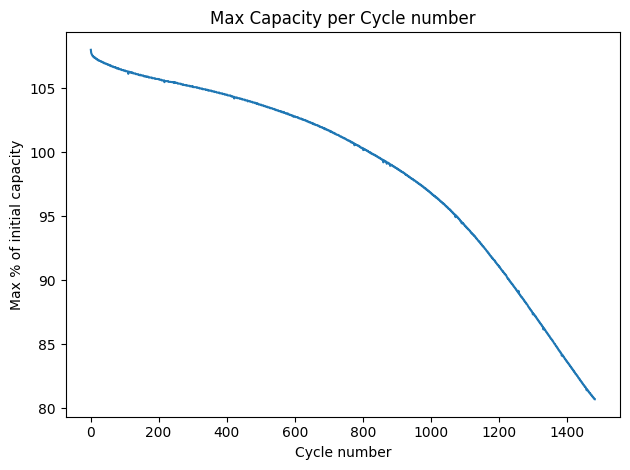

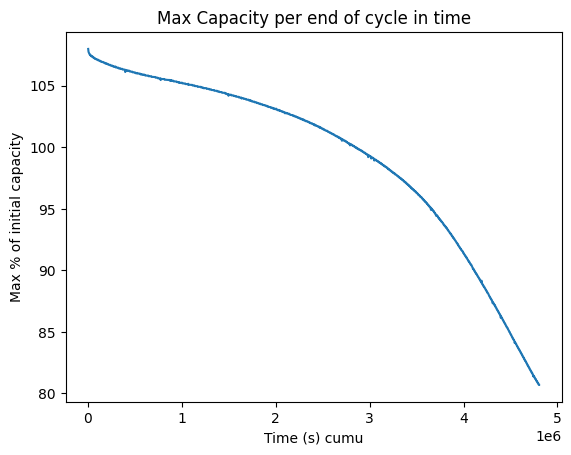

<Figure size 640x480 with 0 Axes>

100%|██████████| 2479/2479 [00:02<00:00, 1078.53it/s]


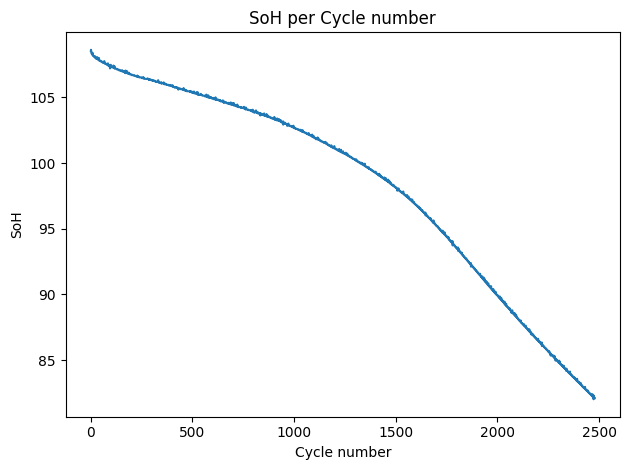

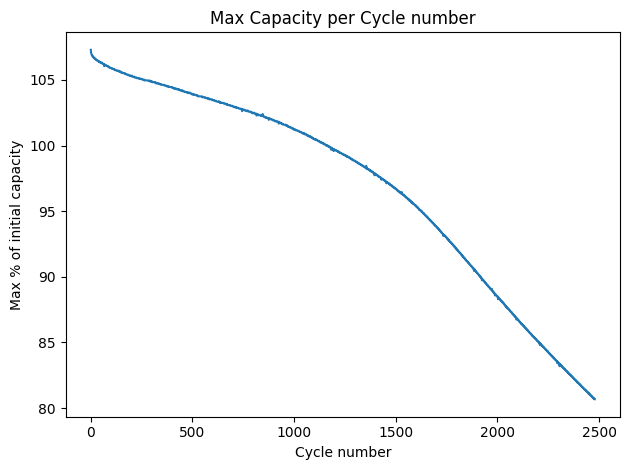

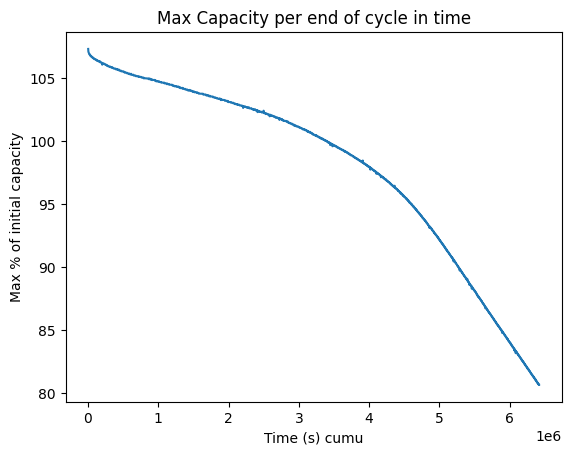

<Figure size 640x480 with 0 Axes>

100%|██████████| 1419/1419 [00:01<00:00, 1132.95it/s]


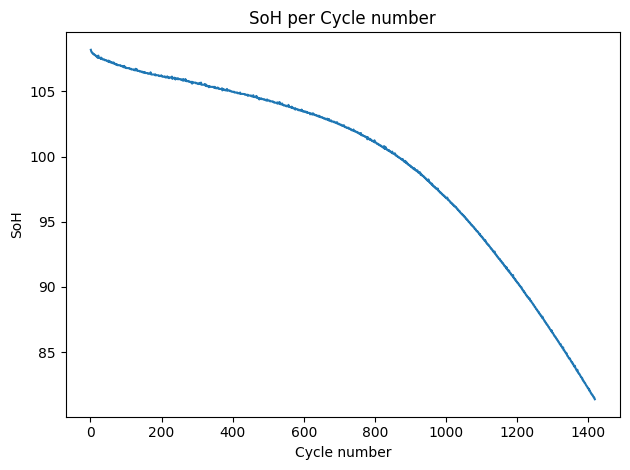

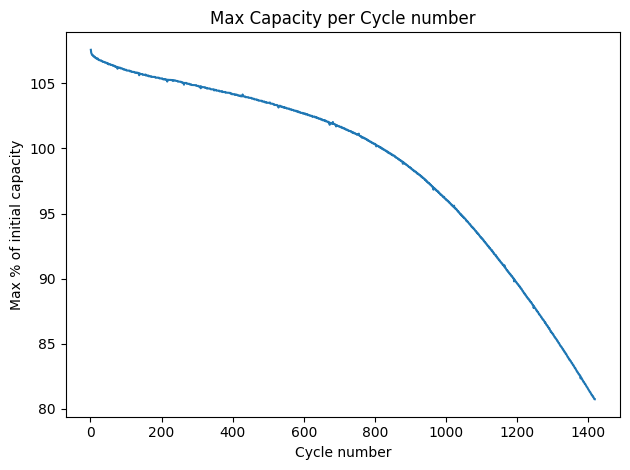

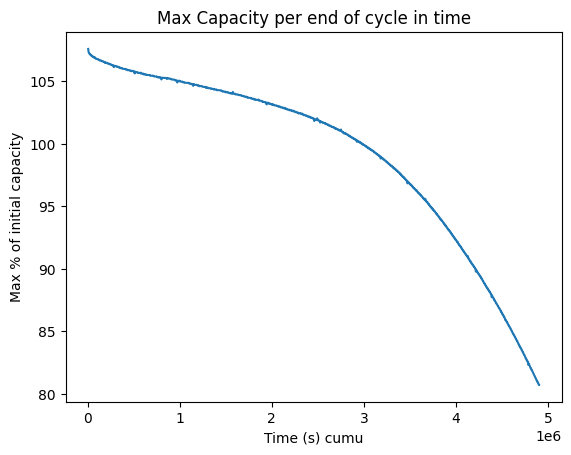

<Figure size 640x480 with 0 Axes>

100%|██████████| 1504/1504 [00:01<00:00, 1074.20it/s]


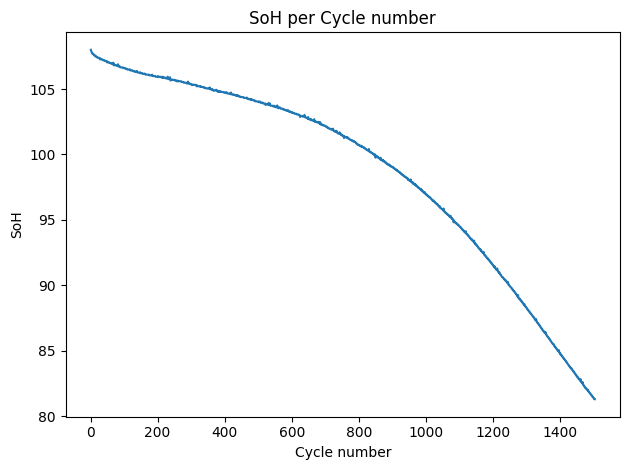

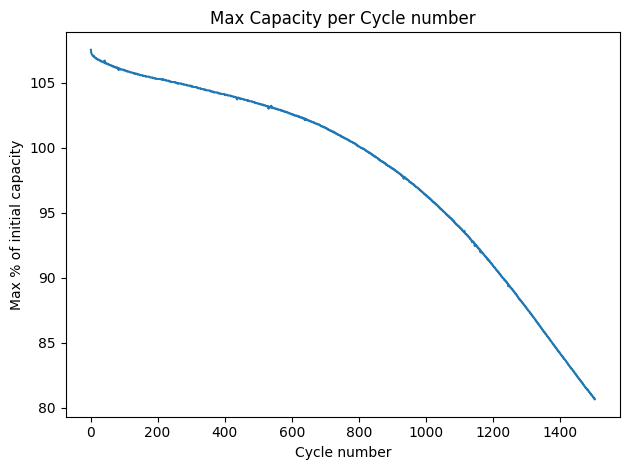

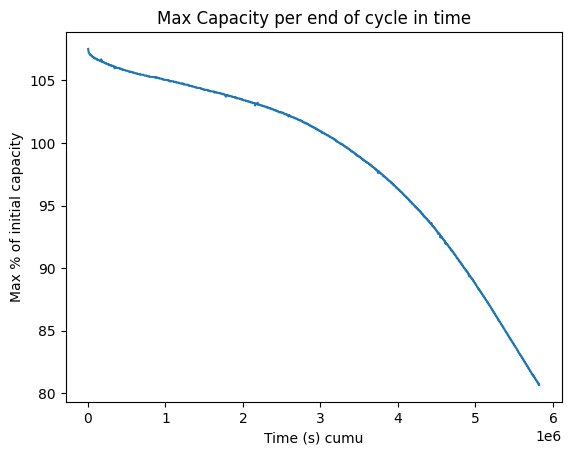

<Figure size 640x480 with 0 Axes>

100%|██████████| 1783/1783 [00:01<00:00, 1000.24it/s]


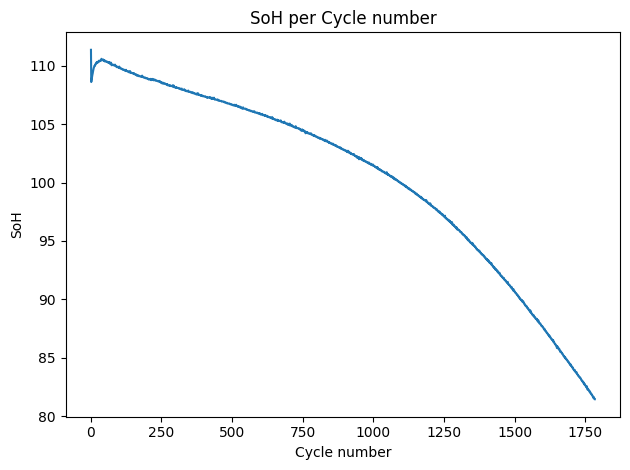

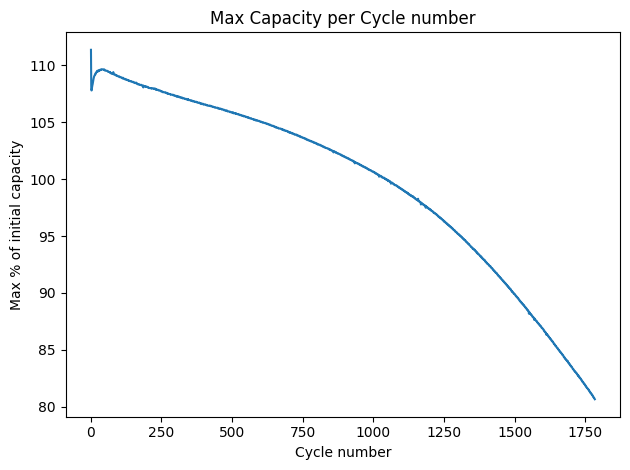

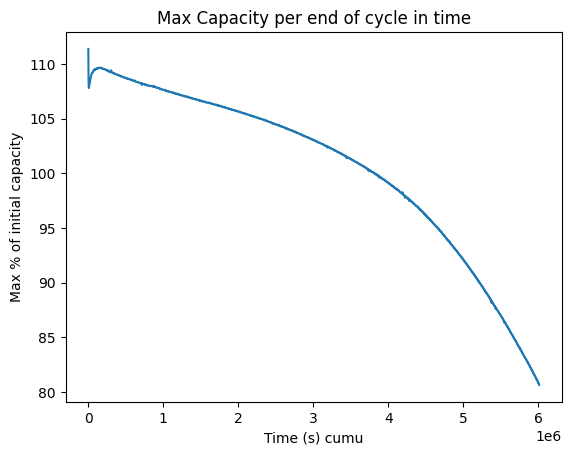

<Figure size 640x480 with 0 Axes>

100%|██████████| 1938/1938 [00:01<00:00, 1104.38it/s]


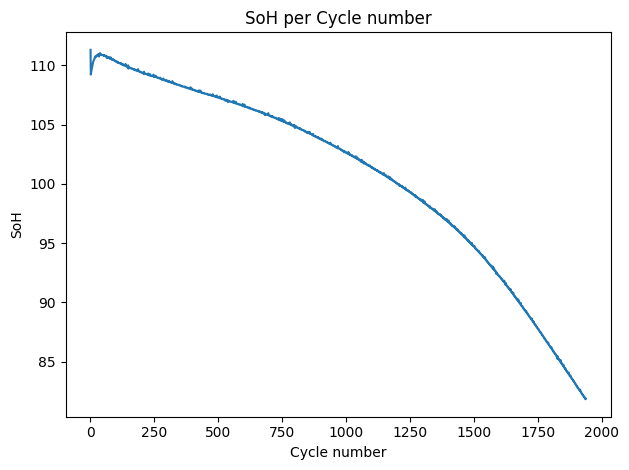

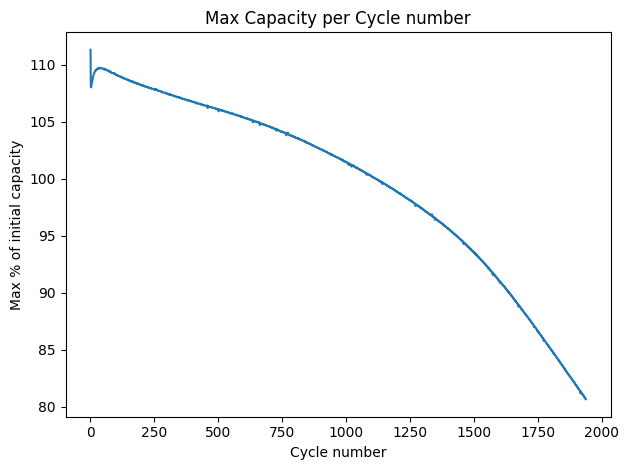

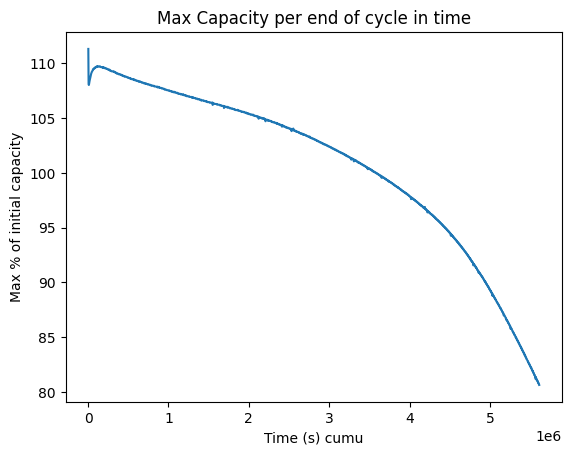

<Figure size 640x480 with 0 Axes>

100%|██████████| 2678/2678 [00:02<00:00, 1110.58it/s]


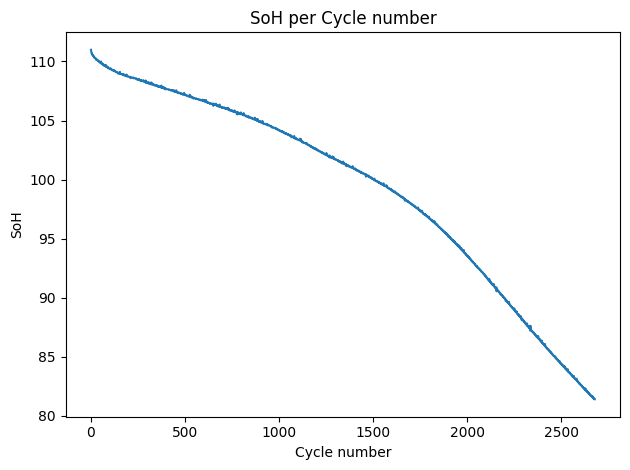

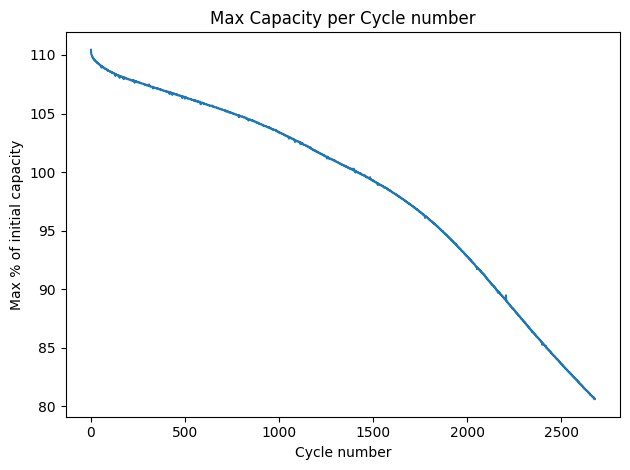

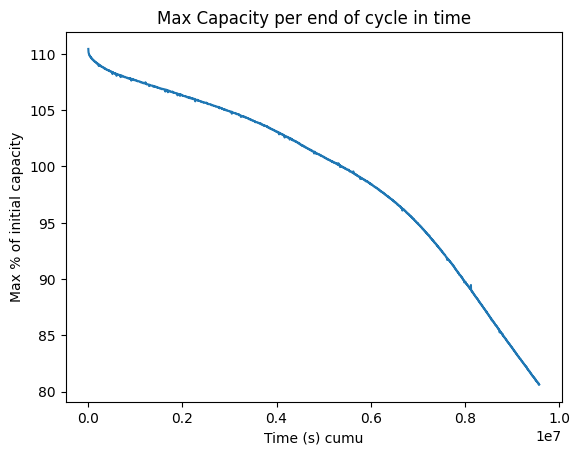

<Figure size 640x480 with 0 Axes>

100%|██████████| 2012/2012 [00:01<00:00, 1108.40it/s]


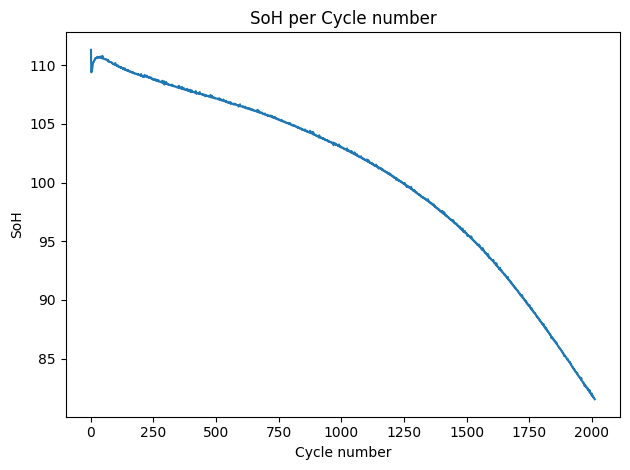

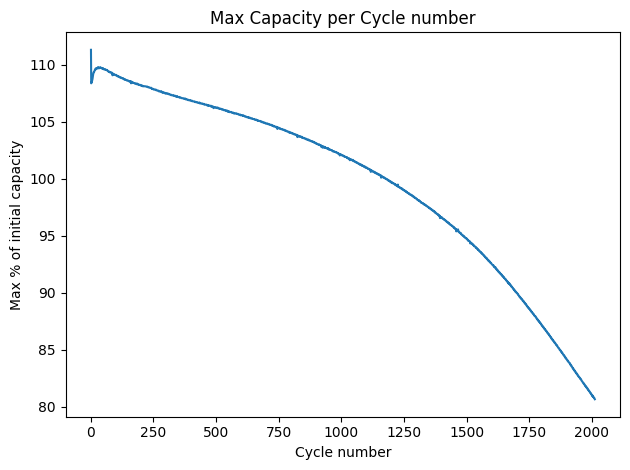

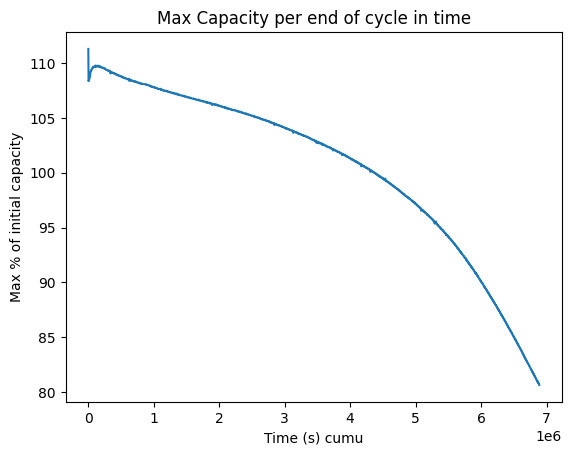

<Figure size 640x480 with 0 Axes>

100%|██████████| 1380/1380 [00:01<00:00, 1121.95it/s]


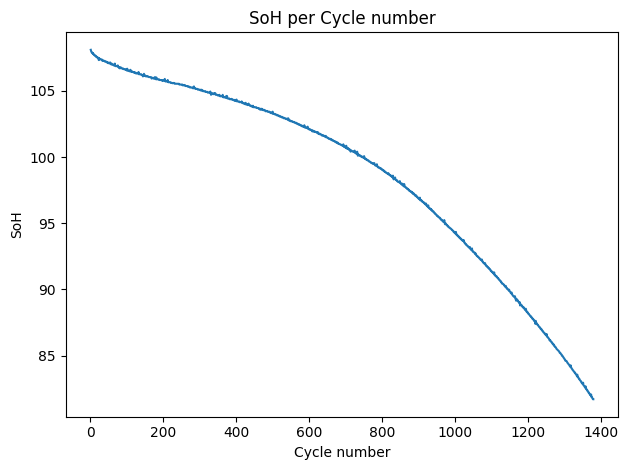

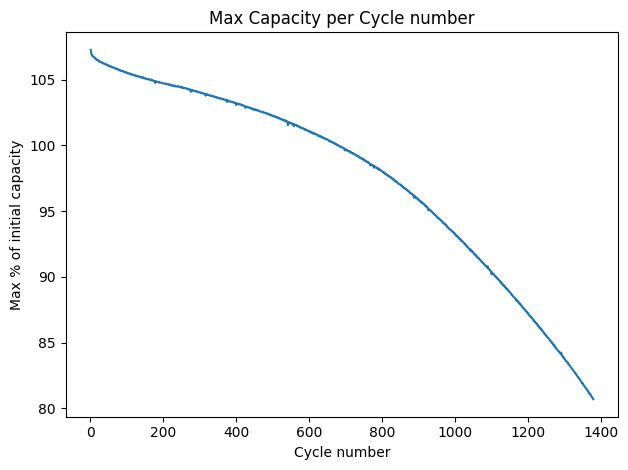

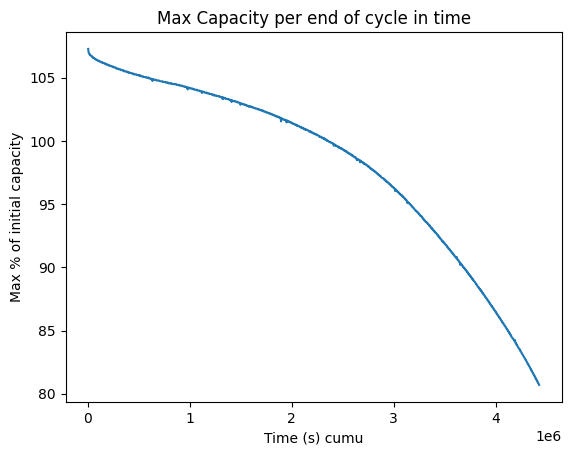

<Figure size 640x480 with 0 Axes>

100%|██████████| 2041/2041 [00:01<00:00, 1120.42it/s]


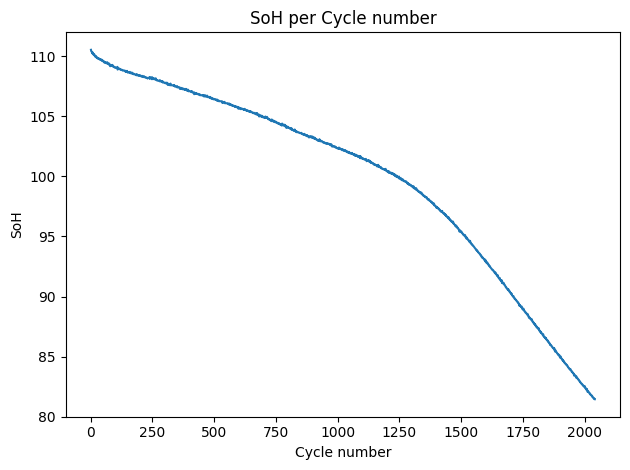

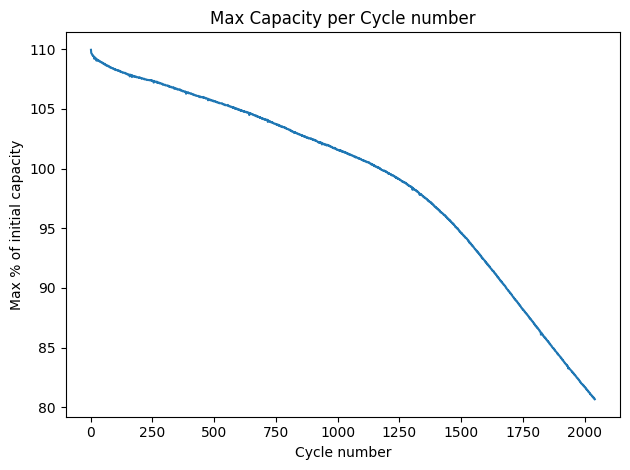

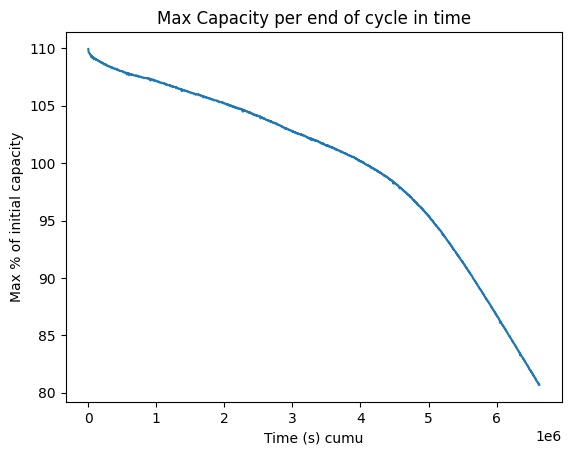

<Figure size 640x480 with 0 Axes>

100%|██████████| 1962/1962 [00:01<00:00, 986.76it/s] 


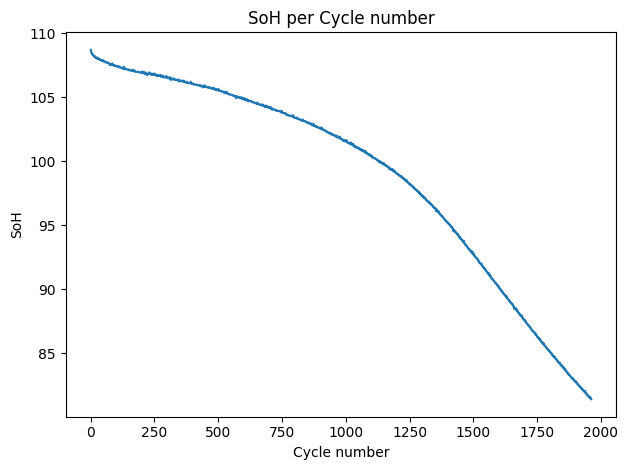

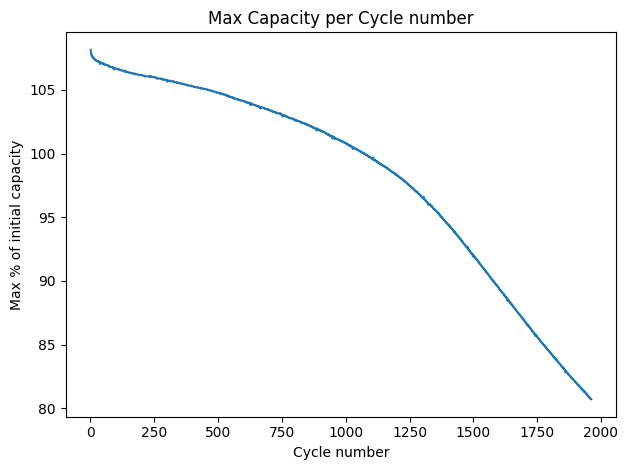

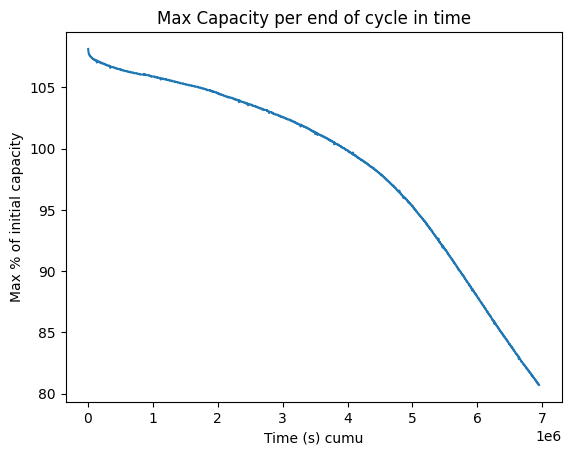

<Figure size 640x480 with 0 Axes>

100%|██████████| 2507/2507 [00:02<00:00, 1163.32it/s]


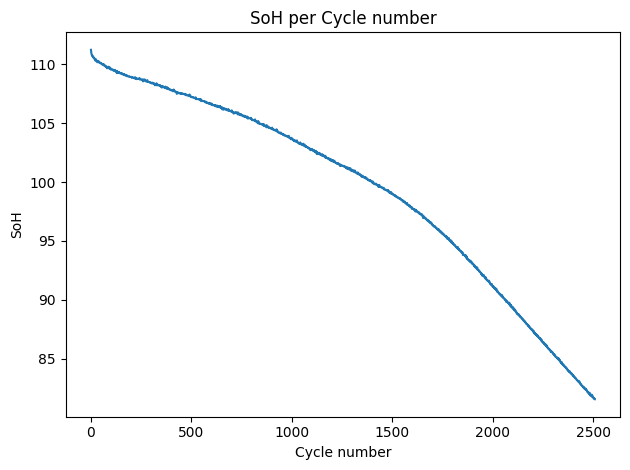

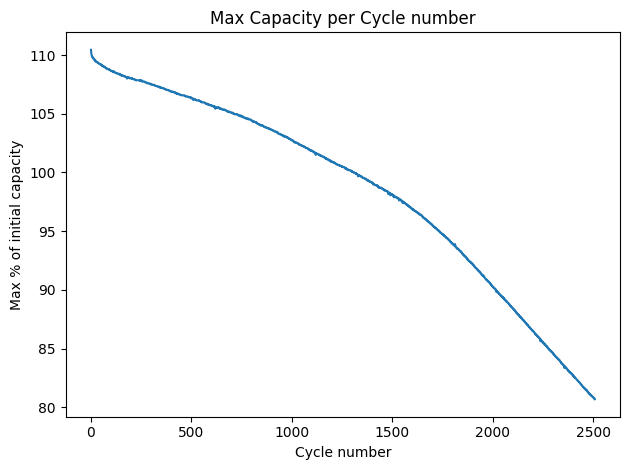

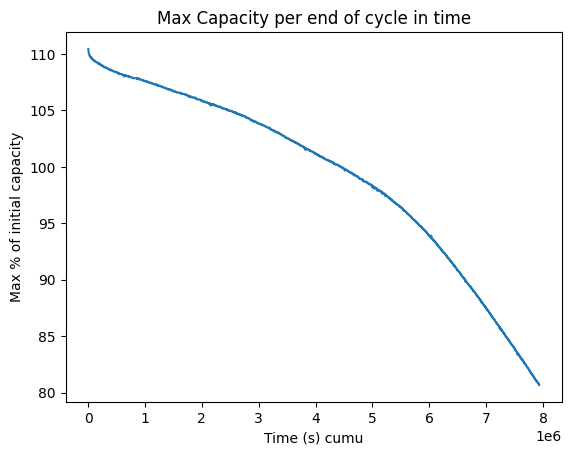

<Figure size 640x480 with 0 Axes>

100%|██████████| 2285/2285 [00:02<00:00, 1124.89it/s]


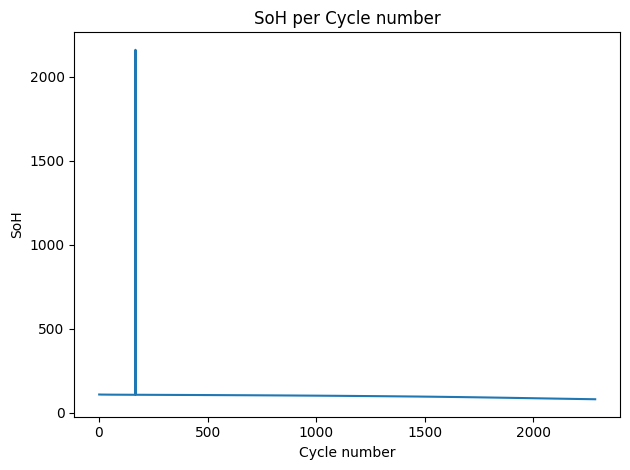

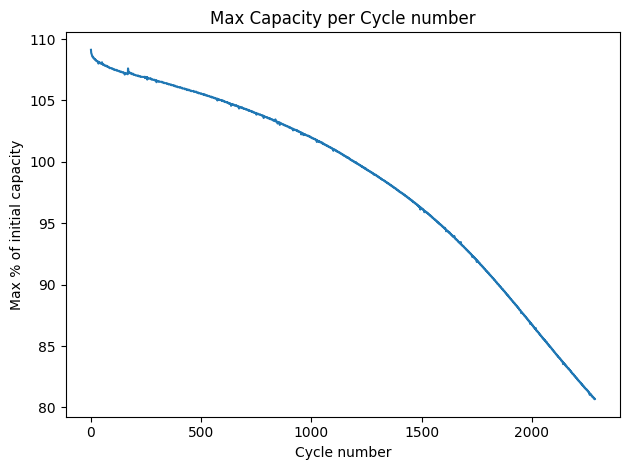

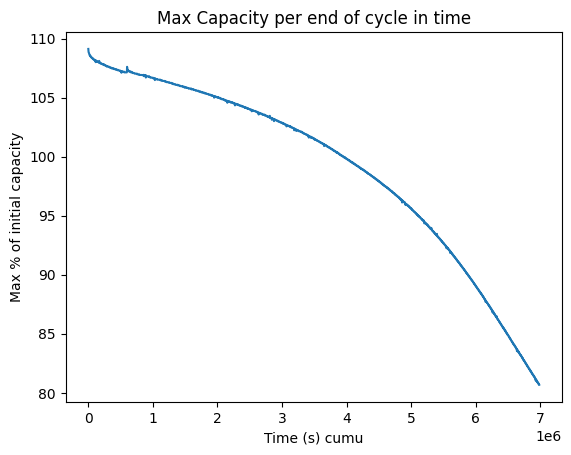

<Figure size 640x480 with 0 Axes>

100%|██████████| 1308/1308 [00:01<00:00, 1119.85it/s]


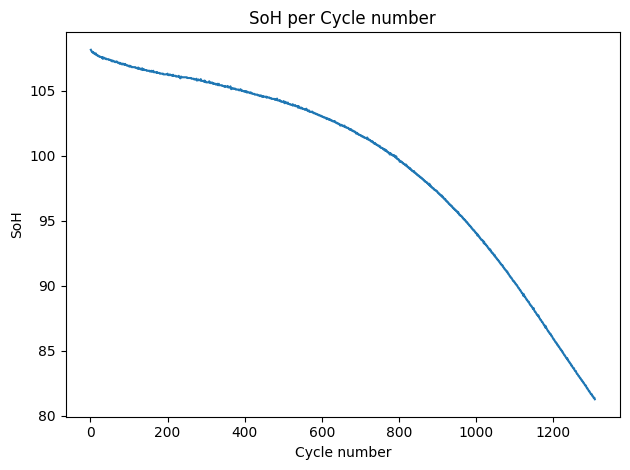

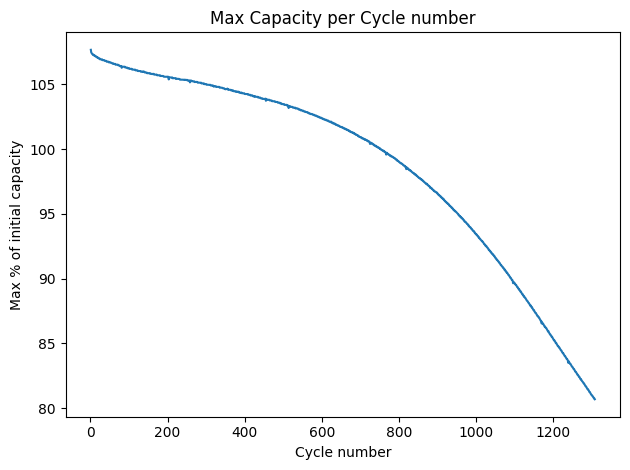

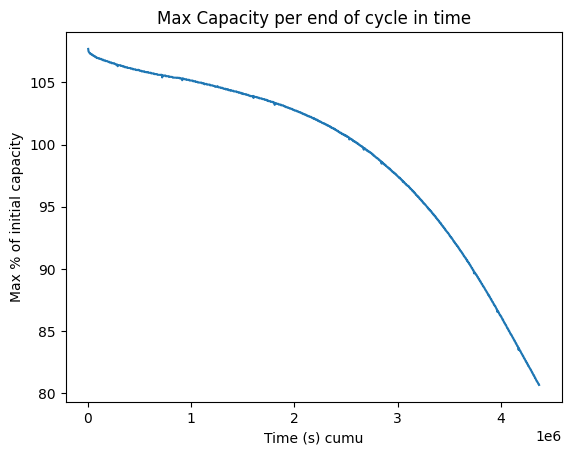

<Figure size 640x480 with 0 Axes>

100%|██████████| 1766/1766 [00:01<00:00, 1142.33it/s]


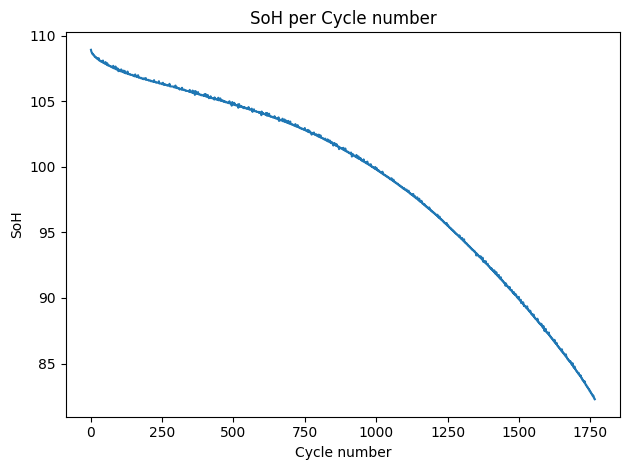

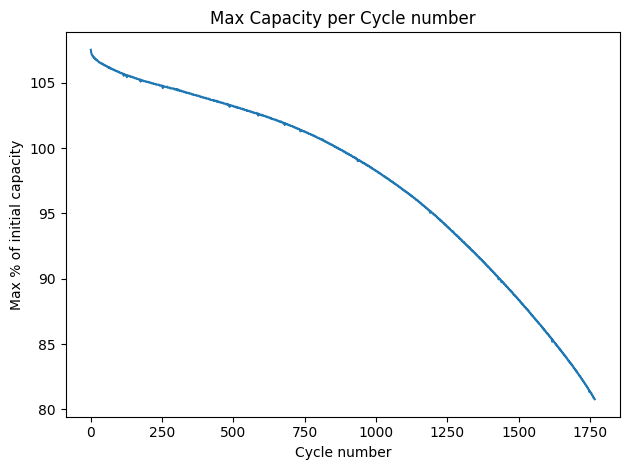

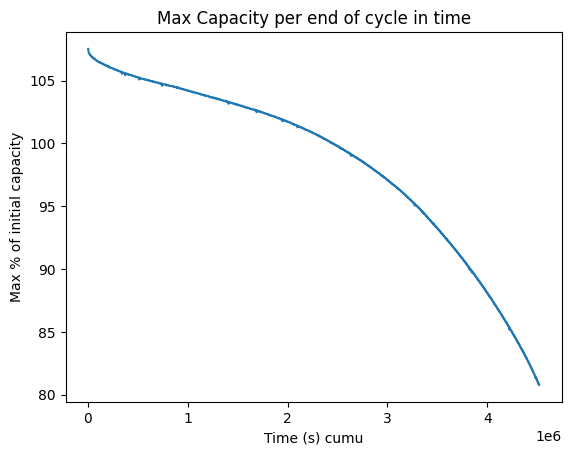

<Figure size 640x480 with 0 Axes>

100%|██████████| 1971/1971 [00:01<00:00, 1020.50it/s]


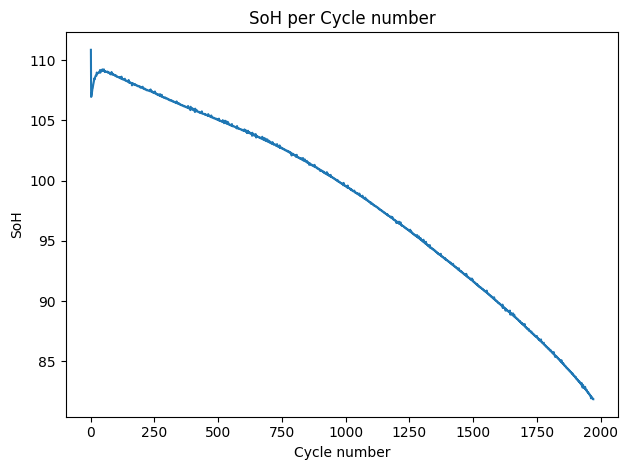

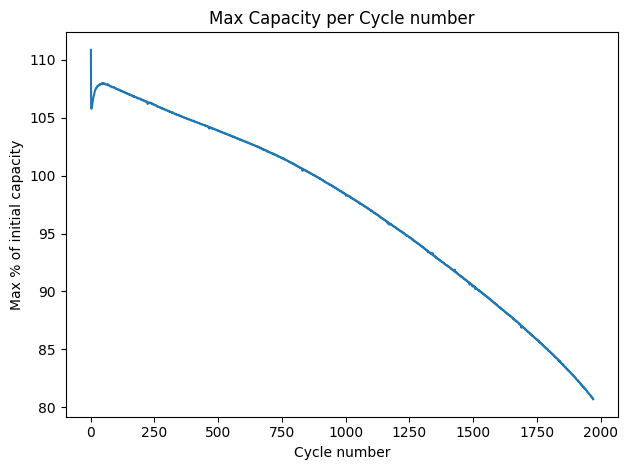

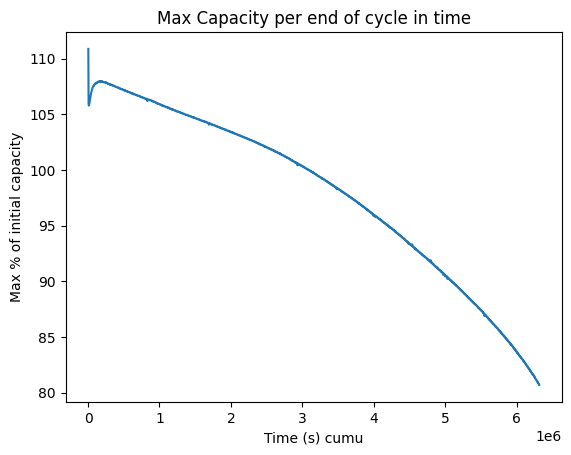

<Figure size 640x480 with 0 Axes>

100%|██████████| 2057/2057 [00:01<00:00, 1071.58it/s]


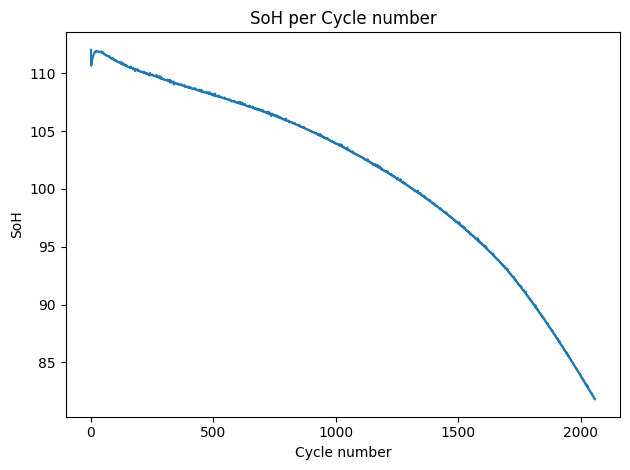

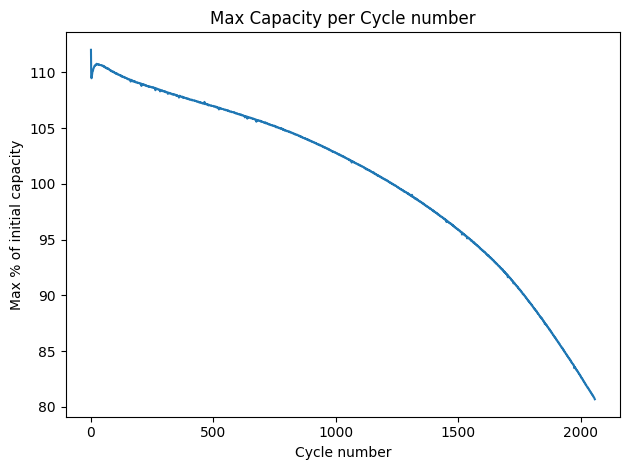

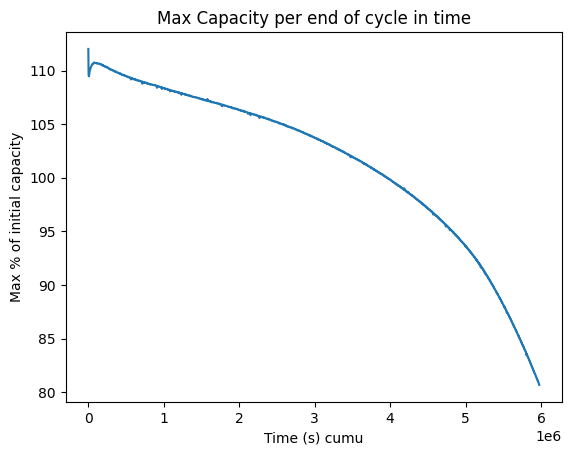

<Figure size 640x480 with 0 Axes>

100%|██████████| 1500/1500 [00:01<00:00, 1106.89it/s]


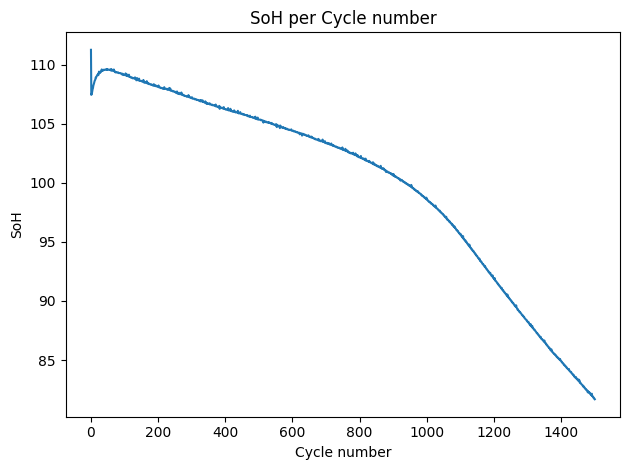

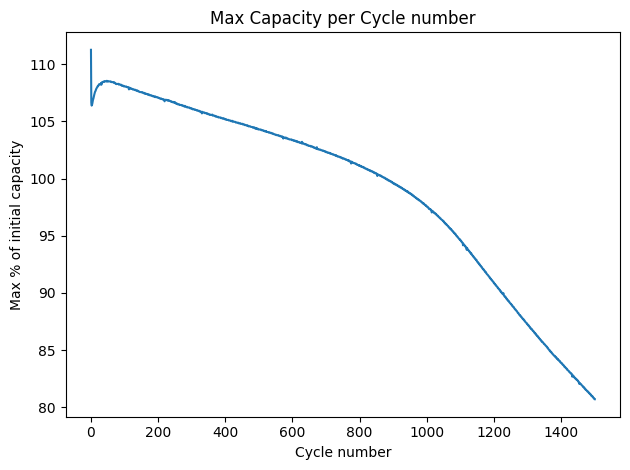

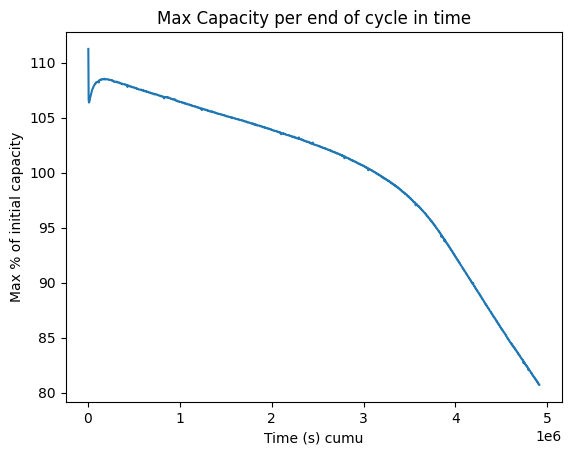

<Figure size 640x480 with 0 Axes>

100%|██████████| 2308/2308 [00:02<00:00, 1093.08it/s]


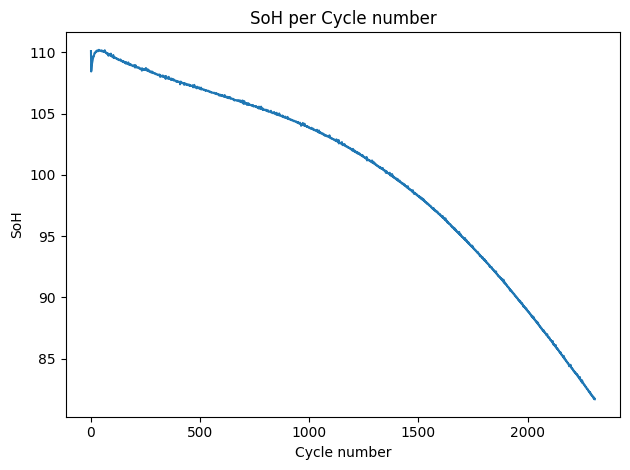

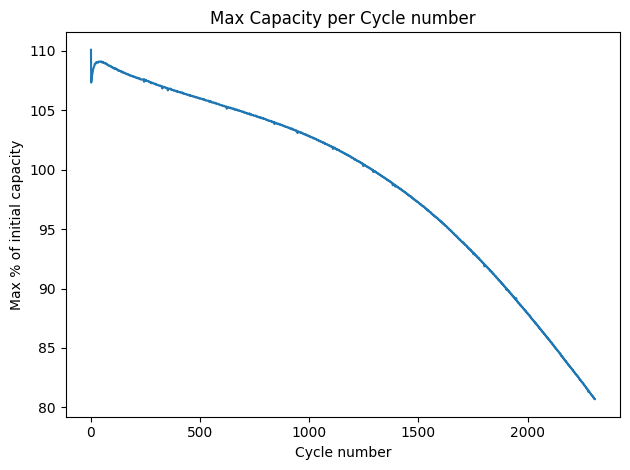

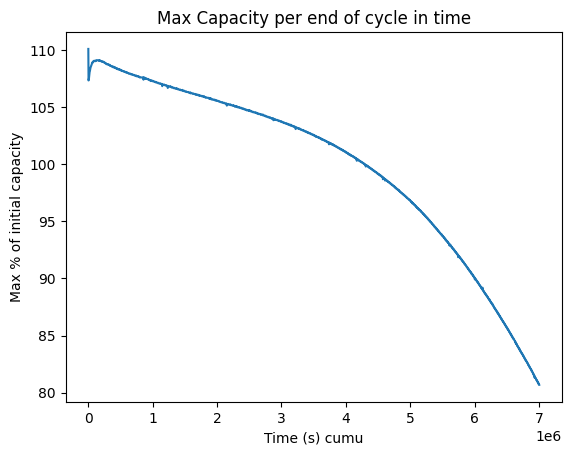

<Figure size 640x480 with 0 Axes>

100%|██████████| 1848/1848 [00:01<00:00, 1121.16it/s]


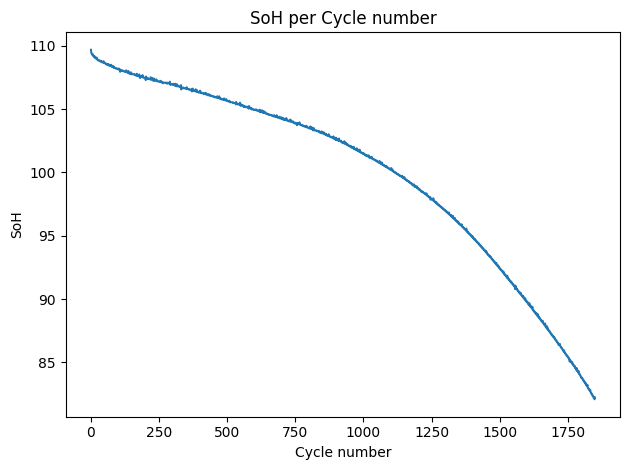

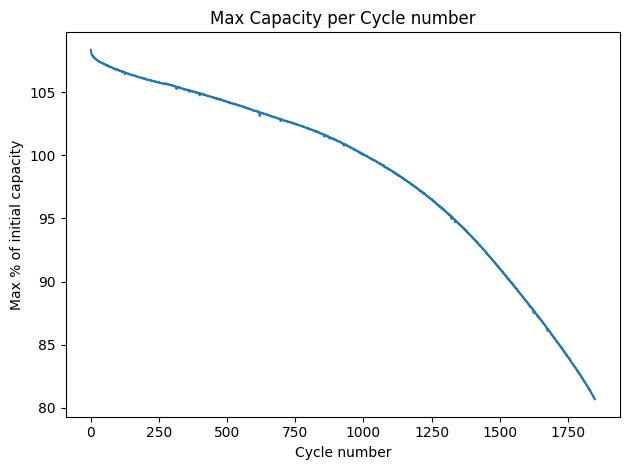

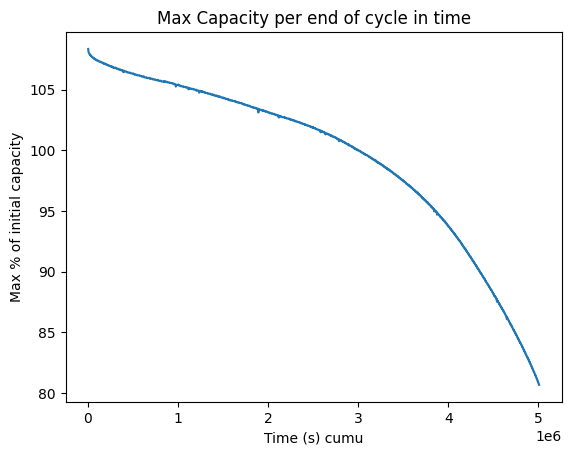

<Figure size 640x480 with 0 Axes>

100%|██████████| 1142/1142 [00:01<00:00, 980.59it/s] 


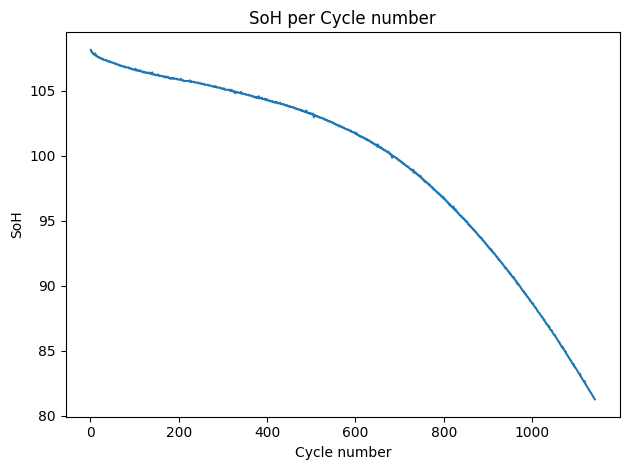

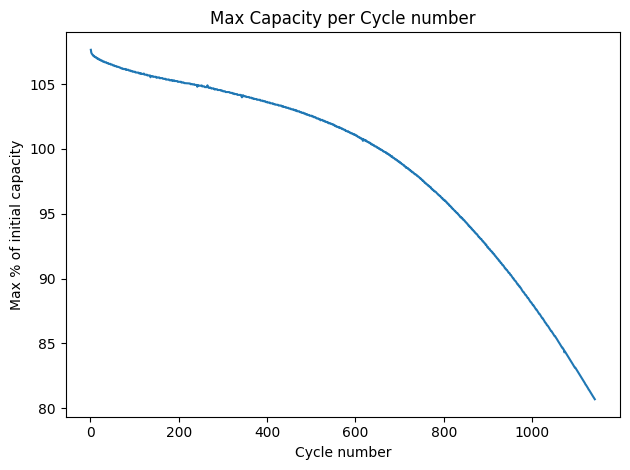

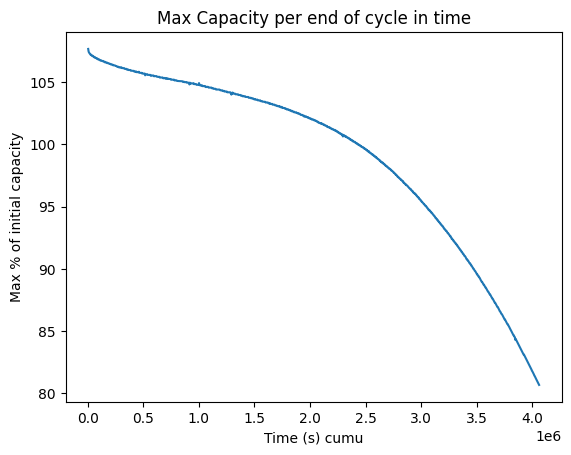

<Figure size 640x480 with 0 Axes>

100%|██████████| 1678/1678 [00:01<00:00, 1112.48it/s]


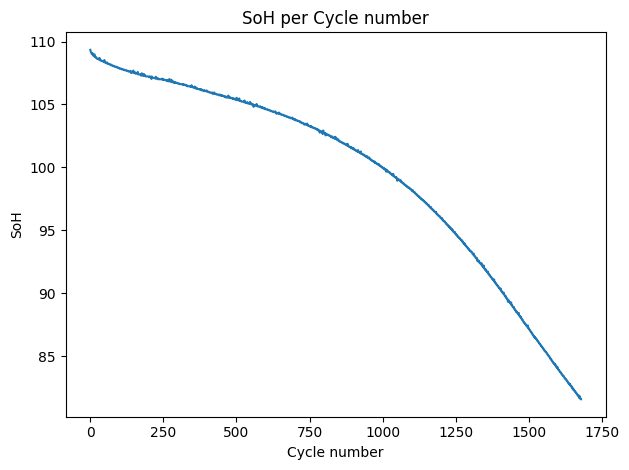

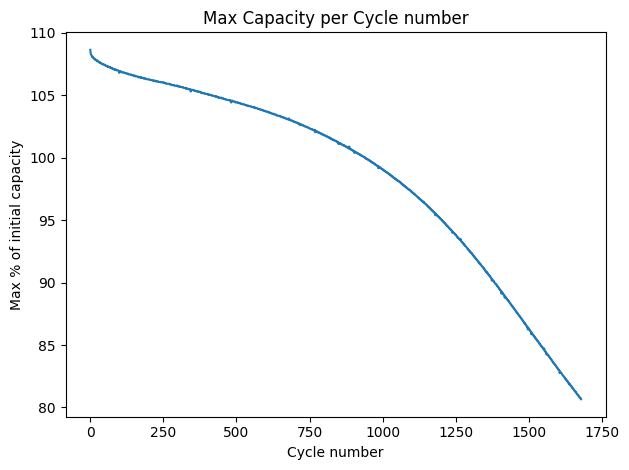

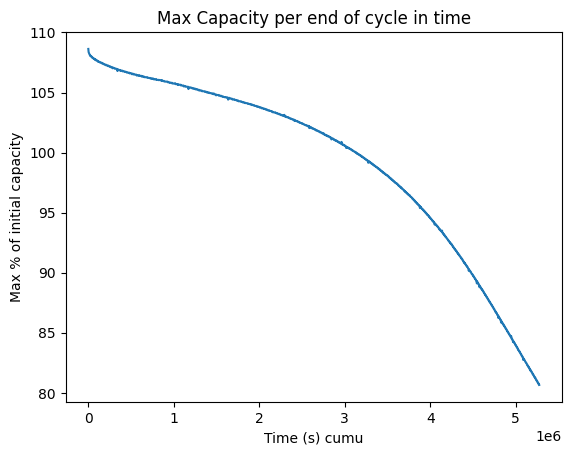

<Figure size 640x480 with 0 Axes>

100%|██████████| 2030/2030 [00:01<00:00, 1116.81it/s]


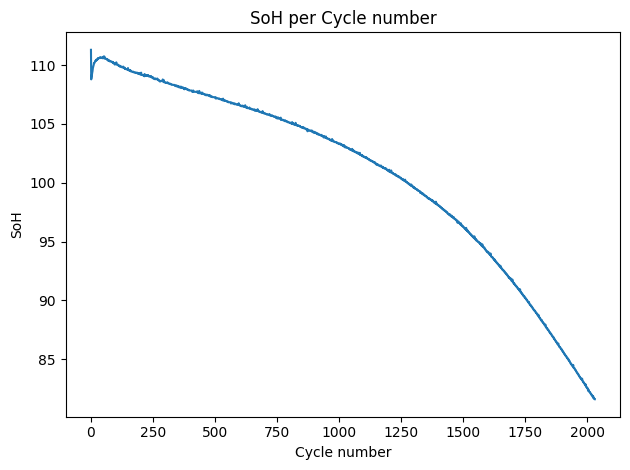

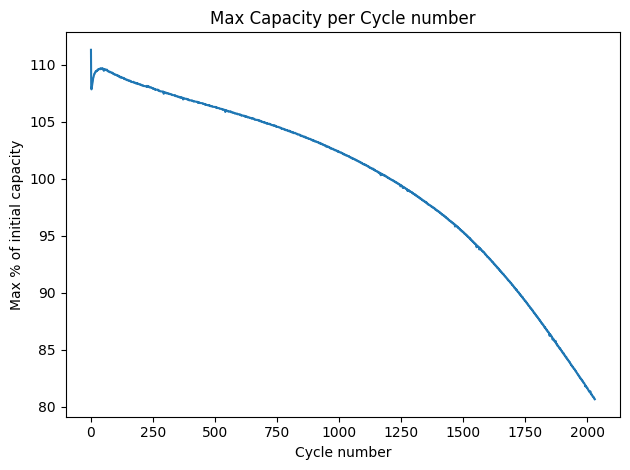

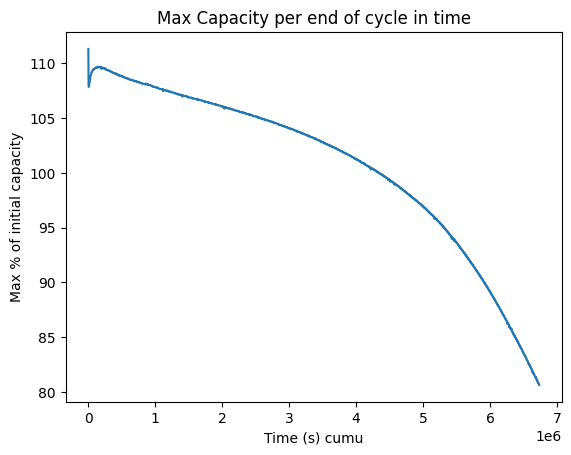

<Figure size 640x480 with 0 Axes>

100%|██████████| 2491/2491 [00:02<00:00, 1037.48it/s]


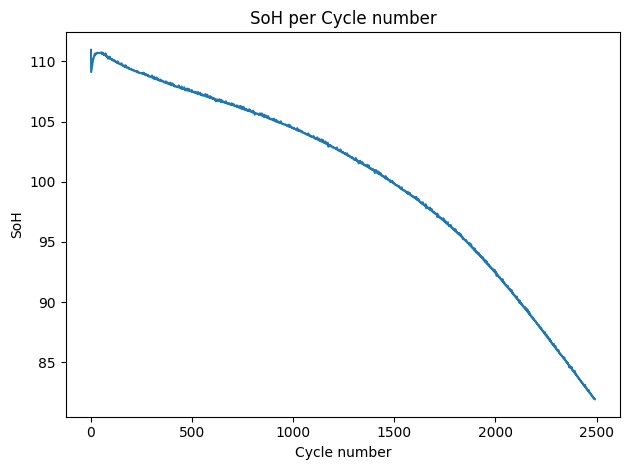

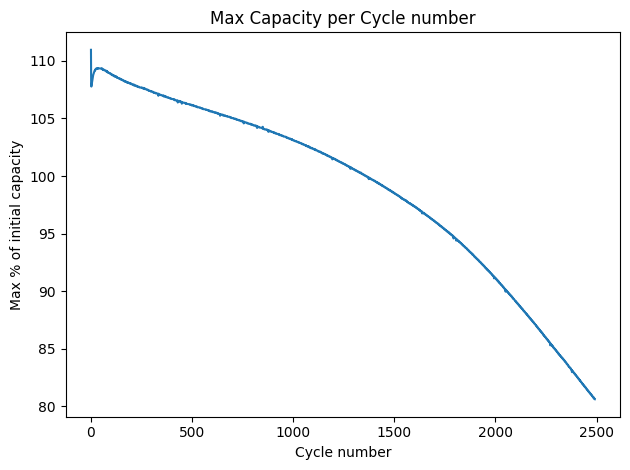

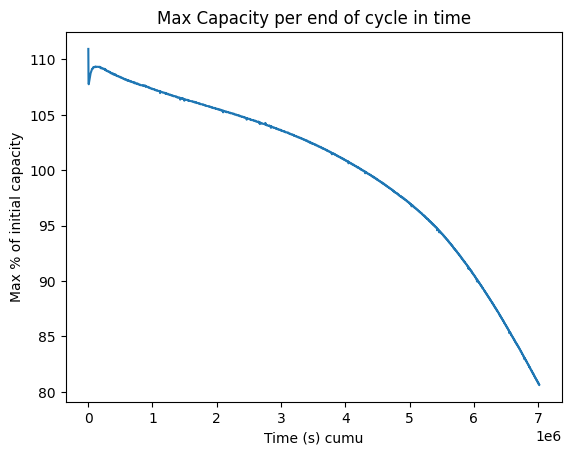

<Figure size 640x480 with 0 Axes>

100%|██████████| 2217/2217 [00:01<00:00, 1150.49it/s]


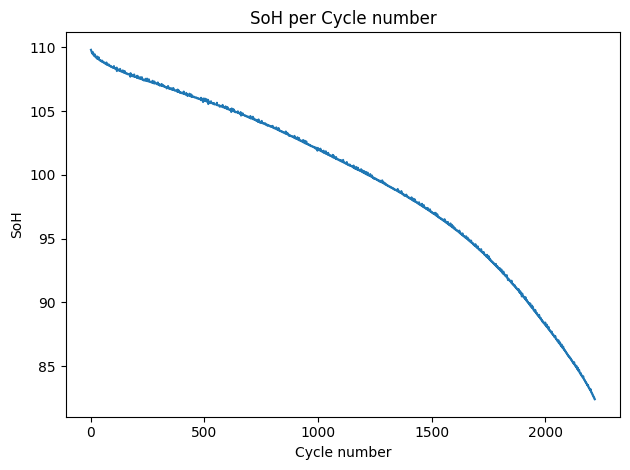

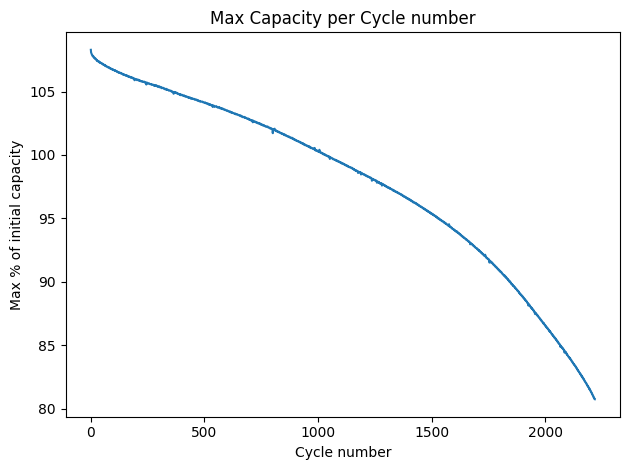

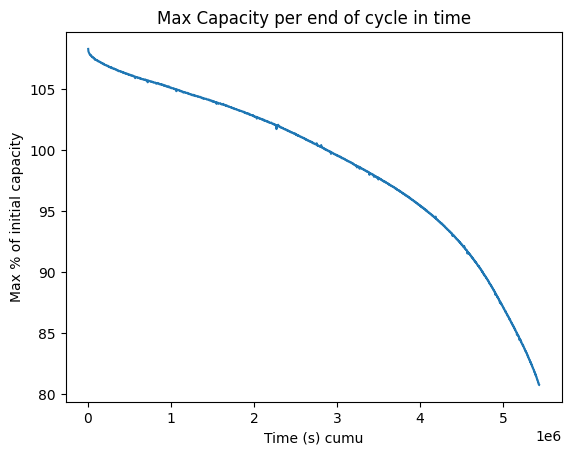

<Figure size 640x480 with 0 Axes>

100%|██████████| 1572/1572 [00:01<00:00, 1077.82it/s]


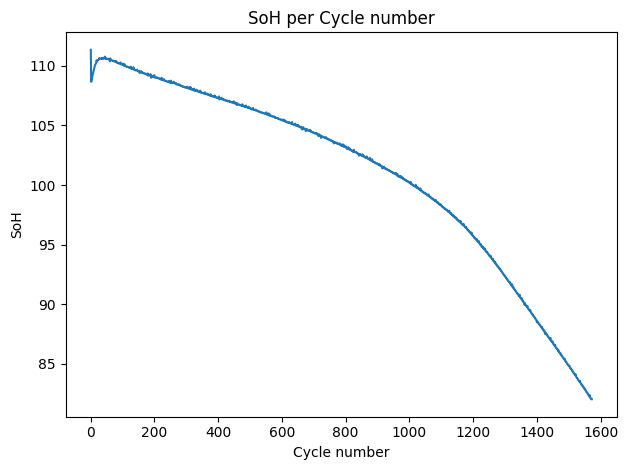

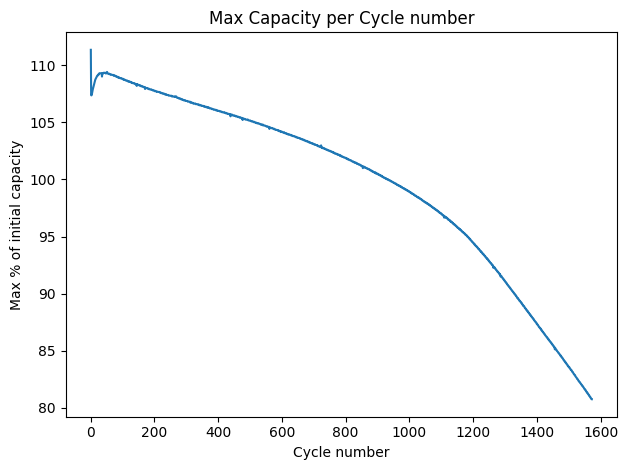

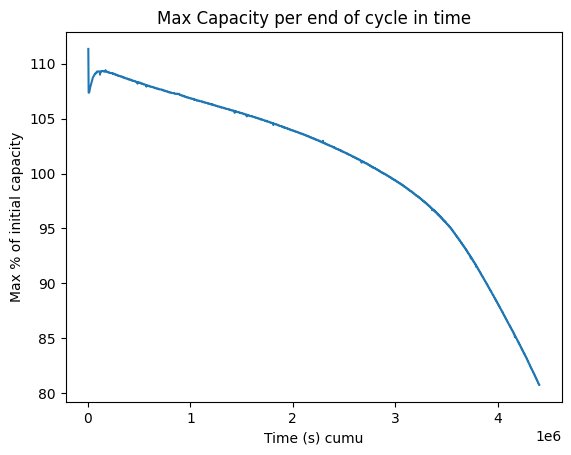

<Figure size 640x480 with 0 Axes>

100%|██████████| 2283/2283 [00:02<00:00, 1014.31it/s]


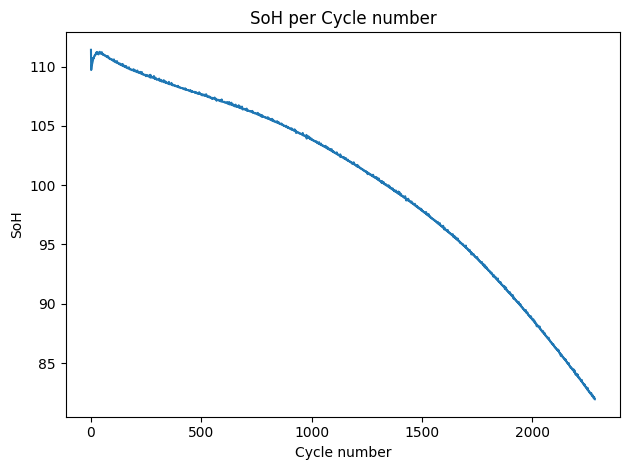

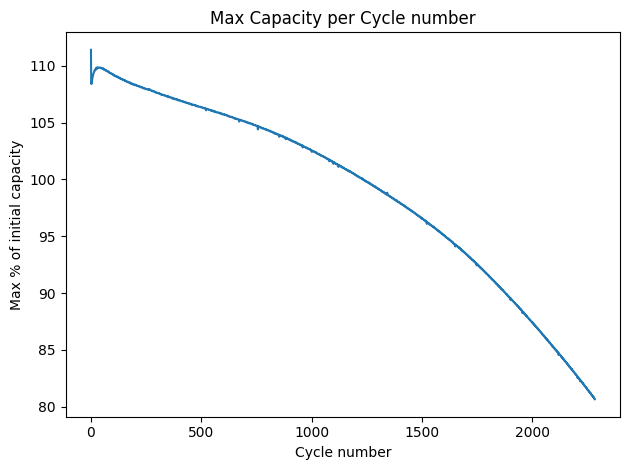

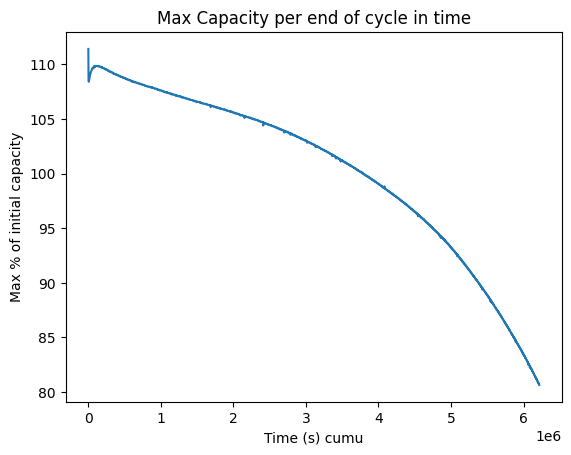

<Figure size 640x480 with 0 Axes>

100%|██████████| 1679/1679 [00:01<00:00, 1130.24it/s]


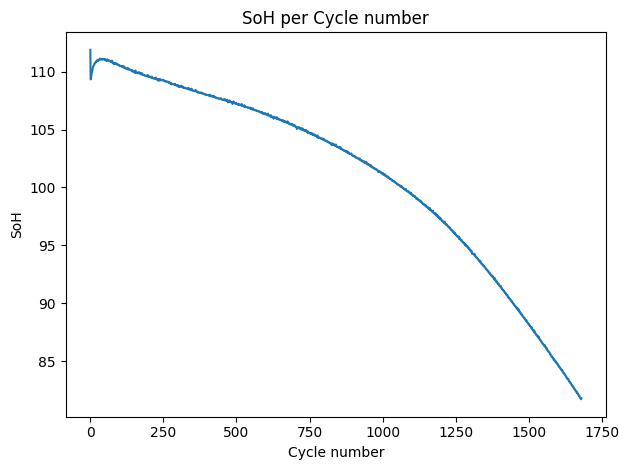

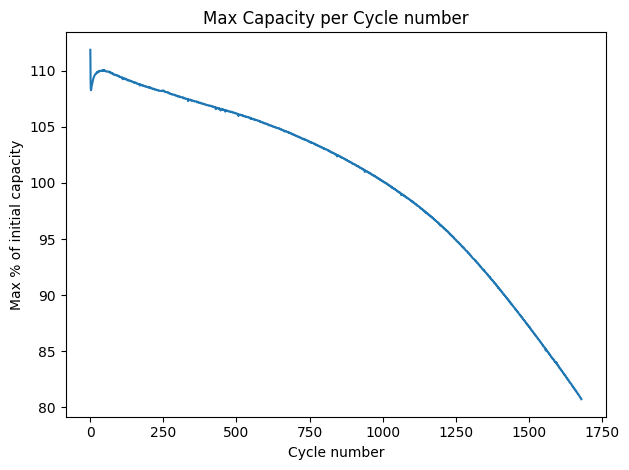

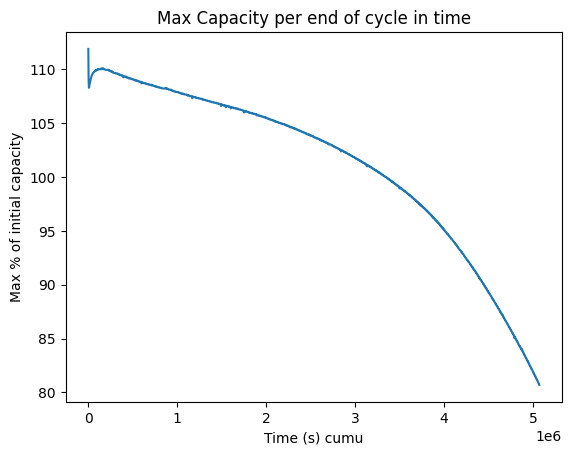

<Figure size 640x480 with 0 Axes>

100%|██████████| 1804/1804 [00:01<00:00, 1156.86it/s]


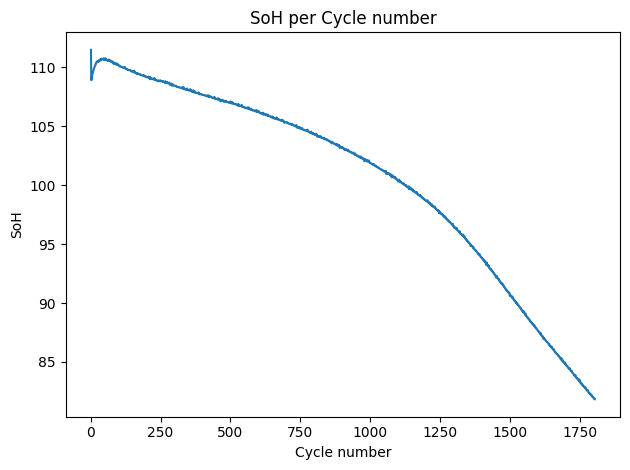

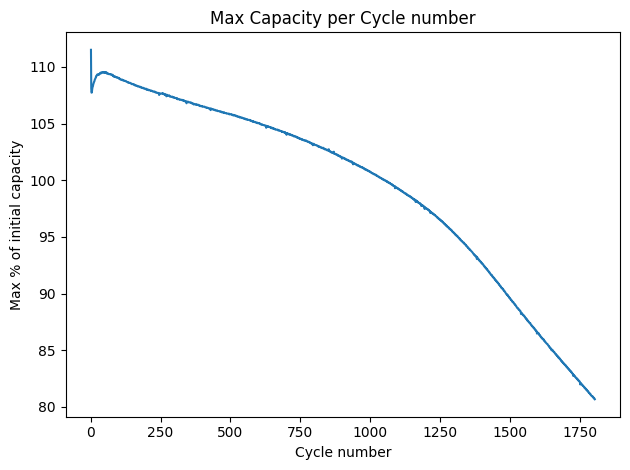

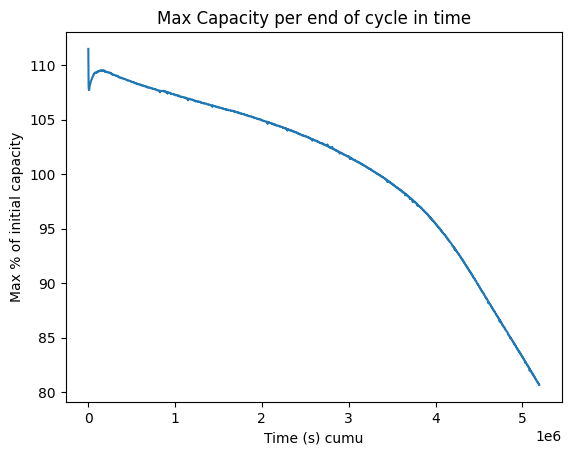

<Figure size 640x480 with 0 Axes>

100%|██████████| 1295/1295 [00:01<00:00, 1097.85it/s]


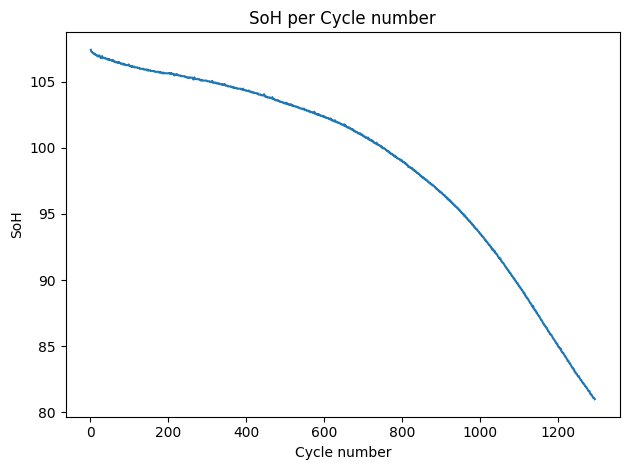

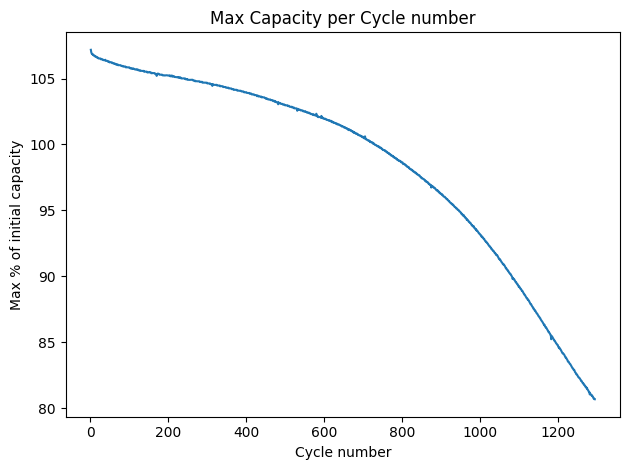

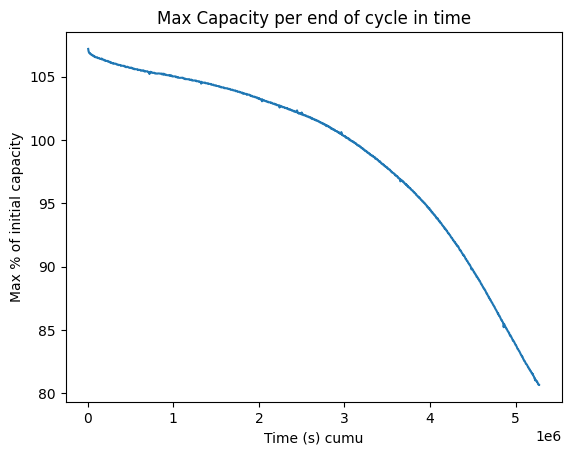

<Figure size 640x480 with 0 Axes>

100%|██████████| 2168/2168 [00:01<00:00, 1149.06it/s]


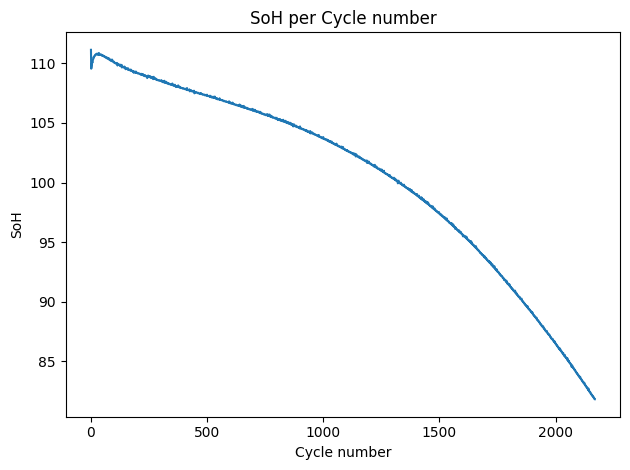

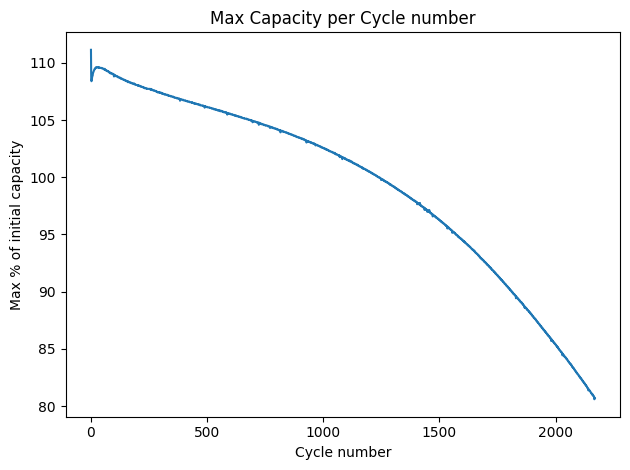

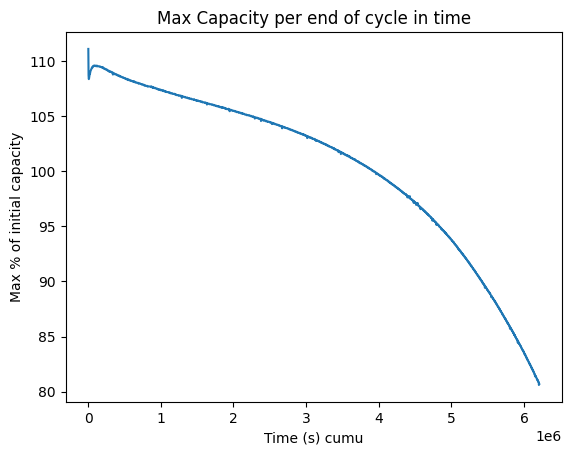

<Figure size 640x480 with 0 Axes>

100%|██████████| 1491/1491 [00:01<00:00, 1078.91it/s]


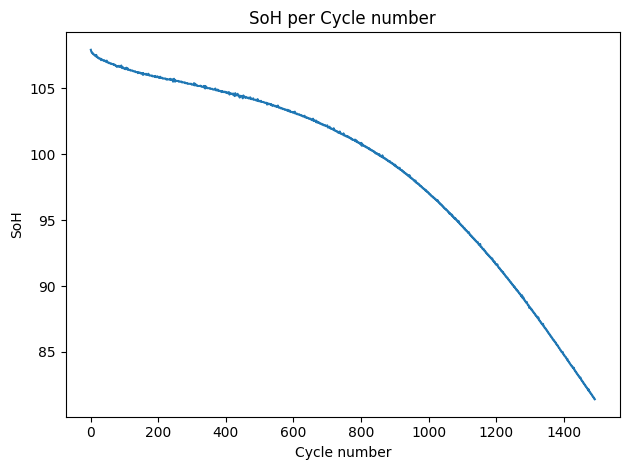

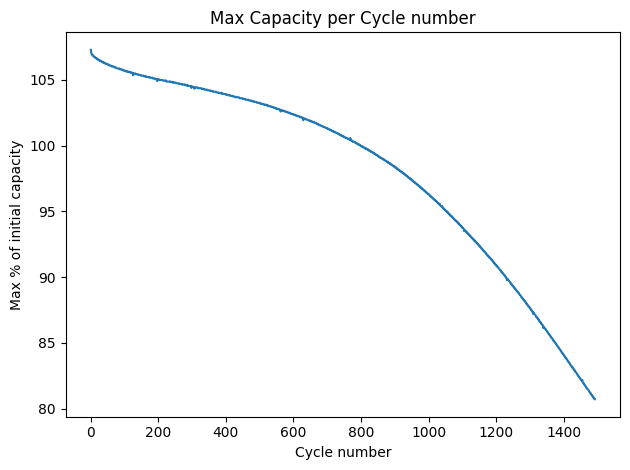

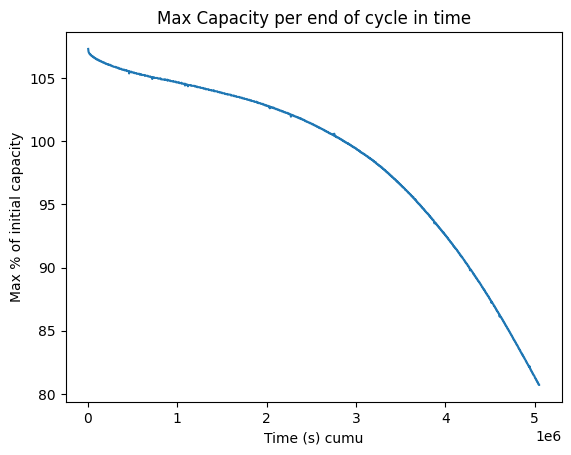

<Figure size 640x480 with 0 Axes>

100%|██████████| 2047/2047 [00:01<00:00, 1137.18it/s]


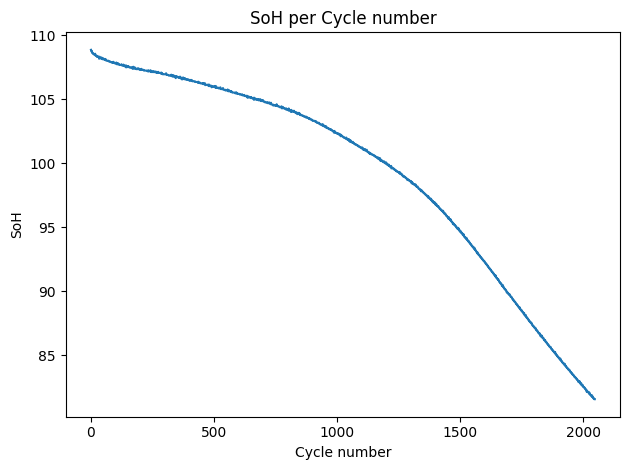

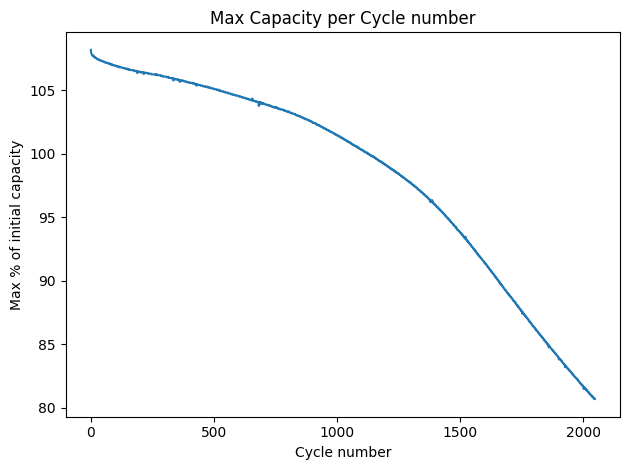

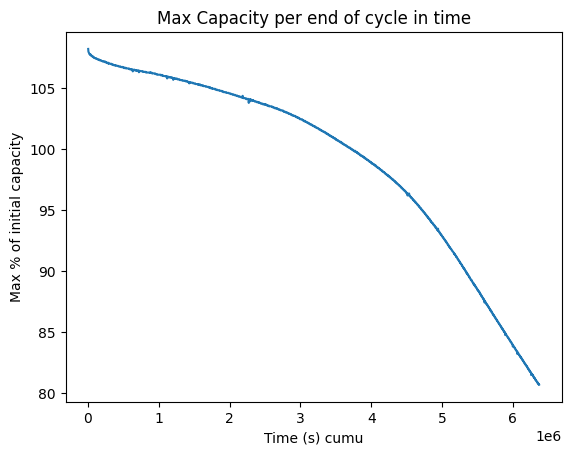

<Figure size 640x480 with 0 Axes>

100%|██████████| 1782/1782 [00:01<00:00, 932.63it/s] 


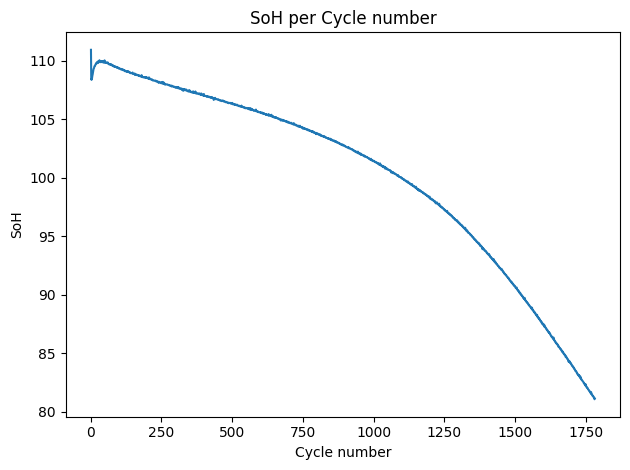

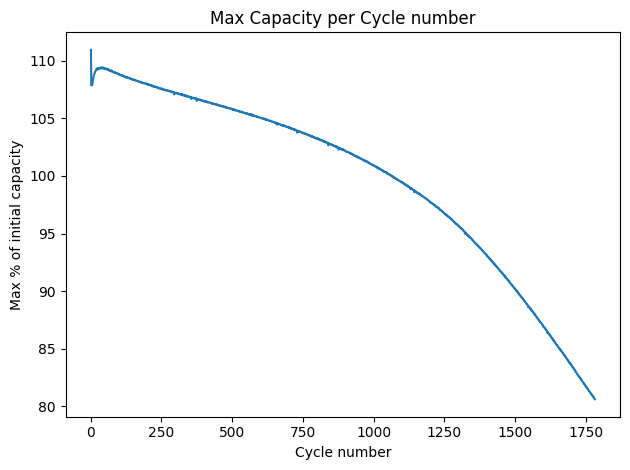

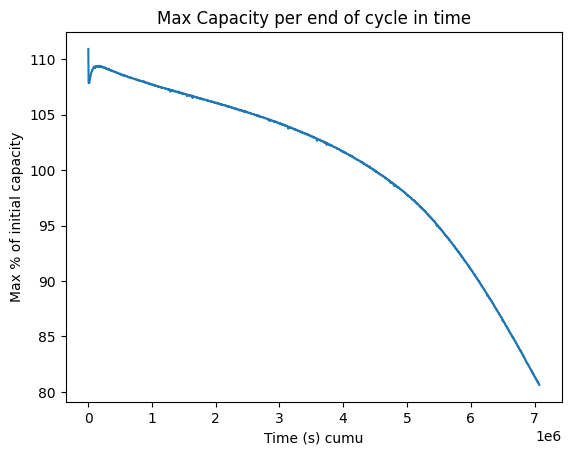

<Figure size 640x480 with 0 Axes>

100%|██████████| 1742/1742 [00:01<00:00, 1092.60it/s]


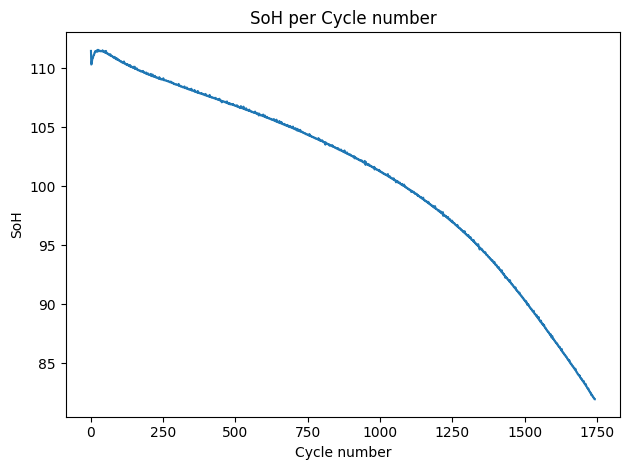

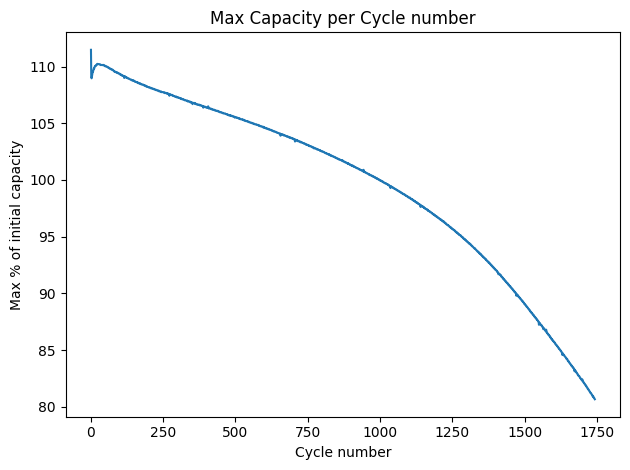

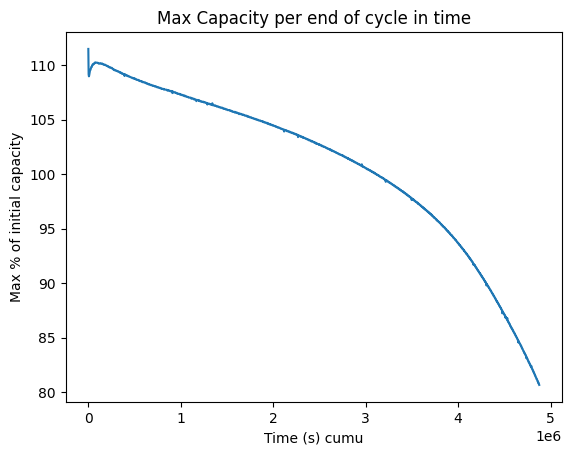

<Figure size 640x480 with 0 Axes>

100%|██████████| 1975/1975 [00:01<00:00, 1116.04it/s]


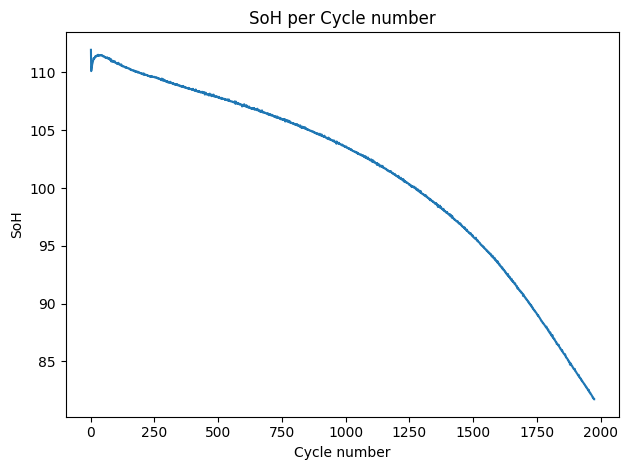

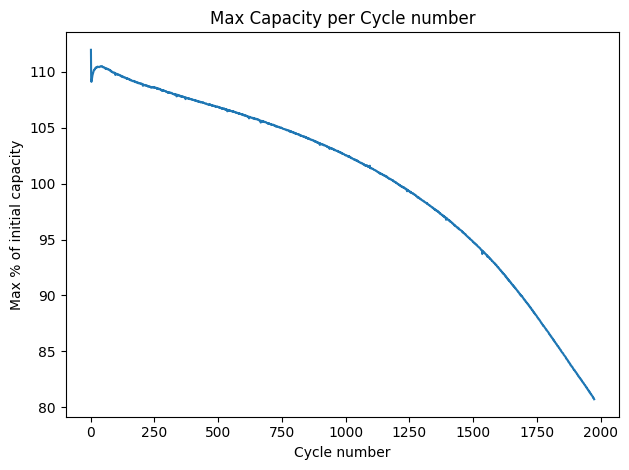

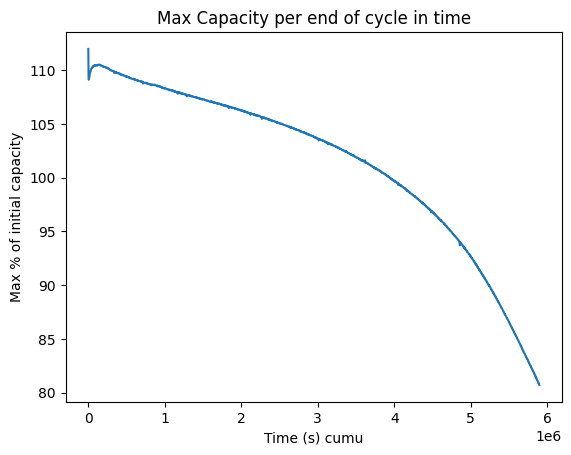

<Figure size 640x480 with 0 Axes>

100%|██████████| 2657/2657 [00:02<00:00, 1003.66it/s]


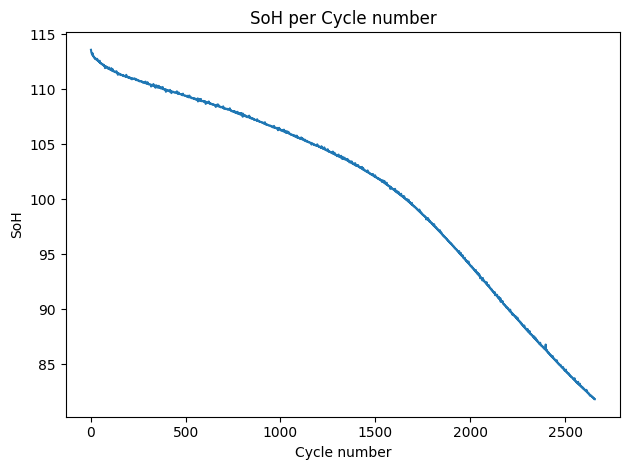

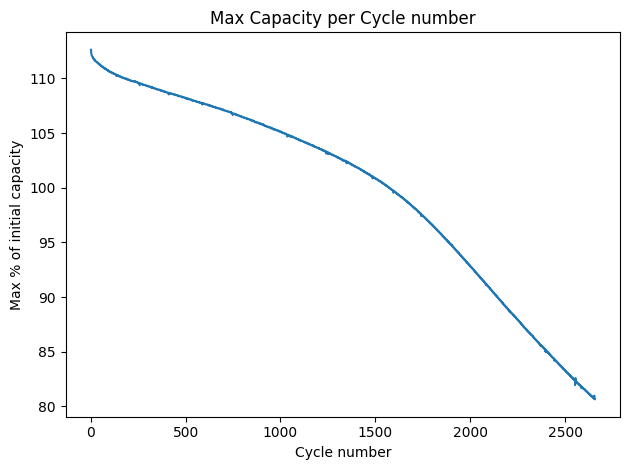

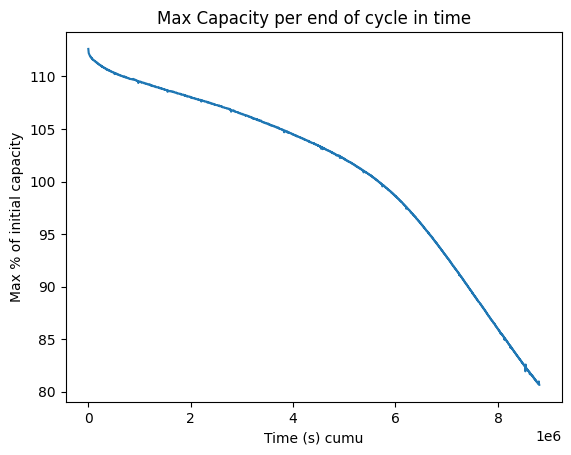

<Figure size 640x480 with 0 Axes>

100%|██████████| 1697/1697 [00:01<00:00, 1136.75it/s]


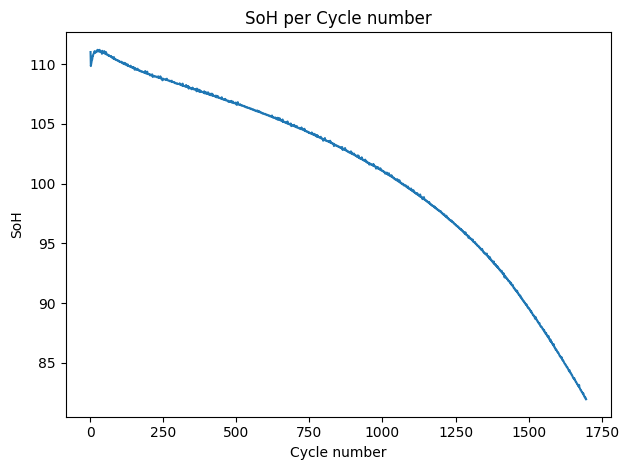

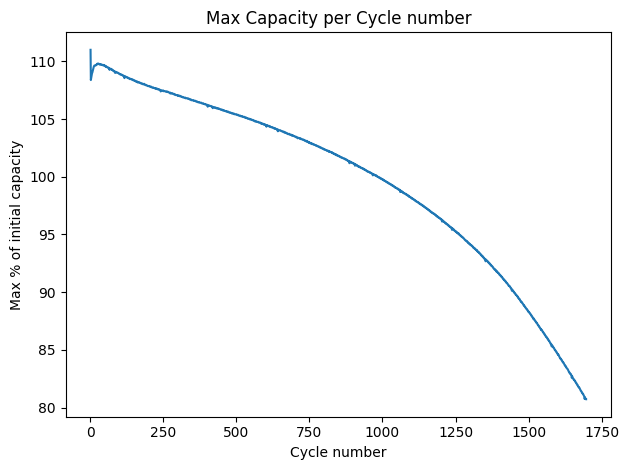

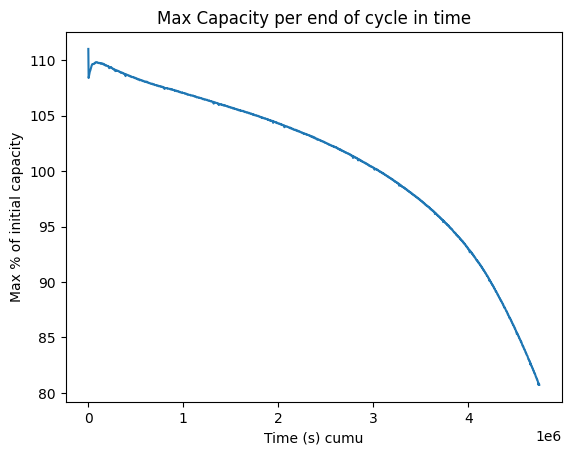

<Figure size 640x480 with 0 Axes>

100%|██████████| 1751/1751 [00:01<00:00, 1133.05it/s]


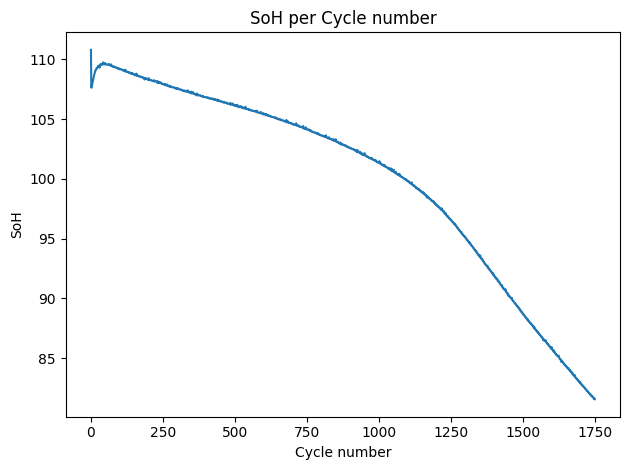

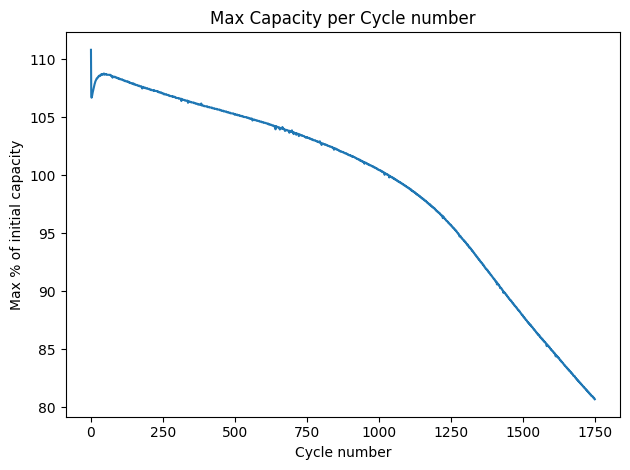

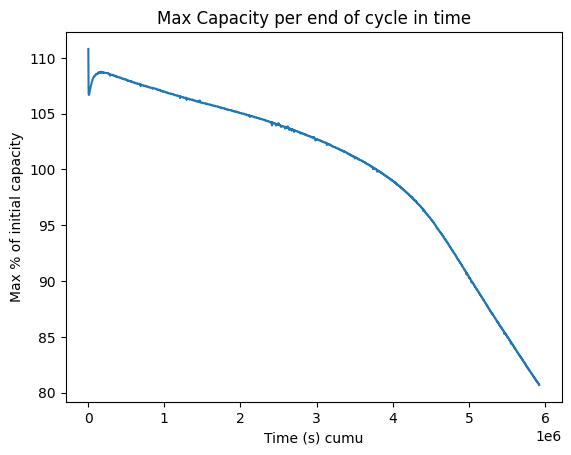

<Figure size 640x480 with 0 Axes>

100%|██████████| 2030/2030 [00:01<00:00, 1180.57it/s]


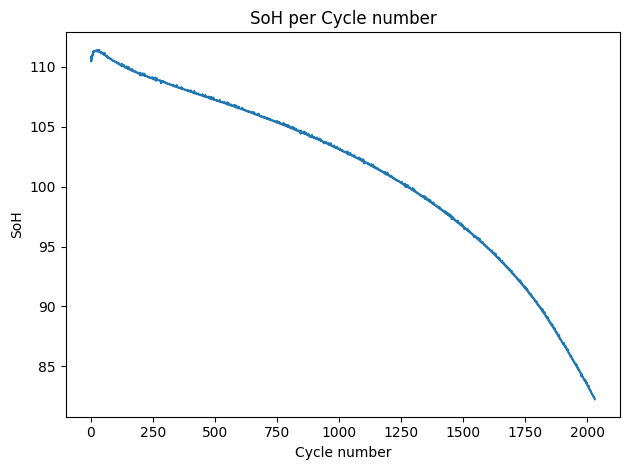

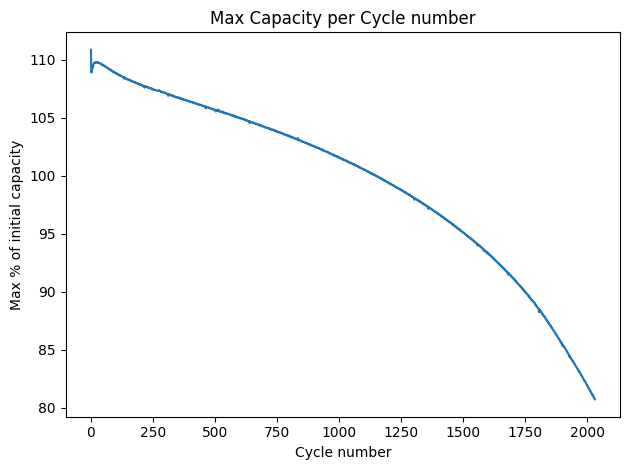

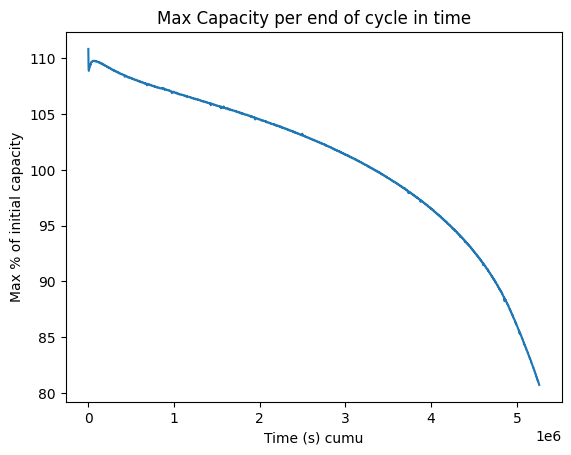

<Figure size 640x480 with 0 Axes>

100%|██████████| 1702/1702 [00:01<00:00, 1159.93it/s]


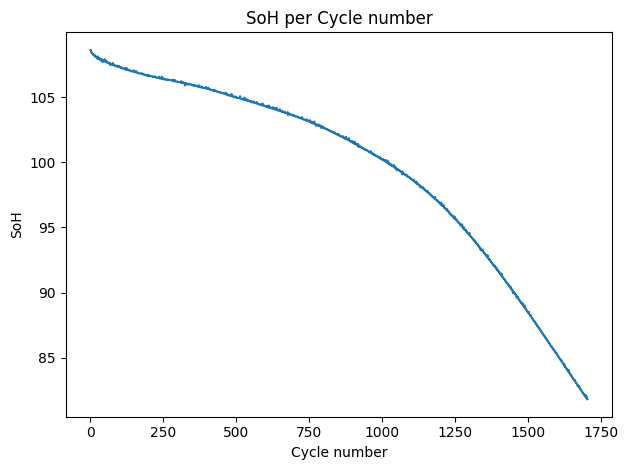

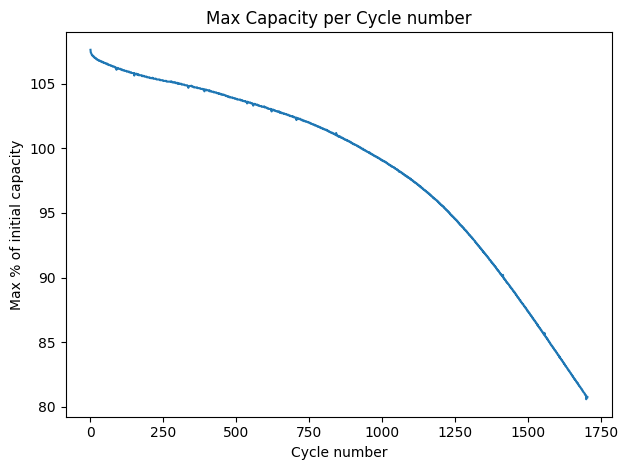

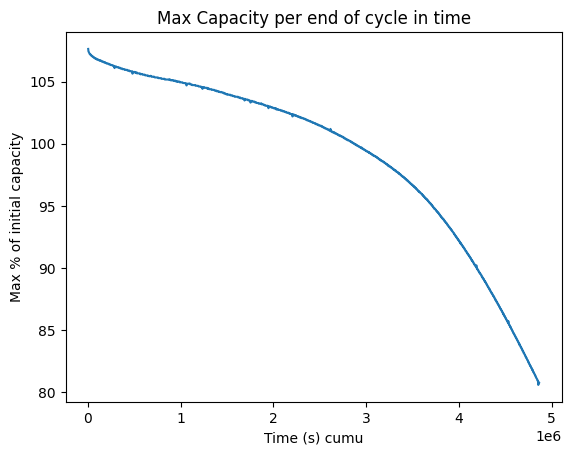

<Figure size 640x480 with 0 Axes>

100%|██████████| 1717/1717 [00:01<00:00, 1165.17it/s]


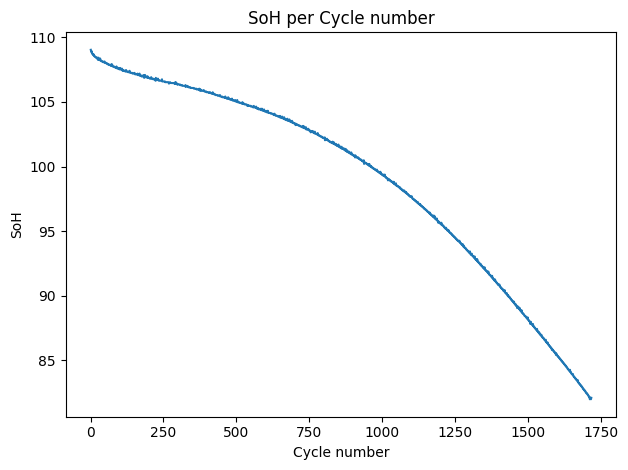

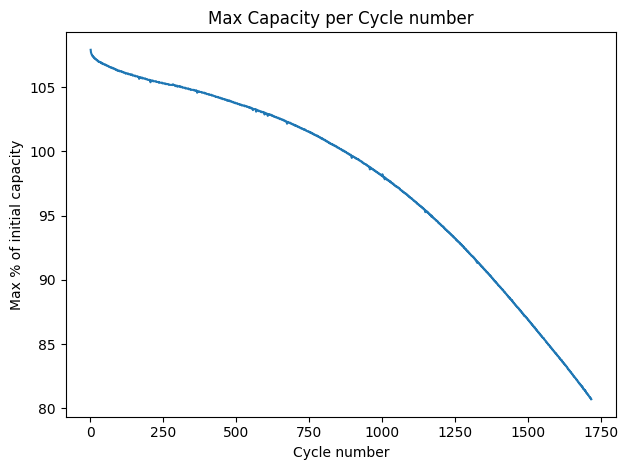

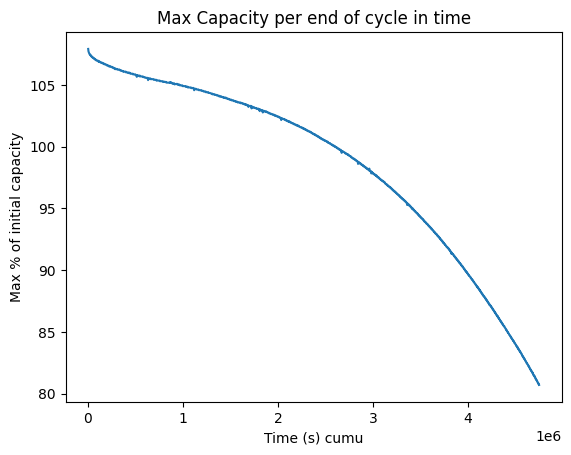

<Figure size 640x480 with 0 Axes>

100%|██████████| 2689/2689 [00:02<00:00, 1147.57it/s]


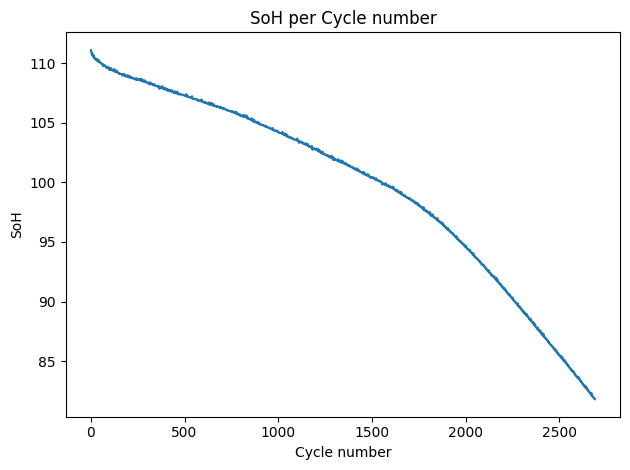

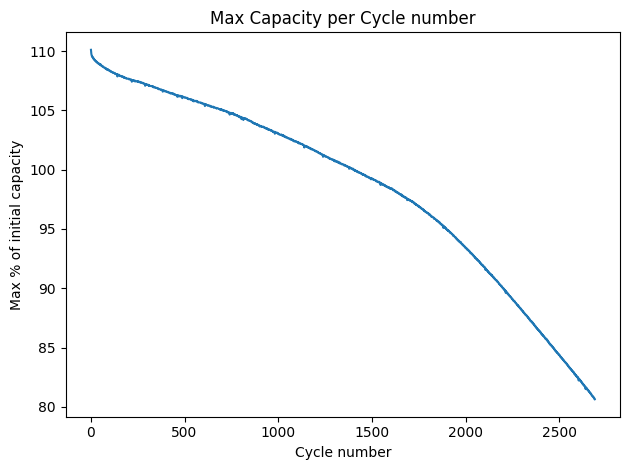

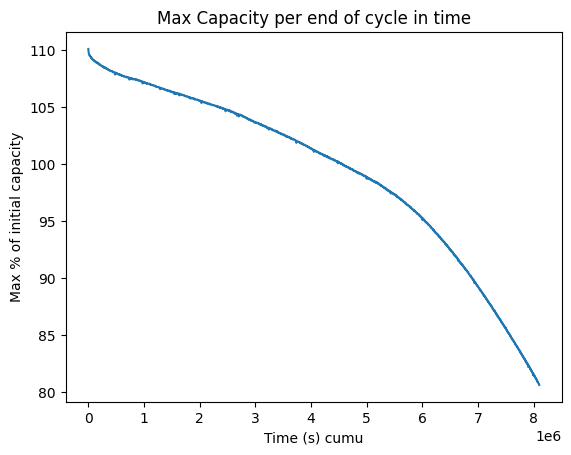

<Figure size 640x480 with 0 Axes>

100%|██████████| 1143/1143 [00:01<00:00, 1088.35it/s]


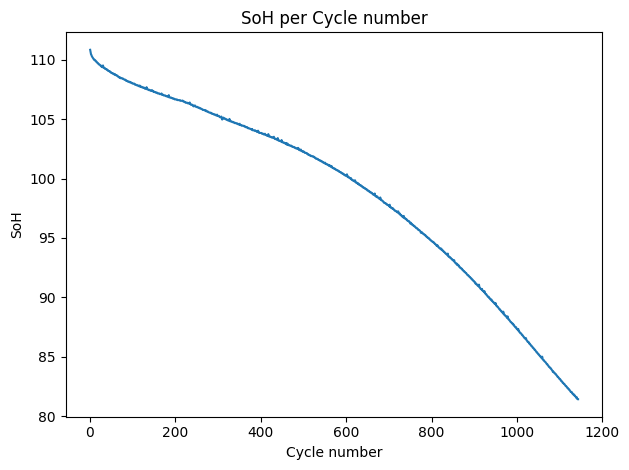

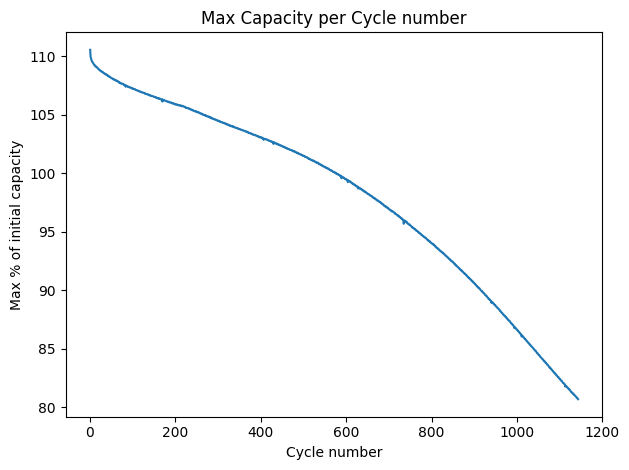

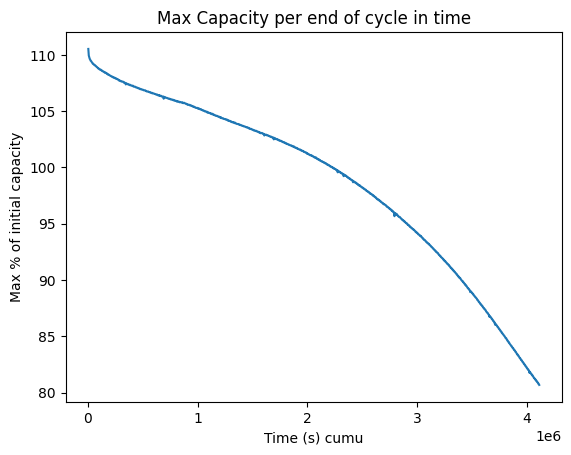

<Figure size 640x480 with 0 Axes>

100%|██████████| 2202/2202 [00:02<00:00, 1034.14it/s]


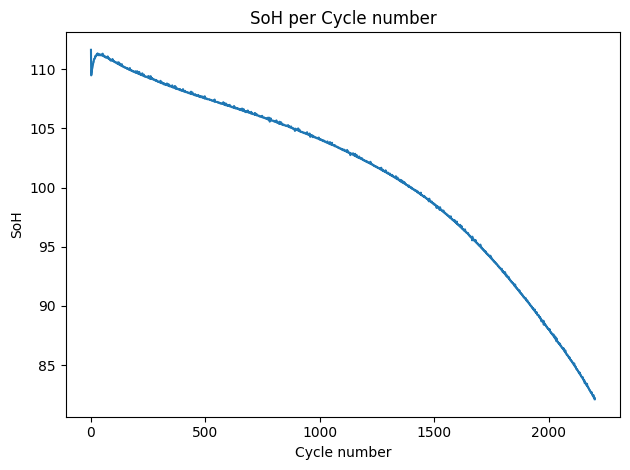

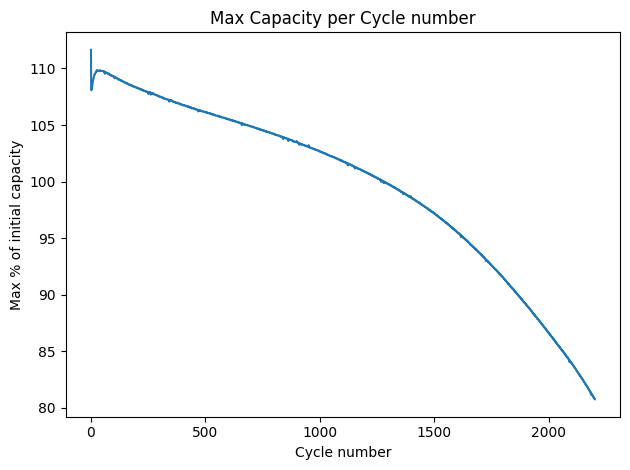

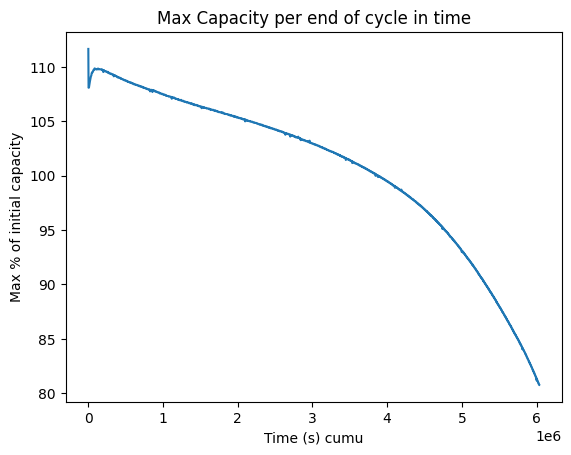

<Figure size 640x480 with 0 Axes>

100%|██████████| 1706/1706 [00:01<00:00, 1148.80it/s]


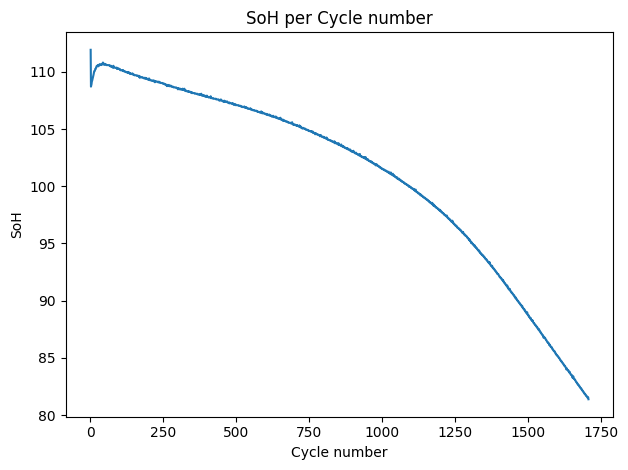

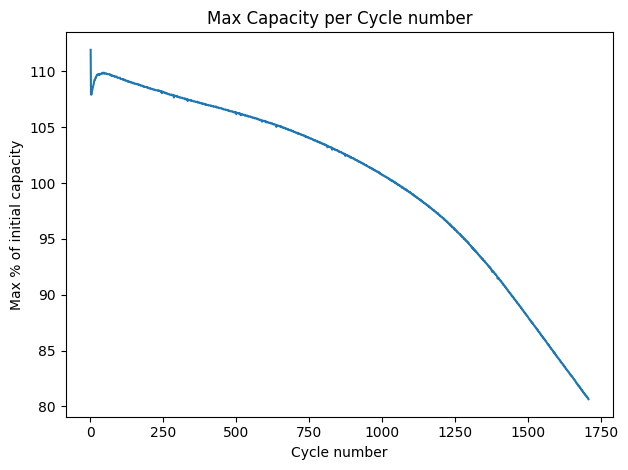

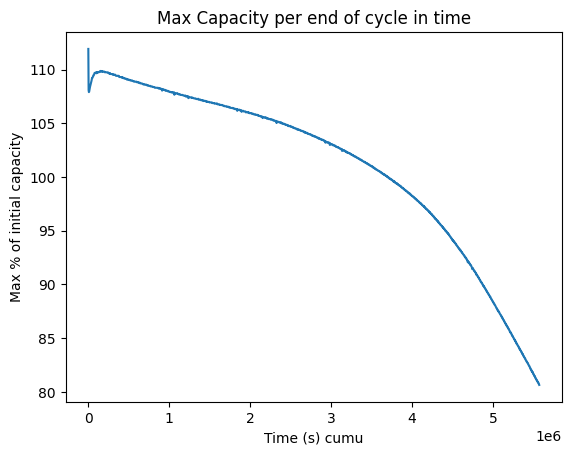

<Figure size 640x480 with 0 Axes>

100%|██████████| 2285/2285 [00:02<00:00, 936.57it/s]


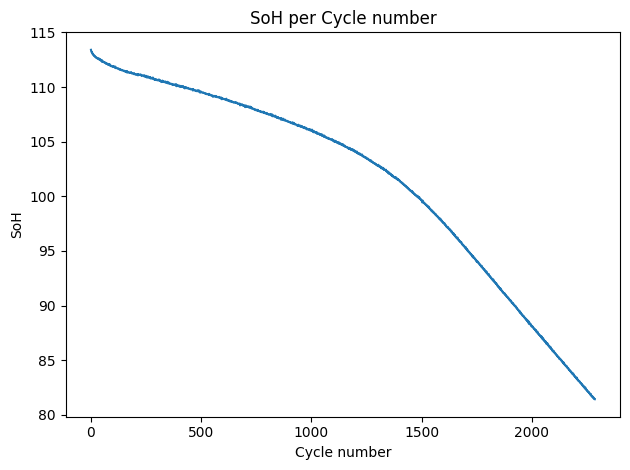

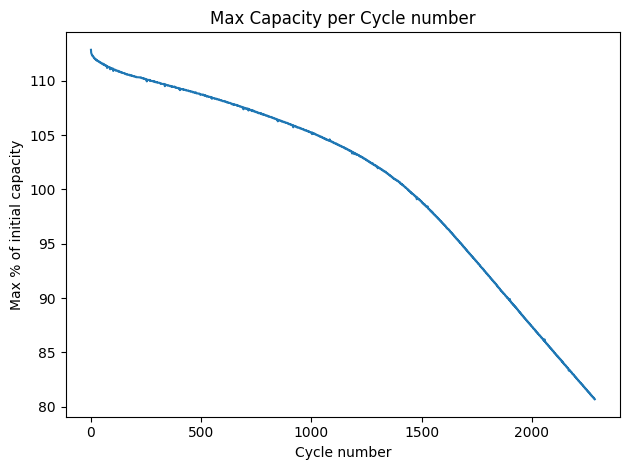

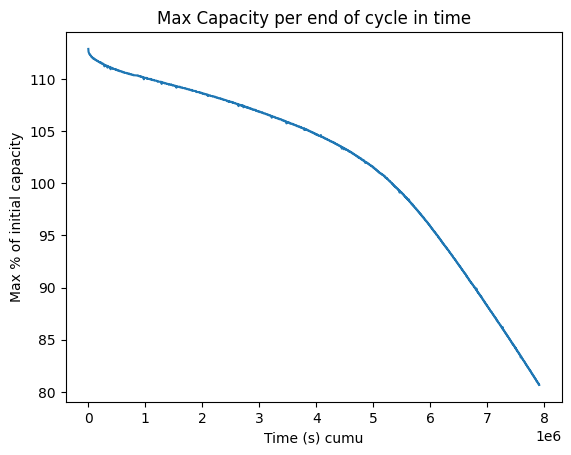

<Figure size 640x480 with 0 Axes>

100%|██████████| 2450/2450 [00:02<00:00, 903.93it/s] 


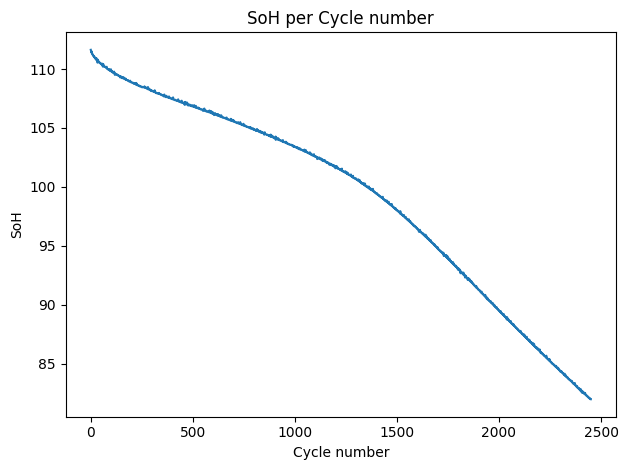

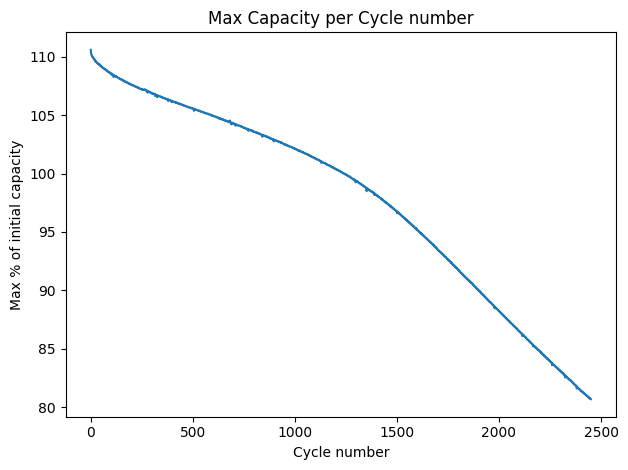

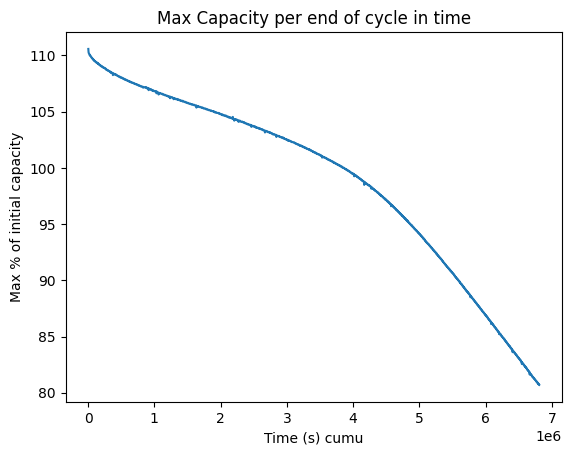

<Figure size 640x480 with 0 Axes>

100%|██████████| 77/77 [07:31<00:00,  5.86s/it]


In [24]:
import os
base_paths = '/kaggle/working/csvs/'
original_files = [file.rstrip('.csv') for file in os.listdir(base_paths)]
os.makedirs('csv-summary/',exist_ok=True)
os.makedirs('capacity-fade-cno-plot/',exist_ok=True)
os.makedirs('capacity-fade-time-plot/',exist_ok=True)
os.makedirs('SoH-cno-plot/',exist_ok=True)
for file in tqdm(original_files):
    df_sample = pd.read_csv(base_paths+file+'.csv')
    
    cycle_data_list = []
    
    for cycle_number, group in tqdm(df_sample.groupby('Cycle number')):
        cycle_data = {
            'Time (s) cumu':group['Time (s) cumu'].max(),
            'Cycle number': cycle_number,
            'max_SOC': group['CC_SOC'].max(),
            'min_SOC': group['CC_SOC'].min(),
            'SoH' : abs(group['CC_SOC'].max()) + abs(group['CC_SOC'].min()),
            'max_voltage': group['Voltage (V)'].max(),
            'min_voltage': group['Voltage (V)'].min(),
            'mean_voltage': group['Voltage (V)'].mean(),
            'max_current': group['Current (mA)'].max(),
            'min_current': group['Current (mA)'].min(),
            'timetaken': group['Time (s)'].max() - group['Time (s)'].min(),
            'max_capacity': group['Capacity (mAh)'].max(),
            'min_capacity': group['Capacity (mAh)'].min(),
            'rul': int(group['rul'].mean()),  # Replace with your RUL calculation function
            #'Time (s) cumu':
        }
        cycle_data_list.append(cycle_data)
        
    df_cycle_data = pd.DataFrame(cycle_data_list)
    df_cycle_data['max_capacity_fade_rate'] = -(df_cycle_data['max_capacity'].diff() / df_cycle_data['Cycle number'].diff())

    df_cycle_data.to_csv('csv-summary/'+file+'.csv',index=False)
    
    # Create a figure with 5 vertical subplots
    plt.plot(df_cycle_data['Cycle number'], df_cycle_data['SoH'])
    
    # Add labels and title
    plt.xlabel('Cycle number')
    plt.ylabel('SoH')
    plt.title('SoH per Cycle number')
    
    # Add some spacing between plots
    plt.tight_layout()
    
    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('SoH-cno-plot/'+file+'.png', dpi=300)
    # Display the plots
    plt.show()
    # Plot the line against time
    plt.plot(df_cycle_data['Cycle number'], df_cycle_data['max_SOC'])
    
    # Add labels and title
    plt.xlabel('Cycle number')
    plt.ylabel('Max % of initial capacity')
    plt.title('Max Capacity per Cycle number')
    
    # Add some spacing between plots
    plt.tight_layout()
    
    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('capacity-fade-cno-plot/'+file+'.png', dpi=300)
    # Display the plots
    plt.show()

    # Create a figure with 5 vertical subplots
    # Plot the line against time
    plt.plot(df_cycle_data['Time (s) cumu'], df_cycle_data['max_SOC'])
    
    # Add labels and title
    plt.xlabel('Time (s) cumu')
    plt.ylabel('Max % of initial capacity')
    plt.title('Max Capacity per end of cycle in time')
    
    # Display the plot
    plt.show()
    # You can also specify the DPI (dots per inch) for better resolution
    plt.savefig('capacity-fade-time-plot/'+file+'.png', dpi=300)
    # Display the plots
    plt.show()



In [25]:
# pd.__version__

In [26]:
# help(pd.DataFrame)

In [27]:
# unpickled_df

In [28]:
# df.head()

In [29]:
#df.head()
#################### Separate metacolumns ##########
# rul = unpickled_df[cycle_regimen]['rul']
# dq = unpickled_df[cycle_regimen]['dq']
# data = unpickled_df[cycle_regimen]['data']

In [30]:
# dq

In [31]:
# rul[2160]

In [32]:
# len(dq)

In [33]:
# len(rul)

In [34]:
# rul

In [35]:
# dq

In [36]:
# print(type(rul),type(dq),type(data))

In [37]:
# len(data)

In [38]:
# list(data.keys())[:10]#values()#keys()

In [39]:
# df_data = pd.DataFrame(data)

In [40]:
### Try and speed up ######
# for  cycle_number in list(data.keys())[:]:
#     if cycle_number == 1 :
#         df_data = pd.DataFrame(data[1])
#         df_data['Time (s) cumu'] = df_data['Time (s)']
#         df_data['rul'] = [rul[cycle_number]]*df_data.shape[0]
#         df_data['dq'] = [dq[cycle_number]]*df_data.shape[0]
#         previous_last_time = df_data.loc[df_data.shape[0]-1,'Time (s) cumu']
#         print(previous_last_time)
        
#         merge_df = df_data.copy()
        
#     elif cycle_number > 1:
#         #pass
#         df_data = pd.DataFrame(data[cycle_number])

#         df_data['Time (s) cumu'] = df_data['Time (s)'] + previous_last_time
#         df_data['rul'] = [rul[cycle_number]]*df_data.shape[0]
#         df_data['dq'] = [dq[cycle_number]]*df_data.shape[0]
#         previous_last_time = df_data.loc[df_data.shape[0]-1,'Time (s) cumu']
#         print(previous_last_time)

#         merge_df = pd.merge(merge_df,df_data,how='outer')
#         merge_df_sorted = merge_df.sort_values(by='Time (s) cumu',ascending=True)
#         merge_df = merge_df_sorted.copy()
#     else:
#         continue

In [41]:
# ### Faster Code ########

# # Prepare a list to store all DataFrames, so we only concatenate at the end
# df_list = []

# # Initialize the previous_last_time for cumulative time calculation
# previous_last_time = 0

# # Iterate over the data dictionary
# for cycle_number, cycle_data in data.items():
#     df_data = pd.DataFrame(cycle_data)

#     # Calculate cumulative time
#     df_data['Time (s) cumu'] = df_data['Time (s)'] + previous_last_time

#     # Add 'rul' and 'dq' columns directly without creating lists
#     df_data['rul'] = rul[cycle_number]
#     df_data['dq'] = dq[cycle_number]

#     # Update the previous_last_time for the next cycle
#     previous_last_time = df_data['Time (s) cumu'].iloc[-1]

#     # Store the DataFrame in the list
#     df_list.append(df_data)

# # Concatenate all DataFrames at once
# merge_df = pd.concat(df_list, ignore_index=True)

# # Sort only once if needed
# merge_df = merge_df.sort_values(by='Time (s) cumu', ascending=True).reset_index(drop=True)


In [42]:
# merge_df.shape

In [43]:
# merge_df.head()

In [44]:
# os.makedirs('plots/',exist_ok=True)

In [45]:
# df = merge_df#.copy()

# import matplotlib.pyplot as plt

# # Create a figure with 5 vertical subplots
# fig, axs = plt.subplots(5, 1, figsize=(8, 10), sharex=True)

# # Plot Current vs Time
# axs[0].plot(df['Time (s) cumu'], df['Current (mA)'], color='blue')
# axs[0].set_ylabel('Current (mA)')
# axs[0].set_title('Current vs Time')

# # Plot Voltage vs Time
# axs[1].plot(df['Time (s) cumu'], df['Voltage (V)'], color='orange')
# axs[1].set_ylabel('Voltage (V)')
# axs[1].set_title('Voltage vs Time')

# # Plot Capacity vs Time
# axs[2].plot(df['Time (s) cumu'], df['Capacity (mAh)'], color='green')
# axs[2].set_ylabel('Capacity (mAh)')
# axs[2].set_title('Capacity vs Time')
# axs[2].set_xlabel('Time (s)')

# # Plot RUL vs Time
# axs[3].plot(df['Time (s) cumu'], df['rul'], color='red')
# axs[3].set_ylabel('RUL (time)')
# axs[3].set_title('RUL vs Time')
# axs[3].set_xlabel('Time (s)')

# # Plot Capacity vs Time
# axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
# axs[4].set_ylabel('dq')
# axs[4].set_title('dq vs Time')
# axs[4].set_xlabel('Time (s)')

# # Add some spacing between plots
# plt.tight_layout()

# # Display the plots
# plt.show()

# # You can also specify the DPI (dots per inch) for better resolution
# plt.savefig('plots/'+cycle_regimen+'-full-plot.png', dpi=300)



In [46]:
# df = merge_df#.copy()
# df = df[df['Cycle number']<11]

# # Create a figure with 5 vertical subplots
# fig, axs = plt.subplots(5, 1, figsize=(8, 10), sharex=True)

# # Plot Current vs Time
# axs[0].plot(df['Time (s) cumu'], df['Current (mA)'], color='blue')
# axs[0].set_ylabel('Current (mA)')
# axs[0].set_title('Current vs Time')

# # Plot Voltage vs Time
# axs[1].plot(df['Time (s) cumu'], df['Voltage (V)'], color='orange')
# axs[1].set_ylabel('Voltage (V)')
# axs[1].set_title('Voltage vs Time')

# # Plot Capacity vs Time
# axs[2].plot(df['Time (s) cumu'], df['Capacity (mAh)'], color='green')
# axs[2].set_ylabel('Capacity (mAh)')
# axs[2].set_title('Capacity vs Time')
# axs[2].set_xlabel('Time (s)')

# # Plot RUL vs Time
# axs[3].plot(df['Time (s) cumu'], df['rul'], color='red')
# axs[3].set_ylabel('RUL (time)')
# axs[3].set_title('RUL vs Time')
# axs[3].set_xlabel('Time (s)')

# # Plot Capacity vs Time
# axs[4].plot(df['Time (s) cumu'], df['dq'], color='yellow')
# axs[4].set_ylabel('dq')
# axs[4].set_title('dq vs Time')
# axs[4].set_xlabel('Time (s)')

# # Add some spacing between plots
# plt.tight_layout()

# # Display the plots
# plt.show()

# # You can also specify the DPI (dots per inch) for better resolution
# plt.savefig('plots/'+cycle_regimen+'-first-10-plot.png', dpi=300)

# merge_df.to_csv(cycle_regimen+'.csv',index=False)

In [47]:
# merge_df.tail()

In [48]:
# merge_df.to_csv(cycle_regimen+'.csv',index=False)

In [49]:
# data[1]

In [50]:
# df_data_1.columns

In [51]:
# # data['3-3']['rul']#.keys()
# data['3-3']['data']

In [52]:
# import matplotlib.pyplot as plt

# #data[1]
# df_data_1 = pd.DataFrame(data[1]) # the one is cycle 1
# df_data_1.head()
# df = df_data_1.copy()

# # # Assuming 'df' is your dataframe
# # plt.figure(figsize=(10, 6))

# # # Plot Current vs Time
# # #plt.plot(df['Time (s)'], df['Current (mA)'], label='Current (mA)', color='blue')

# # # Plot Voltage vs Time
# # #plt.plot(df['Time (s)'], df['Voltage (V)'], label='Voltage (V)', color='orange')

# # # Plot Capacity vs Time
# # #plt.plot(df['Time (s)'], df['Capacity (mAh)'], label='Capacity (mAh)', color='green')

# # # Add labels and title
# # plt.xlabel('Time (s)')
# # plt.ylabel('Values')
# # plt.title('Battery Data: Current, Voltage, and Capacity vs Time')

# # # Add legend
# # plt.legend()

# # # Display the plot
# # plt.show()
# import matplotlib.pyplot as plt

# # Create a figure with 3 vertical subplots
# fig, axs = plt.subplots(3, 1, figsize=(8, 10), sharex=True)

# # Plot Current vs Time
# axs[0].plot(df['Time (s)'], df['Current (mA)'], color='blue')
# axs[0].set_ylabel('Current (mA)')
# axs[0].set_title('Current vs Time')

# # Plot Voltage vs Time
# axs[1].plot(df['Time (s)'], df['Voltage (V)'], color='orange')
# axs[1].set_ylabel('Voltage (V)')
# axs[1].set_title('Voltage vs Time')

# # Plot Capacity vs Time
# axs[2].plot(df['Time (s)'], df['Capacity (mAh)'], color='green')
# axs[2].set_ylabel('Capacity (mAh)')
# axs[2].set_title('Capacity vs Time')
# axs[2].set_xlabel('Time (s)')

# # Add some spacing between plots
# plt.tight_layout()

# # Display the plots
# plt.show()


In [53]:
# import matplotlib.pyplot as plt

# #data[1]
# df_data = pd.DataFrame(data[2]) # the one is cycle 2
# df_data.head()
# df = df_data.copy()

# # # Assuming 'df' is your dataframe
# # plt.figure(figsize=(10, 6))

# # # Plot Current vs Time
# # #plt.plot(df['Time (s)'], df['Current (mA)'], label='Current (mA)', color='blue')

# # # Plot Voltage vs Time
# # #plt.plot(df['Time (s)'], df['Voltage (V)'], label='Voltage (V)', color='orange')

# # # Plot Capacity vs Time
# # #plt.plot(df['Time (s)'], df['Capacity (mAh)'], label='Capacity (mAh)', color='green')

# # # Add labels and title
# # plt.xlabel('Time (s)')
# # plt.ylabel('Values')
# # plt.title('Battery Data: Current, Voltage, and Capacity vs Time')

# # # Add legend
# # plt.legend()

# # # Display the plot
# # plt.show()
# import matplotlib.pyplot as plt

# # Create a figure with 3 vertical subplots
# fig, axs = plt.subplots(3, 1, figsize=(8, 10), sharex=True)

# # Plot Current vs Time
# axs[0].plot(df['Time (s)'], df['Current (mA)'], color='blue')
# axs[0].set_ylabel('Current (mA)')
# axs[0].set_title('Current vs Time')

# # Plot Voltage vs Time
# axs[1].plot(df['Time (s)'], df['Voltage (V)'], color='orange')
# axs[1].set_ylabel('Voltage (V)')
# axs[1].set_title('Voltage vs Time')

# # Plot Capacity vs Time
# axs[2].plot(df['Time (s)'], df['Capacity (mAh)'], color='green')
# axs[2].set_ylabel('Capacity (mAh)')
# axs[2].set_title('Capacity vs Time')
# axs[2].set_xlabel('Time (s)')

# # Add some spacing between plots
# plt.tight_layout()

# # Display the plots
# plt.show()


In [54]:
# df_data_1.head()

In [55]:
# df_data_1.tail()

In [56]:
# df_data_1['Time (s) cumu'] = df_data_1['Time (s)']

In [57]:
# df_data_1[808]

In [58]:
# previous_last_time = df_data_1.loc[df_data_1.shape[0]-1,'Time (s) cumu']
# print(previous_last_time)

In [59]:
# df_data.head()

In [60]:
# df_data['Time (s) cumu'] = df_data['Time (s)']+previous_last_time#4179#4067
# df_data.head()

In [61]:
# merge_df = pd.merge(df_data_1,df_data,how='outer')

In [62]:
# merge_df.head()

In [63]:
# merge_df.tail()

In [64]:
# merge_df_sorted = merge_df.sort_values(by='Time (s) cumu',ascending=True)

In [65]:
# merge_df_sorted.shape

In [66]:
# merge_df_sorted.tail()